In [2]:
#From scratch windowing only works for Ind point not ind area as unable to convert data to tensors
!pip install tensorflow-addons
!pip install pyarrow
!pip install seaborn


#################################
#delete inbetween these lines if not using pytorch
# !pip install pytorch_forecasting

# import warnings

# import copy
# from pathlib import Path
# import torch
# import torch.nn as nn

# import pytorch_lightning as pl
# from pytorch_lightning.callbacks import EarlyStopping, LearningRateMonitor
# from pytorch_lightning.loggers import TensorBoardLogger

# import pytorch_forecasting
# from pytorch_forecasting import Baseline, TemporalFusionTransformer, TimeSeriesDataSet
# from pytorch_forecasting.data import GroupNormalizer
# from pytorch_forecasting.metrics import SMAPE, PoissonLoss, QuantileLoss
# from pytorch_forecasting.models.temporal_fusion_transformer.tuning import optimize_hyperparameters


# #import warnings
# warnings.filterwarnings("ignore")
#################################################################



In [3]:
import os
from datetime import datetime as dt

import IPython
import IPython.display
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import pandas as pd
import seaborn as sns
import tensorflow as tf
import pyarrow
#from tensorflow import feature_column

from tensorflow import keras
from tensorflow.keras import layers
mpl.rcParams['figure.figsize'] = (8, 6)
mpl.rcParams['axes.grid'] = False
import tensorflow_addons as tfa

from keras.models import Model
from keras.models import load_model
from keras.models import Sequential
from keras.callbacks import EarlyStopping, TensorBoard, ModelCheckpoint
from keras.layers import Input, Conv2D, Conv1D, LSTM, Conv2DTranspose, TimeDistributed, RepeatVector, MaxPooling2D, Concatenate,Dropout, Dense, Reshape, UpSampling2D, Activation, BatchNormalization, LeakyReLU, Input, Flatten, multiply,Embedding


from keras.callbacks import Callback
#import tensorflow.compat.v1 as tf

#import horovod.tensorflow.keras as hvd
from tensorflow.keras import models
#from tensorflow.keras.regularizers import l2
#hvd.init()

from numpy.random import seed
tf.random.set_seed(42)
np.random.seed(42)
import random
random.seed(42)
from keras import backend as K


In [14]:
Indarea2022_test_tempnonscaled ='drive/My Drive/TempNonscaled_preprocessed_test_6mo_IndAREA2022.parquet'

Indarea_train_tempnonscaled = 'drive/My Drive/TempNonscaled_preprocessed_train_Ind2017-2019.parquet'
Indarea_valid_tempnonscaled = 'drive/My Drive/TempNonscaled_preprocessed_valid_Ind2021.parquet'

#test_unscaledtemp = pd.read_parquet('drive/My Drive/TempNonscaled_preprocessed_test_6mo_IndAREA2022.parquet', engine='pyarrow')

train_df = pd.read_parquet(Indarea_train_tempnonscaled, engine='pyarrow')
val_df = pd.read_parquet(Indarea_valid_tempnonscaled, engine='pyarrow')
test_df = pd.read_parquet(Indarea2022_test_tempnonscaled, engine='pyarrow')

In [15]:
#test_df = pd.read_parquet(Indarea2022_test_tempnonscaled, engine='pyarrow')
def citypointcc(df, citylat, citylong):
    df=df.reset_index()
    df["longdiff"] = (df["long"]- citylong).abs()
    df['latdiff'] = (df['lat'] - citylat).abs()
    df = df[df["latdiff"]<0.05]
    df = df[df["longdiff"]<0.05]
    df = df[df["latdiff"] == df["latdiff"].min()]
    df = df[df["longdiff"] == df["longdiff"].min()]
    df = df.drop(["longdiff", "latdiff"], axis =1)
    df = df.set_index(["time","lat", "long"])
    return df #ouputs result
Indlat = 39.750182  # closest in ERA5 to indianapolis coordiantes: 39.7684, long: 86.1581W or -86.1581 or 266.1581
Indlong = -86.150394
# train_df= citypointcc(train_df, Indlat, Indlong)
# val_df= citypointcc(val_df, Indlat, Indlong)
Indpointtestdf= citypointcc(test_df, Indlat, Indlong).round(1)
Indpointtraindf= citypointcc(train_df, Indlat, Indlong).round(1)
Indpointvaliddf= citypointcc(val_df, Indlat, Indlong).round(1)

In [16]:
Indpointtraindf.shape

(17520, 34)

In [17]:
look_back=48
look_forward =48
def create_dataset(dataset, look_back, look_forward):
    dataX, dataY = [], []
    for i in range(len(dataset)):
        past_end = i + look_back
        future_end = past_end + look_forward
        if future_end > len(dataset):
                break
        a = dataset.iloc[i:past_end ,:]
        dataX.append(a)
        b= dataset.iloc[past_end:future_end,-1:]
        dataY.append(b)
    TrainX = np.array(dataX)
    TrainY = np.array(dataY)

    return TrainX, TrainY

In [18]:
#this is for Ind point:
Xtest, ytest= create_dataset(Indpointtestdf,48, 48)
testdata=(Xtest,ytest)
Xtrain, ytrain= create_dataset(Indpointtraindf,48, 48)
traindata=(Xtrain,ytrain)
Xval, yval= create_dataset(Indpointvaliddf,48, 48)
valdata=(Xval,yval)

In [45]:
#custom metric: https://arxiv.org/pdf/2106.09757.pdf; https://www.cawcr.gov.au/projects/verification/verif_web_page.html;
#https://medium.com/analytics-vidhya/custom-metrics-for-keras-tensorflow-ae7036654e05
#hits: tp
# misses: fn
# false alarms: fp

#IMPORTANT: https://www.researchgate.net/publication/352558898_CIRA_Guide_to_Custom_Loss_Functions_for_Neural_Networks_in_Environmental_Sciences_--_Version_1#pf24

from keras import backend as K

def threshold_loss(y_true, y_pred, delta=0.01):
    mse= tf.abs(tf.square(y_true - y_pred))
    condpos = ((y_true-y_pred)/(y_true+K.epsilon())) > delta
    #condneutral = ((y_true-y_pred)/(y_true+K.epsilon())) < delta & ((y_true-y_pred)/(y_true+K.epsilon())) > -0.02
    condneg = ((y_true-y_pred)/(y_true+K.epsilon())) < -0.02
    if condpos is True:
        return tf.keras.backend.mean((tf.abs(y_true-y_pred))**6)
    elif condneg is True:
        return tf.keras.backend.mean((tf.abs(y_true-y_pred))**2)
    else: 
        return tf.keras.backend.mean((tf.abs(y_true-y_pred))*0.01)
        
    #return tf.keras.backend.mean(tf.where(cond, mse*(4.0*(y_true-y_pred)), 0.0))

#tf.keras.losses.Huber() is not working([predictions must be <= 1] [Condition x <= y did not hold element-wise:] [x (sequential_13/reshape_13/Reshape:0) = ] [[[0.474825501][0.474994183][0.478659779]]...] [y (Cast_7/x:0) = ] [1]), so:
# def my_huber_loss(y_true, y_pred):   #this also gives error: [predictions must be >= 0] [Condition x >= y did not hold element-wise:] [x (sequential_14/reshape_14/Reshape:0)
  
#     threshold = 1     
#     error = y_true - y_pred     
#     is_small_error = tf.abs(error) <= threshold     
#     small_error_loss = tf.square(error) / 2     
#     big_error_loss = threshold * (tf.abs(error) - (0.5 * threshold))
#     return tf.where(is_small_error, small_error_loss, big_error_loss)
def f1_loss(y_true, y_pred): # https://www.kaggle.com/code/rejpalcz/best-loss-function-for-f1-score-metric/notebook
    
    tp = K.sum(K.cast(y_true*y_pred, 'float'), axis=0)
    tn = K.sum(K.cast((1-y_true)*(1-y_pred), 'float'), axis=0)
    fp = K.sum(K.cast((1-y_true)*y_pred, 'float'), axis=0)
    fn = K.sum(K.cast(y_true*(1-y_pred), 'float'), axis=0)

    p = tp / (tp + fp + K.epsilon())
    r = tp / (tp + fn + K.epsilon())

    f1 = 2*p*r / (p+r+K.epsilon())
    f1 = tf.where(tf.math.is_nan(f1), tf.zeros_like(f1), f1)
    return 1 - K.mean(f1)

# def accuracy(y_true, y_pred):
    
#     tp = K.sum(K.cast(y_true*y_pred, 'float'), axis=0)
#     tn = K.sum(K.cast((1-y_true)*(1-y_pred), 'float'), axis=0)
#     fp = K.sum(K.cast((1-y_true)*y_pred, 'float'), axis=0)
#     fn = K.sum(K.cast(y_true*(1-y_pred), 'float'), axis=0)
    
#     return (tp+tn) / (tp+tn+fp+fn + K.epsilon())

# Loss function with weights based on amplitude of y_true (getting rarer higher values): multiplying (e to the power of 5*y_true) to mse; and getting the mean of that no.from above"IMPORTANT"link
def rare_MSE_weighted(y_true,y_pred):
  return K.mean(tf.multiply(tf.exp(tf.multiply(5.0, y_true)),tf.square(tf.subtract(y_pred, y_true))))

#dual weighted mse: weights points with a large predicted or actual target more heavily https://journals.ametsoc.org/view/journals/atot/38/10/JTECH-D-21-0007.1.xml#s3c2
def dual_weighted_mse(gamma_weight):
  def loss(target_tensor, prediction_tensor):
    return K.mean((K.maximum(K.abs(target_tensor), K.abs(prediction_tensor)) ** gamma_weight) *(prediction_tensor - target_tensor) ** 2)
  return loss
#loss=dual_weighted_mse(gamma_weight=5.) for gamma =5


#custom accuracy: loss=CustomAccuracy() https://github.com/GitMarco27/TMML/blob/main/Notebooks/009_Custom_Loss.ipynb. ; https://towardsdatascience.com/custom-loss-function-in-tensorflow-eebcd7fed17a
class CustomAccuracy(tf.keras.losses.Loss): 
  def __init__(self):
    super().__init__()
  def call(self, y_true, y_pred):
    mse = tf.reduce_mean(tf.square(y_pred-y_true))
    rmse = tf.math.sqrt(mse)
    return rmse / tf.reduce_mean(tf.square(y_true)) - 1

#HAM minimise the errors that happen very often, close to the location of the distribution. It will typically ignore the outliers and focus on the most frequently appearing values.
#can make it even less sensitive to outliers and more focused on the frequently appearing values: https://openforecast.org/adam/non-mle-based-loss-functions.html
def ham(y_true, y_pred):  #MSE is minimised by mean, while MAE is minimised by the median. This means that models estimated using MAE will typically be more conservative
  mae_but_with_sqrt= tf.reduce_mean(tf.math.sqrt(tf.abs(y_true - y_pred)))
  mae_but_with_sqrt = tf.where(tf.math.is_nan(mae_but_with_sqrt), tf.zeros_like(mae_but_with_sqrt), mae_but_with_sqrt)
  return mae_but_with_sqrt #RESULTING IN NAN VALUES FOR THIS AND OTHER METRICS

#F1 score :
def f1(y_true, y_pred):    
    def recall_m(y_true, y_pred):
        TP = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        Positives = K.sum(K.round(K.clip(y_true, 0, 1)))
        
        recall = TP / (Positives+K.epsilon())    
        return recall 
    
    
    def precision_m(y_true, y_pred):
        TP = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        Pred_Positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    
        precision = TP / (Pred_Positives+K.epsilon())
        return precision 
    
    precision, recall = precision_m(y_true, y_pred), recall_m(y_true, y_pred)
    
    return 2*((precision*recall)/(precision+recall+K.epsilon()))


#CRITICAL SUCCESS INDEX/Threat Score;  0 to 1, 0 indicates no skill. Perfect score: 1. It is ccuracy when true negatives have been removed form accuracy
#How well did the forecast "yes" events correspond to the observed "yes" events?; Depends on climatological frequency of events (poorer scores for rarer events) 
def csi(y_true, y_pred):
  tp = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
  #tn = K.sum(K.round(K.clip((1 - y_true) * (1 - y_pred), 0, 1)))
  fp = K.sum(K.round(K.clip((1 - y_true) * y_pred, 0, 1)))
  fn = K.sum(K.round(K.clip(y_true - y_pred, 0, 1)), axis=1)

  denominator = (tp +fp + fn + K.epsilon())
  csi_value = tp/denominator

  return csi_value


def r2(y_true, y_pred): #https://jmlb.github.io/ml/2017/03/20/CoeffDetermination_CustomMetric4Keras/.  R2 is a normalized version of MSE
    SS_res =  K.sum(K.square( y_true-y_pred )) 
    SS_tot = K.sum(K.square( y_true - np.mean(y_true) ) ) 
    return ( 1 - SS_res/(SS_tot + K.epsilon()) )


#csi as loss:
def csiloss(y_true, y_pred):
  tp = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
  #tn = K.sum(K.round(K.clip((1 - y_true) * (1 - y_pred), 0, 1)))
  fp = K.sum(K.round(K.clip((1 - y_true) * y_pred, 0, 1)))
  fn = K.sum(K.round(K.clip(y_true - y_pred, 0, 1)), axis=1)

  denominator = (tp +fp + fn + K.epsilon())
  csi_value = tp/denominator

  return 1.0-csi_value
#GILBERT SKILL SCORE/ Equitable threat score; -1/3 to 1, 0 indicates no skill.  gives a lower score than CSI #DID NOT WORK TypeError: 'Tensor' object is not callable
#How well did the forecast "yes" events correspond to the observed "yes" events (accounting for hits due to chance)?
#for example, it is easier to correctly forecast rain occurrence in a wet climate than in a dry clim
def gss(y_true, y_pred):
  tp = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
  tn = K.sum(K.round(K.clip((1 - y_true) * (1 - y_pred), 0, 1)))
  fp = K.sum(K.round(K.clip((1 - y_true) * y_pred, 0, 1)))
  fn = K.sum(K.round(K.clip(y_true - y_pred, 0, 1)), axis=1)
  
  hits_random_denom = (tp +fp + tn + fn + K.epsilon())
  hits_random = (tp+fn)(tp+fp)/hits_random_denom

  gss_denom = (tp +fp + fn - hits_random + K.epsilon())
  gss_value=tp-hits_random/gss_denom
  gss_value = tf.where(tf.math.is_nan(gss_value), tf.zeros_like(gss_value), gss_value)
  return gss_value

#EXTREME DEPENDENCY SCORE  -1 to 1, 0 indicates no skill. Perfect score: 1 DID NOT WORK
#What is the association between forecast and observed rare events? EDS is independent of bias, so should be presented together with the frequency bias.
def eds(y_true, y_pred):
  tp = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
  tn = K.sum(K.round(K.clip((1 - y_true) * (1 - y_pred), 0, 1)))
  fp = K.sum(K.round(K.clip((1 - y_true) * y_pred, 0, 1)))
  fn = K.sum(K.round(K.clip(y_true - y_pred, 0, 1)), axis=1)
  denom = (tp+tn+fp+fn+K.epsilon())
  main_num= 2*np.log(tp+fn/denom)
  main_denom=np.log(tp/denom)
  eds_value = (main_num/(main_denom + K.epsilon()))-1
  return eds_value


#BIAS SCORE/FREQUENCY BIAS: Range: 0 to infinity.  Perfect score: 1.
# Answers the question: How did the forecast frequency of "yes" events compare to the observed frequency of "yes" events?
# Indicates whether the forecast system has a tendency to underforecast (BIAS<1) or overforecast (BIAS>1) events. 
# Does not measure how well the forecast corresponds to the observations, only measures relative frequencies.
def freqbiassc(y_true, y_pred):
  tp = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
  #tn = K.sum(K.round(K.clip((1 - y_true) * (1 - y_pred), 0, 1)))
  fp = K.sum(K.round(K.clip((1 - y_true) * y_pred, 0, 1)))
  fn = K.sum(K.round(K.clip(y_true - y_pred, 0, 1)), axis=1)
  freqbias_denom=(tp+fn+ K.epsilon())
  freqbias = tp+fp/freqbias_denom
  return freqbias



# def r2(y_true, y_pred): #https://medium.com/@tzjy/10-regression-metrics-data-scientist-must-know-tensorflow-keras-code-included-33f3ad53001c
#     """
#     R^2 (coefficient of determination) regression score function.
#     Best possible score is 1.0, lower values are worse.
#     Args:
#         y_true ([np.array]): test samples
#         y_pred ([np.array]): predicted samples
#     Returns:
#         [float]: R2    
#     """
#     SS_res =  tf.reduce_sum(tf.square(y_true - y_pred), axis=-1)
#     SS_tot = tf.reduce_sum(tf.square(y_true - tf.reduce_mean(y_true, axis=-1)), axis=-1)
#     return (1 - SS_res/(SS_tot + tf.keras.backend.epsilon()))

# #adjusted R2: https://medium.com/@tzjy/10-regression-metrics-data-scientist-must-know-tensorflow-keras-code-included-33f3ad53001c not working due to difference
# def adj_r2(y_true, y_pred):
#     """
#     Adjusted R2 regression score function with default inputs.
#     Best possible score is 1.0, lower values are worse.
#     Args:
#         y_true ([np.array]): test samples
#         y_pred ([np.array]): predicted samples
#     Returns:
#         [float]: adjusted R2
#     """
#     SS_res =  tf.reduce_sum(tf.square(y_true - y_pred), axis=-1)
#     SS_tot = tf.reduce_sum(tf.square(y_true - tf.reduce_mean(y_true, axis=-1)), axis=-1)
#     return (1 - SS_res/(SS_tot + tf.keras.backend.epsilon())) * (1 - (1 - r2(y_true, y_pred)) * (tf.cast(tf.size(y_true), tf.float32) - 1) / (tf.cast(tf.size(y_true), tf.float32) - tf.cast(tf.rank(y_true), tf.float32) - 1))
#%MATCH:
#WITHIN 1%:
def match1(y_true, y_pred, delta =0.01):
    cond = ((tf.abs(y_true-y_pred))/(y_true+K.epsilon())) < delta
    matches = tf.where(cond, 1,0)
    return K.sum(matches)/K.sum(len(matches))
    
#WITHIN 2%:
def match2(y_true, y_pred, delta =0.02):
    cond = ((tf.abs(y_true-y_pred))/(y_true+K.epsilon())) < delta
    matches = tf.where(cond, 1,0)
    return K.sum(matches)/K.sum(len(matches))  

#WITHIN 3%:
def match3(y_true, y_pred, delta =0.03):
    cond = ((tf.abs(y_true-y_pred))/(y_true+K.epsilon())) < delta
    matches = tf.where(cond, 1,0)
    return K.sum(matches)/K.sum(len(matches))

#WITHIN 5%:
def match5(y_true, y_pred, delta =0.05):
    cond = ((tf.abs(y_true-y_pred))/(y_true+K.epsilon())) < delta
    matches = tf.where(cond, 1,0)
    return K.sum(matches)/K.sum(len(matches))
    
    
#MATTHEWS CORRELATION https://towardsdatascience.com/three-ways-to-use-custom-validation-metrics-in-tf-keras-tf2-bb9c40a3076
def matthews_correlation(y_true, y_pred):
    y_pred_pos = K.round(K.clip(y_pred, 0, 1))
    y_pred_neg = 1 - y_pred_pos

    y_pos = K.round(K.clip(y_true, 0, 1))
    y_neg = 1 - y_pos

    tp = K.sum(y_pos * y_pred_pos)
    tn = K.sum(y_neg * y_pred_neg)

    fp = K.sum(y_neg * y_pred_pos)
    fn = K.sum(y_pos * y_pred_neg)

    numerator = (tp * tn - fp * fn)
    denominator = K.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn))

    return numerator / (denominator + K.epsilon())

def RMSE(y_true, y_pred):
    mse = tf.reduce_mean(tf.square(y_pred-y_true))
    rmse = tf.math.sqrt(mse)
    return rmse
def accuracy(y_true, y_pred):
    
    tp = K.sum(K.cast(y_true*y_pred, 'float'), axis=0)
    tn = K.sum(K.cast((1-y_true)*(1-y_pred), 'float'), axis=0)
    fp = K.sum(K.cast((1-y_true)*y_pred, 'float'), axis=0)
    fn = K.sum(K.cast(y_true*(1-y_pred), 'float'), axis=0)
    
    return (tp+tn) / (tp+tn+fp+fn + K.epsilon())

def threshold2_loss(y_true, y_pred, delta=0.01):#got the exact same results as threshold_loss
    #mse= tf.abs(tf.square(y_true - y_pred))
    condpos = ((y_true-y_pred)/(y_true+K.epsilon())) > delta
    #condneutral = ((y_true-y_pred)/(y_true+K.epsilon())) < delta & ((y_true-y_pred)/(y_true+K.epsilon())) > -0.02
    condneg = ((y_true-y_pred)/(y_true+K.epsilon())) < -0.02
    if condpos is True:
        return tf.keras.backend.mean((tf.abs(y_true-y_pred))**50)
    elif condneg is True:
        return tf.keras.backend.mean(tf.abs(y_true-y_pred))
    else: 
        return tf.keras.backend.mean((tf.abs(y_true-y_pred))*0.01)
        
    #return tf.keras.backend.mean(tf.where(cond, mse*(4.0*(y_true-y_pred)), 0.0))
    
def threshold3_loss(y_true, y_pred, delta=0.01):
    #mse= tf.abs(tf.square(y_true - y_pred))
    condpos = ((y_true-y_pred)/(y_true+K.epsilon())) > delta
    #condneutral = ((y_true-y_pred)/(y_true+K.epsilon())) < delta & ((y_true-y_pred)/(y_true+K.epsilon())) > -0.02
    condneg = ((y_true-y_pred)/(y_true+K.epsilon())) < -0.02
    if condpos is True:
        return tf.keras.backend.mean((tf.abs(y_true-y_pred))**9000)
    elif condneg is True:
        return tf.keras.backend.mean(tf.abs(y_true-y_pred)**6)
    else: 
        return tf.keras.backend.mean((tf.abs(y_true-y_pred))**0.01)
        
    #return tf.keras.backend.mean(tf.where(cond, mse*(4.0*(y_true-y_pred)), 0.0))
    
def threshold4_loss(y_true, y_pred, delta=0.01):#VERY POOR RESULTS acc 5 x10-7
    #mse= tf.abs(tf.square(y_true - y_pred))
    condpos = ((y_true-y_pred)/(y_true+K.epsilon())) > delta
    #condneutral = ((y_true-y_pred)/(y_true+K.epsilon())) < delta & ((y_true-y_pred)/(y_true+K.epsilon())) > -0.02
    condneg = ((y_true-y_pred)/(y_true+K.epsilon())) < -0.02
    condzero = ((y_true-y_pred)/(y_true+K.epsilon())) == 0.0000
    if condpos is True:
        return tf.keras.backend.mean((tf.abs(y_true-y_pred))**900)
    elif condneg is True:
        return tf.keras.backend.mean(tf.abs(y_true-y_pred)**6)
    elif condzero is True:
        return -15
    else: 
        return tf.keras.backend.mean((tf.abs((y_true-y_pred)/(y_true+K.epsilon())))**2)
    
def threshold5_loss(y_true, y_pred, delta=0.01):#got the exact same results as threshold_loss
    #mse= tf.abs(tf.square(y_true - y_pred))
    condpos = ((y_true-y_pred)/(y_true+K.epsilon())) > delta
    #condneutral = ((y_true-y_pred)/(y_true+K.epsilon())) < delta & ((y_true-y_pred)/(y_true+K.epsilon())) > -0.02
    condneg = ((y_true-y_pred)/(y_true+K.epsilon())) < -0.01
    if condpos is True:
        return tf.keras.backend.mean((tf.abs(y_true-y_pred))**900)
    elif condneg is True:
        return tf.keras.backend.mean(tf.abs(y_true-y_pred)**6)
    else: 
        return tf.keras.backend.mean((tf.abs(y_true-y_pred))*0.0001)
    
def pearson_r(x, y):

   # Compute correlation matrix
   corr_mat = np.corrcoef(x, y).

   # Return entry [0,1]
   return corr_mat[0,1]

In [21]:
#compile_and_fit 

target_features=1
MAX_EPOCHS = 20
tf.random.set_seed(42)


checkpoint_path = "/Users/sn/Downloads//Models/training_1/cp.ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)



early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                    patience=15,
                                                    mode='min', restore_best_weights=True)
  
cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path, #updates at end of each epoch; reload as : model.load_weights(checkpoint_path)
                                                 save_weights_only=False,
                                                 verbose=1)
#huber loss better than dilate loss for temporal though dilate better for shape: https://www.epfl.ch/labs/mlo/wp-content/uploads/2021/06/crpmlcourse-paper290.pdf





In [24]:
OUT_STEPS=48
target_features=1


# inputs = keras.Input(shape=(48,34))
# x = tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(32, return_sequences=False))(inputs)
# x = layers.Dense(OUT_STEPS*target_features, kernel_initializer=tf.initializers.zeros())(x)
# outputs = layers.Reshape([OUT_STEPS, target_features])(x)

# shallow1L_1rsF_temp_unscaled_thresholdloss_BiLSTM = keras.Model(inputs=inputs, outputs=outputs)


shallow1L_1rsF_temp_unscaled_thresholdloss_BiLSTM = tf.keras.models.Sequential([
  #tf.keras.layers.Lambda(lambda x: tf.expand_dims(x, axis=-1),# Given a tensor input, this operation inserts a dimension of size 1 at the dimension index axis of input's shape. 
                                                               # https://www.tensorflow.org/api_docs/python/tf/expand_dims
                      #input_shape=[None]),     # This means that the model can take sequences of any length
  #tf.keras.layers.Lambda(lambda x: x[:, -24:, :]),
  # The windowed_dataset() return two dimensional batches, with the first being the batch size and the second being the number of timesteps 
  # But the RNN expects three dimensions, so the lambda layer, help fix the difference in dimensions, by adding expannding the array by one dimension

  tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(32, return_sequences=False)),#32, return_sequences=False

  # input a sequence and don't output it, except for the last one (sequence to vector RNN), which is the default behavior of Keras TF, 
  # otherwise we set the return_sequence=False and we we'll have (sequence to sequence)

  # The output of the layer is three dimensionals [batch_size * number_units(nulber of units in a cell) * overall_steps(number of cells)]

  #tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(32)),#not working if rs=F; needs rs= T
  #tf.keras.layers.Dense(1),
  tf.keras.layers.Dense(OUT_STEPS*target_features,  #***********????? IF THIS SHOULD BE num_features(30) or target_features(1)
                          kernel_initializer=tf.initializers.zeros()),
  tf.keras.layers.Reshape([OUT_STEPS, target_features])
  #tf.keras.layers.Lambda(lambda x: x * 10.0)

  # For example the activation function of the RNN use tanH functino which have values between -1 and 1, 
  # so we multipky the output by 100, so we can have the regular values of our input time series.
])

Epoch 1/1000


2023-01-25 22:41:17.368954: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-01-25 22:41:19.094300: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 22:41:19.363492: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 22:41:19.495444: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 22:41:21.842278: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 22:41:21.856353: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


545/545 [==============================] - ETA: 0s - loss: 1787.5168 - mean_squared_error: 1787.5164 - mean_absolute_error: 37.1861 - accuracy: 0.0000e+00 - root_mean_squared_error: 42.2790 - logcosh: 36.4977 - kullback_leibler_divergence: 0.0869 - categorical_crossentropy: 4.4966e-06 - r_square: -3.8279 - csi: 0.9667 - freqbiassc: 1528.6270 - f1: 1.0261 - ham: 5.7939 - match1: 0.2483 - match2: 0.3898 - match3: 0.5321 - match5: 0.8067

2023-01-25 22:41:45.617995: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 22:41:45.713200: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 22:41:45.722909: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: saving model to /Users/sn/Downloads//Models/training_1/cp.ckpt


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 38s 60ms/step - loss: 1787.5168 - mean_squared_error: 1787.5164 - mean_absolute_error: 37.1861 - accuracy: 0.0000e+00 - root_mean_squared_error: 42.2790 - logcosh: 36.4977 - kullback_leibler_divergence: 0.0869 - categorical_crossentropy: 4.4966e-06 - r_square: -3.8279 - csi: 0.9667 - freqbiassc: 1528.6270 - f1: 1.0261 - ham: 5.7939 - match1: 0.2483 - match2: 0.3898 - match3: 0.5321 - match5: 0.8067 - val_loss: 851.0157 - val_mean_squared_error: 851.0163 - val_mean_absolute_error: 24.3101 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 29.1722 - val_logcosh: 23.6314 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -1.3122 - val_csi: 0.9737 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 4.5505 - val_match1: 0.5996 - val_match2: 1.1421 - val_match3: 1.6466 - val_match5: 2.5596
Epoch 2/1000
544/545 [============================>.] - ETA: 0s - loss: 491.4925 - mean_squared_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 33s 61ms/step - loss: 491.2838 - mean_squared_error: 491.2837 - mean_absolute_error: 18.0577 - accuracy: 0.0000e+00 - root_mean_squared_error: 22.1649 - logcosh: 17.3809 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: -0.3269 - csi: 0.9739 - freqbiassc: 1531.5984 - f1: 0.9989 - ham: 3.9094 - match1: 0.8301 - match2: 1.5476 - match3: 2.2574 - match5: 3.6819 - val_loss: 282.8077 - val_mean_squared_error: 282.8078 - val_mean_absolute_error: 13.7019 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 16.8169 - val_logcosh: 13.0298 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.2316 - val_csi: 0.9771 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 3.4081 - val_match1: 0.9764 - val_match2: 1.9501 - val_match3: 2.9350 - val_match5: 4.9134
Epoch 3/1000
545/545 [==============================] - ETA: 0s - loss: 180.6080 - mean_square

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 180.6080 - mean_squared_error: 180.6083 - mean_absolute_error: 10.8906 - accuracy: 0.0000e+00 - root_mean_squared_error: 13.4391 - logcosh: 10.2211 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.5122 - csi: 0.9768 - freqbiassc: 1531.5966 - f1: 0.9989 - ham: 3.0466 - match1: 1.3242 - match2: 2.5601 - match3: 3.7962 - match5: 6.2748 - val_loss: 131.1190 - val_mean_squared_error: 131.1190 - val_mean_absolute_error: 9.4629 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 11.4507 - val_logcosh: 8.7943 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.6437 - val_csi: 0.9828 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.8622 - val_match1: 1.4819 - val_match2: 2.8944 - val_match3: 4.3265 - val_match5: 7.1266
Epoch 4/1000
545/545 [==============================] - ETA: 0s - loss: 99.1918 - mean_squared_er

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 99.1918 - mean_squared_error: 99.1918 - mean_absolute_error: 7.9904 - accuracy: 0.0000e+00 - root_mean_squared_error: 9.9595 - logcosh: 7.3295 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.7321 - csi: 0.9792 - freqbiassc: 1531.5972 - f1: 0.9989 - ham: 2.6049 - match1: 2.0078 - match2: 3.8775 - match3: 5.7700 - match5: 9.5796 - val_loss: 84.4654 - val_mean_squared_error: 84.4653 - val_mean_absolute_error: 7.4040 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 9.1905 - val_logcosh: 6.7457 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7705 - val_csi: 0.9842 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.5087 - val_match1: 2.2170 - val_match2: 4.4742 - val_match3: 6.6462 - val_match5: 10.9384
Epoch 5/1000
545/545 [==============================] - ETA: 0s - loss: 80.4342 - mean_squared_error: 80

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 80.4342 - mean_squared_error: 80.4341 - mean_absolute_error: 7.1014 - accuracy: 0.0000e+00 - root_mean_squared_error: 8.9685 - logcosh: 6.4458 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.7827 - csi: 0.9810 - freqbiassc: 1531.5969 - f1: 0.9989 - ham: 2.4470 - match1: 2.4661 - match2: 4.8449 - match3: 7.2011 - match5: 11.8289 - val_loss: 83.1673 - val_mean_squared_error: 83.1674 - val_mean_absolute_error: 7.3429 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 9.1196 - val_logcosh: 6.6838 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7740 - val_csi: 0.9877 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.5007 - val_match1: 2.3794 - val_match2: 4.7119 - val_match3: 7.0570 - val_match5: 11.6443
Epoch 6/1000
545/545 [==============================] - ETA: 0s - loss: 75.0276 - mean_squared_error: 7

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 75.0276 - mean_squared_error: 75.0277 - mean_absolute_error: 6.8219 - accuracy: 0.0000e+00 - root_mean_squared_error: 8.6619 - logcosh: 6.1689 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.7974 - csi: 0.9819 - freqbiassc: 1531.5967 - f1: 0.9989 - ham: 2.3945 - match1: 2.7080 - match2: 5.2686 - match3: 7.7859 - match5: 12.5313 - val_loss: 81.1875 - val_mean_squared_error: 81.1875 - val_mean_absolute_error: 7.2090 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 9.0104 - val_logcosh: 6.5514 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7794 - val_csi: 0.9885 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.4726 - val_match1: 2.4893 - val_match2: 4.9756 - val_match3: 7.4098 - val_match5: 12.2753
Epoch 7/1000
545/545 [==============================] - ETA: 0s - loss: 72.3488 - mean_squared_error: 7

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 72.3488 - mean_squared_error: 72.3488 - mean_absolute_error: 6.6984 - accuracy: 0.0000e+00 - root_mean_squared_error: 8.5058 - logcosh: 6.0458 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8046 - csi: 0.9824 - freqbiassc: 1531.5967 - f1: 0.9989 - ham: 2.3733 - match1: 2.7450 - match2: 5.3533 - match3: 7.8805 - match5: 12.7553 - val_loss: 78.0019 - val_mean_squared_error: 78.0019 - val_mean_absolute_error: 7.0673 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8319 - val_logcosh: 6.4104 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7880 - val_csi: 0.9890 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.4484 - val_match1: 2.5588 - val_match2: 5.0679 - val_match3: 7.5534 - val_match5: 12.4678
Epoch 8/1000
545/545 [==============================] - ETA: 0s - loss: 71.1993 - mean_squared_error: 7

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 71.1993 - mean_squared_error: 71.1993 - mean_absolute_error: 6.6356 - accuracy: 0.0000e+00 - root_mean_squared_error: 8.4380 - logcosh: 5.9829 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8077 - csi: 0.9826 - freqbiassc: 1531.5968 - f1: 0.9989 - ham: 2.3623 - match1: 2.7311 - match2: 5.3264 - match3: 7.9013 - match5: 12.9225 - val_loss: 79.1591 - val_mean_squared_error: 79.1591 - val_mean_absolute_error: 7.1304 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8971 - val_logcosh: 6.4730 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7849 - val_csi: 0.9894 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.4606 - val_match1: 2.5173 - val_match2: 5.0785 - val_match3: 7.5884 - val_match5: 12.3872
Epoch 9/1000
545/545 [==============================] - ETA: 0s - loss: 70.6580 - mean_squared_error: 7

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 70.6580 - mean_squared_error: 70.6581 - mean_absolute_error: 6.6146 - accuracy: 0.0000e+00 - root_mean_squared_error: 8.4058 - logcosh: 5.9623 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8092 - csi: 0.9825 - freqbiassc: 1531.5968 - f1: 0.9989 - ham: 2.3583 - match1: 2.7453 - match2: 5.3612 - match3: 7.9395 - match5: 12.9625 - val_loss: 73.2216 - val_mean_squared_error: 73.2216 - val_mean_absolute_error: 6.8265 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.5570 - val_logcosh: 6.1715 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8010 - val_csi: 0.9877 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.4034 - val_match1: 2.6149 - val_match2: 5.2522 - val_match3: 7.8606 - val_match5: 12.8949
Epoch 10/1000
545/545 [==============================] - ETA: 0s - loss: 68.7826 - mean_squared_error: 

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 68.7826 - mean_squared_error: 68.7825 - mean_absolute_error: 6.5181 - accuracy: 0.0000e+00 - root_mean_squared_error: 8.2935 - logcosh: 5.8659 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8142 - csi: 0.9826 - freqbiassc: 1531.5986 - f1: 0.9989 - ham: 2.3414 - match1: 2.7247 - match2: 5.3445 - match3: 7.9708 - match5: 13.0785 - val_loss: 69.1531 - val_mean_squared_error: 69.1531 - val_mean_absolute_error: 6.6252 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3158 - val_logcosh: 5.9714 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8121 - val_csi: 0.9876 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.3672 - val_match1: 2.6935 - val_match2: 5.3866 - val_match3: 8.0482 - val_match5: 13.1995
Epoch 11/1000
545/545 [==============================] - ETA: 0s - loss: 66.5766 - mean_squared_error: 

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 66.5766 - mean_squared_error: 66.5766 - mean_absolute_error: 6.3986 - accuracy: 0.0000e+00 - root_mean_squared_error: 8.1594 - logcosh: 5.7475 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8202 - csi: 0.9827 - freqbiassc: 1531.6151 - f1: 0.9989 - ham: 2.3184 - match1: 2.7827 - match2: 5.4817 - match3: 8.1460 - match5: 13.3539 - val_loss: 71.8087 - val_mean_squared_error: 71.8087 - val_mean_absolute_error: 6.7713 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4740 - val_logcosh: 6.1158 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8048 - val_csi: 0.9891 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.3970 - val_match1: 2.6785 - val_match2: 5.3168 - val_match3: 7.8738 - val_match5: 12.9091
Epoch 12/1000
545/545 [==============================] - ETA: 0s - loss: 64.2530 - mean_squared_error: 

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 64.2530 - mean_squared_error: 64.2530 - mean_absolute_error: 6.2641 - accuracy: 0.0000e+00 - root_mean_squared_error: 8.0158 - logcosh: 5.6142 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8265 - csi: 0.9827 - freqbiassc: 1531.5972 - f1: 0.9989 - ham: 2.2916 - match1: 2.8810 - match2: 5.6576 - match3: 8.4137 - match5: 13.7322 - val_loss: 73.8769 - val_mean_squared_error: 73.8770 - val_mean_absolute_error: 6.8701 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.5952 - val_logcosh: 6.2141 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7992 - val_csi: 0.9899 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.4152 - val_match1: 2.6566 - val_match2: 5.2435 - val_match3: 7.8214 - val_match5: 12.7915
Epoch 13/1000
545/545 [==============================] - ETA: 0s - loss: 60.5905 - mean_squared_error: 

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 60.5905 - mean_squared_error: 60.5906 - mean_absolute_error: 6.0451 - accuracy: 0.0000e+00 - root_mean_squared_error: 7.7840 - logcosh: 5.3979 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8363 - csi: 0.9827 - freqbiassc: 1531.5967 - f1: 0.9989 - ham: 2.2467 - match1: 3.0882 - match2: 6.0401 - match3: 8.9146 - match5: 14.4334 - val_loss: 69.9259 - val_mean_squared_error: 69.9259 - val_mean_absolute_error: 6.6668 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3622 - val_logcosh: 6.0115 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8100 - val_csi: 0.9906 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.3783 - val_match1: 2.7063 - val_match2: 5.4253 - val_match3: 8.1459 - val_match5: 13.2992
Epoch 14/1000
545/545 [==============================] - ETA: 0s - loss: 57.1027 - mean_squared_error: 

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 57.1027 - mean_squared_error: 57.1027 - mean_absolute_error: 5.8227 - accuracy: 0.0000e+00 - root_mean_squared_error: 7.5566 - logcosh: 5.1783 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8458 - csi: 0.9826 - freqbiassc: 1531.5967 - f1: 0.9989 - ham: 2.2000 - match1: 3.2985 - match2: 6.3926 - match3: 9.4667 - match5: 15.2461 - val_loss: 67.8899 - val_mean_squared_error: 67.8899 - val_mean_absolute_error: 6.5250 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2395 - val_logcosh: 5.8715 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8155 - val_csi: 0.9911 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.3474 - val_match1: 2.9101 - val_match2: 5.7845 - val_match3: 8.6378 - val_match5: 14.1567
Epoch 15/1000
545/545 [==============================] - ETA: 0s - loss: 53.3258 - mean_squared_error: 

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 53.3258 - mean_squared_error: 53.3258 - mean_absolute_error: 5.5841 - accuracy: 0.0000e+00 - root_mean_squared_error: 7.3025 - logcosh: 4.9422 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8560 - csi: 0.9825 - freqbiassc: 1531.5964 - f1: 0.9989 - ham: 2.1500 - match1: 3.4709 - match2: 6.7858 - match3: 10.0297 - match5: 16.0972 - val_loss: 64.3621 - val_mean_squared_error: 64.3621 - val_mean_absolute_error: 6.3036 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0226 - val_logcosh: 5.6530 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8251 - val_csi: 0.9905 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.3019 - val_match1: 3.0722 - val_match2: 6.0642 - val_match3: 8.9985 - val_match5: 14.5156
Epoch 16/1000
545/545 [==============================] - ETA: 0s - loss: 51.0265 - mean_squared_error:

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 51.0265 - mean_squared_error: 51.0265 - mean_absolute_error: 5.4275 - accuracy: 0.0000e+00 - root_mean_squared_error: 7.1433 - logcosh: 4.7875 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8622 - csi: 0.9824 - freqbiassc: 1531.5968 - f1: 0.9989 - ham: 2.1167 - match1: 3.6123 - match2: 7.0526 - match3: 10.3994 - match5: 16.6648 - val_loss: 61.5691 - val_mean_squared_error: 61.5691 - val_mean_absolute_error: 6.0577 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.8466 - val_logcosh: 5.4107 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8326 - val_csi: 0.9906 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2438 - val_match1: 3.3887 - val_match2: 6.7364 - val_match3: 9.9923 - val_match5: 16.0412
Epoch 17/1000
545/545 [==============================] - ETA: 0s - loss: 47.7652 - mean_squared_error:

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 47.7652 - mean_squared_error: 47.7652 - mean_absolute_error: 5.2118 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.9112 - logcosh: 4.5742 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8710 - csi: 0.9825 - freqbiassc: 1531.5966 - f1: 0.9989 - ham: 2.0703 - match1: 3.7873 - match2: 7.4091 - match3: 10.9657 - match5: 17.5913 - val_loss: 58.9472 - val_mean_squared_error: 58.9472 - val_mean_absolute_error: 5.8884 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.6777 - val_logcosh: 5.2432 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8398 - val_csi: 0.9904 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2091 - val_match1: 3.5259 - val_match2: 6.9558 - val_match3: 10.2820 - val_match5: 16.3960
Epoch 18/1000
545/545 [==============================] - ETA: 0s - loss: 46.2641 - mean_squared_error

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 46.2641 - mean_squared_error: 46.2641 - mean_absolute_error: 5.1168 - accuracy: 2.3912e-06 - root_mean_squared_error: 6.8018 - logcosh: 4.4806 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8750 - csi: 0.9825 - freqbiassc: 1531.5966 - f1: 0.9989 - ham: 2.0501 - match1: 3.8859 - match2: 7.6043 - match3: 11.2424 - match5: 17.9257 - val_loss: 61.1457 - val_mean_squared_error: 61.1457 - val_mean_absolute_error: 6.0106 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 7.8196 - val_logcosh: 5.3640 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8338 - val_csi: 0.9915 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2338 - val_match1: 3.4492 - val_match2: 6.7866 - val_match3: 10.0403 - val_match5: 16.0724
Epoch 19/1000
545/545 [==============================] - ETA: 0s - loss: 44.6754 - mean_squared_error

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 44.6754 - mean_squared_error: 44.6754 - mean_absolute_error: 5.0018 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.6840 - logcosh: 4.3675 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8793 - csi: 0.9825 - freqbiassc: 1531.6045 - f1: 0.9989 - ham: 2.0244 - match1: 4.0050 - match2: 7.8395 - match3: 11.5574 - match5: 18.3943 - val_loss: 65.3108 - val_mean_squared_error: 65.3108 - val_mean_absolute_error: 6.2534 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0815 - val_logcosh: 5.6033 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8225 - val_csi: 0.9925 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2853 - val_match1: 3.2064 - val_match2: 6.3363 - val_match3: 9.3829 - val_match5: 15.1169
Epoch 20/1000
545/545 [==============================] - ETA: 0s - loss: 44.1833 - mean_squared_error:

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 44.1833 - mean_squared_error: 44.1833 - mean_absolute_error: 4.9661 - accuracy: 1.1956e-06 - root_mean_squared_error: 6.6470 - logcosh: 4.3326 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8807 - csi: 0.9825 - freqbiassc: 1531.5948 - f1: 0.9989 - ham: 2.0156 - match1: 4.0509 - match2: 7.9538 - match3: 11.7365 - match5: 18.6439 - val_loss: 62.7506 - val_mean_squared_error: 62.7506 - val_mean_absolute_error: 6.0572 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9215 - val_logcosh: 5.4104 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8294 - val_csi: 0.9915 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2395 - val_match1: 3.3693 - val_match2: 6.7417 - val_match3: 9.9486 - val_match5: 15.9178
Epoch 21/1000
545/545 [==============================] - ETA: 0s - loss: 42.2808 - mean_squared_error:

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 42.2808 - mean_squared_error: 42.2808 - mean_absolute_error: 4.8582 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.5024 - logcosh: 4.2260 - kullback_leibler_divergence: -1.2540e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8858 - csi: 0.9826 - freqbiassc: 1531.5931 - f1: 0.9989 - ham: 1.9940 - match1: 4.1385 - match2: 8.1305 - match3: 11.9663 - match5: 18.9613 - val_loss: 53.1185 - val_mean_squared_error: 53.1185 - val_mean_absolute_error: 5.4760 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 7.2882 - val_logcosh: 4.8361 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8556 - val_csi: 0.9901 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1192 - val_match1: 3.8642 - val_match2: 7.6437 - val_match3: 11.2817 - val_match5: 17.8619
Epoch 22/1000
545/545 [==============================] - ETA: 0s - loss: 41.2386 - mean_squared_error

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 41.2386 - mean_squared_error: 41.2386 - mean_absolute_error: 4.8048 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.4217 - logcosh: 4.1733 - kullback_leibler_divergence: -1.4637e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8886 - csi: 0.9826 - freqbiassc: 1531.5929 - f1: 0.9989 - ham: 1.9832 - match1: 4.2076 - match2: 8.2124 - match3: 12.0763 - match5: 19.0839 - val_loss: 62.6027 - val_mean_squared_error: 62.6028 - val_mean_absolute_error: 6.0352 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9122 - val_logcosh: 5.3883 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8298 - val_csi: 0.9927 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2355 - val_match1: 3.4136 - val_match2: 6.7459 - val_match3: 9.9835 - val_match5: 15.9195
Epoch 23/1000
545/545 [==============================] - ETA: 0s - loss: 40.3078 - mean_squared_error:

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 40.3078 - mean_squared_error: 40.3078 - mean_absolute_error: 4.7433 - accuracy: 1.1956e-06 - root_mean_squared_error: 6.3488 - logcosh: 4.1126 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8911 - csi: 0.9826 - freqbiassc: 1531.5934 - f1: 0.9989 - ham: 1.9699 - match1: 4.2637 - match2: 8.3161 - match3: 12.2015 - match5: 19.3119 - val_loss: 57.1757 - val_mean_squared_error: 57.1757 - val_mean_absolute_error: 5.6422 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.5615 - val_logcosh: 5.0031 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8446 - val_csi: 0.9913 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1449 - val_match1: 4.0241 - val_match2: 7.8333 - val_match3: 11.3820 - val_match5: 17.6826
Epoch 24/1000
545/545 [==============================] - ETA: 0s - loss: 39.4415 - mean_squared_error

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 39.4415 - mean_squared_error: 39.4416 - mean_absolute_error: 4.6958 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.2803 - logcosh: 4.0656 - kullback_leibler_divergence: -1.4619e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8935 - csi: 0.9826 - freqbiassc: 1531.5933 - f1: 0.9989 - ham: 1.9604 - match1: 4.2884 - match2: 8.3951 - match3: 12.3391 - match5: 19.4812 - val_loss: 58.6302 - val_mean_squared_error: 58.6302 - val_mean_absolute_error: 5.6331 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.6570 - val_logcosh: 4.9964 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8406 - val_csi: 0.9904 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1326 - val_match1: 4.1605 - val_match2: 8.0707 - val_match3: 11.7733 - val_match5: 18.2372
Epoch 25/1000
545/545 [==============================] - ETA: 0s - loss: 38.3873 - mean_squared_error

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 38.3873 - mean_squared_error: 38.3873 - mean_absolute_error: 4.6317 - accuracy: 1.1956e-06 - root_mean_squared_error: 6.1957 - logcosh: 4.0027 - kullback_leibler_divergence: -1.4311e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8963 - csi: 0.9826 - freqbiassc: 1531.5875 - f1: 0.9989 - ham: 1.9469 - match1: 4.3751 - match2: 8.5276 - match3: 12.5227 - match5: 19.7022 - val_loss: 64.3658 - val_mean_squared_error: 64.3657 - val_mean_absolute_error: 5.9812 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0228 - val_logcosh: 5.3382 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8250 - val_csi: 0.9922 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2093 - val_match1: 3.6728 - val_match2: 7.2046 - val_match3: 10.5808 - val_match5: 16.6116
Epoch 26/1000
545/545 [==============================] - ETA: 0s - loss: 37.6452 - mean_squared_error

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 37.6452 - mean_squared_error: 37.6452 - mean_absolute_error: 4.5885 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.1356 - logcosh: 3.9601 - kullback_leibler_divergence: -1.4118e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8983 - csi: 0.9827 - freqbiassc: 1531.5859 - f1: 0.9989 - ham: 1.9377 - match1: 4.4087 - match2: 8.6208 - match3: 12.6093 - match5: 19.8465 - val_loss: 53.8006 - val_mean_squared_error: 53.8005 - val_mean_absolute_error: 5.4104 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.3349 - val_logcosh: 4.7733 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8537 - val_csi: 0.9898 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.0963 - val_match1: 4.0688 - val_match2: 7.9918 - val_match3: 11.7123 - val_match5: 18.3429
Epoch 27/1000
545/545 [==============================] - ETA: 0s - loss: 36.7153 - mean_squared_error

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 36.7153 - mean_squared_error: 36.7153 - mean_absolute_error: 4.5387 - accuracy: 1.1956e-06 - root_mean_squared_error: 6.0593 - logcosh: 3.9106 - kullback_leibler_divergence: -6.0975e-05 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9008 - csi: 0.9826 - freqbiassc: 1531.5748 - f1: 0.9989 - ham: 1.9283 - match1: 4.3900 - match2: 8.6365 - match3: 12.6890 - match5: 19.9508 - val_loss: 55.6915 - val_mean_squared_error: 55.6916 - val_mean_absolute_error: 5.4991 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.4627 - val_logcosh: 4.8618 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8486 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1124 - val_match1: 4.0944 - val_match2: 7.9606 - val_match3: 11.6444 - val_match5: 18.2189
Epoch 28/1000
545/545 [==============================] - ETA: 0s - loss: 36.1926 - mean_squared_error

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 36.1926 - mean_squared_error: 36.1926 - mean_absolute_error: 4.5129 - accuracy: 1.1956e-06 - root_mean_squared_error: 6.0160 - logcosh: 3.8853 - kullback_leibler_divergence: 1.8992e-05 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9022 - csi: 0.9827 - freqbiassc: 1531.5636 - f1: 0.9989 - ham: 1.9231 - match1: 4.4607 - match2: 8.6789 - match3: 12.7054 - match5: 19.9899 - val_loss: 68.4222 - val_mean_squared_error: 68.4222 - val_mean_absolute_error: 6.2525 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.2718 - val_logcosh: 5.6043 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8140 - val_csi: 0.9930 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2715 - val_match1: 3.3278 - val_match2: 6.5758 - val_match3: 9.7409 - val_match5: 15.5756
Epoch 29/1000
545/545 [==============================] - ETA: 0s - loss: 35.4370 - mean_squared_error: 

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 35.4370 - mean_squared_error: 35.4369 - mean_absolute_error: 4.4654 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.9529 - logcosh: 3.8381 - kullback_leibler_divergence: 1.2284e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9043 - csi: 0.9827 - freqbiassc: 1531.5508 - f1: 0.9989 - ham: 1.9133 - match1: 4.4724 - match2: 8.7439 - match3: 12.8381 - match5: 20.1707 - val_loss: 61.8477 - val_mean_squared_error: 61.8477 - val_mean_absolute_error: 5.8087 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.8643 - val_logcosh: 5.1682 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8318 - val_csi: 0.9899 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1713 - val_match1: 3.8288 - val_match2: 7.5641 - val_match3: 11.1973 - val_match5: 17.7539
Epoch 30/1000
545/545 [==============================] - ETA: 0s - loss: 34.5679 - mean_squared_error:

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 34.5679 - mean_squared_error: 34.5679 - mean_absolute_error: 4.4148 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.8794 - logcosh: 3.7883 - kullback_leibler_divergence: 1.7153e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9066 - csi: 0.9827 - freqbiassc: 1531.5526 - f1: 0.9989 - ham: 1.9030 - match1: 4.5172 - match2: 8.8286 - match3: 12.9162 - match5: 20.2533 - val_loss: 56.9861 - val_mean_squared_error: 56.9861 - val_mean_absolute_error: 5.4303 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 7.5489 - val_logcosh: 4.7963 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8451 - val_csi: 0.9890 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.0859 - val_match1: 4.2396 - val_match2: 8.3226 - val_match3: 12.1196 - val_match5: 18.7493
Epoch 31/1000
545/545 [==============================] - ETA: 0s - loss: 34.3911 - mean_squared_error:

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 34.3911 - mean_squared_error: 34.3911 - mean_absolute_error: 4.4020 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.8644 - logcosh: 3.7756 - kullback_leibler_divergence: 1.5099e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9071 - csi: 0.9827 - freqbiassc: 1531.5491 - f1: 0.9989 - ham: 1.9001 - match1: 4.5297 - match2: 8.8533 - match3: 12.9589 - match5: 20.3451 - val_loss: 59.1315 - val_mean_squared_error: 59.1315 - val_mean_absolute_error: 5.6304 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.6897 - val_logcosh: 4.9925 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8392 - val_csi: 0.9910 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1339 - val_match1: 4.0913 - val_match2: 7.9412 - val_match3: 11.6319 - val_match5: 18.1310
Epoch 32/1000
545/545 [==============================] - ETA: 0s - loss: 33.0168 - mean_squared_error:

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 33.0168 - mean_squared_error: 33.0168 - mean_absolute_error: 4.3252 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.7460 - logcosh: 3.6993 - kullback_leibler_divergence: 2.5310e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9108 - csi: 0.9827 - freqbiassc: 1531.5585 - f1: 0.9989 - ham: 1.8851 - match1: 4.5312 - match2: 8.9083 - match3: 13.0893 - match5: 20.5180 - val_loss: 63.3602 - val_mean_squared_error: 63.3602 - val_mean_absolute_error: 5.8302 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9599 - val_logcosh: 5.1911 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8277 - val_csi: 0.9912 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1705 - val_match1: 4.0261 - val_match2: 7.8310 - val_match3: 11.4014 - val_match5: 17.6763
Epoch 33/1000
545/545 [==============================] - ETA: 0s - loss: 32.7090 - mean_squared_error:

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 32.7090 - mean_squared_error: 32.7090 - mean_absolute_error: 4.3022 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.7192 - logcosh: 3.6770 - kullback_leibler_divergence: 2.9859e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9117 - csi: 0.9827 - freqbiassc: 1531.5729 - f1: 0.9990 - ham: 1.8794 - match1: 4.6074 - match2: 8.9948 - match3: 13.1838 - match5: 20.6042 - val_loss: 61.0006 - val_mean_squared_error: 61.0006 - val_mean_absolute_error: 5.6636 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.8103 - val_logcosh: 5.0265 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8341 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1337 - val_match1: 4.0884 - val_match2: 7.9218 - val_match3: 11.5545 - val_match5: 18.0100
Epoch 34/1000
545/545 [==============================] - ETA: 0s - loss: 32.0241 - mean_squared_error:

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 32.0241 - mean_squared_error: 32.0241 - mean_absolute_error: 4.2598 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.6590 - logcosh: 3.6352 - kullback_leibler_divergence: 4.9641e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9135 - csi: 0.9827 - freqbiassc: 1531.5745 - f1: 0.9990 - ham: 1.8707 - match1: 4.6319 - match2: 9.0564 - match3: 13.2629 - match5: 20.7566 - val_loss: 68.6542 - val_mean_squared_error: 68.6542 - val_mean_absolute_error: 6.1129 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2858 - val_logcosh: 5.4704 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8133 - val_csi: 0.9917 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2260 - val_match1: 3.8374 - val_match2: 7.4894 - val_match3: 10.9313 - val_match5: 17.1341
Epoch 35/1000
545/545 [==============================] - ETA: 0s - loss: 31.3591 - mean_squared_error:

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 31.3591 - mean_squared_error: 31.3591 - mean_absolute_error: 4.2181 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.5999 - logcosh: 3.5940 - kullback_leibler_divergence: 4.2986e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9153 - csi: 0.9827 - freqbiassc: 1531.6295 - f1: 0.9990 - ham: 1.8617 - match1: 4.6787 - match2: 9.1065 - match3: 13.3227 - match5: 20.8287 - val_loss: 63.9154 - val_mean_squared_error: 63.9154 - val_mean_absolute_error: 5.8938 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9947 - val_logcosh: 5.2540 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8262 - val_csi: 0.9912 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1842 - val_match1: 3.9775 - val_match2: 7.7110 - val_match3: 11.2595 - val_match5: 17.4953
Epoch 36/1000
545/545 [==============================] - ETA: 0s - loss: 30.6127 - mean_squared_error:

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 30.6127 - mean_squared_error: 30.6127 - mean_absolute_error: 4.1696 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.5329 - logcosh: 3.5464 - kullback_leibler_divergence: 5.0628e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9173 - csi: 0.9828 - freqbiassc: 1531.6284 - f1: 0.9990 - ham: 1.8514 - match1: 4.7323 - match2: 9.2057 - match3: 13.4655 - match5: 21.0504 - val_loss: 63.6692 - val_mean_squared_error: 63.6692 - val_mean_absolute_error: 5.8873 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 7.9793 - val_logcosh: 5.2470 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8269 - val_csi: 0.9909 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1845 - val_match1: 3.8941 - val_match2: 7.6382 - val_match3: 11.1538 - val_match5: 17.3843
TEST PERFORMANCE: MeanSquaredErr
133/133 [==============================] - 4s 27ms/step - loss: 65.43

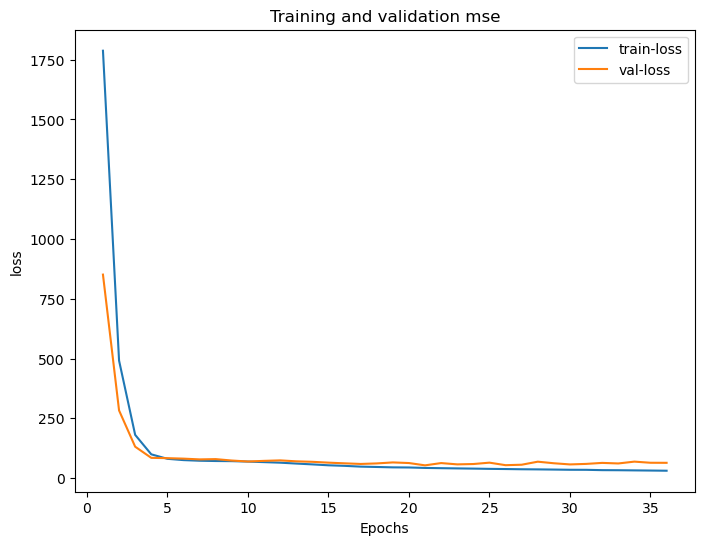

2023-01-25 22:59:34.413168: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 22:59:34.454620: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 22:59:34.462434: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


133/133 [==============================] - 2s 14ms/step
Epoch 1/1000


2023-01-25 22:59:37.417005: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 22:59:37.588182: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 22:59:37.601536: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 22:59:37.884830: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 22:59:37.899162: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


545/545 [==============================] - ETA: 0s - loss: 4.7711 - mean_squared_error: 41.6147 - mean_absolute_error: 4.7711 - accuracy: 2.3912e-06 - root_mean_squared_error: 6.4509 - logcosh: 4.1412 - kullback_leibler_divergence: -1.4614e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8876 - csi: 0.9829 - freqbiassc: 1531.5929 - f1: 0.9989 - ham: 1.9700 - match1: 4.3189 - match2: 8.4510 - match3: 12.4414 - match5: 19.5735

2023-01-25 23:00:00.016432: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:00:00.107631: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:00:00.116862: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: saving model to /Users/sn/Downloads//Models/training_1/cp.ckpt


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 33s 58ms/step - loss: 4.7711 - mean_squared_error: 41.6147 - mean_absolute_error: 4.7711 - accuracy: 2.3912e-06 - root_mean_squared_error: 6.4509 - logcosh: 4.1412 - kullback_leibler_divergence: -1.4614e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8876 - csi: 0.9829 - freqbiassc: 1531.5929 - f1: 0.9989 - ham: 1.9700 - match1: 4.3189 - match2: 8.4510 - match3: 12.4414 - match5: 19.5735 - val_loss: 6.2077 - val_mean_squared_error: 65.7840 - val_mean_absolute_error: 6.2077 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1107 - val_logcosh: 5.5579 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8212 - val_csi: 0.9931 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2715 - val_match1: 3.1119 - val_match2: 6.2615 - val_match3: 9.3175 - val_match5: 15.0706
Epoch 2/1000
545/545 [==============================] - ETA: 0s - loss: 4.7278 - mean_squared_error: 41.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 4.7278 - mean_squared_error: 41.3535 - mean_absolute_error: 4.7278 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.4307 - logcosh: 4.0996 - kullback_leibler_divergence: -1.0591e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8883 - csi: 0.9831 - freqbiassc: 1531.5911 - f1: 0.9989 - ham: 1.9574 - match1: 4.4209 - match2: 8.6377 - match3: 12.6978 - match5: 19.9166 - val_loss: 6.0689 - val_mean_squared_error: 63.6773 - val_mean_absolute_error: 6.0689 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9798 - val_logcosh: 5.4219 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8269 - val_csi: 0.9924 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2392 - val_match1: 3.3844 - val_match2: 6.6947 - val_match3: 9.9323 - val_match5: 16.0335
Epoch 3/1000
545/545 [==============================] - ETA: 0s - loss: 4.6442 - mean_squared_error: 40.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 4.6442 - mean_squared_error: 40.1075 - mean_absolute_error: 4.6442 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.3331 - logcosh: 4.0175 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8917 - csi: 0.9831 - freqbiassc: 1531.5929 - f1: 0.9989 - ham: 1.9388 - match1: 4.5103 - match2: 8.7986 - match3: 12.9133 - match5: 20.2386 - val_loss: 6.0324 - val_mean_squared_error: 64.6474 - val_mean_absolute_error: 6.0324 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0404 - val_logcosh: 5.3870 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8242 - val_csi: 0.9923 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2244 - val_match1: 3.4112 - val_match2: 6.8273 - val_match3: 10.1655 - val_match5: 16.2629
Epoch 4/1000
545/545 [==============================] - ETA: 0s - loss: 4.5937 - mean_squared_error: 39

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 4.5937 - mean_squared_error: 39.3547 - mean_absolute_error: 4.5937 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.2733 - logcosh: 3.9681 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8937 - csi: 0.9831 - freqbiassc: 1531.5935 - f1: 0.9989 - ham: 1.9271 - match1: 4.5963 - match2: 8.9793 - match3: 13.1129 - match5: 20.4476 - val_loss: 5.7865 - val_mean_squared_error: 60.1379 - val_mean_absolute_error: 5.7865 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.7549 - val_logcosh: 5.1436 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8365 - val_csi: 0.9919 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1765 - val_match1: 3.6568 - val_match2: 7.2495 - val_match3: 10.7249 - val_match5: 16.9724
Epoch 5/1000
545/545 [==============================] - ETA: 0s - loss: 4.5262 - mean_squared_error: 38

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 4.5262 - mean_squared_error: 38.3655 - mean_absolute_error: 4.5262 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.1940 - logcosh: 3.9017 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8964 - csi: 0.9831 - freqbiassc: 1531.5878 - f1: 0.9989 - ham: 1.9122 - match1: 4.6685 - match2: 9.0834 - match3: 13.3081 - match5: 20.7041 - val_loss: 6.0800 - val_mean_squared_error: 66.8955 - val_mean_absolute_error: 6.0800 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1790 - val_logcosh: 5.4375 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8181 - val_csi: 0.9927 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2234 - val_match1: 3.8139 - val_match2: 7.4988 - val_match3: 10.9111 - val_match5: 16.9178
Epoch 6/1000
545/545 [==============================] - ETA: 0s - loss: 4.5212 - mean_squared_error: 38

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 4.5212 - mean_squared_error: 38.2959 - mean_absolute_error: 4.5212 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.1884 - logcosh: 3.8973 - kullback_leibler_divergence: -1.4631e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8966 - csi: 0.9831 - freqbiassc: 1531.5875 - f1: 0.9989 - ham: 1.9106 - match1: 4.7109 - match2: 9.1605 - match3: 13.3390 - match5: 20.7225 - val_loss: 5.9829 - val_mean_squared_error: 62.6862 - val_mean_absolute_error: 5.9829 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9175 - val_logcosh: 5.3376 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8296 - val_csi: 0.9922 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2199 - val_match1: 3.5118 - val_match2: 6.9446 - val_match3: 10.2585 - val_match5: 16.2955
Epoch 7/1000
545/545 [==============================] - ETA: 0s - loss: 4.4628 - mean_squared_error: 37

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 4.4628 - mean_squared_error: 37.5497 - mean_absolute_error: 4.4628 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.1278 - logcosh: 3.8402 - kullback_leibler_divergence: -1.4158e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8986 - csi: 0.9832 - freqbiassc: 1531.5820 - f1: 0.9989 - ham: 1.8962 - match1: 4.8069 - match2: 9.3299 - match3: 13.5892 - match5: 20.9977 - val_loss: 5.9823 - val_mean_squared_error: 65.2792 - val_mean_absolute_error: 5.9823 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0796 - val_logcosh: 5.3390 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8225 - val_csi: 0.9924 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2066 - val_match1: 3.6523 - val_match2: 7.2021 - val_match3: 10.6376 - val_match5: 16.7701
Epoch 8/1000
545/545 [==============================] - ETA: 0s - loss: 4.4038 - mean_squared_error: 36

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 4.4038 - mean_squared_error: 36.6991 - mean_absolute_error: 4.4038 - accuracy: 1.1956e-06 - root_mean_squared_error: 6.0580 - logcosh: 3.7820 - kullback_leibler_divergence: -6.1270e-05 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9009 - csi: 0.9832 - freqbiassc: 1531.5692 - f1: 0.9989 - ham: 1.8832 - match1: 4.8379 - match2: 9.4082 - match3: 13.7338 - match5: 21.2445 - val_loss: 5.7342 - val_mean_squared_error: 60.8236 - val_mean_absolute_error: 5.7342 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.7990 - val_logcosh: 5.0953 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8346 - val_csi: 0.9918 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1546 - val_match1: 4.0213 - val_match2: 7.8226 - val_match3: 11.4358 - val_match5: 17.7467
Epoch 9/1000
545/545 [==============================] - ETA: 0s - loss: 4.3838 - mean_squared_error: 36

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 4.3838 - mean_squared_error: 36.2821 - mean_absolute_error: 4.3838 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.0235 - logcosh: 3.7623 - kullback_leibler_divergence: -9.8842e-05 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9020 - csi: 0.9832 - freqbiassc: 1531.5748 - f1: 0.9989 - ham: 1.8793 - match1: 4.8937 - match2: 9.4994 - match3: 13.8107 - match5: 21.3093 - val_loss: 5.6401 - val_mean_squared_error: 59.2607 - val_mean_absolute_error: 5.6401 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.6981 - val_logcosh: 5.0013 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8389 - val_csi: 0.9909 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1376 - val_match1: 3.9672 - val_match2: 7.8023 - val_match3: 11.4283 - val_match5: 17.7357
Epoch 10/1000
545/545 [==============================] - ETA: 0s - loss: 4.3281 - mean_squared_error: 3

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 4.3281 - mean_squared_error: 35.5939 - mean_absolute_error: 4.3281 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.9661 - logcosh: 3.7082 - kullback_leibler_divergence: 9.5678e-06 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9039 - csi: 0.9832 - freqbiassc: 1531.5601 - f1: 0.9989 - ham: 1.8659 - match1: 4.9692 - match2: 9.6687 - match3: 14.0210 - match5: 21.5556 - val_loss: 5.7145 - val_mean_squared_error: 61.4556 - val_mean_absolute_error: 5.7145 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.8394 - val_logcosh: 5.0774 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8329 - val_csi: 0.9917 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1447 - val_match1: 4.1029 - val_match2: 8.0082 - val_match3: 11.6876 - val_match5: 17.9537
Epoch 11/1000
545/545 [==============================] - ETA: 0s - loss: 4.3010 - mean_squared_error: 35

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 4.3010 - mean_squared_error: 35.0010 - mean_absolute_error: 4.3010 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.9162 - logcosh: 3.6810 - kullback_leibler_divergence: 5.7549e-05 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9055 - csi: 0.9832 - freqbiassc: 1531.5784 - f1: 0.9989 - ham: 1.8614 - match1: 4.9604 - match2: 9.6414 - match3: 14.0222 - match5: 21.5709 - val_loss: 6.4660 - val_mean_squared_error: 75.5626 - val_mean_absolute_error: 6.4660 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.6927 - val_logcosh: 5.8201 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7946 - val_csi: 0.9931 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2932 - val_match1: 3.6029 - val_match2: 7.1081 - val_match3: 10.4246 - val_match5: 16.3255
Epoch 12/1000
545/545 [==============================] - ETA: 0s - loss: 4.2640 - mean_squared_error: 34

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 4.2640 - mean_squared_error: 34.4764 - mean_absolute_error: 4.2640 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.8717 - logcosh: 3.6448 - kullback_leibler_divergence: 1.4258e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9069 - csi: 0.9832 - freqbiassc: 1531.5511 - f1: 0.9989 - ham: 1.8525 - match1: 5.0174 - match2: 9.7331 - match3: 14.1717 - match5: 21.7318 - val_loss: 6.3015 - val_mean_squared_error: 73.6807 - val_mean_absolute_error: 6.3015 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.5837 - val_logcosh: 5.6586 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7997 - val_csi: 0.9927 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2551 - val_match1: 3.8111 - val_match2: 7.4495 - val_match3: 10.9066 - val_match5: 16.9110
Epoch 13/1000
545/545 [==============================] - ETA: 0s - loss: 4.2153 - mean_squared_error: 33

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 4.2153 - mean_squared_error: 33.8275 - mean_absolute_error: 4.2153 - accuracy: 2.3912e-06 - root_mean_squared_error: 5.8161 - logcosh: 3.5970 - kullback_leibler_divergence: 1.7069e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9086 - csi: 0.9832 - freqbiassc: 1531.5581 - f1: 0.9989 - ham: 1.8412 - match1: 5.0669 - match2: 9.8746 - match3: 14.3294 - match5: 21.9604 - val_loss: 5.7801 - val_mean_squared_error: 64.5174 - val_mean_absolute_error: 5.7801 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0323 - val_logcosh: 5.1438 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8246 - val_csi: 0.9910 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1488 - val_match1: 4.1507 - val_match2: 8.1599 - val_match3: 11.8487 - val_match5: 18.2247
Epoch 14/1000
545/545 [==============================] - ETA: 0s - loss: 4.2214 - mean_squared_error: 33

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 4.2214 - mean_squared_error: 33.7811 - mean_absolute_error: 4.2214 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.8122 - logcosh: 3.6026 - kullback_leibler_divergence: 7.6534e-05 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9088 - csi: 0.9832 - freqbiassc: 1531.5673 - f1: 0.9989 - ham: 1.8441 - match1: 5.0288 - match2: 9.7776 - match3: 14.2322 - match5: 21.8224 - val_loss: 6.0973 - val_mean_squared_error: 68.8681 - val_mean_absolute_error: 6.0973 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2987 - val_logcosh: 5.4561 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8127 - val_csi: 0.9923 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2181 - val_match1: 3.9146 - val_match2: 7.6646 - val_match3: 11.2244 - val_match5: 17.4061
Epoch 15/1000
545/545 [==============================] - ETA: 0s - loss: 4.1437 - mean_squared_error: 32

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 4.1437 - mean_squared_error: 32.7262 - mean_absolute_error: 4.1437 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.7207 - logcosh: 3.5264 - kullback_leibler_divergence: 1.4080e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9116 - csi: 0.9832 - freqbiassc: 1531.5690 - f1: 0.9989 - ham: 1.8258 - match1: 5.1424 - match2: 10.0048 - match3: 14.5135 - match5: 22.2068 - val_loss: 5.8446 - val_mean_squared_error: 64.0845 - val_mean_absolute_error: 5.8446 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.0053 - val_logcosh: 5.2059 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8258 - val_csi: 0.9916 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1702 - val_match1: 3.9881 - val_match2: 7.7804 - val_match3: 11.3379 - val_match5: 17.6286
Epoch 16/1000
545/545 [==============================] - ETA: 0s - loss: 4.1286 - mean_squared_error: 3

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 4.1286 - mean_squared_error: 32.5461 - mean_absolute_error: 4.1286 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.7049 - logcosh: 3.5118 - kullback_leibler_divergence: 1.1158e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9121 - csi: 0.9833 - freqbiassc: 1531.5767 - f1: 0.9989 - ham: 1.8217 - match1: 5.1805 - match2: 10.0781 - match3: 14.5986 - match5: 22.2977 - val_loss: 6.2390 - val_mean_squared_error: 71.2413 - val_mean_absolute_error: 6.2390 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4405 - val_logcosh: 5.5949 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8063 - val_csi: 0.9927 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2499 - val_match1: 3.6645 - val_match2: 7.2421 - val_match3: 10.5824 - val_match5: 16.6649
Epoch 17/1000
545/545 [==============================] - ETA: 0s - loss: 4.1004 - mean_squared_error: 3

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 4.1004 - mean_squared_error: 31.9952 - mean_absolute_error: 4.1004 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.6564 - logcosh: 3.4837 - kullback_leibler_divergence: 1.2574e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9136 - csi: 0.9832 - freqbiassc: 1531.5874 - f1: 0.9990 - ham: 1.8167 - match1: 5.1524 - match2: 10.0321 - match3: 14.6104 - match5: 22.3681 - val_loss: 6.0934 - val_mean_squared_error: 70.0285 - val_mean_absolute_error: 6.0934 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3683 - val_logcosh: 5.4518 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8096 - val_csi: 0.9921 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2160 - val_match1: 3.7727 - val_match2: 7.3970 - val_match3: 10.7933 - val_match5: 17.0079
Epoch 18/1000
545/545 [==============================] - ETA: 0s - loss: 4.0464 - mean_squared_error: 3

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 4.0464 - mean_squared_error: 31.2230 - mean_absolute_error: 4.0464 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.5878 - logcosh: 3.4310 - kullback_leibler_divergence: 1.9872e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9157 - csi: 0.9833 - freqbiassc: 1531.5911 - f1: 0.9990 - ham: 1.8040 - match1: 5.2691 - match2: 10.2003 - match3: 14.8018 - match5: 22.5952 - val_loss: 6.0677 - val_mean_squared_error: 69.5404 - val_mean_absolute_error: 6.0677 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3391 - val_logcosh: 5.4268 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8109 - val_csi: 0.9922 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2093 - val_match1: 3.8818 - val_match2: 7.6101 - val_match3: 11.1140 - val_match5: 17.3167
Epoch 19/1000
545/545 [==============================] - ETA: 0s - loss: 4.0284 - mean_squared_error: 3

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 4.0284 - mean_squared_error: 30.8869 - mean_absolute_error: 4.0284 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.5576 - logcosh: 3.4130 - kullback_leibler_divergence: 2.1864e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9166 - csi: 0.9833 - freqbiassc: 1531.5787 - f1: 0.9990 - ham: 1.8009 - match1: 5.2601 - match2: 10.2009 - match3: 14.8328 - match5: 22.5802 - val_loss: 5.8758 - val_mean_squared_error: 65.1060 - val_mean_absolute_error: 5.8758 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0688 - val_logcosh: 5.2360 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8230 - val_csi: 0.9911 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1754 - val_match1: 3.8984 - val_match2: 7.6776 - val_match3: 11.2784 - val_match5: 17.5919
Epoch 20/1000
545/545 [==============================] - ETA: 0s - loss: 4.0058 - mean_squared_error: 3

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 4.0058 - mean_squared_error: 30.5734 - mean_absolute_error: 4.0058 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.5293 - logcosh: 3.3910 - kullback_leibler_divergence: 2.3527e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9174 - csi: 0.9833 - freqbiassc: 1531.5985 - f1: 0.9990 - ham: 1.7954 - match1: 5.3031 - match2: 10.2954 - match3: 14.9126 - match5: 22.6891 - val_loss: 6.2118 - val_mean_squared_error: 72.4379 - val_mean_absolute_error: 6.2118 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.5110 - val_logcosh: 5.5705 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8030 - val_csi: 0.9920 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2340 - val_match1: 3.8267 - val_match2: 7.5190 - val_match3: 11.0346 - val_match5: 17.2136
Epoch 21/1000
545/545 [==============================] - ETA: 0s - loss: 3.9867 - mean_squared_error: 3

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 3.9867 - mean_squared_error: 30.3153 - mean_absolute_error: 3.9867 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.5059 - logcosh: 3.3727 - kullback_leibler_divergence: 4.9658e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9181 - csi: 0.9834 - freqbiassc: 1531.5803 - f1: 0.9990 - ham: 1.7908 - match1: 5.3883 - match2: 10.3650 - match3: 14.9530 - match5: 22.7557 - val_loss: 6.0621 - val_mean_squared_error: 68.1902 - val_mean_absolute_error: 6.0621 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2577 - val_logcosh: 5.4205 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8146 - val_csi: 0.9924 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2130 - val_match1: 3.8048 - val_match2: 7.4981 - val_match3: 10.9750 - val_match5: 17.1658
Epoch 22/1000
545/545 [==============================] - ETA: 0s - loss: 3.9635 - mean_squared_error: 2

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 3.9635 - mean_squared_error: 29.9055 - mean_absolute_error: 3.9635 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.4686 - logcosh: 3.3497 - kullback_leibler_divergence: 2.0503e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9192 - csi: 0.9834 - freqbiassc: 1531.6370 - f1: 0.9990 - ham: 1.7860 - match1: 5.3814 - match2: 10.3931 - match3: 15.0156 - match5: 22.8046 - val_loss: 6.3504 - val_mean_squared_error: 72.4401 - val_mean_absolute_error: 6.3504 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.5112 - val_logcosh: 5.7018 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8030 - val_csi: 0.9932 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2823 - val_match1: 3.3321 - val_match2: 6.5912 - val_match3: 9.7964 - val_match5: 15.7034
Epoch 23/1000
545/545 [==============================] - ETA: 0s - loss: 3.9218 - mean_squared_error: 29

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 3.9218 - mean_squared_error: 29.3633 - mean_absolute_error: 3.9217 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.4188 - logcosh: 3.3088 - kullback_leibler_divergence: 2.3517e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9207 - csi: 0.9834 - freqbiassc: 1531.6152 - f1: 0.9990 - ham: 1.7761 - match1: 5.4290 - match2: 10.5226 - match3: 15.1586 - match5: 23.0162 - val_loss: 5.8291 - val_mean_squared_error: 64.8597 - val_mean_absolute_error: 5.8291 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0536 - val_logcosh: 5.1912 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8236 - val_csi: 0.9914 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1619 - val_match1: 4.1337 - val_match2: 8.0582 - val_match3: 11.7452 - val_match5: 18.0738
Epoch 24/1000
545/545 [==============================] - ETA: 0s - loss: 3.8971 - mean_squared_error: 2

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 3.8971 - mean_squared_error: 28.9585 - mean_absolute_error: 3.8971 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.3813 - logcosh: 3.2843 - kullback_leibler_divergence: 2.1331e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9218 - csi: 0.9834 - freqbiassc: 1531.6500 - f1: 0.9991 - ham: 1.7711 - match1: 5.4388 - match2: 10.5080 - match3: 15.2095 - match5: 23.1078 - val_loss: 6.3135 - val_mean_squared_error: 74.0069 - val_mean_absolute_error: 6.3135 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.6027 - val_logcosh: 5.6700 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7988 - val_csi: 0.9926 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2574 - val_match1: 3.7392 - val_match2: 7.3090 - val_match3: 10.7305 - val_match5: 16.8121
TEST PERFORMANCE: MeanAbsoluteEr
133/133 [==============================] - 4s 27ms/step - loss: 6.1366

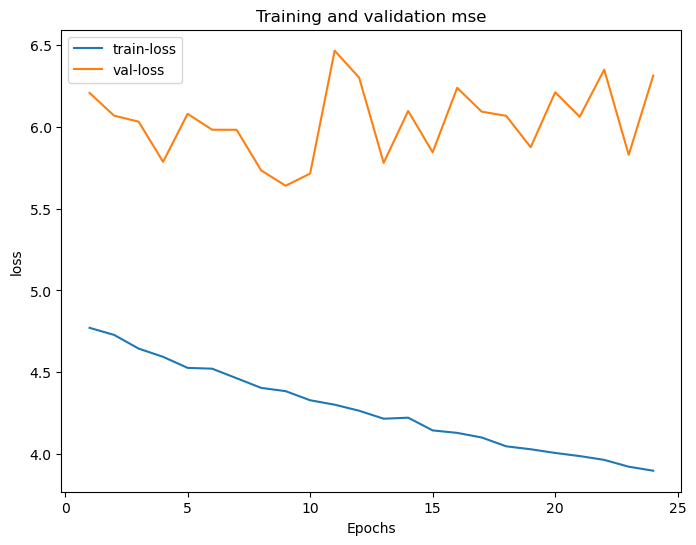

2023-01-25 23:11:50.199511: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:11:50.239544: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:11:50.247255: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


133/133 [==============================] - 2s 14ms/step
Epoch 1/1000


2023-01-25 23:11:53.382561: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:11:53.561031: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:11:53.593054: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:11:53.999247: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:11:54.013442: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


545/545 [==============================] - ETA: 0s - loss: 0.0367 - mean_squared_error: 38.1890 - mean_absolute_error: 4.5750 - accuracy: 1.1956e-06 - root_mean_squared_error: 6.1797 - logcosh: 3.9475 - kullback_leibler_divergence: 6.0892e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8968 - csi: 0.9814 - freqbiassc: 1531.5837 - f1: 0.9990 - ham: 1.9308 - match1: 4.3841 - match2: 8.5539 - match3: 12.5667 - match5: 19.7896

2023-01-25 23:12:16.521462: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:12:16.619739: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:12:16.631343: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: saving model to /Users/sn/Downloads//Models/training_1/cp.ckpt


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 34s 59ms/step - loss: 0.0367 - mean_squared_error: 38.1890 - mean_absolute_error: 4.5750 - accuracy: 1.1956e-06 - root_mean_squared_error: 6.1797 - logcosh: 3.9475 - kullback_leibler_divergence: 6.0892e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8968 - csi: 0.9814 - freqbiassc: 1531.5837 - f1: 0.9990 - ham: 1.9308 - match1: 4.3841 - match2: 8.5539 - match3: 12.5667 - match5: 19.7896 - val_loss: 0.0499 - val_mean_squared_error: 59.8232 - val_mean_absolute_error: 5.8263 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.7345 - val_logcosh: 5.1827 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8374 - val_csi: 0.9914 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1890 - val_match1: 3.6208 - val_match2: 7.1226 - val_match3: 10.4881 - val_match5: 16.6038
Epoch 2/1000
545/545 [==============================] - ETA: 0s - loss: 0.0324 - mean_squared_error: 37.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0324 - mean_squared_error: 37.6223 - mean_absolute_error: 4.5590 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.1337 - logcosh: 3.9314 - kullback_leibler_divergence: 6.7567e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8984 - csi: 0.9821 - freqbiassc: 1531.8938 - f1: 0.9995 - ham: 1.9295 - match1: 4.3482 - match2: 8.5117 - match3: 12.5040 - match5: 19.7335 - val_loss: 0.0485 - val_mean_squared_error: 56.4615 - val_mean_absolute_error: 5.5730 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 7.5141 - val_logcosh: 4.9339 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8465 - val_csi: 0.9901 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1307 - val_match1: 3.8961 - val_match2: 7.6157 - val_match3: 11.1903 - val_match5: 17.6511
Epoch 3/1000
545/545 [==============================] - ETA: 0s - loss: 0.0313 - mean_squared_error: 38.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0313 - mean_squared_error: 38.1741 - mean_absolute_error: 4.5995 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.1785 - logcosh: 3.9710 - kullback_leibler_divergence: 0.0016 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8969 - csi: 0.9824 - freqbiassc: 1532.1615 - f1: 0.9999 - ham: 1.9389 - match1: 4.2843 - match2: 8.3993 - match3: 12.3832 - match5: 19.5340 - val_loss: 0.0511 - val_mean_squared_error: 62.9848 - val_mean_absolute_error: 5.9302 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9363 - val_logcosh: 5.2864 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8288 - val_csi: 0.9916 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2037 - val_match1: 3.5776 - val_match2: 6.9992 - val_match3: 10.3021 - val_match5: 16.4647
Epoch 4/1000
545/545 [==============================] - ETA: 0s - loss: 0.0293 - mean_squared_error: 36.9026

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0293 - mean_squared_error: 36.9026 - mean_absolute_error: 4.5145 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.0748 - logcosh: 3.8876 - kullback_leibler_divergence: 0.0017 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9003 - csi: 0.9827 - freqbiassc: 1532.3287 - f1: 1.0001 - ham: 1.9195 - match1: 4.4067 - match2: 8.6050 - match3: 12.6657 - match5: 19.8950 - val_loss: 0.0506 - val_mean_squared_error: 60.4723 - val_mean_absolute_error: 5.7436 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.7764 - val_logcosh: 5.1033 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8356 - val_csi: 0.9900 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1606 - val_match1: 3.7902 - val_match2: 7.4956 - val_match3: 10.9924 - val_match5: 17.2658
Epoch 5/1000
545/545 [==============================] - ETA: 0s - loss: 0.0279 - mean_squared_error: 35.9548

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0279 - mean_squared_error: 35.9548 - mean_absolute_error: 4.4718 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.9962 - logcosh: 3.8449 - kullback_leibler_divergence: 0.0020 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9029 - csi: 0.9829 - freqbiassc: 1532.5010 - f1: 1.0003 - ham: 1.9127 - match1: 4.4141 - match2: 8.6215 - match3: 12.6333 - match5: 19.9131 - val_loss: 0.0568 - val_mean_squared_error: 71.2243 - val_mean_absolute_error: 6.3811 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4395 - val_logcosh: 5.7319 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8064 - val_csi: 0.9930 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2944 - val_match1: 3.2355 - val_match2: 6.3704 - val_match3: 9.4112 - val_match5: 15.2256
Epoch 6/1000
545/545 [==============================] - ETA: 0s - loss: 0.0279 - mean_squared_error: 36.4806 

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0279 - mean_squared_error: 36.4806 - mean_absolute_error: 4.5092 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.0399 - logcosh: 3.8817 - kullback_leibler_divergence: 0.0016 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9015 - csi: 0.9831 - freqbiassc: 1532.6129 - f1: 1.0004 - ham: 1.9214 - match1: 4.3594 - match2: 8.5567 - match3: 12.5722 - match5: 19.8241 - val_loss: 0.0548 - val_mean_squared_error: 64.5315 - val_mean_absolute_error: 5.9324 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0332 - val_logcosh: 5.2921 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8245 - val_csi: 0.9882 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1912 - val_match1: 3.7884 - val_match2: 7.5113 - val_match3: 11.0543 - val_match5: 17.4398
Epoch 7/1000
545/545 [==============================] - ETA: 0s - loss: 0.0271 - mean_squared_error: 35.9547

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0271 - mean_squared_error: 35.9547 - mean_absolute_error: 4.4855 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.9962 - logcosh: 3.8585 - kullback_leibler_divergence: 0.0018 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9029 - csi: 0.9832 - freqbiassc: 1532.7086 - f1: 1.0004 - ham: 1.9163 - match1: 4.4149 - match2: 8.5949 - match3: 12.6200 - match5: 19.8184 - val_loss: 0.0508 - val_mean_squared_error: 57.6739 - val_mean_absolute_error: 5.5589 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 7.5943 - val_logcosh: 4.9208 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8432 - val_csi: 0.9894 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1208 - val_match1: 3.9654 - val_match2: 7.8527 - val_match3: 11.5389 - val_match5: 18.1464
Epoch 8/1000
545/545 [==============================] - ETA: 0s - loss: 0.0258 - mean_squared_error: 35.0836

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 0.0258 - mean_squared_error: 35.0836 - mean_absolute_error: 4.4330 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.9231 - logcosh: 3.8063 - kullback_leibler_divergence: 0.0021 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9052 - csi: 0.9832 - freqbiassc: 1532.7435 - f1: 1.0005 - ham: 1.9060 - match1: 4.4012 - match2: 8.6310 - match3: 12.6950 - match5: 19.9795 - val_loss: 0.0538 - val_mean_squared_error: 67.0119 - val_mean_absolute_error: 6.1532 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1861 - val_logcosh: 5.5060 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8178 - val_csi: 0.9924 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2503 - val_match1: 3.3743 - val_match2: 6.6903 - val_match3: 9.8989 - val_match5: 15.8650
Epoch 9/1000
545/545 [==============================] - ETA: 0s - loss: 0.0265 - mean_squared_error: 35.7456 

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0265 - mean_squared_error: 35.7456 - mean_absolute_error: 4.4715 - accuracy: 2.3912e-06 - root_mean_squared_error: 5.9788 - logcosh: 3.8445 - kullback_leibler_divergence: 0.0020 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9034 - csi: 0.9832 - freqbiassc: 1532.6847 - f1: 1.0005 - ham: 1.9135 - match1: 4.3920 - match2: 8.6024 - match3: 12.6358 - match5: 19.9008 - val_loss: 0.0502 - val_mean_squared_error: 57.9062 - val_mean_absolute_error: 5.6671 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.6096 - val_logcosh: 5.0252 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8426 - val_csi: 0.9908 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1541 - val_match1: 3.7764 - val_match2: 7.4690 - val_match3: 10.9566 - val_match5: 17.4029
Epoch 10/1000
545/545 [==============================] - ETA: 0s - loss: 0.0249 - mean_squared_error: 34.285

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 0.0249 - mean_squared_error: 34.2850 - mean_absolute_error: 4.3827 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.8553 - logcosh: 3.7569 - kullback_leibler_divergence: 0.0018 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9074 - csi: 0.9833 - freqbiassc: 1532.7947 - f1: 1.0005 - ham: 1.8951 - match1: 4.4745 - match2: 8.7091 - match3: 12.7855 - match5: 20.1106 - val_loss: 0.0480 - val_mean_squared_error: 55.8849 - val_mean_absolute_error: 5.4313 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.4756 - val_logcosh: 4.7950 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8481 - val_csi: 0.9885 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.0932 - val_match1: 4.0202 - val_match2: 7.8920 - val_match3: 11.5787 - val_match5: 18.3212
Epoch 11/1000
545/545 [==============================] - ETA: 0s - loss: 0.0244 - mean_squared_error: 34.299

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 0.0244 - mean_squared_error: 34.2997 - mean_absolute_error: 4.3741 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.8566 - logcosh: 3.7485 - kullback_leibler_divergence: 0.0025 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9074 - csi: 0.9835 - freqbiassc: 1532.8063 - f1: 1.0006 - ham: 1.8924 - match1: 4.4724 - match2: 8.7568 - match3: 12.8450 - match5: 20.1876 - val_loss: 0.0457 - val_mean_squared_error: 52.9990 - val_mean_absolute_error: 5.3170 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.2800 - val_logcosh: 4.6825 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8559 - val_csi: 0.9880 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.0715 - val_match1: 4.1427 - val_match2: 8.1721 - val_match3: 12.0124 - val_match5: 18.9381
Epoch 12/1000
545/545 [==============================] - ETA: 0s - loss: 0.0240 - mean_squared_error: 33.306

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0240 - mean_squared_error: 33.3068 - mean_absolute_error: 4.3282 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.7712 - logcosh: 3.7029 - kullback_leibler_divergence: 0.0030 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9100 - csi: 0.9833 - freqbiassc: 1532.7416 - f1: 1.0006 - ham: 1.8839 - match1: 4.4821 - match2: 8.7850 - match3: 12.8945 - match5: 20.2843 - val_loss: 0.0565 - val_mean_squared_error: 67.3877 - val_mean_absolute_error: 6.0894 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2090 - val_logcosh: 5.4466 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8168 - val_csi: 0.9921 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2253 - val_match1: 3.7929 - val_match2: 7.4298 - val_match3: 10.8341 - val_match5: 16.9005
Epoch 13/1000
545/545 [==============================] - ETA: 0s - loss: 0.0230 - mean_squared_error: 33.440

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 0.0230 - mean_squared_error: 33.4405 - mean_absolute_error: 4.3314 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.7828 - logcosh: 3.7067 - kullback_leibler_divergence: 0.0024 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9097 - csi: 0.9835 - freqbiassc: 1532.8204 - f1: 1.0007 - ham: 1.8835 - match1: 4.5167 - match2: 8.8114 - match3: 12.9323 - match5: 20.2693 - val_loss: 0.0540 - val_mean_squared_error: 61.7578 - val_mean_absolute_error: 5.7650 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.8586 - val_logcosh: 5.1249 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8321 - val_csi: 0.9908 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1610 - val_match1: 3.8922 - val_match2: 7.6541 - val_match3: 11.2064 - val_match5: 17.6760
Epoch 14/1000
545/545 [==============================] - ETA: 0s - loss: 0.0236 - mean_squared_error: 33.849

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 0.0236 - mean_squared_error: 33.8498 - mean_absolute_error: 4.3723 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.8181 - logcosh: 3.7462 - kullback_leibler_divergence: 0.0032 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9086 - csi: 0.9835 - freqbiassc: 1532.6718 - f1: 1.0006 - ham: 1.8945 - match1: 4.4156 - match2: 8.6845 - match3: 12.7335 - match5: 20.0429 - val_loss: 0.0503 - val_mean_squared_error: 56.5241 - val_mean_absolute_error: 5.5041 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.5183 - val_logcosh: 4.8663 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8463 - val_csi: 0.9892 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1117 - val_match1: 3.9920 - val_match2: 7.8455 - val_match3: 11.5525 - val_match5: 18.1589
Epoch 15/1000
545/545 [==============================] - ETA: 0s - loss: 0.0222 - mean_squared_error: 33.034

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 0.0222 - mean_squared_error: 33.0347 - mean_absolute_error: 4.3245 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.7476 - logcosh: 3.6992 - kullback_leibler_divergence: 0.0027 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9108 - csi: 0.9836 - freqbiassc: 1532.8680 - f1: 1.0008 - ham: 1.8844 - match1: 4.4717 - match2: 8.7472 - match3: 12.8318 - match5: 20.1631 - val_loss: 0.0648 - val_mean_squared_error: 84.8073 - val_mean_absolute_error: 6.9299 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 9.2091 - val_logcosh: 6.2798 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7695 - val_csi: 0.9930 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.3827 - val_match1: 3.2611 - val_match2: 6.4057 - val_match3: 9.3995 - val_match5: 14.8604
Epoch 16/1000
545/545 [==============================] - ETA: 0s - loss: 0.0233 - mean_squared_error: 34.2016

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 0.0233 - mean_squared_error: 34.2016 - mean_absolute_error: 4.3996 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.8482 - logcosh: 3.7732 - kullback_leibler_divergence: 0.0029 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9076 - csi: 0.9837 - freqbiassc: 1532.7910 - f1: 1.0007 - ham: 1.9004 - match1: 4.4016 - match2: 8.6124 - match3: 12.6514 - match5: 19.8859 - val_loss: 0.0548 - val_mean_squared_error: 64.9912 - val_mean_absolute_error: 5.9770 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0617 - val_logcosh: 5.3348 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8233 - val_csi: 0.9917 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2053 - val_match1: 3.7992 - val_match2: 7.4388 - val_match3: 10.8715 - val_match5: 17.0133
Epoch 17/1000
545/545 [==============================] - ETA: 0s - loss: 0.0218 - mean_squared_error: 32.379

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 0.0218 - mean_squared_error: 32.3794 - mean_absolute_error: 4.2819 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.6903 - logcosh: 3.6572 - kullback_leibler_divergence: 0.0031 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9125 - csi: 0.9836 - freqbiassc: 1532.8352 - f1: 1.0008 - ham: 1.8751 - match1: 4.5229 - match2: 8.8136 - match3: 12.9147 - match5: 20.2957 - val_loss: 0.0541 - val_mean_squared_error: 64.1544 - val_mean_absolute_error: 5.8496 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0096 - val_logcosh: 5.2098 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8256 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1724 - val_match1: 3.8901 - val_match2: 7.6698 - val_match3: 11.2668 - val_match5: 17.6944
Epoch 18/1000
544/545 [============================>.] - ETA: 0s - loss: 0.0226 - mean_squared_error: 34.107

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 0.0226 - mean_squared_error: 34.0956 - mean_absolute_error: 4.3903 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.8391 - logcosh: 3.7640 - kullback_leibler_divergence: 0.0032 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9079 - csi: 0.9837 - freqbiassc: 1532.8901 - f1: 1.0008 - ham: 1.8985 - match1: 4.3811 - match2: 8.6030 - match3: 12.6231 - match5: 19.8917 - val_loss: 0.0552 - val_mean_squared_error: 64.7041 - val_mean_absolute_error: 5.9461 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0439 - val_logcosh: 5.3040 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8241 - val_csi: 0.9916 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1990 - val_match1: 3.7803 - val_match2: 7.4084 - val_match3: 10.8535 - val_match5: 17.0008
Epoch 19/1000
545/545 [==============================] - ETA: 0s - loss: 0.0200 - mean_squared_error: 30.987

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 0.0200 - mean_squared_error: 30.9875 - mean_absolute_error: 4.1927 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.5666 - logcosh: 3.5693 - kullback_leibler_divergence: 0.0031 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9163 - csi: 0.9838 - freqbiassc: 1532.9449 - f1: 1.0009 - ham: 1.8562 - match1: 4.5733 - match2: 8.9453 - match3: 13.1050 - match5: 20.6022 - val_loss: 0.0552 - val_mean_squared_error: 66.8254 - val_mean_absolute_error: 6.0148 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1747 - val_logcosh: 5.3737 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8183 - val_csi: 0.9909 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2064 - val_match1: 3.7811 - val_match2: 7.4457 - val_match3: 10.9187 - val_match5: 17.0452
Epoch 20/1000
545/545 [==============================] - ETA: 0s - loss: 0.0217 - mean_squared_error: 33.653

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0217 - mean_squared_error: 33.6535 - mean_absolute_error: 4.3753 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.8012 - logcosh: 3.7486 - kullback_leibler_divergence: 0.0027 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9091 - csi: 0.9835 - freqbiassc: 1532.9103 - f1: 1.0009 - ham: 1.8974 - match1: 4.3231 - match2: 8.4878 - match3: 12.4808 - match5: 19.7952 - val_loss: 0.0549 - val_mean_squared_error: 66.8709 - val_mean_absolute_error: 6.0268 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1775 - val_logcosh: 5.3843 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8182 - val_csi: 0.9910 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2121 - val_match1: 3.6876 - val_match2: 7.2773 - val_match3: 10.7149 - val_match5: 16.8873
Epoch 21/1000
545/545 [==============================] - ETA: 0s - loss: 0.0213 - mean_squared_error: 32.687

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 0.0213 - mean_squared_error: 32.6871 - mean_absolute_error: 4.3067 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.7173 - logcosh: 3.6811 - kullback_leibler_divergence: 0.0031 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9117 - csi: 0.9835 - freqbiassc: 1532.8553 - f1: 1.0008 - ham: 1.8821 - match1: 4.4210 - match2: 8.6625 - match3: 12.7242 - match5: 20.0881 - val_loss: 0.0549 - val_mean_squared_error: 65.3129 - val_mean_absolute_error: 5.8865 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0816 - val_logcosh: 5.2467 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8224 - val_csi: 0.9902 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1785 - val_match1: 3.8833 - val_match2: 7.6549 - val_match3: 11.2177 - val_match5: 17.6480
Epoch 22/1000
545/545 [==============================] - ETA: 0s - loss: 0.0201 - mean_squared_error: 31.754

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 0.0201 - mean_squared_error: 31.7546 - mean_absolute_error: 4.2540 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.6351 - logcosh: 3.6292 - kullback_leibler_divergence: 0.0032 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9142 - csi: 0.9837 - freqbiassc: 1532.9233 - f1: 1.0009 - ham: 1.8712 - match1: 4.4391 - match2: 8.7210 - match3: 12.8137 - match5: 20.2303 - val_loss: 0.0575 - val_mean_squared_error: 67.2927 - val_mean_absolute_error: 5.9506 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2032 - val_logcosh: 5.3114 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8170 - val_csi: 0.9914 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1870 - val_match1: 4.0169 - val_match2: 7.8395 - val_match3: 11.3402 - val_match5: 17.5470
Epoch 23/1000
545/545 [==============================] - ETA: 0s - loss: 0.0212 - mean_squared_error: 32.143

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 0.0212 - mean_squared_error: 32.1435 - mean_absolute_error: 4.2766 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.6695 - logcosh: 3.6514 - kullback_leibler_divergence: 0.0030 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9132 - csi: 0.9837 - freqbiassc: 1532.8774 - f1: 1.0008 - ham: 1.8760 - match1: 4.4419 - match2: 8.7132 - match3: 12.8134 - match5: 20.2119 - val_loss: 0.0508 - val_mean_squared_error: 57.2553 - val_mean_absolute_error: 5.5201 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.5667 - val_logcosh: 4.8823 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8443 - val_csi: 0.9880 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1135 - val_match1: 3.9416 - val_match2: 7.7810 - val_match3: 11.4940 - val_match5: 18.1870
Epoch 24/1000
545/545 [==============================] - ETA: 0s - loss: 0.0194 - mean_squared_error: 31.131

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 0.0194 - mean_squared_error: 31.1319 - mean_absolute_error: 4.2079 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.5796 - logcosh: 3.5841 - kullback_leibler_divergence: 0.0031 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9159 - csi: 0.9839 - freqbiassc: 1532.9801 - f1: 1.0010 - ham: 1.8603 - match1: 4.5279 - match2: 8.8849 - match3: 13.0156 - match5: 20.4208 - val_loss: 0.0550 - val_mean_squared_error: 64.8111 - val_mean_absolute_error: 5.9278 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0505 - val_logcosh: 5.2863 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8238 - val_csi: 0.9914 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1939 - val_match1: 3.8066 - val_match2: 7.4890 - val_match3: 10.9321 - val_match5: 17.0617
Epoch 25/1000
545/545 [==============================] - ETA: 0s - loss: 0.0192 - mean_squared_error: 30.842

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0192 - mean_squared_error: 30.8425 - mean_absolute_error: 4.1941 - accuracy: 2.3912e-06 - root_mean_squared_error: 5.5536 - logcosh: 3.5705 - kullback_leibler_divergence: 0.0029 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9167 - csi: 0.9840 - freqbiassc: 1533.0057 - f1: 1.0010 - ham: 1.8580 - match1: 4.5553 - match2: 8.8800 - match3: 13.0446 - match5: 20.4525 - val_loss: 0.0566 - val_mean_squared_error: 66.8543 - val_mean_absolute_error: 5.9450 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1764 - val_logcosh: 5.3051 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8182 - val_csi: 0.9911 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1887 - val_match1: 3.9058 - val_match2: 7.6472 - val_match3: 11.1753 - val_match5: 17.4011
Epoch 26/1000
545/545 [==============================] - ETA: 0s - loss: 0.0178 - mean_squared_error: 29.567

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 0.0178 - mean_squared_error: 29.5675 - mean_absolute_error: 4.1081 - accuracy: 2.3912e-06 - root_mean_squared_error: 5.4376 - logcosh: 3.4857 - kullback_leibler_divergence: 0.0027 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9201 - csi: 0.9840 - freqbiassc: 1533.0095 - f1: 1.0010 - ham: 1.8390 - match1: 4.6191 - match2: 9.0088 - match3: 13.1896 - match5: 20.7066 - val_loss: 0.0539 - val_mean_squared_error: 61.2763 - val_mean_absolute_error: 5.7026 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.8279 - val_logcosh: 5.0636 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8334 - val_csi: 0.9902 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1466 - val_match1: 3.9872 - val_match2: 7.8052 - val_match3: 11.4203 - val_match5: 17.9684
TEST PERFORMANCE: MeanSquaredLog
133/133 [==============================] - 4s 27ms/step - loss: 0.0739 - me

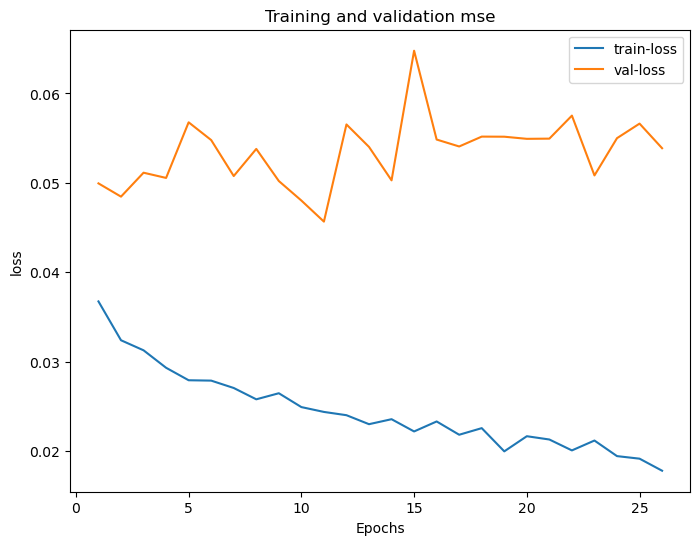

2023-01-25 23:25:18.119779: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:25:18.161178: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:25:18.169151: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


133/133 [==============================] - 2s 14ms/step
Epoch 1/1000


2023-01-25 23:25:21.503137: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:25:21.677434: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:25:21.693471: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:25:22.000824: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:25:22.017150: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


545/545 [==============================] - ETA: 0s - loss: 3.6070 - mean_squared_error: 32.7880 - mean_absolute_error: 4.2283 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.7261 - logcosh: 3.6070 - kullback_leibler_divergence: 0.0011 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9114 - csi: 0.9841 - freqbiassc: 1532.4314 - f1: 1.0001 - ham: 1.8535 - match1: 4.8437 - match2: 9.4344 - match3: 13.7578 - match5: 21.2852

2023-01-25 23:25:44.631882: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:25:44.723456: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:25:44.738825: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: saving model to /Users/sn/Downloads//Models/training_1/cp.ckpt


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 35s 60ms/step - loss: 3.6070 - mean_squared_error: 32.7880 - mean_absolute_error: 4.2283 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.7261 - logcosh: 3.6070 - kullback_leibler_divergence: 0.0011 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9114 - csi: 0.9841 - freqbiassc: 1532.4314 - f1: 1.0001 - ham: 1.8535 - match1: 4.8437 - match2: 9.4344 - match3: 13.7578 - match5: 21.2852 - val_loss: 6.0047 - val_mean_squared_error: 77.8951 - val_mean_absolute_error: 6.6558 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8258 - val_logcosh: 6.0047 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7882 - val_csi: 0.9939 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.3421 - val_match1: 3.1330 - val_match2: 6.2022 - val_match3: 9.2146 - val_match5: 14.8310
Epoch 2/1000
545/545 [==============================] - ETA: 0s - loss: 3.5175 - mean_squared_error: 31.5815 

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 3.5175 - mean_squared_error: 31.5815 - mean_absolute_error: 4.1367 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.6197 - logcosh: 3.5175 - kullback_leibler_divergence: 8.6493e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9147 - csi: 0.9840 - freqbiassc: 1532.2441 - f1: 0.9999 - ham: 1.8318 - match1: 4.9896 - match2: 9.6583 - match3: 14.0790 - match5: 21.6975 - val_loss: 5.7106 - val_mean_squared_error: 73.2583 - val_mean_absolute_error: 6.3576 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.5591 - val_logcosh: 5.7105 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8008 - val_csi: 0.9935 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2773 - val_match1: 3.3992 - val_match2: 6.7838 - val_match3: 10.0332 - val_match5: 15.9985
Epoch 3/1000
545/545 [==============================] - ETA: 0s - loss: 3.4700 - mean_squared_error: 30.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 3.4700 - mean_squared_error: 30.9659 - mean_absolute_error: 4.0882 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.5647 - logcosh: 3.4700 - kullback_leibler_divergence: 8.7292e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9164 - csi: 0.9841 - freqbiassc: 1532.2864 - f1: 0.9999 - ham: 1.8203 - match1: 5.0273 - match2: 9.7996 - match3: 14.2578 - match5: 21.9487 - val_loss: 5.4691 - val_mean_squared_error: 71.5037 - val_mean_absolute_error: 6.1089 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4560 - val_logcosh: 5.4691 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8056 - val_csi: 0.9922 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2105 - val_match1: 3.9294 - val_match2: 7.7838 - val_match3: 11.3403 - val_match5: 17.6410
Epoch 4/1000
545/545 [==============================] - ETA: 0s - loss: 3.4041 - mean_squared_error: 30.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 3.4041 - mean_squared_error: 30.0100 - mean_absolute_error: 4.0207 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.4781 - logcosh: 3.4041 - kullback_leibler_divergence: 9.7958e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9189 - csi: 0.9841 - freqbiassc: 1532.2498 - f1: 0.9999 - ham: 1.8043 - match1: 5.1531 - match2: 9.9883 - match3: 14.4997 - match5: 22.2270 - val_loss: 5.6597 - val_mean_squared_error: 74.2229 - val_mean_absolute_error: 6.3045 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.6153 - val_logcosh: 5.6597 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7982 - val_csi: 0.9927 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2589 - val_match1: 3.5748 - val_match2: 7.0675 - val_match3: 10.4172 - val_match5: 16.4697
Epoch 5/1000
545/545 [==============================] - ETA: 0s - loss: 3.3851 - mean_squared_error: 29.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 3.3851 - mean_squared_error: 29.7556 - mean_absolute_error: 4.0014 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.4549 - logcosh: 3.3851 - kullback_leibler_divergence: 0.0012 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9196 - csi: 0.9841 - freqbiassc: 1532.3029 - f1: 0.9999 - ham: 1.8001 - match1: 5.1563 - match2: 10.0004 - match3: 14.5499 - match5: 22.2958 - val_loss: 5.4019 - val_mean_squared_error: 68.6502 - val_mean_absolute_error: 6.0420 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2855 - val_logcosh: 5.4019 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8133 - val_csi: 0.9925 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2047 - val_match1: 3.9541 - val_match2: 7.7564 - val_match3: 11.2604 - val_match5: 17.4243
Epoch 6/1000
545/545 [==============================] - ETA: 0s - loss: 3.3615 - mean_squared_error: 29.397

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 3.3615 - mean_squared_error: 29.3978 - mean_absolute_error: 3.9773 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.4220 - logcosh: 3.3615 - kullback_leibler_divergence: 0.0012 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9206 - csi: 0.9841 - freqbiassc: 1532.2789 - f1: 0.9999 - ham: 1.7946 - match1: 5.1953 - match2: 10.0945 - match3: 14.6311 - match5: 22.4281 - val_loss: 6.2743 - val_mean_squared_error: 83.9986 - val_mean_absolute_error: 6.9273 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 9.1651 - val_logcosh: 6.2743 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7716 - val_csi: 0.9943 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.3896 - val_match1: 3.0019 - val_match2: 5.9914 - val_match3: 8.9442 - val_match5: 14.4575
Epoch 7/1000
545/545 [==============================] - ETA: 0s - loss: 3.3034 - mean_squared_error: 28.6263

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 3.3034 - mean_squared_error: 28.6263 - mean_absolute_error: 3.9178 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.3504 - logcosh: 3.3034 - kullback_leibler_divergence: 0.0016 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9227 - csi: 0.9842 - freqbiassc: 1532.2902 - f1: 1.0000 - ham: 1.7799 - match1: 5.2833 - match2: 10.2773 - match3: 14.8756 - match5: 22.6838 - val_loss: 5.6308 - val_mean_squared_error: 72.6063 - val_mean_absolute_error: 6.2753 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.5209 - val_logcosh: 5.6308 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8026 - val_csi: 0.9932 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2555 - val_match1: 3.6460 - val_match2: 7.2366 - val_match3: 10.5782 - val_match5: 16.5660
Epoch 8/1000
545/545 [==============================] - ETA: 0s - loss: 3.3315 - mean_squared_error: 29.066

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 3.3315 - mean_squared_error: 29.0669 - mean_absolute_error: 3.9464 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.3914 - logcosh: 3.3315 - kullback_leibler_divergence: 0.0012 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9215 - csi: 0.9841 - freqbiassc: 1532.1616 - f1: 0.9998 - ham: 1.7867 - match1: 5.2587 - match2: 10.2054 - match3: 14.7897 - match5: 22.5848 - val_loss: 5.2905 - val_mean_squared_error: 67.5651 - val_mean_absolute_error: 5.9278 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2198 - val_logcosh: 5.2905 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8163 - val_csi: 0.9915 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1753 - val_match1: 4.1525 - val_match2: 8.1200 - val_match3: 11.8383 - val_match5: 18.1929
Epoch 9/1000
545/545 [==============================] - ETA: 0s - loss: 3.2562 - mean_squared_error: 27.985

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 3.2562 - mean_squared_error: 27.9851 - mean_absolute_error: 3.8695 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.2901 - logcosh: 3.2562 - kullback_leibler_divergence: 0.0016 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9244 - csi: 0.9840 - freqbiassc: 1532.1783 - f1: 0.9998 - ham: 1.7687 - match1: 5.3627 - match2: 10.3850 - match3: 15.0345 - match5: 22.9393 - val_loss: 5.3676 - val_mean_squared_error: 68.0187 - val_mean_absolute_error: 6.0083 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.2473 - val_logcosh: 5.3676 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8151 - val_csi: 0.9920 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2001 - val_match1: 3.9260 - val_match2: 7.7017 - val_match3: 11.2671 - val_match5: 17.4502
Epoch 10/1000
545/545 [==============================] - ETA: 0s - loss: 3.2428 - mean_squared_error: 27.78

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 3.2428 - mean_squared_error: 27.7883 - mean_absolute_error: 3.8557 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.2715 - logcosh: 3.2428 - kullback_leibler_divergence: 0.0014 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9249 - csi: 0.9841 - freqbiassc: 1532.2126 - f1: 0.9999 - ham: 1.7655 - match1: 5.3881 - match2: 10.4554 - match3: 15.1223 - match5: 23.0005 - val_loss: 5.1246 - val_mean_squared_error: 64.3759 - val_mean_absolute_error: 5.7610 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.0235 - val_logcosh: 5.1246 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8250 - val_csi: 0.9910 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1447 - val_match1: 4.1648 - val_match2: 8.2102 - val_match3: 11.9550 - val_match5: 18.3877
Epoch 11/1000
545/545 [==============================] - ETA: 0s - loss: 3.2803 - mean_squared_error: 28.39

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 3.2803 - mean_squared_error: 28.3920 - mean_absolute_error: 3.8939 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.3284 - logcosh: 3.2803 - kullback_leibler_divergence: 0.0013 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9233 - csi: 0.9841 - freqbiassc: 1532.1838 - f1: 0.9998 - ham: 1.7739 - match1: 5.3471 - match2: 10.3589 - match3: 14.9854 - match5: 22.8674 - val_loss: 5.5805 - val_mean_squared_error: 72.7759 - val_mean_absolute_error: 6.2231 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.5309 - val_logcosh: 5.5805 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8021 - val_csi: 0.9926 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2387 - val_match1: 3.7888 - val_match2: 7.4555 - val_match3: 10.9226 - val_match5: 17.0914
Epoch 12/1000
545/545 [==============================] - ETA: 0s - loss: 3.1932 - mean_squared_error: 27.11

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 3.1932 - mean_squared_error: 27.1187 - mean_absolute_error: 3.8048 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.2076 - logcosh: 3.1932 - kullback_leibler_divergence: 0.0012 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9268 - csi: 0.9842 - freqbiassc: 1532.2719 - f1: 0.9999 - ham: 1.7529 - match1: 5.4732 - match2: 10.5950 - match3: 15.3055 - match5: 23.2357 - val_loss: 5.5994 - val_mean_squared_error: 73.4573 - val_mean_absolute_error: 6.2411 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.5707 - val_logcosh: 5.5994 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8003 - val_csi: 0.9922 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2388 - val_match1: 3.8348 - val_match2: 7.5548 - val_match3: 11.0820 - val_match5: 17.2208
Epoch 13/1000
545/545 [==============================] - ETA: 0s - loss: 3.1653 - mean_squared_error: 26.74

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 3.1653 - mean_squared_error: 26.7406 - mean_absolute_error: 3.7764 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.1711 - logcosh: 3.1653 - kullback_leibler_divergence: 0.0016 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9278 - csi: 0.9842 - freqbiassc: 1532.2333 - f1: 0.9999 - ham: 1.7466 - match1: 5.5012 - match2: 10.6523 - match3: 15.3843 - match5: 23.3088 - val_loss: 5.5158 - val_mean_squared_error: 71.5124 - val_mean_absolute_error: 6.1567 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4565 - val_logcosh: 5.5158 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8056 - val_csi: 0.9923 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2237 - val_match1: 3.9633 - val_match2: 7.7670 - val_match3: 11.3515 - val_match5: 17.5724
Epoch 14/1000
545/545 [==============================] - ETA: 0s - loss: 3.1639 - mean_squared_error: 26.66

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 3.1639 - mean_squared_error: 26.6699 - mean_absolute_error: 3.7750 - accuracy: 2.3912e-06 - root_mean_squared_error: 5.1643 - logcosh: 3.1639 - kullback_leibler_divergence: 0.0018 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9280 - csi: 0.9842 - freqbiassc: 1532.2148 - f1: 0.9999 - ham: 1.7468 - match1: 5.4872 - match2: 10.6293 - match3: 15.3525 - match5: 23.3100 - val_loss: 5.4917 - val_mean_squared_error: 71.2765 - val_mean_absolute_error: 6.1323 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4425 - val_logcosh: 5.4917 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8062 - val_csi: 0.9924 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2182 - val_match1: 3.9839 - val_match2: 7.8130 - val_match3: 11.3850 - val_match5: 17.6061
Epoch 15/1000
545/545 [==============================] - ETA: 0s - loss: 3.1229 - mean_squared_error: 26.12

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 3.1229 - mean_squared_error: 26.1299 - mean_absolute_error: 3.7334 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.1117 - logcosh: 3.1229 - kullback_leibler_divergence: 0.0015 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9294 - csi: 0.9842 - freqbiassc: 1532.2607 - f1: 1.0000 - ham: 1.7370 - match1: 5.5442 - match2: 10.7484 - match3: 15.4884 - match5: 23.5181 - val_loss: 5.4290 - val_mean_squared_error: 69.7593 - val_mean_absolute_error: 6.0703 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3522 - val_logcosh: 5.4290 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8103 - val_csi: 0.9917 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2105 - val_match1: 3.8934 - val_match2: 7.6344 - val_match3: 11.1564 - val_match5: 17.3824
Epoch 16/1000
545/545 [==============================] - ETA: 0s - loss: 3.1403 - mean_squared_error: 26.38

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 3.1403 - mean_squared_error: 26.3896 - mean_absolute_error: 3.7510 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.1371 - logcosh: 3.1403 - kullback_leibler_divergence: 0.0011 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9287 - csi: 0.9843 - freqbiassc: 1532.3434 - f1: 1.0000 - ham: 1.7405 - match1: 5.5246 - match2: 10.6926 - match3: 15.4731 - match5: 23.4863 - val_loss: 5.5296 - val_mean_squared_error: 70.5998 - val_mean_absolute_error: 6.1716 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4024 - val_logcosh: 5.5296 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8080 - val_csi: 0.9924 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2321 - val_match1: 3.8515 - val_match2: 7.5708 - val_match3: 11.0266 - val_match5: 17.1670
Epoch 17/1000
545/545 [==============================] - ETA: 0s - loss: 3.1156 - mean_squared_error: 26.03

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 3.1156 - mean_squared_error: 26.0318 - mean_absolute_error: 3.7257 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.1021 - logcosh: 3.1156 - kullback_leibler_divergence: 0.0012 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9297 - csi: 0.9843 - freqbiassc: 1532.3248 - f1: 1.0000 - ham: 1.7348 - match1: 5.5529 - match2: 10.7513 - match3: 15.5389 - match5: 23.5199 - val_loss: 5.7659 - val_mean_squared_error: 73.7054 - val_mean_absolute_error: 6.4139 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.5852 - val_logcosh: 5.7659 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7996 - val_csi: 0.9932 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2915 - val_match1: 3.4064 - val_match2: 6.7208 - val_match3: 9.9513 - val_match5: 15.8350
Epoch 18/1000
545/545 [==============================] - ETA: 0s - loss: 3.0893 - mean_squared_error: 25.675

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 3.0893 - mean_squared_error: 25.6753 - mean_absolute_error: 3.6990 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.0671 - logcosh: 3.0893 - kullback_leibler_divergence: 0.0015 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9306 - csi: 0.9843 - freqbiassc: 1532.3710 - f1: 1.0000 - ham: 1.7287 - match1: 5.5741 - match2: 10.8171 - match3: 15.6175 - match5: 23.6448 - val_loss: 5.1199 - val_mean_squared_error: 63.6410 - val_mean_absolute_error: 5.7568 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9775 - val_logcosh: 5.1199 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8270 - val_csi: 0.9904 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1464 - val_match1: 4.1249 - val_match2: 8.0955 - val_match3: 11.8012 - val_match5: 18.2992
Epoch 19/1000
545/545 [==============================] - ETA: 0s - loss: 3.0685 - mean_squared_error: 25.45

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 3.0685 - mean_squared_error: 25.4533 - mean_absolute_error: 3.6775 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.0451 - logcosh: 3.0685 - kullback_leibler_divergence: 0.0015 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9312 - csi: 0.9843 - freqbiassc: 1532.3217 - f1: 1.0000 - ham: 1.7231 - match1: 5.6342 - match2: 10.8832 - match3: 15.7259 - match5: 23.7457 - val_loss: 5.5836 - val_mean_squared_error: 71.4010 - val_mean_absolute_error: 6.2288 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4499 - val_logcosh: 5.5836 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8059 - val_csi: 0.9926 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2494 - val_match1: 3.5869 - val_match2: 7.1520 - val_match3: 10.5348 - val_match5: 16.5926
Epoch 20/1000
545/545 [==============================] - ETA: 0s - loss: 3.0152 - mean_squared_error: 24.68

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 3.0152 - mean_squared_error: 24.6848 - mean_absolute_error: 3.6233 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.9684 - logcosh: 3.0152 - kullback_leibler_divergence: 0.0015 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9333 - csi: 0.9844 - freqbiassc: 1532.3671 - f1: 1.0001 - ham: 1.7108 - match1: 5.6862 - match2: 11.0360 - match3: 15.9008 - match5: 23.9785 - val_loss: 5.5324 - val_mean_squared_error: 72.3302 - val_mean_absolute_error: 6.1734 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.5047 - val_logcosh: 5.5324 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8033 - val_csi: 0.9916 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2253 - val_match1: 3.8806 - val_match2: 7.5999 - val_match3: 11.1429 - val_match5: 17.3605
Epoch 21/1000
545/545 [==============================] - ETA: 0s - loss: 3.0145 - mean_squared_error: 24.74

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 3.0145 - mean_squared_error: 24.7449 - mean_absolute_error: 3.6220 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.9744 - logcosh: 3.0145 - kullback_leibler_divergence: 0.0011 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9332 - csi: 0.9844 - freqbiassc: 1532.3948 - f1: 1.0000 - ham: 1.7100 - match1: 5.7276 - match2: 11.0498 - match3: 15.9150 - match5: 24.0266 - val_loss: 5.5296 - val_mean_squared_error: 69.8303 - val_mean_absolute_error: 6.1734 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3565 - val_logcosh: 5.5296 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8101 - val_csi: 0.9924 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2384 - val_match1: 3.6861 - val_match2: 7.2451 - val_match3: 10.6481 - val_match5: 16.6983
Epoch 22/1000
545/545 [==============================] - ETA: 0s - loss: 3.0103 - mean_squared_error: 24.63

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 3.0103 - mean_squared_error: 24.6370 - mean_absolute_error: 3.6181 - accuracy: 2.3912e-06 - root_mean_squared_error: 4.9636 - logcosh: 3.0103 - kullback_leibler_divergence: 0.0013 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9335 - csi: 0.9843 - freqbiassc: 1532.3065 - f1: 1.0000 - ham: 1.7094 - match1: 5.6920 - match2: 11.0636 - match3: 15.9496 - match5: 23.9986 - val_loss: 5.6343 - val_mean_squared_error: 71.5990 - val_mean_absolute_error: 6.2791 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4616 - val_logcosh: 5.6343 - val_kullback_leibler_divergence: 1.9534e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8053 - val_csi: 0.9928 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2588 - val_match1: 3.6820 - val_match2: 7.2434 - val_match3: 10.6350 - val_match5: 16.6332
Epoch 23/1000
545/545 [==============================] - ETA: 0s - loss: 2.9935 - mean_squared_error: 24.400

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 2.9935 - mean_squared_error: 24.4009 - mean_absolute_error: 3.6009 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.9397 - logcosh: 2.9935 - kullback_leibler_divergence: 0.0013 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9341 - csi: 0.9844 - freqbiassc: 1532.3690 - f1: 1.0001 - ham: 1.7051 - match1: 5.7231 - match2: 11.1065 - match3: 15.9859 - match5: 24.0869 - val_loss: 5.4536 - val_mean_squared_error: 69.9788 - val_mean_absolute_error: 6.0956 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3653 - val_logcosh: 5.4536 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8097 - val_csi: 0.9918 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2168 - val_match1: 3.8599 - val_match2: 7.6052 - val_match3: 11.1674 - val_match5: 17.3979
Epoch 24/1000
545/545 [==============================] - ETA: 0s - loss: 2.9516 - mean_squared_error: 23.84

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 2.9516 - mean_squared_error: 23.8476 - mean_absolute_error: 3.5577 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.8834 - logcosh: 2.9516 - kullback_leibler_divergence: 0.0011 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9356 - csi: 0.9845 - freqbiassc: 1532.4424 - f1: 1.0001 - ham: 1.6947 - match1: 5.7995 - match2: 11.1857 - match3: 16.1280 - match5: 24.2852 - val_loss: 5.5491 - val_mean_squared_error: 71.7936 - val_mean_absolute_error: 6.1926 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4731 - val_logcosh: 5.5491 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8048 - val_csi: 0.9920 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2366 - val_match1: 3.7096 - val_match2: 7.2842 - val_match3: 10.7566 - val_match5: 16.9372
Epoch 25/1000
545/545 [==============================] - ETA: 0s - loss: 2.9607 - mean_squared_error: 23.89

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 2.9607 - mean_squared_error: 23.8996 - mean_absolute_error: 3.5673 - accuracy: 2.3912e-06 - root_mean_squared_error: 4.8887 - logcosh: 2.9607 - kullback_leibler_divergence: 0.0015 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9354 - csi: 0.9845 - freqbiassc: 1532.4185 - f1: 1.0001 - ham: 1.6977 - match1: 5.7768 - match2: 11.1713 - match3: 16.0534 - match5: 24.1888 - val_loss: 5.3960 - val_mean_squared_error: 68.4467 - val_mean_absolute_error: 6.0361 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2733 - val_logcosh: 5.3960 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8139 - val_csi: 0.9916 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2028 - val_match1: 3.9746 - val_match2: 7.8054 - val_match3: 11.4116 - val_match5: 17.6576
Epoch 26/1000
545/545 [==============================] - ETA: 0s - loss: 2.9190 - mean_squared_error: 23.36

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 2.9190 - mean_squared_error: 23.3686 - mean_absolute_error: 3.5244 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.8341 - logcosh: 2.9190 - kullback_leibler_divergence: 0.0014 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9369 - csi: 0.9844 - freqbiassc: 1532.3727 - f1: 1.0001 - ham: 1.6872 - match1: 5.8556 - match2: 11.2855 - match3: 16.2395 - match5: 24.4181 - val_loss: 5.3511 - val_mean_squared_error: 67.4816 - val_mean_absolute_error: 5.9927 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2147 - val_logcosh: 5.3511 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8165 - val_csi: 0.9913 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1998 - val_match1: 3.8693 - val_match2: 7.5884 - val_match3: 11.1132 - val_match5: 17.3013
Epoch 27/1000
545/545 [==============================] - ETA: 0s - loss: 2.9291 - mean_squared_error: 23.49

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 2.9291 - mean_squared_error: 23.4981 - mean_absolute_error: 3.5354 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.8475 - logcosh: 2.9291 - kullback_leibler_divergence: 0.0014 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9365 - csi: 0.9844 - freqbiassc: 1532.3673 - f1: 1.0001 - ham: 1.6906 - match1: 5.8096 - match2: 11.1977 - match3: 16.1451 - match5: 24.3275 - val_loss: 5.5651 - val_mean_squared_error: 72.6444 - val_mean_absolute_error: 6.2081 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.5232 - val_logcosh: 5.5651 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8025 - val_csi: 0.9922 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2366 - val_match1: 3.7792 - val_match2: 7.4116 - val_match3: 10.8948 - val_match5: 17.0703
Epoch 28/1000
545/545 [==============================] - ETA: 0s - loss: 2.9057 - mean_squared_error: 23.17

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 2.9057 - mean_squared_error: 23.1742 - mean_absolute_error: 3.5111 - accuracy: 4.7824e-06 - root_mean_squared_error: 4.8140 - logcosh: 2.9057 - kullback_leibler_divergence: 0.0017 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9374 - csi: 0.9845 - freqbiassc: 1532.4644 - f1: 1.0002 - ham: 1.6843 - match1: 5.8417 - match2: 11.2871 - match3: 16.2639 - match5: 24.4418 - val_loss: 5.5458 - val_mean_squared_error: 70.7090 - val_mean_absolute_error: 6.1900 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4089 - val_logcosh: 5.5458 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8077 - val_csi: 0.9924 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2410 - val_match1: 3.6705 - val_match2: 7.2050 - val_match3: 10.6026 - val_match5: 16.6803
Epoch 29/1000
545/545 [==============================] - ETA: 0s - loss: 2.8786 - mean_squared_error: 22.94

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 2.8786 - mean_squared_error: 22.9439 - mean_absolute_error: 3.4831 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.7900 - logcosh: 2.8786 - kullback_leibler_divergence: 0.0018 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9380 - csi: 0.9846 - freqbiassc: 1532.4515 - f1: 1.0002 - ham: 1.6766 - match1: 5.9157 - match2: 11.4198 - match3: 16.3851 - match5: 24.6237 - val_loss: 5.4089 - val_mean_squared_error: 69.9311 - val_mean_absolute_error: 6.0490 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3625 - val_logcosh: 5.4089 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8099 - val_csi: 0.9915 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2022 - val_match1: 3.9706 - val_match2: 7.8026 - val_match3: 11.4426 - val_match5: 17.6622
Epoch 30/1000
545/545 [==============================] - ETA: 0s - loss: 2.8423 - mean_squared_error: 22.38

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 2.8423 - mean_squared_error: 22.3828 - mean_absolute_error: 3.4463 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.7310 - logcosh: 2.8423 - kullback_leibler_divergence: 0.0014 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9395 - csi: 0.9846 - freqbiassc: 1532.5048 - f1: 1.0002 - ham: 1.6686 - match1: 5.9598 - match2: 11.4790 - match3: 16.4866 - match5: 24.7479 - val_loss: 5.3805 - val_mean_squared_error: 68.3158 - val_mean_absolute_error: 6.0221 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2653 - val_logcosh: 5.3805 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8142 - val_csi: 0.9910 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2034 - val_match1: 3.7816 - val_match2: 7.5147 - val_match3: 11.0489 - val_match5: 17.3030
Epoch 31/1000
545/545 [==============================] - ETA: 0s - loss: 2.8914 - mean_squared_error: 23.04

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 2.8914 - mean_squared_error: 23.0445 - mean_absolute_error: 3.4964 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.8005 - logcosh: 2.8914 - kullback_leibler_divergence: 0.0016 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9378 - csi: 0.9845 - freqbiassc: 1532.4628 - f1: 1.0001 - ham: 1.6804 - match1: 5.8919 - match2: 11.3899 - match3: 16.3457 - match5: 24.5687 - val_loss: 5.4148 - val_mean_squared_error: 68.6933 - val_mean_absolute_error: 6.0558 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2881 - val_logcosh: 5.4148 - val_kullback_leibler_divergence: 9.9382e-06 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8132 - val_csi: 0.9915 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.2083 - val_match1: 3.8802 - val_match2: 7.6146 - val_match3: 11.1924 - val_match5: 17.4427
Epoch 32/1000
545/545 [==============================] - ETA: 0s - loss: 2.8255 - mean_squared_error: 22.182

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 55ms/step - loss: 2.8255 - mean_squared_error: 22.1828 - mean_absolute_error: 3.4289 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.7099 - logcosh: 2.8255 - kullback_leibler_divergence: 0.0013 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9401 - csi: 0.9846 - freqbiassc: 1532.4587 - f1: 1.0002 - ham: 1.6641 - match1: 5.9883 - match2: 11.5417 - match3: 16.5683 - match5: 24.8869 - val_loss: 5.7688 - val_mean_squared_error: 75.0808 - val_mean_absolute_error: 6.4156 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.6649 - val_logcosh: 5.7688 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7959 - val_csi: 0.9933 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2850 - val_match1: 3.4770 - val_match2: 6.8829 - val_match3: 10.1836 - val_match5: 16.1101
Epoch 33/1000
545/545 [==============================] - ETA: 0s - loss: 2.8360 - mean_squared_error: 22.26

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 2.8360 - mean_squared_error: 22.2654 - mean_absolute_error: 3.4400 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.7186 - logcosh: 2.8360 - kullback_leibler_divergence: 0.0014 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9399 - csi: 0.9846 - freqbiassc: 1532.5360 - f1: 1.0002 - ham: 1.6675 - match1: 5.9476 - match2: 11.4740 - match3: 16.4641 - match5: 24.7518 - val_loss: 5.5309 - val_mean_squared_error: 70.8191 - val_mean_absolute_error: 6.1744 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4154 - val_logcosh: 5.5309 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8074 - val_csi: 0.9918 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2351 - val_match1: 3.6922 - val_match2: 7.3512 - val_match3: 10.7876 - val_match5: 16.8595
TEST PERFORMANCE: LogCosh object
133/133 [==============================] - 4s 27ms/step - loss: 5.7968 - m

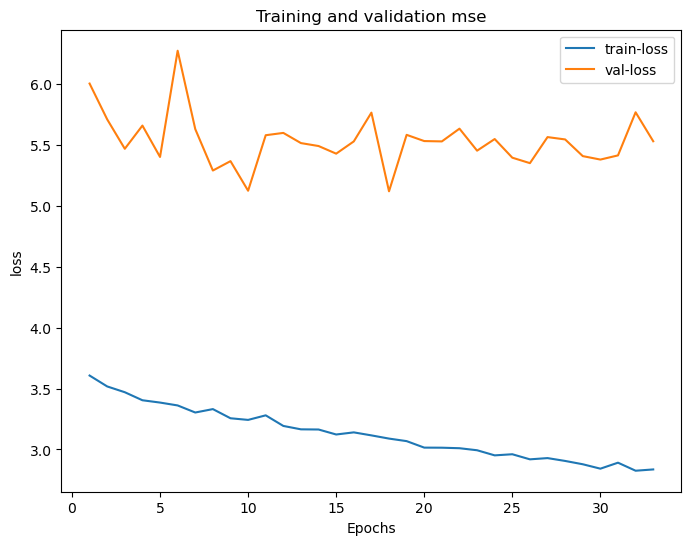

2023-01-25 23:42:08.583439: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:42:08.625125: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:42:08.633298: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


133/133 [==============================] - 2s 15ms/step
Epoch 1/1000


2023-01-25 23:42:11.681609: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:42:11.873554: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:42:11.891092: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:42:12.430615: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:42:12.444798: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


545/545 [==============================] - ETA: 0s - loss: 3.2186 - mean_squared_error: 25.4541 - mean_absolute_error: 3.6837 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.0452 - logcosh: 3.0745 - kullback_leibler_divergence: 0.0017 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9312 - csi: 0.9844 - freqbiassc: 1532.3652 - f1: 1.0001 - ham: 1.7248 - match1: 5.6000 - match2: 10.8569 - match3: 15.6737 - match5: 23.7093

2023-01-25 23:42:35.538563: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:42:35.636604: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-25 23:42:35.648520: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: saving model to /Users/sn/Downloads//Models/training_1/cp.ckpt


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 35s 61ms/step - loss: 3.2186 - mean_squared_error: 25.4541 - mean_absolute_error: 3.6837 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.0452 - logcosh: 3.0745 - kullback_leibler_divergence: 0.0017 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9312 - csi: 0.9844 - freqbiassc: 1532.3652 - f1: 1.0001 - ham: 1.7248 - match1: 5.6000 - match2: 10.8569 - match3: 15.6737 - match5: 23.7093 - val_loss: 5.9037 - val_mean_squared_error: 73.4869 - val_mean_absolute_error: 6.3851 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.5725 - val_logcosh: 5.7379 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8002 - val_csi: 0.9933 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2840 - val_match1: 3.4381 - val_match2: 6.8287 - val_match3: 10.0819 - val_match5: 16.0365
Epoch 2/1000
545/545 [==============================] - ETA: 0s - loss: 3.1799 - mean_squared_error: 25.006

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.1799 - mean_squared_error: 25.0061 - mean_absolute_error: 3.6443 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.0006 - logcosh: 3.0364 - kullback_leibler_divergence: 0.0013 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9325 - csi: 0.9843 - freqbiassc: 1532.2900 - f1: 0.9999 - ham: 1.7148 - match1: 5.7283 - match2: 11.0607 - match3: 15.8959 - match5: 23.9265 - val_loss: 5.7040 - val_mean_squared_error: 69.8921 - val_mean_absolute_error: 6.1844 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3602 - val_logcosh: 5.5397 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8100 - val_csi: 0.9926 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2421 - val_match1: 3.5957 - val_match2: 7.0848 - val_match3: 10.4829 - val_match5: 16.5708
Epoch 3/1000
545/545 [==============================] - ETA: 0s - loss: 3.1791 - mean_squared_error: 25.045

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.1791 - mean_squared_error: 25.0453 - mean_absolute_error: 3.6437 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.0045 - logcosh: 3.0356 - kullback_leibler_divergence: 0.0018 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9324 - csi: 0.9844 - freqbiassc: 1532.4111 - f1: 1.0001 - ham: 1.7147 - match1: 5.6920 - match2: 11.0136 - match3: 15.8728 - match5: 23.9606 - val_loss: 5.7434 - val_mean_squared_error: 71.1412 - val_mean_absolute_error: 6.2239 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4345 - val_logcosh: 5.5790 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8066 - val_csi: 0.9928 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2479 - val_match1: 3.6140 - val_match2: 7.1696 - val_match3: 10.5731 - val_match5: 16.6622
Epoch 4/1000
545/545 [==============================] - ETA: 0s - loss: 3.1300 - mean_squared_error: 24.297

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.1300 - mean_squared_error: 24.2978 - mean_absolute_error: 3.5940 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.9293 - logcosh: 2.9871 - kullback_leibler_divergence: 0.0013 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9344 - csi: 0.9844 - freqbiassc: 1532.3472 - f1: 1.0000 - ham: 1.7033 - match1: 5.7621 - match2: 11.1249 - match3: 16.0246 - match5: 24.1131 - val_loss: 6.0423 - val_mean_squared_error: 78.0523 - val_mean_absolute_error: 6.5231 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8347 - val_logcosh: 5.8771 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7878 - val_csi: 0.9928 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2989 - val_match1: 3.5443 - val_match2: 6.9595 - val_match3: 10.2555 - val_match5: 16.2537
Epoch 5/1000
545/545 [==============================] - ETA: 0s - loss: 3.1285 - mean_squared_error: 24.272

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.1285 - mean_squared_error: 24.2725 - mean_absolute_error: 3.5924 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.9267 - logcosh: 2.9855 - kullback_leibler_divergence: 0.0012 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9344 - csi: 0.9845 - freqbiassc: 1532.4130 - f1: 1.0001 - ham: 1.7030 - match1: 5.7785 - match2: 11.1055 - match3: 15.9831 - match5: 24.1293 - val_loss: 5.7598 - val_mean_squared_error: 71.7057 - val_mean_absolute_error: 6.2399 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4679 - val_logcosh: 5.5955 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8050 - val_csi: 0.9925 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2495 - val_match1: 3.6510 - val_match2: 7.2033 - val_match3: 10.6342 - val_match5: 16.7205
Epoch 6/1000
545/545 [==============================] - ETA: 0s - loss: 3.1079 - mean_squared_error: 24.009

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.1079 - mean_squared_error: 24.0096 - mean_absolute_error: 3.5717 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.9000 - logcosh: 2.9653 - kullback_leibler_divergence: 0.0013 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9351 - csi: 0.9845 - freqbiassc: 1532.4700 - f1: 1.0002 - ham: 1.6981 - match1: 5.7883 - match2: 11.1934 - match3: 16.0612 - match5: 24.1768 - val_loss: 5.8689 - val_mean_squared_error: 74.7754 - val_mean_absolute_error: 6.3491 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.6473 - val_logcosh: 5.7044 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7967 - val_csi: 0.9927 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2665 - val_match1: 3.6176 - val_match2: 7.0999 - val_match3: 10.4249 - val_match5: 16.5196
Epoch 7/1000
545/545 [==============================] - ETA: 0s - loss: 3.0817 - mean_squared_error: 23.678

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 3.0817 - mean_squared_error: 23.6782 - mean_absolute_error: 3.5451 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.8660 - logcosh: 2.9394 - kullback_leibler_divergence: 0.0014 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9360 - csi: 0.9845 - freqbiassc: 1532.4353 - f1: 1.0001 - ham: 1.6914 - match1: 5.8532 - match2: 11.2481 - match3: 16.1753 - match5: 24.3233 - val_loss: 5.9066 - val_mean_squared_error: 74.0555 - val_mean_absolute_error: 6.3878 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.6055 - val_logcosh: 5.7407 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7986 - val_csi: 0.9929 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2826 - val_match1: 3.4719 - val_match2: 6.7802 - val_match3: 10.0415 - val_match5: 15.9864
Epoch 8/1000
545/545 [==============================] - ETA: 0s - loss: 3.0719 - mean_squared_error: 23.535

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.0719 - mean_squared_error: 23.5352 - mean_absolute_error: 3.5356 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.8513 - logcosh: 2.9297 - kullback_leibler_divergence: 0.0016 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9364 - csi: 0.9845 - freqbiassc: 1532.4534 - f1: 1.0001 - ham: 1.6896 - match1: 5.8186 - match2: 11.2579 - match3: 16.2291 - match5: 24.4052 - val_loss: 5.6170 - val_mean_squared_error: 70.9177 - val_mean_absolute_error: 6.0950 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4213 - val_logcosh: 5.4557 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8072 - val_csi: 0.9915 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2071 - val_match1: 3.9982 - val_match2: 7.9076 - val_match3: 11.5649 - val_match5: 17.8649
Epoch 9/1000
545/545 [==============================] - ETA: 0s - loss: 3.0626 - mean_squared_error: 23.426

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.0626 - mean_squared_error: 23.4265 - mean_absolute_error: 3.5261 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.8401 - logcosh: 2.9205 - kullback_leibler_divergence: 0.0015 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9367 - csi: 0.9845 - freqbiassc: 1532.4059 - f1: 1.0001 - ham: 1.6874 - match1: 5.8373 - match2: 11.2944 - match3: 16.2278 - match5: 24.3966 - val_loss: 5.3790 - val_mean_squared_error: 65.8868 - val_mean_absolute_error: 5.8565 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1171 - val_logcosh: 5.2183 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8208 - val_csi: 0.9908 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1660 - val_match1: 4.0630 - val_match2: 7.9462 - val_match3: 11.6231 - val_match5: 18.0087
Epoch 10/1000
545/545 [==============================] - ETA: 0s - loss: 3.0519 - mean_squared_error: 23.33

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 3.0519 - mean_squared_error: 23.3321 - mean_absolute_error: 3.5153 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.8303 - logcosh: 2.9100 - kullback_leibler_divergence: 0.0016 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9370 - csi: 0.9845 - freqbiassc: 1532.4825 - f1: 1.0002 - ham: 1.6846 - match1: 5.8439 - match2: 11.3349 - match3: 16.3116 - match5: 24.4764 - val_loss: 5.3415 - val_mean_squared_error: 65.1859 - val_mean_absolute_error: 5.8185 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0738 - val_logcosh: 5.1816 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8227 - val_csi: 0.9901 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1557 - val_match1: 4.1319 - val_match2: 8.1538 - val_match3: 11.9296 - val_match5: 18.3906
Epoch 11/1000
545/545 [==============================] - ETA: 0s - loss: 3.0386 - mean_squared_error: 23.10

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 3.0386 - mean_squared_error: 23.1099 - mean_absolute_error: 3.5018 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.8073 - logcosh: 2.8969 - kullback_leibler_divergence: 0.0014 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9376 - csi: 0.9845 - freqbiassc: 1532.4625 - f1: 1.0001 - ham: 1.6816 - match1: 5.8722 - match2: 11.3509 - match3: 16.3238 - match5: 24.5335 - val_loss: 5.6934 - val_mean_squared_error: 71.5366 - val_mean_absolute_error: 6.1726 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4579 - val_logcosh: 5.5305 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8055 - val_csi: 0.9923 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2291 - val_match1: 3.8454 - val_match2: 7.5340 - val_match3: 11.0662 - val_match5: 17.2859
Epoch 12/1000
545/545 [==============================] - ETA: 0s - loss: 3.0164 - mean_squared_error: 22.77

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.0164 - mean_squared_error: 22.7742 - mean_absolute_error: 3.4796 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.7722 - logcosh: 2.8748 - kullback_leibler_divergence: 0.0015 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9385 - csi: 0.9845 - freqbiassc: 1532.4701 - f1: 1.0002 - ham: 1.6766 - match1: 5.8921 - match2: 11.3856 - match3: 16.3688 - match5: 24.6057 - val_loss: 5.5590 - val_mean_squared_error: 68.7945 - val_mean_absolute_error: 6.0373 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2942 - val_logcosh: 5.3971 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8129 - val_csi: 0.9915 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2026 - val_match1: 3.9474 - val_match2: 7.7735 - val_match3: 11.3738 - val_match5: 17.5953
Epoch 13/1000
545/545 [==============================] - ETA: 0s - loss: 3.0133 - mean_squared_error: 22.88

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.0133 - mean_squared_error: 22.8848 - mean_absolute_error: 3.4762 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.7838 - logcosh: 2.8718 - kullback_leibler_divergence: 0.0015 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9382 - csi: 0.9846 - freqbiassc: 1532.5214 - f1: 1.0002 - ham: 1.6749 - match1: 5.9257 - match2: 11.4228 - match3: 16.4122 - match5: 24.6543 - val_loss: 5.5735 - val_mean_squared_error: 70.0330 - val_mean_absolute_error: 6.0514 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3686 - val_logcosh: 5.4122 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8096 - val_csi: 0.9909 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1998 - val_match1: 4.0560 - val_match2: 7.9589 - val_match3: 11.5691 - val_match5: 17.9265
Epoch 14/1000
545/545 [==============================] - ETA: 0s - loss: 2.9788 - mean_squared_error: 22.32

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.9788 - mean_squared_error: 22.3260 - mean_absolute_error: 3.4415 - accuracy: 2.3912e-06 - root_mean_squared_error: 4.7250 - logcosh: 2.8378 - kullback_leibler_divergence: 0.0020 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9397 - csi: 0.9846 - freqbiassc: 1532.5157 - f1: 1.0002 - ham: 1.6674 - match1: 5.9598 - match2: 11.4746 - match3: 16.5288 - match5: 24.7894 - val_loss: 5.4614 - val_mean_squared_error: 67.1613 - val_mean_absolute_error: 5.9396 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1952 - val_logcosh: 5.3000 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8174 - val_csi: 0.9915 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1830 - val_match1: 4.0370 - val_match2: 7.9429 - val_match3: 11.6369 - val_match5: 17.9567
Epoch 15/1000
545/545 [==============================] - ETA: 0s - loss: 2.9917 - mean_squared_error: 22.50

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.9917 - mean_squared_error: 22.5097 - mean_absolute_error: 3.4543 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.7444 - logcosh: 2.8505 - kullback_leibler_divergence: 0.0015 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9392 - csi: 0.9846 - freqbiassc: 1532.4792 - f1: 1.0002 - ham: 1.6699 - match1: 5.9585 - match2: 11.4640 - match3: 16.4628 - match5: 24.7125 - val_loss: 5.4776 - val_mean_squared_error: 67.1808 - val_mean_absolute_error: 5.9560 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1964 - val_logcosh: 5.3159 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8173 - val_csi: 0.9909 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1886 - val_match1: 3.9057 - val_match2: 7.6888 - val_match3: 11.2919 - val_match5: 17.5768
Epoch 16/1000
545/545 [==============================] - ETA: 0s - loss: 2.9571 - mean_squared_error: 22.06

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.9571 - mean_squared_error: 22.0645 - mean_absolute_error: 3.4197 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.6973 - logcosh: 2.8163 - kullback_leibler_divergence: 0.0015 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9404 - csi: 0.9846 - freqbiassc: 1532.5048 - f1: 1.0002 - ham: 1.6621 - match1: 5.9596 - match2: 11.5308 - match3: 16.6064 - match5: 24.9073 - val_loss: 5.3393 - val_mean_squared_error: 63.1633 - val_mean_absolute_error: 5.8174 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9475 - val_logcosh: 5.1780 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8283 - val_csi: 0.9912 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1666 - val_match1: 3.9774 - val_match2: 7.8342 - val_match3: 11.4597 - val_match5: 17.8006
Epoch 17/1000
545/545 [==============================] - ETA: 0s - loss: 2.9498 - mean_squared_error: 21.96

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.9498 - mean_squared_error: 21.9658 - mean_absolute_error: 3.4122 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.6868 - logcosh: 2.8091 - kullback_leibler_divergence: 0.0017 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9407 - csi: 0.9846 - freqbiassc: 1532.4810 - f1: 1.0002 - ham: 1.6602 - match1: 5.9932 - match2: 11.5703 - match3: 16.6188 - match5: 24.9087 - val_loss: 5.8195 - val_mean_squared_error: 72.4767 - val_mean_absolute_error: 6.3004 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.5133 - val_logcosh: 5.6542 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8029 - val_csi: 0.9928 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2644 - val_match1: 3.5336 - val_match2: 6.9937 - val_match3: 10.3151 - val_match5: 16.3626
Epoch 18/1000
545/545 [==============================] - ETA: 0s - loss: 2.9528 - mean_squared_error: 22.06

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.9528 - mean_squared_error: 22.0676 - mean_absolute_error: 3.4151 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.6976 - logcosh: 2.8122 - kullback_leibler_divergence: 0.0016 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9404 - csi: 0.9846 - freqbiassc: 1532.5433 - f1: 1.0003 - ham: 1.6602 - match1: 6.0101 - match2: 11.5800 - match3: 16.6420 - match5: 24.9038 - val_loss: 5.5671 - val_mean_squared_error: 68.5123 - val_mean_absolute_error: 6.0460 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2772 - val_logcosh: 5.4046 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8137 - val_csi: 0.9906 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2078 - val_match1: 3.8223 - val_match2: 7.5117 - val_match3: 11.0667 - val_match5: 17.2874
Epoch 19/1000
545/545 [==============================] - ETA: 0s - loss: 2.9615 - mean_squared_error: 22.19

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.9615 - mean_squared_error: 22.1934 - mean_absolute_error: 3.4240 - accuracy: 2.3912e-06 - root_mean_squared_error: 4.7110 - logcosh: 2.8207 - kullback_leibler_divergence: 0.0019 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9401 - csi: 0.9846 - freqbiassc: 1532.5347 - f1: 1.0002 - ham: 1.6627 - match1: 5.9842 - match2: 11.5506 - match3: 16.5901 - match5: 24.8835 - val_loss: 5.7235 - val_mean_squared_error: 71.0384 - val_mean_absolute_error: 6.2038 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4284 - val_logcosh: 5.5590 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8068 - val_csi: 0.9924 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2440 - val_match1: 3.5749 - val_match2: 7.0843 - val_match3: 10.4666 - val_match5: 16.5438
Epoch 20/1000
545/545 [==============================] - ETA: 0s - loss: 2.8799 - mean_squared_error: 21.11

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.8799 - mean_squared_error: 21.1125 - mean_absolute_error: 3.3415 - accuracy: 2.3912e-06 - root_mean_squared_error: 4.5948 - logcosh: 2.7402 - kullback_leibler_divergence: 0.0018 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9430 - csi: 0.9847 - freqbiassc: 1532.6625 - f1: 1.0004 - ham: 1.6427 - match1: 6.1027 - match2: 11.7764 - match3: 16.9106 - match5: 25.2694 - val_loss: 5.4129 - val_mean_squared_error: 66.2859 - val_mean_absolute_error: 5.8906 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1416 - val_logcosh: 5.2519 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8198 - val_csi: 0.9904 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1736 - val_match1: 4.0173 - val_match2: 7.8708 - val_match3: 11.5177 - val_match5: 17.8451
Epoch 21/1000
545/545 [==============================] - ETA: 0s - loss: 2.8923 - mean_squared_error: 21.26

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.8923 - mean_squared_error: 21.2629 - mean_absolute_error: 3.3541 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.6112 - logcosh: 2.7524 - kullback_leibler_divergence: 0.0017 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9426 - csi: 0.9847 - freqbiassc: 1532.6095 - f1: 1.0003 - ham: 1.6463 - match1: 6.0877 - match2: 11.7445 - match3: 16.8395 - match5: 25.1890 - val_loss: 5.6019 - val_mean_squared_error: 68.9824 - val_mean_absolute_error: 6.0812 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.3056 - val_logcosh: 5.4388 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8124 - val_csi: 0.9915 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2168 - val_match1: 3.7379 - val_match2: 7.4000 - val_match3: 10.8369 - val_match5: 17.0048
Epoch 22/1000
545/545 [==============================] - ETA: 0s - loss: 2.8952 - mean_squared_error: 21.26

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.8952 - mean_squared_error: 21.2643 - mean_absolute_error: 3.3572 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.6113 - logcosh: 2.7552 - kullback_leibler_divergence: 0.0022 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9426 - csi: 0.9847 - freqbiassc: 1532.5709 - f1: 1.0003 - ham: 1.6471 - match1: 6.0689 - match2: 11.7215 - match3: 16.8399 - match5: 25.1949 - val_loss: 5.8325 - val_mean_squared_error: 72.2554 - val_mean_absolute_error: 6.3139 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.5003 - val_logcosh: 5.6667 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8035 - val_csi: 0.9929 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2712 - val_match1: 3.3985 - val_match2: 6.7440 - val_match3: 9.9335 - val_match5: 15.8929
Epoch 23/1000
545/545 [==============================] - ETA: 0s - loss: 2.8909 - mean_squared_error: 21.268

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.8909 - mean_squared_error: 21.2681 - mean_absolute_error: 3.3526 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.6117 - logcosh: 2.7512 - kullback_leibler_divergence: 0.0018 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9426 - csi: 0.9848 - freqbiassc: 1532.6370 - f1: 1.0004 - ham: 1.6451 - match1: 6.0980 - match2: 11.7779 - match3: 16.8974 - match5: 25.2041 - val_loss: 5.3146 - val_mean_squared_error: 63.5457 - val_mean_absolute_error: 5.7921 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9716 - val_logcosh: 5.1540 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8272 - val_csi: 0.9909 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1567 - val_match1: 4.0830 - val_match2: 8.0463 - val_match3: 11.7394 - val_match5: 18.1273
Epoch 24/1000
545/545 [==============================] - ETA: 0s - loss: 2.8589 - mean_squared_error: 20.82

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.8589 - mean_squared_error: 20.8243 - mean_absolute_error: 3.3204 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.5634 - logcosh: 2.7194 - kullback_leibler_divergence: 0.0017 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9438 - csi: 0.9848 - freqbiassc: 1532.6479 - f1: 1.0004 - ham: 1.6380 - match1: 6.1218 - match2: 11.8063 - match3: 16.9585 - match5: 25.3764 - val_loss: 5.6062 - val_mean_squared_error: 68.7975 - val_mean_absolute_error: 6.0857 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2944 - val_logcosh: 5.4428 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8129 - val_csi: 0.9918 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2190 - val_match1: 3.7002 - val_match2: 7.3079 - val_match3: 10.8316 - val_match5: 16.9845
Epoch 25/1000
545/545 [==============================] - ETA: 0s - loss: 2.9329 - mean_squared_error: 21.76

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.9329 - mean_squared_error: 21.7687 - mean_absolute_error: 3.3951 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.6657 - logcosh: 2.7924 - kullback_leibler_divergence: 0.0020 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9412 - csi: 0.9848 - freqbiassc: 1532.6608 - f1: 1.0004 - ham: 1.6563 - match1: 6.0363 - match2: 11.6158 - match3: 16.6994 - match5: 25.0107 - val_loss: 5.5913 - val_mean_squared_error: 68.2386 - val_mean_absolute_error: 6.0705 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2607 - val_logcosh: 5.4281 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8145 - val_csi: 0.9920 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2163 - val_match1: 3.7871 - val_match2: 7.4321 - val_match3: 10.8781 - val_match5: 17.0617
Epoch 26/1000
545/545 [==============================] - ETA: 0s - loss: 2.8082 - mean_squared_error: 20.20

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.8082 - mean_squared_error: 20.2026 - mean_absolute_error: 3.2691 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.4947 - logcosh: 2.6695 - kullback_leibler_divergence: 0.0018 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9454 - csi: 0.9848 - freqbiassc: 1532.6937 - f1: 1.0004 - ham: 1.6253 - match1: 6.2153 - match2: 11.9764 - match3: 17.1564 - match5: 25.6131 - val_loss: 5.3720 - val_mean_squared_error: 63.8462 - val_mean_absolute_error: 5.8508 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9904 - val_logcosh: 5.2097 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8264 - val_csi: 0.9912 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1756 - val_match1: 3.8642 - val_match2: 7.6009 - val_match3: 11.1866 - val_match5: 17.5039
Epoch 27/1000
545/545 [==============================] - ETA: 0s - loss: 2.8087 - mean_squared_error: 20.19

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.8087 - mean_squared_error: 20.1986 - mean_absolute_error: 3.2697 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.4943 - logcosh: 2.6699 - kullback_leibler_divergence: 0.0020 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9454 - csi: 0.9849 - freqbiassc: 1532.7103 - f1: 1.0004 - ham: 1.6256 - match1: 6.1924 - match2: 11.9662 - match3: 17.1743 - match5: 25.6298 - val_loss: 5.7365 - val_mean_squared_error: 72.4141 - val_mean_absolute_error: 6.2160 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.5096 - val_logcosh: 5.5732 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8031 - val_csi: 0.9922 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2377 - val_match1: 3.8095 - val_match2: 7.4531 - val_match3: 10.8974 - val_match5: 17.0594
Epoch 28/1000
545/545 [==============================] - ETA: 0s - loss: 2.8536 - mean_squared_error: 20.68

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.8536 - mean_squared_error: 20.6836 - mean_absolute_error: 3.3154 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.5479 - logcosh: 2.7139 - kullback_leibler_divergence: 0.0026 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9441 - csi: 0.9847 - freqbiassc: 1532.5470 - f1: 1.0003 - ham: 1.6379 - match1: 6.1020 - match2: 11.7604 - match3: 16.9243 - match5: 25.3123 - val_loss: 5.6396 - val_mean_squared_error: 69.0479 - val_mean_absolute_error: 6.1191 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3095 - val_logcosh: 5.4761 - val_kullback_leibler_divergence: 9.9382e-06 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8123 - val_csi: 0.9921 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2260 - val_match1: 3.7766 - val_match2: 7.3513 - val_match3: 10.8300 - val_match5: 17.0154
Epoch 29/1000
545/545 [==============================] - ETA: 0s - loss: 2.8135 - mean_squared_error: 20.287

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.8135 - mean_squared_error: 20.2879 - mean_absolute_error: 3.2746 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.5042 - logcosh: 2.6747 - kullback_leibler_divergence: 0.0024 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9452 - csi: 0.9849 - freqbiassc: 1532.6700 - f1: 1.0004 - ham: 1.6266 - match1: 6.1903 - match2: 11.9726 - match3: 17.1457 - match5: 25.5683 - val_loss: 5.7371 - val_mean_squared_error: 72.3187 - val_mean_absolute_error: 6.2168 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.5040 - val_logcosh: 5.5735 - val_kullback_leibler_divergence: 4.8691e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8034 - val_csi: 0.9919 - val_freqbiassc: 1534.3148 - val_f1: 0.9998 - val_ham: 2.2393 - val_match1: 3.7112 - val_match2: 7.3324 - val_match3: 10.7826 - val_match5: 17.0120
Epoch 30/1000
545/545 [==============================] - ETA: 0s - loss: 2.8237 - mean_squared_error: 20.364

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.8237 - mean_squared_error: 20.3641 - mean_absolute_error: 3.2849 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.5127 - logcosh: 2.6845 - kullback_leibler_divergence: 0.0021 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9450 - csi: 0.9847 - freqbiassc: 1532.6407 - f1: 1.0004 - ham: 1.6296 - match1: 6.1503 - match2: 11.8714 - match3: 17.0623 - match5: 25.5103 - val_loss: 5.4729 - val_mean_squared_error: 67.3121 - val_mean_absolute_error: 5.9516 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2044 - val_logcosh: 5.3109 - val_kullback_leibler_divergence: -2.3238e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8170 - val_csi: 0.9905 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.1884 - val_match1: 3.8519 - val_match2: 7.6138 - val_match3: 11.1675 - val_match5: 17.4856
Epoch 31/1000
545/545 [==============================] - ETA: 0s - loss: 2.8142 - mean_squared_error: 20.21

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.8142 - mean_squared_error: 20.2161 - mean_absolute_error: 3.2756 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.4962 - logcosh: 2.6751 - kullback_leibler_divergence: 0.0026 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9454 - csi: 0.9848 - freqbiassc: 1532.6848 - f1: 1.0005 - ham: 1.6280 - match1: 6.1484 - match2: 11.8883 - match3: 17.0662 - match5: 25.5086 - val_loss: 5.3876 - val_mean_squared_error: 64.3609 - val_mean_absolute_error: 5.8660 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.0225 - val_logcosh: 5.2258 - val_kullback_leibler_divergence: -2.4208e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8250 - val_csi: 0.9910 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1761 - val_match1: 3.9076 - val_match2: 7.6728 - val_match3: 11.2430 - val_match5: 17.5979
Epoch 32/1000
545/545 [==============================] - ETA: 0s - loss: 2.7806 - mean_squared_error: 19.81

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.7806 - mean_squared_error: 19.8183 - mean_absolute_error: 3.2412 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.4518 - logcosh: 2.6421 - kullback_leibler_divergence: 0.0028 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9465 - csi: 0.9849 - freqbiassc: 1532.6809 - f1: 1.0005 - ham: 1.6188 - match1: 6.2600 - match2: 12.0477 - match3: 17.2422 - match5: 25.7122 - val_loss: 5.8362 - val_mean_squared_error: 73.5899 - val_mean_absolute_error: 6.3169 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.5785 - val_logcosh: 5.6711 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7999 - val_csi: 0.9925 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2649 - val_match1: 3.4762 - val_match2: 6.8720 - val_match3: 10.1518 - val_match5: 16.2303
Epoch 33/1000
545/545 [==============================] - ETA: 0s - loss: 2.8002 - mean_squared_error: 20.01

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.8002 - mean_squared_error: 20.0158 - mean_absolute_error: 3.2610 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.4739 - logcosh: 2.6615 - kullback_leibler_divergence: 0.0027 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9459 - csi: 0.9849 - freqbiassc: 1532.7178 - f1: 1.0005 - ham: 1.6238 - match1: 6.2385 - match2: 11.9805 - match3: 17.1646 - match5: 25.5885 - val_loss: 5.5176 - val_mean_squared_error: 67.6233 - val_mean_absolute_error: 5.9963 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2233 - val_logcosh: 5.3554 - val_kullback_leibler_divergence: -2.5895e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8161 - val_csi: 0.9912 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1980 - val_match1: 3.8903 - val_match2: 7.6135 - val_match3: 11.1500 - val_match5: 17.3892
Epoch 34/1000
545/545 [==============================] - ETA: 0s - loss: 2.7500 - mean_squared_error: 19.45

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.7500 - mean_squared_error: 19.4577 - mean_absolute_error: 3.2103 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.4111 - logcosh: 2.6120 - kullback_leibler_divergence: 0.0029 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9474 - csi: 0.9849 - freqbiassc: 1532.6736 - f1: 1.0005 - ham: 1.6111 - match1: 6.3080 - match2: 12.1301 - match3: 17.3768 - match5: 25.8549 - val_loss: 5.7020 - val_mean_squared_error: 72.9209 - val_mean_absolute_error: 6.1808 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.5394 - val_logcosh: 5.5394 - val_kullback_leibler_divergence: 1.4144e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8017 - val_csi: 0.9910 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.2266 - val_match1: 3.8862 - val_match2: 7.6402 - val_match3: 11.1996 - val_match5: 17.3865
Epoch 35/1000
545/545 [==============================] - ETA: 0s - loss: 2.7582 - mean_squared_error: 19.597

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.7582 - mean_squared_error: 19.5975 - mean_absolute_error: 3.2186 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.4269 - logcosh: 2.6202 - kullback_leibler_divergence: 0.0029 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9471 - csi: 0.9849 - freqbiassc: 1532.6327 - f1: 1.0005 - ham: 1.6127 - match1: 6.2969 - match2: 12.1412 - match3: 17.3814 - match5: 25.8798 - val_loss: 5.5431 - val_mean_squared_error: 69.0218 - val_mean_absolute_error: 6.0216 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3079 - val_logcosh: 5.3808 - val_kullback_leibler_divergence: 1.1019e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8123 - val_csi: 0.9918 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.1999 - val_match1: 3.8623 - val_match2: 7.5610 - val_match3: 11.1177 - val_match5: 17.4302
Epoch 36/1000
545/545 [==============================] - ETA: 0s - loss: 2.7767 - mean_squared_error: 19.797

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.7767 - mean_squared_error: 19.7972 - mean_absolute_error: 3.2374 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.4494 - logcosh: 2.6383 - kullback_leibler_divergence: 0.0024 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9465 - csi: 0.9849 - freqbiassc: 1532.7123 - f1: 1.0005 - ham: 1.6181 - match1: 6.2478 - match2: 12.0673 - match3: 17.2625 - match5: 25.7293 - val_loss: 5.3138 - val_mean_squared_error: 63.0395 - val_mean_absolute_error: 5.7919 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 7.9397 - val_logcosh: 5.1523 - val_kullback_leibler_divergence: 4.8691e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8286 - val_csi: 0.9900 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.1615 - val_match1: 3.9232 - val_match2: 7.7365 - val_match3: 11.4202 - val_match5: 17.8478
Epoch 37/1000
545/545 [==============================] - ETA: 0s - loss: 2.7598 - mean_squared_error: 19.528

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.7598 - mean_squared_error: 19.5285 - mean_absolute_error: 3.2203 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.4191 - logcosh: 2.6217 - kullback_leibler_divergence: 0.0027 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9473 - csi: 0.9850 - freqbiassc: 1532.7196 - f1: 1.0005 - ham: 1.6139 - match1: 6.2829 - match2: 12.0946 - match3: 17.3210 - match5: 25.8148 - val_loss: 5.2621 - val_mean_squared_error: 63.0220 - val_mean_absolute_error: 5.7395 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9386 - val_logcosh: 5.1016 - val_kullback_leibler_divergence: 1.0120e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8286 - val_csi: 0.9906 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1457 - val_match1: 4.0816 - val_match2: 8.0335 - val_match3: 11.7706 - val_match5: 18.2121
Epoch 38/1000
545/545 [==============================] - ETA: 0s - loss: 2.7594 - mean_squared_error: 19.514

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.7594 - mean_squared_error: 19.5144 - mean_absolute_error: 3.2199 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.4175 - logcosh: 2.6211 - kullback_leibler_divergence: 0.0030 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9473 - csi: 0.9849 - freqbiassc: 1532.7104 - f1: 1.0005 - ham: 1.6142 - match1: 6.2649 - match2: 12.0620 - match3: 17.2829 - match5: 25.7928 - val_loss: 5.3663 - val_mean_squared_error: 63.9357 - val_mean_absolute_error: 5.8446 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9960 - val_logcosh: 5.2045 - val_kullback_leibler_divergence: 9.9382e-06 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8262 - val_csi: 0.9908 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1722 - val_match1: 3.9060 - val_match2: 7.6552 - val_match3: 11.2640 - val_match5: 17.5649
Epoch 39/1000
545/545 [==============================] - ETA: 0s - loss: 2.7322 - mean_squared_error: 19.272

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.7322 - mean_squared_error: 19.2721 - mean_absolute_error: 3.1923 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3900 - logcosh: 2.5944 - kullback_leibler_divergence: 0.0029 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9479 - csi: 0.9849 - freqbiassc: 1532.7377 - f1: 1.0005 - ham: 1.6065 - match1: 6.3202 - match2: 12.1573 - match3: 17.4283 - match5: 25.9859 - val_loss: 5.2283 - val_mean_squared_error: 63.0185 - val_mean_absolute_error: 5.7052 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9384 - val_logcosh: 5.0686 - val_kullback_leibler_divergence: 1.1999e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8286 - val_csi: 0.9902 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1347 - val_match1: 4.1708 - val_match2: 8.1980 - val_match3: 12.0348 - val_match5: 18.6361
Epoch 40/1000
545/545 [==============================] - ETA: 0s - loss: 2.6914 - mean_squared_error: 18.746

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.6914 - mean_squared_error: 18.7469 - mean_absolute_error: 3.1511 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3298 - logcosh: 2.5543 - kullback_leibler_divergence: 0.0028 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9494 - csi: 0.9849 - freqbiassc: 1532.6644 - f1: 1.0005 - ham: 1.5965 - match1: 6.3905 - match2: 12.3130 - match3: 17.6136 - match5: 26.1860 - val_loss: 5.5554 - val_mean_squared_error: 67.0981 - val_mean_absolute_error: 6.0343 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1913 - val_logcosh: 5.3927 - val_kullback_leibler_divergence: 1.1898e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8176 - val_csi: 0.9920 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.2093 - val_match1: 3.8795 - val_match2: 7.5796 - val_match3: 11.1114 - val_match5: 17.3392
Epoch 41/1000
545/545 [==============================] - ETA: 0s - loss: 2.7577 - mean_squared_error: 19.590

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.7577 - mean_squared_error: 19.5909 - mean_absolute_error: 3.2182 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.4262 - logcosh: 2.6195 - kullback_leibler_divergence: 0.0028 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9471 - csi: 0.9849 - freqbiassc: 1532.7123 - f1: 1.0005 - ham: 1.6129 - match1: 6.2877 - match2: 12.1007 - match3: 17.3801 - match5: 25.8594 - val_loss: 5.5007 - val_mean_squared_error: 67.5653 - val_mean_absolute_error: 5.9794 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2198 - val_logcosh: 5.3386 - val_kullback_leibler_divergence: -2.2047e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8163 - val_csi: 0.9915 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1937 - val_match1: 3.8499 - val_match2: 7.6375 - val_match3: 11.2077 - val_match5: 17.5615
Epoch 42/1000
545/545 [==============================] - ETA: 0s - loss: 2.7274 - mean_squared_error: 19.22

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.7274 - mean_squared_error: 19.2262 - mean_absolute_error: 3.1874 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3848 - logcosh: 2.5898 - kullback_leibler_divergence: 0.0032 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9481 - csi: 0.9850 - freqbiassc: 1532.7084 - f1: 1.0005 - ham: 1.6051 - match1: 6.3493 - match2: 12.1978 - match3: 17.4858 - match5: 26.0380 - val_loss: 5.5517 - val_mean_squared_error: 69.0047 - val_mean_absolute_error: 6.0304 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3069 - val_logcosh: 5.3892 - val_kullback_leibler_divergence: -2.1022e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8124 - val_csi: 0.9914 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2031 - val_match1: 3.8542 - val_match2: 7.5293 - val_match3: 11.0441 - val_match5: 17.3045
Epoch 43/1000
545/545 [==============================] - ETA: 0s - loss: 2.6827 - mean_squared_error: 18.70

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.6827 - mean_squared_error: 18.7033 - mean_absolute_error: 3.1422 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3247 - logcosh: 2.5458 - kullback_leibler_divergence: 0.0027 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9495 - csi: 0.9850 - freqbiassc: 1532.7744 - f1: 1.0006 - ham: 1.5938 - match1: 6.4077 - match2: 12.3590 - match3: 17.6805 - match5: 26.2687 - val_loss: 5.7270 - val_mean_squared_error: 71.8432 - val_mean_absolute_error: 6.2069 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.4760 - val_logcosh: 5.5631 - val_kullback_leibler_divergence: -2.6124e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8047 - val_csi: 0.9922 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.2399 - val_match1: 3.6776 - val_match2: 7.2235 - val_match3: 10.6472 - val_match5: 16.7197
Epoch 44/1000
545/545 [==============================] - ETA: 0s - loss: 2.6796 - mean_squared_error: 18.62

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.6796 - mean_squared_error: 18.6261 - mean_absolute_error: 3.1392 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3158 - logcosh: 2.5427 - kullback_leibler_divergence: 0.0030 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9497 - csi: 0.9850 - freqbiassc: 1532.7214 - f1: 1.0005 - ham: 1.5934 - match1: 6.3923 - match2: 12.3541 - match3: 17.6886 - match5: 26.2661 - val_loss: 5.2733 - val_mean_squared_error: 63.9036 - val_mean_absolute_error: 5.7498 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9940 - val_logcosh: 5.1141 - val_kullback_leibler_divergence: -2.2462e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8262 - val_csi: 0.9901 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1412 - val_match1: 4.2297 - val_match2: 8.2868 - val_match3: 12.0693 - val_match5: 18.5305
Epoch 45/1000
545/545 [==============================] - ETA: 0s - loss: 2.6752 - mean_squared_error: 18.55

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.6752 - mean_squared_error: 18.5522 - mean_absolute_error: 3.1345 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3072 - logcosh: 2.5383 - kullback_leibler_divergence: 0.0030 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9499 - csi: 0.9850 - freqbiassc: 1532.7090 - f1: 1.0005 - ham: 1.5921 - match1: 6.4376 - match2: 12.3660 - match3: 17.6556 - match5: 26.2535 - val_loss: 5.4406 - val_mean_squared_error: 65.9022 - val_mean_absolute_error: 5.9191 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.1180 - val_logcosh: 5.2785 - val_kullback_leibler_divergence: 9.9382e-06 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8208 - val_csi: 0.9915 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1849 - val_match1: 3.8509 - val_match2: 7.5966 - val_match3: 11.1735 - val_match5: 17.4588
Epoch 46/1000
545/545 [==============================] - ETA: 0s - loss: 2.6780 - mean_squared_error: 18.569

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.6780 - mean_squared_error: 18.5693 - mean_absolute_error: 3.1376 - accuracy: 2.3912e-06 - root_mean_squared_error: 4.3092 - logcosh: 2.5411 - kullback_leibler_divergence: 0.0033 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9498 - csi: 0.9850 - freqbiassc: 1532.7307 - f1: 1.0006 - ham: 1.5933 - match1: 6.4036 - match2: 12.3763 - match3: 17.6598 - match5: 26.2176 - val_loss: 5.4666 - val_mean_squared_error: 66.6016 - val_mean_absolute_error: 5.9457 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1610 - val_logcosh: 5.3042 - val_kullback_leibler_divergence: 1.1411e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8189 - val_csi: 0.9918 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1900 - val_match1: 3.8384 - val_match2: 7.5678 - val_match3: 11.1613 - val_match5: 17.4875
Epoch 47/1000
545/545 [==============================] - ETA: 0s - loss: 2.6449 - mean_squared_error: 18.223

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.6449 - mean_squared_error: 18.2236 - mean_absolute_error: 3.1040 - accuracy: 3.5868e-06 - root_mean_squared_error: 4.2689 - logcosh: 2.5086 - kullback_leibler_divergence: 0.0029 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9508 - csi: 0.9851 - freqbiassc: 1532.7344 - f1: 1.0006 - ham: 1.5843 - match1: 6.4765 - match2: 12.4716 - match3: 17.8348 - match5: 26.4576 - val_loss: 5.2160 - val_mean_squared_error: 62.0424 - val_mean_absolute_error: 5.6930 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.8767 - val_logcosh: 5.0558 - val_kullback_leibler_divergence: 1.2042e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8313 - val_csi: 0.9907 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1371 - val_match1: 4.0789 - val_match2: 7.9937 - val_match3: 11.7080 - val_match5: 18.2317
Epoch 48/1000
545/545 [==============================] - ETA: 0s - loss: 2.6812 - mean_squared_error: 18.602

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.6812 - mean_squared_error: 18.6026 - mean_absolute_error: 3.1409 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3131 - logcosh: 2.5440 - kullback_leibler_divergence: 0.0035 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9498 - csi: 0.9850 - freqbiassc: 1532.7379 - f1: 1.0006 - ham: 1.5946 - match1: 6.3886 - match2: 12.3235 - match3: 17.6542 - match5: 26.2022 - val_loss: 5.4422 - val_mean_squared_error: 66.3001 - val_mean_absolute_error: 5.9207 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.1425 - val_logcosh: 5.2802 - val_kullback_leibler_divergence: 1.0900e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8197 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1839 - val_match1: 3.8393 - val_match2: 7.5522 - val_match3: 11.0869 - val_match5: 17.4989
Epoch 49/1000
545/545 [==============================] - ETA: 0s - loss: 2.6743 - mean_squared_error: 18.539

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.6743 - mean_squared_error: 18.5398 - mean_absolute_error: 3.1337 - accuracy: 3.5868e-06 - root_mean_squared_error: 4.3058 - logcosh: 2.5374 - kullback_leibler_divergence: 0.0032 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9499 - csi: 0.9850 - freqbiassc: 1532.7506 - f1: 1.0006 - ham: 1.5921 - match1: 6.4138 - match2: 12.3350 - match3: 17.6633 - match5: 26.2935 - val_loss: 5.6374 - val_mean_squared_error: 69.0319 - val_mean_absolute_error: 6.1173 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3085 - val_logcosh: 5.4735 - val_kullback_leibler_divergence: 2.0370e-04 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8123 - val_csi: 0.9919 - val_freqbiassc: 1534.3075 - val_f1: 0.9998 - val_ham: 2.2278 - val_match1: 3.6274 - val_match2: 7.1642 - val_match3: 10.6037 - val_match5: 16.7648
Epoch 50/1000
545/545 [==============================] - ETA: 0s - loss: 2.6658 - mean_squared_error: 18.422

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.6658 - mean_squared_error: 18.4221 - mean_absolute_error: 3.1254 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.2921 - logcosh: 2.5289 - kullback_leibler_divergence: 0.0036 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9502 - csi: 0.9850 - freqbiassc: 1532.6809 - f1: 1.0005 - ham: 1.5906 - match1: 6.3967 - match2: 12.3603 - match3: 17.6923 - match5: 26.2960 - val_loss: 5.1260 - val_mean_squared_error: 62.0012 - val_mean_absolute_error: 5.6020 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.8741 - val_logcosh: 4.9678 - val_kullback_leibler_divergence: 1.1365e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8314 - val_csi: 0.9886 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1097 - val_match1: 4.2614 - val_match2: 8.3720 - val_match3: 12.2612 - val_match5: 18.8914
Epoch 51/1000
545/545 [==============================] - ETA: 0s - loss: 2.6892 - mean_squared_error: 18.668

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.6892 - mean_squared_error: 18.6686 - mean_absolute_error: 3.1489 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.3207 - logcosh: 2.5520 - kullback_leibler_divergence: 0.0032 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9496 - csi: 0.9850 - freqbiassc: 1532.7010 - f1: 1.0005 - ham: 1.5962 - match1: 6.3520 - match2: 12.2630 - match3: 17.5452 - match5: 26.1639 - val_loss: 5.1424 - val_mean_squared_error: 60.1747 - val_mean_absolute_error: 5.6196 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.7572 - val_logcosh: 4.9826 - val_kullback_leibler_divergence: 1.0561e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8364 - val_csi: 0.9900 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1242 - val_match1: 4.1037 - val_match2: 8.1157 - val_match3: 11.9064 - val_match5: 18.4757
Epoch 52/1000
545/545 [==============================] - ETA: 0s - loss: 2.6499 - mean_squared_error: 18.288

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.6499 - mean_squared_error: 18.2882 - mean_absolute_error: 3.1091 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.2765 - logcosh: 2.5135 - kullback_leibler_divergence: 0.0031 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9506 - csi: 0.9851 - freqbiassc: 1532.7688 - f1: 1.0006 - ham: 1.5857 - match1: 6.4546 - match2: 12.4554 - match3: 17.7843 - match5: 26.4000 - val_loss: 5.5502 - val_mean_squared_error: 68.7736 - val_mean_absolute_error: 6.0290 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.2930 - val_logcosh: 5.3877 - val_kullback_leibler_divergence: 1.2620e-04 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8130 - val_csi: 0.9914 - val_freqbiassc: 1534.3112 - val_f1: 0.9998 - val_ham: 2.2027 - val_match1: 3.8036 - val_match2: 7.5164 - val_match3: 11.0177 - val_match5: 17.2585
Epoch 53/1000
545/545 [==============================] - ETA: 0s - loss: 2.6473 - mean_squared_error: 18.272

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.6473 - mean_squared_error: 18.2722 - mean_absolute_error: 3.1063 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.2746 - logcosh: 2.5110 - kullback_leibler_divergence: 0.0034 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9506 - csi: 0.9851 - freqbiassc: 1532.7477 - f1: 1.0006 - ham: 1.5846 - match1: 6.4872 - match2: 12.4854 - match3: 17.8458 - match5: 26.4766 - val_loss: 5.1608 - val_mean_squared_error: 62.7036 - val_mean_absolute_error: 5.6364 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9186 - val_logcosh: 5.0026 - val_kullback_leibler_divergence: 8.7444e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8295 - val_csi: 0.9899 - val_freqbiassc: 1534.3148 - val_f1: 0.9998 - val_ham: 2.1151 - val_match1: 4.3475 - val_match2: 8.5006 - val_match3: 12.3696 - val_match5: 18.9070
Epoch 54/1000
545/545 [==============================] - ETA: 0s - loss: 2.6338 - mean_squared_error: 18.042

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.6338 - mean_squared_error: 18.0421 - mean_absolute_error: 3.0929 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.2476 - logcosh: 2.4974 - kullback_leibler_divergence: 0.0035 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9513 - csi: 0.9851 - freqbiassc: 1532.7766 - f1: 1.0006 - ham: 1.5822 - match1: 6.4563 - match2: 12.4487 - match3: 17.8374 - match5: 26.4761 - val_loss: 5.2657 - val_mean_squared_error: 63.5657 - val_mean_absolute_error: 5.7431 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9728 - val_logcosh: 5.1053 - val_kullback_leibler_divergence: 9.9382e-06 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8272 - val_csi: 0.9906 - val_freqbiassc: 1534.3258 - val_f1: 0.9998 - val_ham: 2.1445 - val_match1: 4.0320 - val_match2: 7.9789 - val_match3: 11.7139 - val_match5: 18.2185
Epoch 55/1000
545/545 [==============================] - ETA: 0s - loss: 2.6463 - mean_squared_error: 18.240

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.6463 - mean_squared_error: 18.2400 - mean_absolute_error: 3.1055 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.2708 - logcosh: 2.5099 - kullback_leibler_divergence: 0.0033 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9507 - csi: 0.9850 - freqbiassc: 1532.7434 - f1: 1.0006 - ham: 1.5849 - match1: 6.4675 - match2: 12.4498 - match3: 17.8195 - match5: 26.4111 - val_loss: 5.4168 - val_mean_squared_error: 67.1235 - val_mean_absolute_error: 5.8943 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1929 - val_logcosh: 5.2560 - val_kullback_leibler_divergence: 3.4184e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8175 - val_csi: 0.9898 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.1708 - val_match1: 4.0187 - val_match2: 7.8842 - val_match3: 11.5223 - val_match5: 17.9496
Epoch 56/1000
545/545 [==============================] - ETA: 0s - loss: 2.6065 - mean_squared_error: 17.773

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.6065 - mean_squared_error: 17.7732 - mean_absolute_error: 3.0651 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.2158 - logcosh: 2.4708 - kullback_leibler_divergence: 0.0032 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9520 - csi: 0.9851 - freqbiassc: 1532.7930 - f1: 1.0006 - ham: 1.5744 - match1: 6.5528 - match2: 12.6176 - match3: 18.0295 - match5: 26.6539 - val_loss: 5.3587 - val_mean_squared_error: 65.2268 - val_mean_absolute_error: 5.8367 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0763 - val_logcosh: 5.1975 - val_kullback_leibler_divergence: 9.9382e-06 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8226 - val_csi: 0.9910 - val_freqbiassc: 1534.3221 - val_f1: 0.9998 - val_ham: 2.1645 - val_match1: 3.9479 - val_match2: 7.7982 - val_match3: 11.4478 - val_match5: 17.9116
Epoch 57/1000
545/545 [==============================] - ETA: 0s - loss: 2.6238 - mean_squared_error: 18.009

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.6238 - mean_squared_error: 18.0092 - mean_absolute_error: 3.0824 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.2437 - logcosh: 2.4879 - kullback_leibler_divergence: 0.0031 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9514 - csi: 0.9851 - freqbiassc: 1532.7985 - f1: 1.0006 - ham: 1.5783 - match1: 6.5168 - match2: 12.5678 - match3: 17.9094 - match5: 26.5949 - val_loss: 5.3327 - val_mean_squared_error: 64.5134 - val_mean_absolute_error: 5.8103 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0320 - val_logcosh: 5.1720 - val_kullback_leibler_divergence: 1.2354e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8246 - val_csi: 0.9909 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1582 - val_match1: 4.0432 - val_match2: 7.9216 - val_match3: 11.6435 - val_match5: 18.1811
Epoch 58/1000
545/545 [==============================] - ETA: 0s - loss: 2.6102 - mean_squared_error: 17.836

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.6102 - mean_squared_error: 17.8369 - mean_absolute_error: 3.0687 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.2234 - logcosh: 2.4744 - kullback_leibler_divergence: 0.0033 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9518 - csi: 0.9851 - freqbiassc: 1532.7489 - f1: 1.0006 - ham: 1.5753 - match1: 6.5362 - match2: 12.5691 - match3: 17.9963 - match5: 26.6435 - val_loss: 5.2372 - val_mean_squared_error: 62.8244 - val_mean_absolute_error: 5.7151 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9262 - val_logcosh: 5.0765 - val_kullback_leibler_divergence: 1.4408e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8292 - val_csi: 0.9902 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1420 - val_match1: 3.9592 - val_match2: 7.8425 - val_match3: 11.5604 - val_match5: 18.0660
Epoch 59/1000
544/545 [============================>.] - ETA: 0s - loss: 2.6091 - mean_squared_error: 17.782

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.6092 - mean_squared_error: 17.7815 - mean_absolute_error: 3.0676 - accuracy: 3.5868e-06 - root_mean_squared_error: 4.2168 - logcosh: 2.4734 - kullback_leibler_divergence: 0.0036 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9520 - csi: 0.9851 - freqbiassc: 1532.7910 - f1: 1.0006 - ham: 1.5752 - match1: 6.5532 - match2: 12.5912 - match3: 17.9852 - match5: 26.6089 - val_loss: 5.3951 - val_mean_squared_error: 65.0888 - val_mean_absolute_error: 5.8738 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0678 - val_logcosh: 5.2328 - val_kullback_leibler_divergence: 1.5839e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8230 - val_csi: 0.9916 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1784 - val_match1: 3.8116 - val_match2: 7.4657 - val_match3: 10.9824 - val_match5: 17.2685
Epoch 60/1000
545/545 [==============================] - ETA: 0s - loss: 2.6028 - mean_squared_error: 17.716

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.6028 - mean_squared_error: 17.7161 - mean_absolute_error: 3.0613 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.2091 - logcosh: 2.4671 - kullback_leibler_divergence: 0.0035 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9521 - csi: 0.9851 - freqbiassc: 1532.7800 - f1: 1.0006 - ham: 1.5735 - match1: 6.5480 - match2: 12.5933 - match3: 18.0347 - match5: 26.7145 - val_loss: 5.1920 - val_mean_squared_error: 62.1505 - val_mean_absolute_error: 5.6695 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.8836 - val_logcosh: 5.0316 - val_kullback_leibler_divergence: -1.8766e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8310 - val_csi: 0.9899 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1324 - val_match1: 3.9937 - val_match2: 7.9204 - val_match3: 11.6538 - val_match5: 18.2235
Epoch 61/1000
545/545 [==============================] - ETA: 0s - loss: 2.5988 - mean_squared_error: 17.66

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.5988 - mean_squared_error: 17.6605 - mean_absolute_error: 3.0571 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.2024 - logcosh: 2.4632 - kullback_leibler_divergence: 0.0030 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9523 - csi: 0.9851 - freqbiassc: 1532.7637 - f1: 1.0006 - ham: 1.5724 - match1: 6.5959 - match2: 12.6477 - match3: 18.0412 - match5: 26.6673 - val_loss: 5.7907 - val_mean_squared_error: 72.6585 - val_mean_absolute_error: 6.2715 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.5240 - val_logcosh: 5.6258 - val_kullback_leibler_divergence: -2.7411e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8024 - val_csi: 0.9924 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2566 - val_match1: 3.4989 - val_match2: 6.9220 - val_match3: 10.2443 - val_match5: 16.3310
Epoch 62/1000
545/545 [==============================] - ETA: 0s - loss: 2.6163 - mean_squared_error: 17.95

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.6163 - mean_squared_error: 17.9565 - mean_absolute_error: 3.0747 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.2375 - logcosh: 2.4805 - kullback_leibler_divergence: 0.0036 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9515 - csi: 0.9851 - freqbiassc: 1532.7451 - f1: 1.0006 - ham: 1.5762 - match1: 6.5476 - match2: 12.5935 - match3: 17.9809 - match5: 26.6496 - val_loss: 5.8644 - val_mean_squared_error: 72.8621 - val_mean_absolute_error: 6.3458 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.5359 - val_logcosh: 5.6986 - val_kullback_leibler_divergence: 1.2195e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8019 - val_csi: 0.9928 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2768 - val_match1: 3.4065 - val_match2: 6.7164 - val_match3: 9.9273 - val_match5: 15.9057
Epoch 63/1000
545/545 [==============================] - ETA: 0s - loss: 2.5593 - mean_squared_error: 17.2224

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.5593 - mean_squared_error: 17.2224 - mean_absolute_error: 3.0171 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.1500 - logcosh: 2.4245 - kullback_leibler_divergence: 0.0034 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9535 - csi: 0.9852 - freqbiassc: 1532.7766 - f1: 1.0006 - ham: 1.5618 - match1: 6.6575 - match2: 12.7856 - match3: 18.2133 - match5: 26.9535 - val_loss: 5.3618 - val_mean_squared_error: 64.9525 - val_mean_absolute_error: 5.8404 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0593 - val_logcosh: 5.2002 - val_kullback_leibler_divergence: 5.1351e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8234 - val_csi: 0.9910 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1678 - val_match1: 3.8719 - val_match2: 7.6923 - val_match3: 11.3347 - val_match5: 17.8176
Epoch 64/1000
545/545 [==============================] - ETA: 0s - loss: 2.5994 - mean_squared_error: 17.695

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 2.5994 - mean_squared_error: 17.6959 - mean_absolute_error: 3.0579 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.2067 - logcosh: 2.4639 - kullback_leibler_divergence: 0.0029 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9522 - csi: 0.9851 - freqbiassc: 1532.7930 - f1: 1.0006 - ham: 1.5724 - match1: 6.5474 - match2: 12.6361 - match3: 18.0608 - match5: 26.7244 - val_loss: 5.1398 - val_mean_squared_error: 61.1417 - val_mean_absolute_error: 5.6168 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.8193 - val_logcosh: 4.9800 - val_kullback_leibler_divergence: 1.6688e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8338 - val_csi: 0.9895 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.1211 - val_match1: 4.0759 - val_match2: 8.0310 - val_match3: 11.7927 - val_match5: 18.4096
Epoch 65/1000
545/545 [==============================] - ETA: 0s - loss: 2.5577 - mean_squared_error: 17.189

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 2.5577 - mean_squared_error: 17.1895 - mean_absolute_error: 3.0157 - accuracy: 2.3912e-06 - root_mean_squared_error: 4.1460 - logcosh: 2.4227 - kullback_leibler_divergence: 0.0032 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9536 - csi: 0.9851 - freqbiassc: 1532.7545 - f1: 1.0006 - ham: 1.5620 - match1: 6.6120 - match2: 12.7476 - match3: 18.2303 - match5: 26.9344 - val_loss: 5.3707 - val_mean_squared_error: 66.3353 - val_mean_absolute_error: 5.8485 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1446 - val_logcosh: 5.2096 - val_kullback_leibler_divergence: 1.0913e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8196 - val_csi: 0.9903 - val_freqbiassc: 1534.3295 - val_f1: 0.9998 - val_ham: 2.1634 - val_match1: 3.9525 - val_match2: 7.7224 - val_match3: 11.3864 - val_match5: 17.8763
TEST PERFORMANCE: Huber object a
133/133 [==============================] - 4s 28ms/step - loss: 6.3030 - me

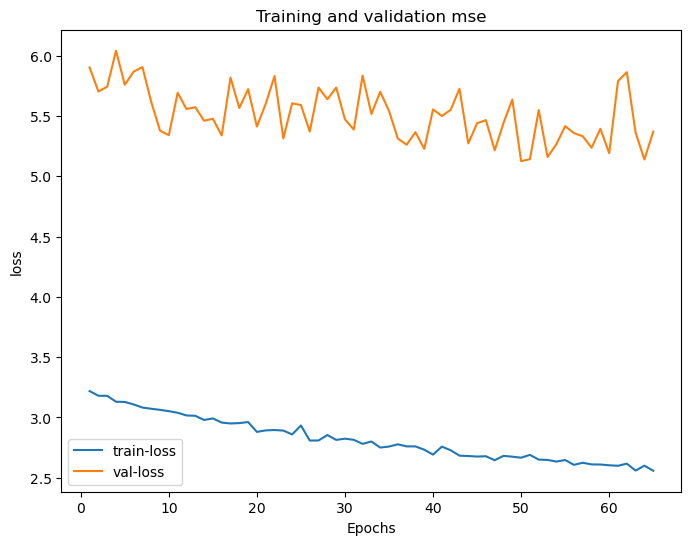

2023-01-26 00:15:41.918795: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:15:41.960024: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:15:41.968201: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


133/133 [==============================] - 2s 15ms/step
Epoch 1/1000


2023-01-26 00:15:45.050811: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:15:45.219466: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:15:45.236599: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:15:45.777718: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:15:45.792071: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


545/545 [==============================] - ETA: 0s - loss: 2.7890e-04 - mean_squared_error: 58.6506 - mean_absolute_error: 5.6730 - accuracy: 1.1956e-06 - root_mean_squared_error: 7.6584 - logcosh: 5.0344 - kullback_leibler_divergence: 2.7890e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8416 - csi: 0.9862 - freqbiassc: 1531.8021 - f1: 0.9992 - ham: 2.1479 - match1: 3.8441 - match2: 7.5413 - match3: 11.0755 - match5: 17.4786

2023-01-26 00:16:08.691010: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:16:08.789626: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:16:08.802699: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: saving model to /Users/sn/Downloads//Models/training_1/cp.ckpt


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 35s 61ms/step - loss: 2.7890e-04 - mean_squared_error: 58.6506 - mean_absolute_error: 5.6730 - accuracy: 1.1956e-06 - root_mean_squared_error: 7.6584 - logcosh: 5.0344 - kullback_leibler_divergence: 2.7890e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8416 - csi: 0.9862 - freqbiassc: 1531.8021 - f1: 0.9992 - ham: 2.1479 - match1: 3.8441 - match2: 7.5413 - match3: 11.0755 - match5: 17.4786 - val_loss: -2.8815e-05 - val_mean_squared_error: 80.4945 - val_mean_absolute_error: 6.5251 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.9719 - val_logcosh: 5.8806 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7812 - val_csi: 0.9911 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2919 - val_match1: 3.6143 - val_match2: 7.1343 - val_match3: 10.5013 - val_match5: 16.5459
Epoch 2/1000
545/545 [==============================] - ETA: 0s - loss: -1.3863e-04 - mean_squa

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: -1.3863e-04 - mean_squared_error: 61.0961 - mean_absolute_error: 5.8332 - accuracy: 0.0000e+00 - root_mean_squared_error: 7.8164 - logcosh: 5.1924 - kullback_leibler_divergence: -1.3863e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8350 - csi: 0.9864 - freqbiassc: 1531.7139 - f1: 0.9991 - ham: 2.1825 - match1: 3.7134 - match2: 7.2883 - match3: 10.7165 - match5: 16.9366 - val_loss: -2.8815e-05 - val_mean_squared_error: 78.8172 - val_mean_absolute_error: 6.3805 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8779 - val_logcosh: 5.7386 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7857 - val_csi: 0.9904 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2563 - val_match1: 3.8236 - val_match2: 7.5520 - val_match3: 11.1480 - val_match5: 17.4438
Epoch 3/1000
545/545 [==============================] - ETA: 0s - loss: -1.4642e-04 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: -1.4642e-04 - mean_squared_error: 58.8870 - mean_absolute_error: 5.6691 - accuracy: 0.0000e+00 - root_mean_squared_error: 7.6738 - logcosh: 5.0294 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8409 - csi: 0.9855 - freqbiassc: 1531.6902 - f1: 0.9990 - ham: 2.1481 - match1: 3.7704 - match2: 7.4083 - match3: 10.9794 - match5: 17.5732 - val_loss: -2.8815e-05 - val_mean_squared_error: 78.8116 - val_mean_absolute_error: 6.3797 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8776 - val_logcosh: 5.7379 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7857 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2561 - val_match1: 3.8210 - val_match2: 7.5625 - val_match3: 11.1556 - val_match5: 17.4513
Epoch 4/1000
545/545 [==============================] - ETA: 0s - loss: -1.4642e-04 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: -1.4642e-04 - mean_squared_error: 58.8871 - mean_absolute_error: 5.6691 - accuracy: 0.0000e+00 - root_mean_squared_error: 7.6738 - logcosh: 5.0294 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8410 - csi: 0.9855 - freqbiassc: 1531.6906 - f1: 0.9990 - ham: 2.1479 - match1: 3.7710 - match2: 7.4089 - match3: 10.9799 - match5: 17.5723 - val_loss: -2.8815e-05 - val_mean_squared_error: 78.8117 - val_mean_absolute_error: 6.3797 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8776 - val_logcosh: 5.7379 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7857 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2561 - val_match1: 3.8207 - val_match2: 7.5615 - val_match3: 11.1557 - val_match5: 17.4512
Epoch 5/1000
545/545 [==============================] - ETA: 0s - loss: -1.4642e-04 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -1.4642e-04 - mean_squared_error: 58.8872 - mean_absolute_error: 5.6691 - accuracy: 0.0000e+00 - root_mean_squared_error: 7.6738 - logcosh: 5.0294 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8409 - csi: 0.9855 - freqbiassc: 1531.6904 - f1: 0.9990 - ham: 2.1480 - match1: 3.7717 - match2: 7.4094 - match3: 10.9808 - match5: 17.5733 - val_loss: -2.8815e-05 - val_mean_squared_error: 78.8117 - val_mean_absolute_error: 6.3797 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8776 - val_logcosh: 5.7379 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7857 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2561 - val_match1: 3.8214 - val_match2: 7.5615 - val_match3: 11.1556 - val_match5: 17.4508
Epoch 6/1000
545/545 [==============================] - ETA: 0s - loss: -1.4642e-04 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -1.4642e-04 - mean_squared_error: 58.8874 - mean_absolute_error: 5.6691 - accuracy: 0.0000e+00 - root_mean_squared_error: 7.6738 - logcosh: 5.0294 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8409 - csi: 0.9855 - freqbiassc: 1531.6903 - f1: 0.9990 - ham: 2.1480 - match1: 3.7704 - match2: 7.4086 - match3: 10.9808 - match5: 17.5746 - val_loss: -2.8815e-05 - val_mean_squared_error: 78.8118 - val_mean_absolute_error: 6.3797 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8776 - val_logcosh: 5.7379 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7857 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2561 - val_match1: 3.8218 - val_match2: 7.5621 - val_match3: 11.1564 - val_match5: 17.4509
Epoch 7/1000
545/545 [==============================] - ETA: 0s - loss: -1.4642e-04 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: -1.4642e-04 - mean_squared_error: 58.8876 - mean_absolute_error: 5.6691 - accuracy: 1.1956e-06 - root_mean_squared_error: 7.6738 - logcosh: 5.0294 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8409 - csi: 0.9855 - freqbiassc: 1531.6902 - f1: 0.9990 - ham: 2.1478 - match1: 3.7705 - match2: 7.4090 - match3: 10.9809 - match5: 17.5750 - val_loss: -2.8815e-05 - val_mean_squared_error: 78.8116 - val_mean_absolute_error: 6.3797 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8776 - val_logcosh: 5.7379 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7857 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2561 - val_match1: 3.8216 - val_match2: 7.5620 - val_match3: 11.1562 - val_match5: 17.4513
Epoch 8/1000
545/545 [==============================] - ETA: 0s - loss: -1.4642e-04 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: -1.4642e-04 - mean_squared_error: 58.8880 - mean_absolute_error: 5.6691 - accuracy: 1.1956e-06 - root_mean_squared_error: 7.6739 - logcosh: 5.0294 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8409 - csi: 0.9855 - freqbiassc: 1531.6904 - f1: 0.9990 - ham: 2.1480 - match1: 3.7703 - match2: 7.4106 - match3: 10.9819 - match5: 17.5748 - val_loss: -2.8815e-05 - val_mean_squared_error: 78.8114 - val_mean_absolute_error: 6.3797 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8776 - val_logcosh: 5.7378 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7857 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2561 - val_match1: 3.8212 - val_match2: 7.5629 - val_match3: 11.1560 - val_match5: 17.4507
Epoch 9/1000
545/545 [==============================] - ETA: 0s - loss: -1.4642e-04 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: -1.4642e-04 - mean_squared_error: 58.8885 - mean_absolute_error: 5.6691 - accuracy: 0.0000e+00 - root_mean_squared_error: 7.6739 - logcosh: 5.0294 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8409 - csi: 0.9855 - freqbiassc: 1531.6903 - f1: 0.9990 - ham: 2.1481 - match1: 3.7711 - match2: 7.4100 - match3: 10.9819 - match5: 17.5773 - val_loss: -2.8815e-05 - val_mean_squared_error: 78.8113 - val_mean_absolute_error: 6.3797 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8776 - val_logcosh: 5.7378 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7857 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2561 - val_match1: 3.8222 - val_match2: 7.5625 - val_match3: 11.1566 - val_match5: 17.4514
Epoch 10/1000
545/545 [==============================] - ETA: 0s - loss: -1.4642e-04 - mean_s

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -1.4642e-04 - mean_squared_error: 58.8889 - mean_absolute_error: 5.6692 - accuracy: 0.0000e+00 - root_mean_squared_error: 7.6739 - logcosh: 5.0294 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8409 - csi: 0.9855 - freqbiassc: 1531.6921 - f1: 0.9990 - ham: 2.1481 - match1: 3.7702 - match2: 7.4085 - match3: 10.9792 - match5: 17.5741 - val_loss: -2.8815e-05 - val_mean_squared_error: 78.8108 - val_mean_absolute_error: 6.3797 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8775 - val_logcosh: 5.7378 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7857 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2561 - val_match1: 3.8227 - val_match2: 7.5621 - val_match3: 11.1557 - val_match5: 17.4516
Epoch 11/1000
545/545 [==============================] - ETA: 0s - loss: -1.4642e-04 - mean_s

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: -1.4642e-04 - mean_squared_error: 58.8896 - mean_absolute_error: 5.6692 - accuracy: 0.0000e+00 - root_mean_squared_error: 7.6740 - logcosh: 5.0294 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8409 - csi: 0.9855 - freqbiassc: 1531.7070 - f1: 0.9990 - ham: 2.1482 - match1: 3.7715 - match2: 7.4102 - match3: 10.9824 - match5: 17.5754 - val_loss: -2.8815e-05 - val_mean_squared_error: 78.8104 - val_mean_absolute_error: 6.3796 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8775 - val_logcosh: 5.7377 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7857 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2561 - val_match1: 3.8220 - val_match2: 7.5611 - val_match3: 11.1562 - val_match5: 17.4520
Epoch 12/1000
545/545 [==============================] - ETA: 0s - loss: -1.4642e-04 - mean_s

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: -1.4642e-04 - mean_squared_error: 58.8903 - mean_absolute_error: 5.6692 - accuracy: 1.1956e-06 - root_mean_squared_error: 7.6740 - logcosh: 5.0295 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8409 - csi: 0.9855 - freqbiassc: 1531.6908 - f1: 0.9990 - ham: 2.1478 - match1: 3.7722 - match2: 7.4111 - match3: 10.9851 - match5: 17.5804 - val_loss: -2.8815e-05 - val_mean_squared_error: 78.8099 - val_mean_absolute_error: 6.3796 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8775 - val_logcosh: 5.7377 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7857 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2561 - val_match1: 3.8230 - val_match2: 7.5621 - val_match3: 11.1560 - val_match5: 17.4518
Epoch 13/1000
545/545 [==============================] - ETA: 0s - loss: -1.4642e-04 - mean_s

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: -1.4642e-04 - mean_squared_error: 58.8907 - mean_absolute_error: 5.6693 - accuracy: 0.0000e+00 - root_mean_squared_error: 7.6740 - logcosh: 5.0295 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8409 - csi: 0.9855 - freqbiassc: 1531.6903 - f1: 0.9990 - ham: 2.1480 - match1: 3.7707 - match2: 7.4088 - match3: 10.9811 - match5: 17.5732 - val_loss: -2.8815e-05 - val_mean_squared_error: 78.8095 - val_mean_absolute_error: 6.3795 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8775 - val_logcosh: 5.7377 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7857 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2561 - val_match1: 3.8219 - val_match2: 7.5610 - val_match3: 11.1567 - val_match5: 17.4514
Epoch 14/1000
545/545 [==============================] - ETA: 0s - loss: -1.4642e-04 - mean_s

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -1.4642e-04 - mean_squared_error: 58.8920 - mean_absolute_error: 5.6693 - accuracy: 0.0000e+00 - root_mean_squared_error: 7.6741 - logcosh: 5.0296 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8409 - csi: 0.9855 - freqbiassc: 1531.6903 - f1: 0.9990 - ham: 2.1483 - match1: 3.7699 - match2: 7.4066 - match3: 10.9785 - match5: 17.5706 - val_loss: -2.8815e-05 - val_mean_squared_error: 78.8088 - val_mean_absolute_error: 6.3795 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8774 - val_logcosh: 5.7376 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7857 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2560 - val_match1: 3.8213 - val_match2: 7.5625 - val_match3: 11.1562 - val_match5: 17.4508
Epoch 15/1000
545/545 [==============================] - ETA: 0s - loss: -1.4642e-04 - mean_s

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -1.4642e-04 - mean_squared_error: 58.8934 - mean_absolute_error: 5.6694 - accuracy: 0.0000e+00 - root_mean_squared_error: 7.6742 - logcosh: 5.0297 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8409 - csi: 0.9855 - freqbiassc: 1531.6902 - f1: 0.9990 - ham: 2.1480 - match1: 3.7708 - match2: 7.4094 - match3: 10.9828 - match5: 17.5742 - val_loss: -2.8815e-05 - val_mean_squared_error: 78.8081 - val_mean_absolute_error: 6.3794 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8774 - val_logcosh: 5.7375 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7857 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2560 - val_match1: 3.8214 - val_match2: 7.5642 - val_match3: 11.1563 - val_match5: 17.4510
Epoch 16/1000
545/545 [==============================] - ETA: 0s - loss: -1.4642e-04 - mean_s

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: -1.4642e-04 - mean_squared_error: 58.8942 - mean_absolute_error: 5.6694 - accuracy: 1.1956e-06 - root_mean_squared_error: 7.6743 - logcosh: 5.0297 - kullback_leibler_divergence: -1.4642e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8409 - csi: 0.9855 - freqbiassc: 1531.6904 - f1: 0.9990 - ham: 2.1480 - match1: 3.7707 - match2: 7.4105 - match3: 10.9845 - match5: 17.5753 - val_loss: -2.8815e-05 - val_mean_squared_error: 78.8071 - val_mean_absolute_error: 6.3793 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8773 - val_logcosh: 5.7374 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7857 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2560 - val_match1: 3.8206 - val_match2: 7.5630 - val_match3: 11.1567 - val_match5: 17.4539
TEST PERFORMANCE: KLDivergence o
133/133 [==============================] - 4s 28ms/step - lo

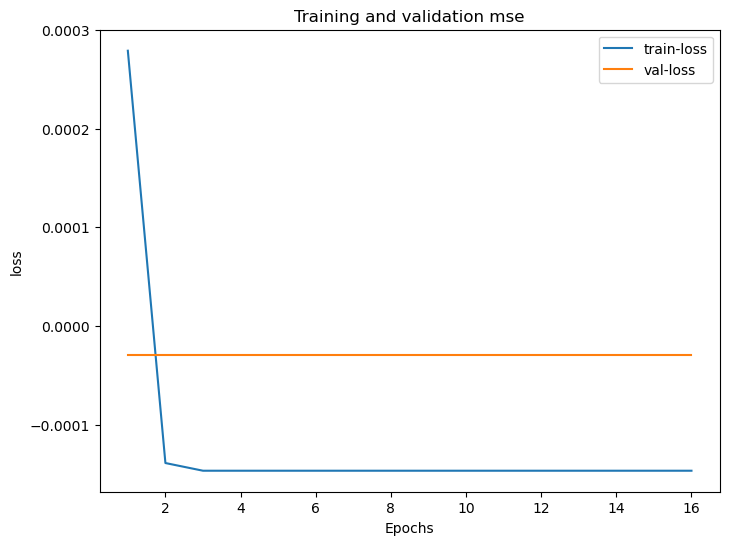

2023-01-26 00:24:04.002311: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:24:04.044327: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:24:04.052335: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


133/133 [==============================] - 2s 15ms/step
Epoch 1/1000


2023-01-26 00:24:07.195228: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:24:07.380418: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:24:07.400788: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:24:08.099578: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:24:08.114387: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


545/545 [==============================] - ETA: 0s - loss: -0.9987 - mean_squared_error: 19.5615 - mean_absolute_error: 3.2443 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.4228 - logcosh: 2.6440 - kullback_leibler_divergence: 0.0023 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9472 - csi: 0.9846 - freqbiassc: 1532.6407 - f1: 1.0004 - ham: 1.6229 - match1: 6.1349 - match2: 11.8390 - match3: 17.0386 - match5: 25.5461

2023-01-26 00:24:31.886814: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:24:31.991783: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:24:32.010663: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: saving model to /Users/sn/Downloads//Models/training_1/cp.ckpt


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 37s 64ms/step - loss: -0.9987 - mean_squared_error: 19.5615 - mean_absolute_error: 3.2443 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.4228 - logcosh: 2.6440 - kullback_leibler_divergence: 0.0023 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9472 - csi: 0.9846 - freqbiassc: 1532.6407 - f1: 1.0004 - ham: 1.6229 - match1: 6.1349 - match2: 11.8390 - match3: 17.0386 - match5: 25.5461 - val_loss: -0.9943 - val_mean_squared_error: 67.6320 - val_mean_absolute_error: 6.0274 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2239 - val_logcosh: 5.3835 - val_kullback_leibler_divergence: 4.9211e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8161 - val_csi: 0.9914 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.2122 - val_match1: 3.6243 - val_match2: 7.1202 - val_match3: 10.4826 - val_match5: 16.6954
Epoch 2/1000
545/545 [==============================] - ETA: 0s - loss: -0.9987 - mean_squared_error: 17.7

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 58ms/step - loss: -0.9987 - mean_squared_error: 17.7557 - mean_absolute_error: 3.1136 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.2138 - logcosh: 2.5156 - kullback_leibler_divergence: 0.0032 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9520 - csi: 0.9848 - freqbiassc: 1532.7910 - f1: 1.0006 - ham: 1.5928 - match1: 6.2757 - match2: 12.1413 - match3: 17.4493 - match5: 26.0879 - val_loss: -0.9944 - val_mean_squared_error: 70.1968 - val_mean_absolute_error: 6.0853 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3784 - val_logcosh: 5.4434 - val_kullback_leibler_divergence: 1.7667e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8091 - val_csi: 0.9909 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.2131 - val_match1: 3.7612 - val_match2: 7.4067 - val_match3: 10.9064 - val_match5: 17.1713
Epoch 3/1000
545/545 [==============================] - ETA: 0s - loss: -0.9987 - mean_squared_error: 18.2

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: -0.9987 - mean_squared_error: 18.2252 - mean_absolute_error: 3.1571 - accuracy: 3.5868e-06 - root_mean_squared_error: 4.2691 - logcosh: 2.5577 - kullback_leibler_divergence: 0.0045 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9508 - csi: 0.9848 - freqbiassc: 1532.7029 - f1: 1.0006 - ham: 1.6043 - match1: 6.1957 - match2: 11.9756 - match3: 17.2559 - match5: 25.8659 - val_loss: -0.9944 - val_mean_squared_error: 66.6554 - val_mean_absolute_error: 5.9267 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.1643 - val_logcosh: 5.2866 - val_kullback_leibler_divergence: 1.0204e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8188 - val_csi: 0.9913 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1823 - val_match1: 3.9607 - val_match2: 7.7352 - val_match3: 11.3754 - val_match5: 17.8453
Epoch 4/1000
545/545 [==============================] - ETA: 0s - loss: -0.9987 - mean_squared_error: 17.3

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -0.9987 - mean_squared_error: 17.3499 - mean_absolute_error: 3.0940 - accuracy: 2.3912e-06 - root_mean_squared_error: 4.1653 - logcosh: 2.4955 - kullback_leibler_divergence: 0.0042 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9531 - csi: 0.9848 - freqbiassc: 1532.6812 - f1: 1.0006 - ham: 1.5900 - match1: 6.2813 - match2: 12.1141 - match3: 17.4008 - match5: 26.0732 - val_loss: -0.9944 - val_mean_squared_error: 67.3223 - val_mean_absolute_error: 5.9400 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2050 - val_logcosh: 5.2998 - val_kullback_leibler_divergence: 9.9382e-06 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8170 - val_csi: 0.9904 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1844 - val_match1: 3.8643 - val_match2: 7.6346 - val_match3: 11.2594 - val_match5: 17.6520
Epoch 5/1000
545/545 [==============================] - ETA: 0s - loss: -0.9987 - mean_squared_error: 17.9

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: -0.9987 - mean_squared_error: 17.9207 - mean_absolute_error: 3.1480 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.2333 - logcosh: 2.5481 - kullback_leibler_divergence: 0.0036 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9516 - csi: 0.9848 - freqbiassc: 1532.7469 - f1: 1.0006 - ham: 1.6040 - match1: 6.1741 - match2: 11.9527 - match3: 17.1912 - match5: 25.7975 - val_loss: -0.9948 - val_mean_squared_error: 61.2523 - val_mean_absolute_error: 5.6302 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.8264 - val_logcosh: 4.9932 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8335 - val_csi: 0.9896 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1233 - val_match1: 4.0764 - val_match2: 8.0543 - val_match3: 11.8245 - val_match5: 18.4908
Epoch 6/1000
545/545 [==============================] - ETA: 0s - loss: -0.9987 - mean_squared_error: 17.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -0.9987 - mean_squared_error: 17.5476 - mean_absolute_error: 3.1125 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.1890 - logcosh: 2.5136 - kullback_leibler_divergence: 0.0029 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9526 - csi: 0.9848 - freqbiassc: 1532.8370 - f1: 1.0006 - ham: 1.5947 - match1: 6.2296 - match2: 12.0678 - match3: 17.3624 - match5: 25.9661 - val_loss: -0.9943 - val_mean_squared_error: 70.5546 - val_mean_absolute_error: 6.1889 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3997 - val_logcosh: 5.5434 - val_kullback_leibler_divergence: -2.5600e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8082 - val_csi: 0.9922 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.2430 - val_match1: 3.5017 - val_match2: 6.9682 - val_match3: 10.3303 - val_match5: 16.5120
Epoch 7/1000
545/545 [==============================] - ETA: 0s - loss: -0.9987 - mean_squared_error: 17.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -0.9987 - mean_squared_error: 17.8923 - mean_absolute_error: 3.1371 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.2299 - logcosh: 2.5379 - kullback_leibler_divergence: 0.0030 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9517 - csi: 0.9848 - freqbiassc: 1532.7654 - f1: 1.0006 - ham: 1.6001 - match1: 6.2313 - match2: 12.0418 - match3: 17.3040 - match5: 25.8808 - val_loss: -0.9945 - val_mean_squared_error: 68.9810 - val_mean_absolute_error: 6.0952 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3055 - val_logcosh: 5.4520 - val_kullback_leibler_divergence: -2.6258e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8124 - val_csi: 0.9912 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2213 - val_match1: 3.6845 - val_match2: 7.2791 - val_match3: 10.7444 - val_match5: 17.0275
Epoch 8/1000
545/545 [==============================] - ETA: 0s - loss: -0.9987 - mean_squared_error: 18.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -0.9987 - mean_squared_error: 18.3320 - mean_absolute_error: 3.1862 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.2816 - logcosh: 2.5853 - kullback_leibler_divergence: 0.0040 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9505 - csi: 0.9847 - freqbiassc: 1532.7600 - f1: 1.0006 - ham: 1.6139 - match1: 6.1256 - match2: 11.8387 - match3: 17.0224 - match5: 25.5351 - val_loss: -0.9945 - val_mean_squared_error: 63.4290 - val_mean_absolute_error: 5.7387 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 7.9642 - val_logcosh: 5.1017 - val_kullback_leibler_divergence: 5.1442e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8275 - val_csi: 0.9899 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.1417 - val_match1: 4.1410 - val_match2: 8.1583 - val_match3: 12.0006 - val_match5: 18.6350
Epoch 9/1000
545/545 [==============================] - ETA: 0s - loss: -0.9987 - mean_squared_error: 17.7

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -0.9987 - mean_squared_error: 17.7518 - mean_absolute_error: 3.1481 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.2133 - logcosh: 2.5474 - kullback_leibler_divergence: 0.0040 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9521 - csi: 0.9848 - freqbiassc: 1532.7892 - f1: 1.0007 - ham: 1.6059 - match1: 6.1259 - match2: 11.7920 - match3: 17.0283 - match5: 25.6406 - val_loss: -0.9946 - val_mean_squared_error: 60.9560 - val_mean_absolute_error: 5.6377 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.8074 - val_logcosh: 5.0005 - val_kullback_leibler_divergence: 1.1358e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8343 - val_csi: 0.9900 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1266 - val_match1: 4.1006 - val_match2: 8.0796 - val_match3: 11.8670 - val_match5: 18.5661
Epoch 10/1000
545/545 [==============================] - ETA: 0s - loss: -0.9988 - mean_squared_error: 16.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -0.9988 - mean_squared_error: 16.8809 - mean_absolute_error: 3.0685 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.1086 - logcosh: 2.4702 - kullback_leibler_divergence: 0.0040 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9544 - csi: 0.9848 - freqbiassc: 1532.8002 - f1: 1.0007 - ham: 1.5852 - match1: 6.2974 - match2: 12.1270 - match3: 17.4614 - match5: 26.1273 - val_loss: -0.9944 - val_mean_squared_error: 65.6633 - val_mean_absolute_error: 5.8380 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.1033 - val_logcosh: 5.1996 - val_kullback_leibler_divergence: -2.5658e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8215 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1626 - val_match1: 4.0044 - val_match2: 7.8805 - val_match3: 11.5564 - val_match5: 17.9753
Epoch 11/1000
545/545 [==============================] - ETA: 0s - loss: -0.9988 - mean_squared_error: 17

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -0.9988 - mean_squared_error: 17.0562 - mean_absolute_error: 3.0892 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.1299 - logcosh: 2.4900 - kullback_leibler_divergence: 0.0040 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9539 - csi: 0.9849 - freqbiassc: 1532.8231 - f1: 1.0007 - ham: 1.5914 - match1: 6.2131 - match2: 12.0177 - match3: 17.2766 - match5: 25.9312 - val_loss: -0.9944 - val_mean_squared_error: 68.6100 - val_mean_absolute_error: 5.9994 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.2831 - val_logcosh: 5.3592 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8135 - val_csi: 0.9912 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1943 - val_match1: 3.9278 - val_match2: 7.6745 - val_match3: 11.2507 - val_match5: 17.6224
Epoch 12/1000
545/545 [==============================] - ETA: 0s - loss: -0.9988 - mean_squared_error: 16

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -0.9988 - mean_squared_error: 16.8470 - mean_absolute_error: 3.0724 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.1045 - logcosh: 2.4736 - kullback_leibler_divergence: 0.0039 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9545 - csi: 0.9849 - freqbiassc: 1532.8151 - f1: 1.0007 - ham: 1.5871 - match1: 6.2426 - match2: 12.0698 - match3: 17.3200 - match5: 26.0177 - val_loss: -0.9945 - val_mean_squared_error: 65.8367 - val_mean_absolute_error: 5.9113 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.1140 - val_logcosh: 5.2708 - val_kullback_leibler_divergence: 9.9382e-06 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8210 - val_csi: 0.9909 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1833 - val_match1: 3.8856 - val_match2: 7.5923 - val_match3: 11.1683 - val_match5: 17.4898
Epoch 13/1000
545/545 [==============================] - ETA: 0s - loss: -0.9987 - mean_squared_error: 17.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -0.9987 - mean_squared_error: 17.0878 - mean_absolute_error: 3.0960 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.1337 - logcosh: 2.4964 - kullback_leibler_divergence: 0.0039 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9538 - csi: 0.9848 - freqbiassc: 1532.8370 - f1: 1.0007 - ham: 1.5934 - match1: 6.2010 - match2: 11.9893 - match3: 17.2478 - match5: 25.8983 - val_loss: -0.9943 - val_mean_squared_error: 65.3178 - val_mean_absolute_error: 5.8043 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0819 - val_logcosh: 5.1665 - val_kullback_leibler_divergence: 5.6999e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8224 - val_csi: 0.9902 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.1538 - val_match1: 4.0628 - val_match2: 7.9631 - val_match3: 11.7235 - val_match5: 18.2324
Epoch 14/1000
545/545 [==============================] - ETA: 0s - loss: -0.9987 - mean_squared_error: 17.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -0.9987 - mean_squared_error: 17.4927 - mean_absolute_error: 3.1150 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.1824 - logcosh: 2.5155 - kullback_leibler_divergence: 0.0037 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9528 - csi: 0.9847 - freqbiassc: 1532.6755 - f1: 1.0005 - ham: 1.5970 - match1: 6.2213 - match2: 11.9624 - match3: 17.2292 - match5: 25.8704 - val_loss: -0.9945 - val_mean_squared_error: 64.6130 - val_mean_absolute_error: 5.8068 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0382 - val_logcosh: 5.1689 - val_kullback_leibler_divergence: 1.0058e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8243 - val_csi: 0.9905 - val_freqbiassc: 1534.3258 - val_f1: 0.9998 - val_ham: 2.1573 - val_match1: 4.0392 - val_match2: 7.9303 - val_match3: 11.6264 - val_match5: 18.0558
Epoch 15/1000
545/545 [==============================] - ETA: 0s - loss: -0.9987 - mean_squared_error: 17.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: -0.9987 - mean_squared_error: 17.2337 - mean_absolute_error: 3.1094 - accuracy: 3.5868e-06 - root_mean_squared_error: 4.1514 - logcosh: 2.5093 - kullback_leibler_divergence: 0.0041 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9535 - csi: 0.9848 - freqbiassc: 1532.8094 - f1: 1.0007 - ham: 1.5971 - match1: 6.1633 - match2: 11.9602 - match3: 17.1922 - match5: 25.8321 - val_loss: -0.9944 - val_mean_squared_error: 65.7253 - val_mean_absolute_error: 5.9235 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1071 - val_logcosh: 5.2819 - val_kullback_leibler_divergence: 5.2773e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8213 - val_csi: 0.9904 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1890 - val_match1: 3.7833 - val_match2: 7.4227 - val_match3: 10.9565 - val_match5: 17.2448
Epoch 16/1000
545/545 [==============================] - ETA: 0s - loss: -0.9988 - mean_squared_error: 16.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -0.9988 - mean_squared_error: 16.8311 - mean_absolute_error: 3.0726 - accuracy: 2.3912e-06 - root_mean_squared_error: 4.1026 - logcosh: 2.4733 - kullback_leibler_divergence: 0.0038 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9545 - csi: 0.9849 - freqbiassc: 1532.8480 - f1: 1.0007 - ham: 1.5878 - match1: 6.1961 - match2: 11.9850 - match3: 17.3029 - match5: 26.0261 - val_loss: -0.9942 - val_mean_squared_error: 69.1392 - val_mean_absolute_error: 6.0606 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3150 - val_logcosh: 5.4192 - val_kullback_leibler_divergence: -2.1183e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8120 - val_csi: 0.9911 - val_freqbiassc: 1534.3258 - val_f1: 0.9998 - val_ham: 2.2099 - val_match1: 3.8502 - val_match2: 7.5553 - val_match3: 11.0681 - val_match5: 17.2900
Epoch 17/1000
545/545 [==============================] - ETA: 0s - loss: -0.9987 - mean_squared_error: 17

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -0.9987 - mean_squared_error: 17.2973 - mean_absolute_error: 3.1182 - accuracy: 2.3912e-06 - root_mean_squared_error: 4.1590 - logcosh: 2.5176 - kullback_leibler_divergence: 0.0037 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9533 - csi: 0.9848 - freqbiassc: 1532.8663 - f1: 1.0007 - ham: 1.5998 - match1: 6.1092 - match2: 11.8280 - match3: 17.0960 - match5: 25.7403 - val_loss: -0.9944 - val_mean_squared_error: 66.5590 - val_mean_absolute_error: 5.9355 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1584 - val_logcosh: 5.2943 - val_kullback_leibler_divergence: 8.7444e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8190 - val_csi: 0.9911 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.1872 - val_match1: 3.8465 - val_match2: 7.6297 - val_match3: 11.2325 - val_match5: 17.6351
Epoch 18/1000
545/545 [==============================] - ETA: 0s - loss: -0.9988 - mean_squared_error: 16.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -0.9988 - mean_squared_error: 16.5524 - mean_absolute_error: 3.0496 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.0685 - logcosh: 2.4511 - kullback_leibler_divergence: 0.0041 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9553 - csi: 0.9849 - freqbiassc: 1532.8204 - f1: 1.0007 - ham: 1.5820 - match1: 6.2480 - match2: 12.0936 - match3: 17.4166 - match5: 26.1210 - val_loss: -0.9945 - val_mean_squared_error: 66.6816 - val_mean_absolute_error: 5.9562 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1659 - val_logcosh: 5.3146 - val_kullback_leibler_divergence: 1.1554e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8187 - val_csi: 0.9911 - val_freqbiassc: 1534.3296 - val_f1: 0.9998 - val_ham: 2.1932 - val_match1: 3.7926 - val_match2: 7.4329 - val_match3: 10.9405 - val_match5: 17.2104
Epoch 19/1000
545/545 [==============================] - ETA: 0s - loss: -0.9988 - mean_squared_error: 16.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -0.9988 - mean_squared_error: 16.4914 - mean_absolute_error: 3.0468 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.0610 - logcosh: 2.4483 - kullback_leibler_divergence: 0.0039 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9555 - csi: 0.9849 - freqbiassc: 1532.8523 - f1: 1.0007 - ham: 1.5818 - match1: 6.2464 - match2: 12.0799 - match3: 17.3950 - match5: 26.1127 - val_loss: -0.9945 - val_mean_squared_error: 65.4243 - val_mean_absolute_error: 5.9057 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0885 - val_logcosh: 5.2642 - val_kullback_leibler_divergence: 9.9382e-06 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8221 - val_csi: 0.9905 - val_freqbiassc: 1534.3258 - val_f1: 0.9998 - val_ham: 2.1853 - val_match1: 3.7606 - val_match2: 7.4268 - val_match3: 10.9634 - val_match5: 17.3917
Epoch 20/1000
545/545 [==============================] - ETA: 0s - loss: -0.9988 - mean_squared_error: 16.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: -0.9988 - mean_squared_error: 16.8794 - mean_absolute_error: 3.0800 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.1085 - logcosh: 2.4806 - kullback_leibler_divergence: 0.0045 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9544 - csi: 0.9849 - freqbiassc: 1532.7892 - f1: 1.0007 - ham: 1.5901 - match1: 6.2099 - match2: 11.9762 - match3: 17.2373 - match5: 25.9110 - val_loss: -0.9948 - val_mean_squared_error: 62.4751 - val_mean_absolute_error: 5.6979 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9041 - val_logcosh: 5.0609 - val_kullback_leibler_divergence: 1.3859e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8301 - val_csi: 0.9893 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1363 - val_match1: 4.0473 - val_match2: 7.9853 - val_match3: 11.7351 - val_match5: 18.2818
TEST PERFORMANCE: omAccuracy obj
133/133 [==============================] - 4s 28ms/step - loss: -0.9936 -

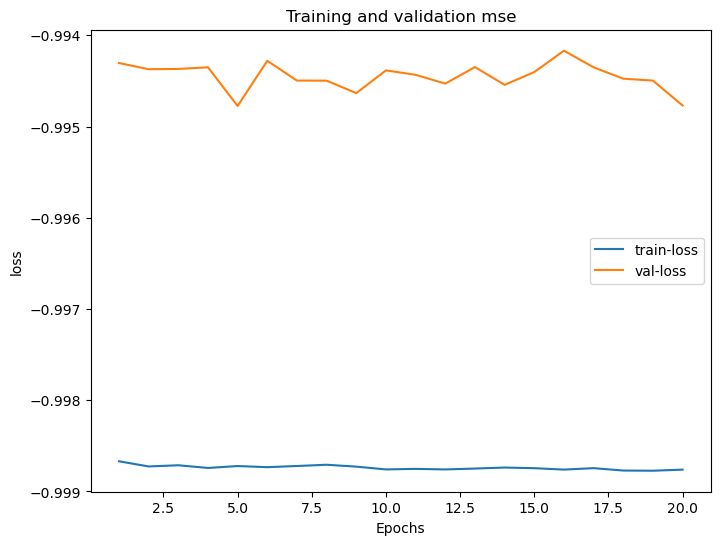

2023-01-26 00:34:37.655652: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:34:37.697130: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:34:37.705086: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


133/133 [==============================] - 2s 16ms/step
Epoch 1/1000


2023-01-26 00:34:40.926575: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:34:41.109397: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:34:41.131035: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:34:41.934725: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:34:41.949193: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


545/545 [==============================] - ETA: 0s - loss: 20855123968.0000 - mean_squared_error: 18.9363 - mean_absolute_error: 3.2442 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.3516 - logcosh: 2.6418 - kullback_leibler_divergence: 0.0016 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9489 - csi: 0.9858 - freqbiassc: 1532.6442 - f1: 1.0003 - ham: 1.6286 - match1: 6.1098 - match2: 11.8292 - match3: 16.9896 - match5: 25.4197

2023-01-26 00:35:06.370436: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:35:06.472782: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:35:06.493957: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: saving model to /Users/sn/Downloads//Models/training_1/cp.ckpt


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 38s 66ms/step - loss: 20855123968.0000 - mean_squared_error: 18.9363 - mean_absolute_error: 3.2442 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.3516 - logcosh: 2.6418 - kullback_leibler_divergence: 0.0016 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9489 - csi: 0.9858 - freqbiassc: 1532.6442 - f1: 1.0003 - ham: 1.6286 - match1: 6.1098 - match2: 11.8292 - match3: 16.9896 - match5: 25.4197 - val_loss: 60327436288.0000 - val_mean_squared_error: 66.0350 - val_mean_absolute_error: 6.0454 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1262 - val_logcosh: 5.4002 - val_kullback_leibler_divergence: 1.0779e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8205 - val_csi: 0.9914 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.2240 - val_match1: 3.5333 - val_match2: 6.9186 - val_match3: 10.2319 - val_match5: 16.2556
Epoch 2/1000
545/545 [==============================] - ETA: 0s - loss: 21248305152.0000

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: 21248305152.0000 - mean_squared_error: 19.5537 - mean_absolute_error: 3.3035 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.4220 - logcosh: 2.6992 - kullback_leibler_divergence: 0.0012 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9472 - csi: 0.9857 - freqbiassc: 1532.3965 - f1: 1.0000 - ham: 1.6442 - match1: 6.0264 - match2: 11.6158 - match3: 16.7093 - match5: 25.1095 - val_loss: 65645867008.0000 - val_mean_squared_error: 72.6353 - val_mean_absolute_error: 6.1768 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.5226 - val_logcosh: 5.5355 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8025 - val_csi: 0.9915 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.2239 - val_match1: 3.8883 - val_match2: 7.6654 - val_match3: 11.2477 - val_match5: 17.5784
Epoch 3/1000
545/545 [==============================] - ETA: 0s - loss: 20449329152.000

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: 20449329152.0000 - mean_squared_error: 19.1968 - mean_absolute_error: 3.2700 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3814 - logcosh: 2.6667 - kullback_leibler_divergence: 0.0014 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9481 - csi: 0.9856 - freqbiassc: 1532.3673 - f1: 1.0000 - ham: 1.6357 - match1: 6.1097 - match2: 11.7411 - match3: 16.8615 - match5: 25.3294 - val_loss: 55571648512.0000 - val_mean_squared_error: 62.8081 - val_mean_absolute_error: 5.7662 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9252 - val_logcosh: 5.1270 - val_kullback_leibler_divergence: -2.8639e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8292 - val_csi: 0.9906 - val_freqbiassc: 1534.3296 - val_f1: 0.9998 - val_ham: 2.1550 - val_match1: 4.0086 - val_match2: 7.8704 - val_match3: 11.5465 - val_match5: 17.9314
Epoch 4/1000
545/545 [==============================] - ETA: 0s - loss: 19898202112.000

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: 19898202112.0000 - mean_squared_error: 18.7374 - mean_absolute_error: 3.2393 - accuracy: 2.3912e-06 - root_mean_squared_error: 4.3287 - logcosh: 2.6365 - kullback_leibler_divergence: 8.0769e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9494 - csi: 0.9855 - freqbiassc: 1532.2004 - f1: 0.9998 - ham: 1.6287 - match1: 6.1583 - match2: 11.8670 - match3: 17.0098 - match5: 25.4671 - val_loss: 58345230336.0000 - val_mean_squared_error: 65.8661 - val_mean_absolute_error: 5.9821 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1158 - val_logcosh: 5.3392 - val_kullback_leibler_divergence: 9.9382e-06 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8209 - val_csi: 0.9912 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2044 - val_match1: 3.7460 - val_match2: 7.3515 - val_match3: 10.7975 - val_match5: 17.0790
Epoch 5/1000
545/545 [==============================] - ETA: 0s - loss: 20222707712.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 58ms/step - loss: 20222707712.0000 - mean_squared_error: 19.1257 - mean_absolute_error: 3.2747 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.3733 - logcosh: 2.6710 - kullback_leibler_divergence: 0.0011 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9483 - csi: 0.9855 - freqbiassc: 1532.2607 - f1: 0.9999 - ham: 1.6379 - match1: 6.0820 - match2: 11.7419 - match3: 16.8295 - match5: 25.2291 - val_loss: 62975778816.0000 - val_mean_squared_error: 66.8743 - val_mean_absolute_error: 6.0200 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1777 - val_logcosh: 5.3766 - val_kullback_leibler_divergence: -2.2379e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8182 - val_csi: 0.9918 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2104 - val_match1: 3.6520 - val_match2: 7.2660 - val_match3: 10.7383 - val_match5: 16.9256
Epoch 6/1000
545/545 [==============================] - ETA: 0s - loss: 20213145600.000

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: 20213145600.0000 - mean_squared_error: 19.0015 - mean_absolute_error: 3.2625 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3591 - logcosh: 2.6587 - kullback_leibler_divergence: 8.1910e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9487 - csi: 0.9854 - freqbiassc: 1532.2020 - f1: 0.9998 - ham: 1.6352 - match1: 6.0661 - match2: 11.7362 - match3: 16.8545 - match5: 25.3136 - val_loss: 67870289920.0000 - val_mean_squared_error: 77.4870 - val_mean_absolute_error: 6.4544 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.8027 - val_logcosh: 5.8097 - val_kullback_leibler_divergence: 1.0729e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7893 - val_csi: 0.9922 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.2808 - val_match1: 3.6615 - val_match2: 7.2547 - val_match3: 10.6717 - val_match5: 16.7679
Epoch 7/1000
545/545 [==============================] - ETA: 0s - loss: 20076357632.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 20076357632.0000 - mean_squared_error: 19.4122 - mean_absolute_error: 3.2952 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.4059 - logcosh: 2.6911 - kullback_leibler_divergence: 7.0756e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9476 - csi: 0.9854 - freqbiassc: 1532.2078 - f1: 0.9998 - ham: 1.6424 - match1: 6.0957 - match2: 11.7289 - match3: 16.8025 - match5: 25.1779 - val_loss: 55375486976.0000 - val_mean_squared_error: 64.2830 - val_mean_absolute_error: 5.8290 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0177 - val_logcosh: 5.1883 - val_kullback_leibler_divergence: 9.9382e-06 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8252 - val_csi: 0.9910 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.1680 - val_match1: 3.8602 - val_match2: 7.6439 - val_match3: 11.2909 - val_match5: 17.7071
Epoch 8/1000
545/545 [==============================] - ETA: 0s - loss: 20110411776.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 20110411776.0000 - mean_squared_error: 19.1507 - mean_absolute_error: 3.2827 - accuracy: 2.3912e-06 - root_mean_squared_error: 4.3762 - logcosh: 2.6784 - kullback_leibler_divergence: 9.0011e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9483 - csi: 0.9854 - freqbiassc: 1532.1653 - f1: 0.9997 - ham: 1.6408 - match1: 6.0583 - match2: 11.6905 - match3: 16.7753 - match5: 25.1304 - val_loss: 58153648128.0000 - val_mean_squared_error: 68.0854 - val_mean_absolute_error: 6.0235 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2514 - val_logcosh: 5.3812 - val_kullback_leibler_divergence: 9.9382e-06 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8149 - val_csi: 0.9916 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2060 - val_match1: 3.8195 - val_match2: 7.5148 - val_match3: 11.0910 - val_match5: 17.3032
Epoch 9/1000
545/545 [==============================] - ETA: 0s - loss: 19904860160.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 19904860160.0000 - mean_squared_error: 19.2137 - mean_absolute_error: 3.2803 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3833 - logcosh: 2.6764 - kullback_leibler_divergence: 9.8603e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9481 - csi: 0.9854 - freqbiassc: 1532.1489 - f1: 0.9997 - ham: 1.6392 - match1: 6.1038 - match2: 11.7423 - match3: 16.8612 - match5: 25.2454 - val_loss: 61891469312.0000 - val_mean_squared_error: 68.8712 - val_mean_absolute_error: 6.0603 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2989 - val_logcosh: 5.4185 - val_kullback_leibler_divergence: -2.4826e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8127 - val_csi: 0.9914 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2106 - val_match1: 3.8336 - val_match2: 7.5275 - val_match3: 11.0899 - val_match5: 17.3654
Epoch 10/1000
545/545 [==============================] - ETA: 0s - loss: 1933046784

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 19330467840.0000 - mean_squared_error: 18.9326 - mean_absolute_error: 3.2615 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.3512 - logcosh: 2.6576 - kullback_leibler_divergence: 9.6876e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9489 - csi: 0.9853 - freqbiassc: 1532.1064 - f1: 0.9997 - ham: 1.6357 - match1: 6.0980 - match2: 11.7696 - match3: 16.9154 - match5: 25.3096 - val_loss: 52298747904.0000 - val_mean_squared_error: 62.5710 - val_mean_absolute_error: 5.7250 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9102 - val_logcosh: 5.0876 - val_kullback_leibler_divergence: 1.2675e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8299 - val_csi: 0.9895 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.1424 - val_match1: 4.1029 - val_match2: 8.0879 - val_match3: 11.8402 - val_match5: 18.3767
Epoch 11/1000
545/545 [==============================] - ETA: 0s - loss: 20111882240

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 20111882240.0000 - mean_squared_error: 19.9338 - mean_absolute_error: 3.3432 - accuracy: 2.3912e-06 - root_mean_squared_error: 4.4647 - logcosh: 2.7375 - kullback_leibler_divergence: 7.1287e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9462 - csi: 0.9853 - freqbiassc: 1532.0714 - f1: 0.9996 - ham: 1.6552 - match1: 5.9915 - match2: 11.5705 - match3: 16.6301 - match5: 24.9250 - val_loss: 62187909120.0000 - val_mean_squared_error: 71.8390 - val_mean_absolute_error: 6.2023 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.4758 - val_logcosh: 5.5593 - val_kullback_leibler_divergence: -2.3982e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8047 - val_csi: 0.9920 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2367 - val_match1: 3.7802 - val_match2: 7.4680 - val_match3: 10.9867 - val_match5: 17.2157
Epoch 12/1000
545/545 [==============================] - ETA: 0s - loss: 1938466406

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 19384664064.0000 - mean_squared_error: 18.9029 - mean_absolute_error: 3.2665 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.3477 - logcosh: 2.6621 - kullback_leibler_divergence: 9.4581e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9489 - csi: 0.9853 - freqbiassc: 1532.0756 - f1: 0.9996 - ham: 1.6375 - match1: 6.0731 - match2: 11.7227 - match3: 16.8536 - match5: 25.2267 - val_loss: 60555128832.0000 - val_mean_squared_error: 66.5859 - val_mean_absolute_error: 5.9990 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1600 - val_logcosh: 5.3561 - val_kullback_leibler_divergence: 5.0765e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8190 - val_csi: 0.9910 - val_freqbiassc: 1534.3148 - val_f1: 0.9998 - val_ham: 2.2054 - val_match1: 3.7045 - val_match2: 7.3424 - val_match3: 10.8530 - val_match5: 17.1048
Epoch 13/1000
545/545 [==============================] - ETA: 0s - loss: 19533737984

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 19533737984.0000 - mean_squared_error: 19.2822 - mean_absolute_error: 3.2905 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3912 - logcosh: 2.6857 - kullback_leibler_divergence: 8.2786e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9479 - csi: 0.9853 - freqbiassc: 1532.0446 - f1: 0.9996 - ham: 1.6428 - match1: 6.0486 - match2: 11.6863 - match3: 16.8258 - match5: 25.1733 - val_loss: 59042140160.0000 - val_mean_squared_error: 67.9657 - val_mean_absolute_error: 5.9875 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2441 - val_logcosh: 5.3470 - val_kullback_leibler_divergence: 5.1725e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8152 - val_csi: 0.9912 - val_freqbiassc: 1534.3148 - val_f1: 0.9998 - val_ham: 2.1930 - val_match1: 3.9204 - val_match2: 7.7432 - val_match3: 11.4164 - val_match5: 17.8088
Epoch 14/1000
545/545 [==============================] - ETA: 0s - loss: 19371581440

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 19371581440.0000 - mean_squared_error: 20.0289 - mean_absolute_error: 3.3340 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.4754 - logcosh: 2.7287 - kullback_leibler_divergence: 9.9265e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9459 - csi: 0.9851 - freqbiassc: 1531.9821 - f1: 0.9995 - ham: 1.6519 - match1: 6.0636 - match2: 11.6959 - match3: 16.7843 - match5: 25.0833 - val_loss: 57206603776.0000 - val_mean_squared_error: 68.6704 - val_mean_absolute_error: 6.0225 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2868 - val_logcosh: 5.3811 - val_kullback_leibler_divergence: 4.8691e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8133 - val_csi: 0.9909 - val_freqbiassc: 1534.3148 - val_f1: 0.9998 - val_ham: 2.2017 - val_match1: 3.8785 - val_match2: 7.6918 - val_match3: 11.2820 - val_match5: 17.5404
Epoch 15/1000
545/545 [==============================] - ETA: 0s - loss: 19102113792

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 19102113792.0000 - mean_squared_error: 18.8590 - mean_absolute_error: 3.2639 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3427 - logcosh: 2.6596 - kullback_leibler_divergence: 0.0011 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9491 - csi: 0.9853 - freqbiassc: 1532.0845 - f1: 0.9997 - ham: 1.6371 - match1: 6.0906 - match2: 11.7643 - match3: 16.8854 - match5: 25.2159 - val_loss: 60960776192.0000 - val_mean_squared_error: 70.0064 - val_mean_absolute_error: 6.1401 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.3670 - val_logcosh: 5.4968 - val_kullback_leibler_divergence: 1.2712e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8097 - val_csi: 0.9916 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.2288 - val_match1: 3.7297 - val_match2: 7.3558 - val_match3: 10.8460 - val_match5: 17.0193
Epoch 16/1000
545/545 [==============================] - ETA: 0s - loss: 19146160128.000

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 19146160128.0000 - mean_squared_error: 18.8919 - mean_absolute_error: 3.2688 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3465 - logcosh: 2.6644 - kullback_leibler_divergence: 0.0011 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9490 - csi: 0.9853 - freqbiassc: 1532.1215 - f1: 0.9997 - ham: 1.6384 - match1: 6.0845 - match2: 11.7418 - match3: 16.8677 - match5: 25.2121 - val_loss: 58923814912.0000 - val_mean_squared_error: 66.9886 - val_mean_absolute_error: 5.9665 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1847 - val_logcosh: 5.3252 - val_kullback_leibler_divergence: 1.2540e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8179 - val_csi: 0.9908 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.1940 - val_match1: 3.8673 - val_match2: 7.6004 - val_match3: 11.1856 - val_match5: 17.5009
Epoch 17/1000
545/545 [==============================] - ETA: 0s - loss: 20359411712.000

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 20359411712.0000 - mean_squared_error: 20.7811 - mean_absolute_error: 3.3964 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.5586 - logcosh: 2.7895 - kullback_leibler_divergence: 0.0010 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9439 - csi: 0.9851 - freqbiassc: 1532.0278 - f1: 0.9996 - ham: 1.6670 - match1: 5.9310 - match2: 11.4851 - match3: 16.5275 - match5: 24.7852 - val_loss: 55612706816.0000 - val_mean_squared_error: 65.4190 - val_mean_absolute_error: 5.9187 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0882 - val_logcosh: 5.2767 - val_kullback_leibler_divergence: 1.2457e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8221 - val_csi: 0.9910 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.1886 - val_match1: 3.8213 - val_match2: 7.4816 - val_match3: 11.0237 - val_match5: 17.4011
Epoch 18/1000
545/545 [==============================] - ETA: 0s - loss: 19099052032.000

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 19099052032.0000 - mean_squared_error: 18.9826 - mean_absolute_error: 3.2758 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3569 - logcosh: 2.6711 - kullback_leibler_divergence: 8.6674e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9487 - csi: 0.9851 - freqbiassc: 1532.0167 - f1: 0.9996 - ham: 1.6402 - match1: 6.0669 - match2: 11.7218 - match3: 16.8412 - match5: 25.2254 - val_loss: 56840552448.0000 - val_mean_squared_error: 65.5430 - val_mean_absolute_error: 5.9355 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0959 - val_logcosh: 5.2936 - val_kullback_leibler_divergence: 1.2094e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8218 - val_csi: 0.9908 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.1914 - val_match1: 3.7894 - val_match2: 7.5193 - val_match3: 11.0519 - val_match5: 17.3529
Epoch 19/1000
545/545 [==============================] - ETA: 0s - loss: 18756704256

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 18756704256.0000 - mean_squared_error: 18.9408 - mean_absolute_error: 3.2708 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3521 - logcosh: 2.6662 - kullback_leibler_divergence: 6.9715e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9488 - csi: 0.9850 - freqbiassc: 1531.9015 - f1: 0.9994 - ham: 1.6391 - match1: 6.0936 - match2: 11.7744 - match3: 16.8876 - match5: 25.2633 - val_loss: 60008390656.0000 - val_mean_squared_error: 68.7766 - val_mean_absolute_error: 6.1199 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2932 - val_logcosh: 5.4753 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8130 - val_csi: 0.9916 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2307 - val_match1: 3.6250 - val_match2: 7.1598 - val_match3: 10.5608 - val_match5: 16.7743
Epoch 20/1000
545/545 [==============================] - ETA: 0s - loss: 1922841395

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 19228413952.0000 - mean_squared_error: 19.5187 - mean_absolute_error: 3.3196 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.4180 - logcosh: 2.7139 - kullback_leibler_divergence: 9.0278e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9473 - csi: 0.9851 - freqbiassc: 1531.9249 - f1: 0.9995 - ham: 1.6511 - match1: 6.0298 - match2: 11.6424 - match3: 16.7319 - match5: 25.0427 - val_loss: 56947130368.0000 - val_mean_squared_error: 64.4608 - val_mean_absolute_error: 5.8641 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0288 - val_logcosh: 5.2234 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8247 - val_csi: 0.9903 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1754 - val_match1: 3.8652 - val_match2: 7.6528 - val_match3: 11.2753 - val_match5: 17.7285
Epoch 21/1000
545/545 [==============================] - ETA: 0s - loss: 1937743462

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 19377434624.0000 - mean_squared_error: 19.2818 - mean_absolute_error: 3.2981 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3911 - logcosh: 2.6930 - kullback_leibler_divergence: 8.3481e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9479 - csi: 0.9851 - freqbiassc: 1531.9822 - f1: 0.9995 - ham: 1.6459 - match1: 6.0600 - match2: 11.6793 - match3: 16.7925 - match5: 25.1080 - val_loss: 60434513920.0000 - val_mean_squared_error: 67.7856 - val_mean_absolute_error: 6.0379 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.2332 - val_logcosh: 5.3950 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8157 - val_csi: 0.9911 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2107 - val_match1: 3.7309 - val_match2: 7.3712 - val_match3: 10.9009 - val_match5: 17.1491
Epoch 22/1000
545/545 [==============================] - ETA: 0s - loss: 1876565196

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 18765651968.0000 - mean_squared_error: 19.0521 - mean_absolute_error: 3.2832 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3649 - logcosh: 2.6784 - kullback_leibler_divergence: 5.5979e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9485 - csi: 0.9851 - freqbiassc: 1531.9688 - f1: 0.9995 - ham: 1.6420 - match1: 6.0970 - match2: 11.7716 - match3: 16.8957 - match5: 25.1891 - val_loss: 58350804992.0000 - val_mean_squared_error: 67.6992 - val_mean_absolute_error: 6.0333 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2280 - val_logcosh: 5.3889 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8159 - val_csi: 0.9915 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2138 - val_match1: 3.6269 - val_match2: 7.1660 - val_match3: 10.6144 - val_match5: 16.8493
Epoch 23/1000
545/545 [==============================] - ETA: 0s - loss: 1857374412

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 18573744128.0000 - mean_squared_error: 19.2029 - mean_absolute_error: 3.2946 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3821 - logcosh: 2.6894 - kullback_leibler_divergence: 9.9716e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9481 - csi: 0.9850 - freqbiassc: 1531.8611 - f1: 0.9994 - ham: 1.6450 - match1: 6.0789 - match2: 11.7501 - match3: 16.8681 - match5: 25.1725 - val_loss: 58852700160.0000 - val_mean_squared_error: 68.3231 - val_mean_absolute_error: 6.0243 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2658 - val_logcosh: 5.3819 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8142 - val_csi: 0.9905 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2058 - val_match1: 3.7330 - val_match2: 7.3589 - val_match3: 10.9312 - val_match5: 17.2263
Epoch 24/1000
545/545 [==============================] - ETA: 0s - loss: 1826062950

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 18260629504.0000 - mean_squared_error: 19.0525 - mean_absolute_error: 3.2699 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.3649 - logcosh: 2.6655 - kullback_leibler_divergence: 7.2929e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9485 - csi: 0.9850 - freqbiassc: 1531.8591 - f1: 0.9994 - ham: 1.6380 - match1: 6.1352 - match2: 11.8635 - match3: 17.0200 - match5: 25.3469 - val_loss: 63769976832.0000 - val_mean_squared_error: 68.9770 - val_mean_absolute_error: 6.1387 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3052 - val_logcosh: 5.4944 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8125 - val_csi: 0.9919 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2334 - val_match1: 3.6624 - val_match2: 7.2136 - val_match3: 10.6075 - val_match5: 16.7559
Epoch 25/1000
545/545 [==============================] - ETA: 0s - loss: 1849476710

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 18494767104.0000 - mean_squared_error: 19.2592 - mean_absolute_error: 3.2928 - accuracy: 3.5868e-06 - root_mean_squared_error: 4.3885 - logcosh: 2.6879 - kullback_leibler_divergence: 8.5376e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9480 - csi: 0.9850 - freqbiassc: 1531.9252 - f1: 0.9994 - ham: 1.6441 - match1: 6.1132 - match2: 11.7741 - match3: 16.8850 - match5: 25.1931 - val_loss: 61145747456.0000 - val_mean_squared_error: 66.9941 - val_mean_absolute_error: 6.0297 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1850 - val_logcosh: 5.3862 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8179 - val_csi: 0.9916 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2127 - val_match1: 3.6822 - val_match2: 7.2986 - val_match3: 10.7620 - val_match5: 16.9683
TEST PERFORMANCE: _weighted_mse.
133/133 [==============================] - 4s 28ms

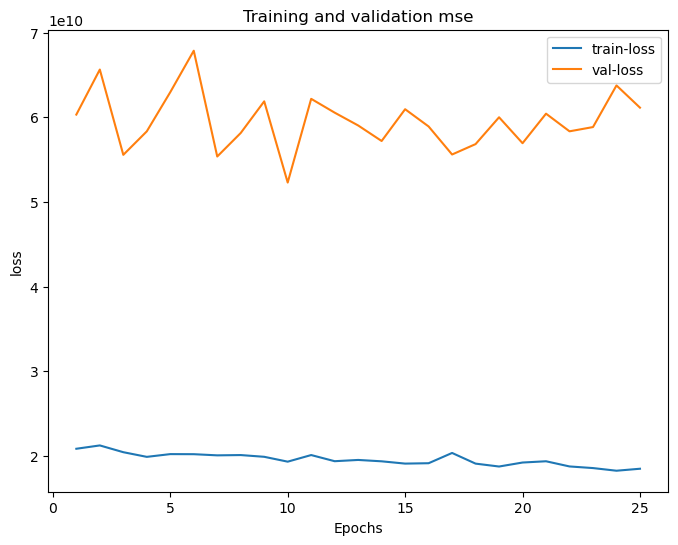

2023-01-26 00:47:50.689019: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:47:50.731371: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:47:50.738812: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


133/133 [==============================] - 2s 16ms/step
Epoch 1/1000


2023-01-26 00:47:53.975331: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:47:54.167664: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:47:54.187042: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:47:54.939555: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:47:54.954061: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


545/545 [==============================] - ETA: 0s - loss: 0.0314 - mean_squared_error: 17.7158 - mean_absolute_error: 3.1359 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.2090 - logcosh: 2.5364 - kullback_leibler_divergence: 0.0029 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9521 - csi: 0.9849 - freqbiassc: 1532.5874 - f1: 1.0004 - ham: 1.6010 - match1: 6.2932 - match2: 12.1458 - match3: 17.3864 - match5: 25.8935

2023-01-26 00:48:18.910055: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:48:19.006050: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 00:48:19.028362: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: saving model to /Users/sn/Downloads//Models/training_1/cp.ckpt


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 37s 65ms/step - loss: 0.0314 - mean_squared_error: 17.7158 - mean_absolute_error: 3.1359 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.2090 - logcosh: 2.5364 - kullback_leibler_divergence: 0.0029 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9521 - csi: 0.9849 - freqbiassc: 1532.5874 - f1: 1.0004 - ham: 1.6010 - match1: 6.2932 - match2: 12.1458 - match3: 17.3864 - match5: 25.8935 - val_loss: 0.0584 - val_mean_squared_error: 63.7186 - val_mean_absolute_error: 5.8405 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9824 - val_logcosh: 5.2002 - val_kullback_leibler_divergence: 5.0337e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8268 - val_csi: 0.9914 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.1724 - val_match1: 3.8778 - val_match2: 7.5868 - val_match3: 11.1939 - val_match5: 17.5706
Epoch 2/1000
545/545 [==============================] - ETA: 0s - loss: 0.0308 - mean_squared_error: 17.2266

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0308 - mean_squared_error: 17.2266 - mean_absolute_error: 3.0787 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.1505 - logcosh: 2.4813 - kullback_leibler_divergence: 0.0031 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9535 - csi: 0.9850 - freqbiassc: 1532.6975 - f1: 1.0005 - ham: 1.5850 - match1: 6.4134 - match2: 12.3614 - match3: 17.6864 - match5: 26.2271 - val_loss: 0.0604 - val_mean_squared_error: 67.9521 - val_mean_absolute_error: 6.0411 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2433 - val_logcosh: 5.3979 - val_kullback_leibler_divergence: 4.8691e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8152 - val_csi: 0.9918 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2125 - val_match1: 3.6769 - val_match2: 7.2733 - val_match3: 10.7076 - val_match5: 16.9536
Epoch 3/1000
545/545 [==============================] - ETA: 0s - loss: 0.0308 - mean_squared_error: 17.4038

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: 0.0308 - mean_squared_error: 17.4038 - mean_absolute_error: 3.0831 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.1718 - logcosh: 2.4859 - kullback_leibler_divergence: 0.0035 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9530 - csi: 0.9850 - freqbiassc: 1532.7288 - f1: 1.0006 - ham: 1.5850 - match1: 6.3745 - match2: 12.3230 - match3: 17.7132 - match5: 26.2858 - val_loss: 0.0617 - val_mean_squared_error: 69.1670 - val_mean_absolute_error: 6.1660 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3167 - val_logcosh: 5.5204 - val_kullback_leibler_divergence: 1.0183e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8119 - val_csi: 0.9923 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2420 - val_match1: 3.4695 - val_match2: 6.8986 - val_match3: 10.2544 - val_match5: 16.3651
Epoch 4/1000
545/545 [==============================] - ETA: 0s - loss: 0.0304 - mean_squared_error: 17.0338

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0304 - mean_squared_error: 17.0338 - mean_absolute_error: 3.0402 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.1272 - logcosh: 2.4450 - kullback_leibler_divergence: 0.0033 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9540 - csi: 0.9852 - freqbiassc: 1532.7782 - f1: 1.0006 - ham: 1.5723 - match1: 6.5346 - match2: 12.5775 - match3: 17.9723 - match5: 26.6074 - val_loss: 0.0580 - val_mean_squared_error: 63.2329 - val_mean_absolute_error: 5.7953 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9519 - val_logcosh: 5.1551 - val_kullback_leibler_divergence: 5.2806e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8281 - val_csi: 0.9902 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.1635 - val_match1: 3.8480 - val_match2: 7.5625 - val_match3: 11.2002 - val_match5: 17.6119
Epoch 5/1000
545/545 [==============================] - ETA: 0s - loss: 0.0306 - mean_squared_error: 17.3627

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0306 - mean_squared_error: 17.3627 - mean_absolute_error: 3.0650 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.1669 - logcosh: 2.4691 - kullback_leibler_divergence: 0.0038 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9531 - csi: 0.9851 - freqbiassc: 1532.7178 - f1: 1.0006 - ham: 1.5785 - match1: 6.4978 - match2: 12.4890 - match3: 17.8760 - match5: 26.4667 - val_loss: 0.0585 - val_mean_squared_error: 65.9793 - val_mean_absolute_error: 5.8521 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1228 - val_logcosh: 5.2125 - val_kullback_leibler_divergence: 4.9474e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8206 - val_csi: 0.9910 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1670 - val_match1: 3.8889 - val_match2: 7.7022 - val_match3: 11.3705 - val_match5: 17.8140
Epoch 6/1000
545/545 [==============================] - ETA: 0s - loss: 0.0304 - mean_squared_error: 17.1710

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0304 - mean_squared_error: 17.1710 - mean_absolute_error: 3.0411 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.1438 - logcosh: 2.4465 - kullback_leibler_divergence: 0.0037 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9536 - csi: 0.9851 - freqbiassc: 1532.7029 - f1: 1.0006 - ham: 1.5713 - match1: 6.5637 - match2: 12.6160 - match3: 18.0378 - match5: 26.6716 - val_loss: 0.0605 - val_mean_squared_error: 67.8922 - val_mean_absolute_error: 6.0522 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2397 - val_logcosh: 5.4077 - val_kullback_leibler_divergence: 4.9191e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8154 - val_csi: 0.9917 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2173 - val_match1: 3.5033 - val_match2: 6.9937 - val_match3: 10.3930 - val_match5: 16.6571
Epoch 7/1000
545/545 [==============================] - ETA: 0s - loss: 0.0300 - mean_squared_error: 16.7512

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 0.0300 - mean_squared_error: 16.7512 - mean_absolute_error: 3.0000 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.0928 - logcosh: 2.4068 - kullback_leibler_divergence: 0.0039 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9548 - csi: 0.9851 - freqbiassc: 1532.7562 - f1: 1.0006 - ham: 1.5601 - match1: 6.6581 - match2: 12.7920 - match3: 18.2344 - match5: 26.9080 - val_loss: 0.0608 - val_mean_squared_error: 69.0169 - val_mean_absolute_error: 6.0843 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.3076 - val_logcosh: 5.4405 - val_kullback_leibler_divergence: 1.2478e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8123 - val_csi: 0.9918 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2196 - val_match1: 3.6459 - val_match2: 7.1733 - val_match3: 10.6036 - val_match5: 16.8946
Epoch 8/1000
545/545 [==============================] - ETA: 0s - loss: 0.0304 - mean_squared_error: 17.1388

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 0.0304 - mean_squared_error: 17.1388 - mean_absolute_error: 3.0355 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.1399 - logcosh: 2.4412 - kullback_leibler_divergence: 0.0037 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9537 - csi: 0.9851 - freqbiassc: 1532.7618 - f1: 1.0006 - ham: 1.5696 - match1: 6.5857 - match2: 12.6507 - match3: 18.0599 - match5: 26.6577 - val_loss: 0.0580 - val_mean_squared_error: 64.1874 - val_mean_absolute_error: 5.8024 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.0117 - val_logcosh: 5.1627 - val_kullback_leibler_divergence: 9.9382e-06 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8255 - val_csi: 0.9908 - val_freqbiassc: 1534.3258 - val_f1: 0.9998 - val_ham: 2.1613 - val_match1: 3.8866 - val_match2: 7.6489 - val_match3: 11.2696 - val_match5: 17.7824
Epoch 9/1000
545/545 [==============================] - ETA: 0s - loss: 0.0303 - mean_squared_error: 17.0743

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0303 - mean_squared_error: 17.0743 - mean_absolute_error: 3.0308 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.1321 - logcosh: 2.4362 - kullback_leibler_divergence: 0.0034 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9539 - csi: 0.9851 - freqbiassc: 1532.7745 - f1: 1.0006 - ham: 1.5687 - match1: 6.5476 - match2: 12.6239 - match3: 18.0516 - match5: 26.6771 - val_loss: 0.0597 - val_mean_squared_error: 66.3942 - val_mean_absolute_error: 5.9678 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1483 - val_logcosh: 5.3250 - val_kullback_leibler_divergence: 5.2328e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8195 - val_csi: 0.9913 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1989 - val_match1: 3.6426 - val_match2: 7.2707 - val_match3: 10.7387 - val_match5: 17.0276
Epoch 10/1000
545/545 [==============================] - ETA: 0s - loss: 0.0301 - mean_squared_error: 16.888

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 0.0301 - mean_squared_error: 16.8882 - mean_absolute_error: 3.0115 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.1095 - logcosh: 2.4178 - kullback_leibler_divergence: 0.0035 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9544 - csi: 0.9851 - freqbiassc: 1532.8020 - f1: 1.0006 - ham: 1.5633 - match1: 6.6203 - match2: 12.7217 - match3: 18.1590 - match5: 26.8254 - val_loss: 0.0571 - val_mean_squared_error: 62.8223 - val_mean_absolute_error: 5.7099 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9260 - val_logcosh: 5.0721 - val_kullback_leibler_divergence: 5.0465e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8292 - val_csi: 0.9898 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1397 - val_match1: 4.0233 - val_match2: 7.9211 - val_match3: 11.6547 - val_match5: 18.1456
Epoch 11/1000
545/545 [==============================] - ETA: 0s - loss: 0.0299 - mean_squared_error: 16.738

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0299 - mean_squared_error: 16.7387 - mean_absolute_error: 2.9941 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.0913 - logcosh: 2.4009 - kullback_leibler_divergence: 0.0029 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9548 - csi: 0.9851 - freqbiassc: 1532.8184 - f1: 1.0006 - ham: 1.5586 - match1: 6.6299 - match2: 12.7750 - match3: 18.2527 - match5: 26.9578 - val_loss: 0.0590 - val_mean_squared_error: 66.5444 - val_mean_absolute_error: 5.9033 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1575 - val_logcosh: 5.2634 - val_kullback_leibler_divergence: 4.9379e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8191 - val_csi: 0.9910 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1778 - val_match1: 3.8772 - val_match2: 7.6310 - val_match3: 11.2211 - val_match5: 17.6895
Epoch 12/1000
545/545 [==============================] - ETA: 0s - loss: 0.0297 - mean_squared_error: 16.561

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 0.0297 - mean_squared_error: 16.5617 - mean_absolute_error: 2.9750 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.0696 - logcosh: 2.3827 - kullback_leibler_divergence: 0.0040 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9553 - csi: 0.9852 - freqbiassc: 1532.8132 - f1: 1.0007 - ham: 1.5529 - match1: 6.6972 - match2: 12.9086 - match3: 18.3998 - match5: 27.0853 - val_loss: 0.0591 - val_mean_squared_error: 65.1561 - val_mean_absolute_error: 5.9146 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0719 - val_logcosh: 5.2717 - val_kullback_leibler_divergence: -2.6066e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8228 - val_csi: 0.9911 - val_freqbiassc: 1534.3331 - val_f1: 0.9998 - val_ham: 2.1913 - val_match1: 3.6280 - val_match2: 7.1749 - val_match3: 10.6283 - val_match5: 16.9383
Epoch 13/1000
545/545 [==============================] - ETA: 0s - loss: 0.0299 - mean_squared_error: 16.72

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 0.0299 - mean_squared_error: 16.7253 - mean_absolute_error: 2.9942 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.0897 - logcosh: 2.4015 - kullback_leibler_divergence: 0.0032 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9548 - csi: 0.9852 - freqbiassc: 1532.8131 - f1: 1.0006 - ham: 1.5582 - match1: 6.6862 - match2: 12.8042 - match3: 18.2595 - match5: 26.9128 - val_loss: 0.0573 - val_mean_squared_error: 62.6748 - val_mean_absolute_error: 5.7342 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9167 - val_logcosh: 5.0957 - val_kullback_leibler_divergence: 5.7045e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8296 - val_csi: 0.9897 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1476 - val_match1: 3.9543 - val_match2: 7.7694 - val_match3: 11.4350 - val_match5: 17.8655
Epoch 14/1000
545/545 [==============================] - ETA: 0s - loss: 0.0300 - mean_squared_error: 16.767

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0300 - mean_squared_error: 16.7676 - mean_absolute_error: 2.9967 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.0948 - logcosh: 2.4035 - kullback_leibler_divergence: 0.0031 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9547 - csi: 0.9852 - freqbiassc: 1532.8076 - f1: 1.0006 - ham: 1.5593 - match1: 6.6293 - match2: 12.7794 - match3: 18.2488 - match5: 26.9332 - val_loss: 0.0589 - val_mean_squared_error: 67.0157 - val_mean_absolute_error: 5.8946 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1863 - val_logcosh: 5.2561 - val_kullback_leibler_divergence: -2.7520e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8178 - val_csi: 0.9906 - val_freqbiassc: 1534.3295 - val_f1: 0.9998 - val_ham: 2.1715 - val_match1: 4.0489 - val_match2: 7.9376 - val_match3: 11.6139 - val_match5: 18.0649
Epoch 15/1000
545/545 [==============================] - ETA: 0s - loss: 0.0296 - mean_squared_error: 16.36

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0296 - mean_squared_error: 16.3628 - mean_absolute_error: 2.9577 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.0451 - logcosh: 2.3660 - kullback_leibler_divergence: 0.0030 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9558 - csi: 0.9852 - freqbiassc: 1532.8242 - f1: 1.0007 - ham: 1.5485 - match1: 6.7290 - match2: 12.9278 - match3: 18.4623 - match5: 27.2095 - val_loss: 0.0575 - val_mean_squared_error: 62.4208 - val_mean_absolute_error: 5.7550 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9007 - val_logcosh: 5.1154 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8303 - val_csi: 0.9902 - val_freqbiassc: 1534.3258 - val_f1: 0.9998 - val_ham: 2.1550 - val_match1: 3.9065 - val_match2: 7.6682 - val_match3: 11.2687 - val_match5: 17.7628
Epoch 16/1000
545/545 [==============================] - ETA: 0s - loss: 0.0297 - mean_squared_error: 16.54

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0297 - mean_squared_error: 16.5452 - mean_absolute_error: 2.9685 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.0676 - logcosh: 2.3768 - kullback_leibler_divergence: 0.0057 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9553 - csi: 0.9851 - freqbiassc: 1532.5912 - f1: 1.0006 - ham: 1.5506 - match1: 6.7537 - match2: 12.9243 - match3: 18.4216 - match5: 27.1707 - val_loss: 0.0580 - val_mean_squared_error: 63.8761 - val_mean_absolute_error: 5.7997 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9923 - val_logcosh: 5.1592 - val_kullback_leibler_divergence: 1.6771e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8263 - val_csi: 0.9904 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1621 - val_match1: 3.8653 - val_match2: 7.6541 - val_match3: 11.2801 - val_match5: 17.7868
Epoch 17/1000
545/545 [==============================] - ETA: 0s - loss: 0.0298 - mean_squared_error: 16.599

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0298 - mean_squared_error: 16.5993 - mean_absolute_error: 2.9785 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.0742 - logcosh: 2.3862 - kullback_leibler_divergence: 0.0034 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9552 - csi: 0.9852 - freqbiassc: 1532.8352 - f1: 1.0007 - ham: 1.5537 - match1: 6.6963 - match2: 12.8813 - match3: 18.3656 - match5: 27.0582 - val_loss: 0.0578 - val_mean_squared_error: 62.7267 - val_mean_absolute_error: 5.7825 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9200 - val_logcosh: 5.1415 - val_kullback_leibler_divergence: 5.0350e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8295 - val_csi: 0.9906 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1636 - val_match1: 3.7911 - val_match2: 7.5041 - val_match3: 11.0629 - val_match5: 17.4690
Epoch 18/1000
545/545 [==============================] - ETA: 0s - loss: 0.0297 - mean_squared_error: 16.518

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 0.0297 - mean_squared_error: 16.5187 - mean_absolute_error: 2.9672 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.0643 - logcosh: 2.3756 - kullback_leibler_divergence: 0.0035 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9554 - csi: 0.9852 - freqbiassc: 1532.8223 - f1: 1.0007 - ham: 1.5503 - match1: 6.7626 - match2: 12.9382 - match3: 18.4519 - match5: 27.1299 - val_loss: 0.0596 - val_mean_squared_error: 66.0646 - val_mean_absolute_error: 5.9580 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.1280 - val_logcosh: 5.3155 - val_kullback_leibler_divergence: 1.4507e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8204 - val_csi: 0.9912 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1972 - val_match1: 3.6836 - val_match2: 7.3178 - val_match3: 10.7448 - val_match5: 17.0884
Epoch 19/1000
545/545 [==============================] - ETA: 0s - loss: 0.0295 - mean_squared_error: 16.243

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0295 - mean_squared_error: 16.2435 - mean_absolute_error: 2.9460 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.0303 - logcosh: 2.3551 - kullback_leibler_divergence: 0.0034 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9561 - csi: 0.9852 - freqbiassc: 1532.8621 - f1: 1.0007 - ham: 1.5451 - match1: 6.8006 - match2: 13.0134 - match3: 18.5206 - match5: 27.2546 - val_loss: 0.0597 - val_mean_squared_error: 66.9391 - val_mean_absolute_error: 5.9736 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1816 - val_logcosh: 5.3309 - val_kullback_leibler_divergence: 1.7553e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8180 - val_csi: 0.9907 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1985 - val_match1: 3.6837 - val_match2: 7.2577 - val_match3: 10.7525 - val_match5: 17.1192
Epoch 20/1000
545/545 [==============================] - ETA: 0s - loss: 0.0293 - mean_squared_error: 16.071

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0293 - mean_squared_error: 16.0716 - mean_absolute_error: 2.9282 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.0089 - logcosh: 2.3377 - kullback_leibler_divergence: 0.0034 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9566 - csi: 0.9852 - freqbiassc: 1532.8259 - f1: 1.0007 - ham: 1.5403 - match1: 6.7964 - match2: 13.1034 - match3: 18.6398 - match5: 27.3833 - val_loss: 0.0574 - val_mean_squared_error: 63.0886 - val_mean_absolute_error: 5.7380 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9428 - val_logcosh: 5.0996 - val_kullback_leibler_divergence: 1.3126e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8285 - val_csi: 0.9895 - val_freqbiassc: 1534.3296 - val_f1: 0.9998 - val_ham: 2.1472 - val_match1: 3.9419 - val_match2: 7.7437 - val_match3: 11.3767 - val_match5: 17.8599
Epoch 21/1000
545/545 [==============================] - ETA: 0s - loss: 0.0295 - mean_squared_error: 16.324

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 0.0295 - mean_squared_error: 16.3241 - mean_absolute_error: 2.9478 - accuracy: 2.3912e-06 - root_mean_squared_error: 4.0403 - logcosh: 2.3569 - kullback_leibler_divergence: 0.0033 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9559 - csi: 0.9852 - freqbiassc: 1532.8517 - f1: 1.0007 - ham: 1.5454 - match1: 6.7913 - match2: 13.0335 - match3: 18.5540 - match5: 27.2829 - val_loss: 0.0592 - val_mean_squared_error: 65.3077 - val_mean_absolute_error: 5.9191 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0813 - val_logcosh: 5.2774 - val_kullback_leibler_divergence: 5.2085e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8224 - val_csi: 0.9907 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1891 - val_match1: 3.7454 - val_match2: 7.3592 - val_match3: 10.8197 - val_match5: 17.1503
Epoch 22/1000
545/545 [==============================] - ETA: 0s - loss: 0.0294 - mean_squared_error: 16.184

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0294 - mean_squared_error: 16.1840 - mean_absolute_error: 2.9385 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.0229 - logcosh: 2.3476 - kullback_leibler_divergence: 0.0031 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9563 - csi: 0.9852 - freqbiassc: 1532.8315 - f1: 1.0006 - ham: 1.5430 - match1: 6.7828 - match2: 13.0367 - match3: 18.5947 - match5: 27.3102 - val_loss: 0.0600 - val_mean_squared_error: 66.5340 - val_mean_absolute_error: 5.9988 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.1568 - val_logcosh: 5.3545 - val_kullback_leibler_divergence: -2.5050e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8191 - val_csi: 0.9918 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.2085 - val_match1: 3.5845 - val_match2: 7.1198 - val_match3: 10.5565 - val_match5: 16.8081
Epoch 23/1000
545/545 [==============================] - ETA: 0s - loss: 0.0291 - mean_squared_error: 15.96

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 0.0291 - mean_squared_error: 15.9604 - mean_absolute_error: 2.9145 - accuracy: 1.1956e-06 - root_mean_squared_error: 3.9950 - logcosh: 2.3244 - kullback_leibler_divergence: 0.0032 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9569 - csi: 0.9853 - freqbiassc: 1532.8718 - f1: 1.0007 - ham: 1.5365 - match1: 6.8268 - match2: 13.1320 - match3: 18.6944 - match5: 27.4658 - val_loss: 0.0576 - val_mean_squared_error: 63.3840 - val_mean_absolute_error: 5.7584 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9614 - val_logcosh: 5.1191 - val_kullback_leibler_divergence: 5.6521e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8277 - val_csi: 0.9898 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1519 - val_match1: 3.9002 - val_match2: 7.7314 - val_match3: 11.4373 - val_match5: 17.9565
Epoch 24/1000
545/545 [==============================] - ETA: 0s - loss: 0.0292 - mean_squared_error: 15.930

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0292 - mean_squared_error: 15.9303 - mean_absolute_error: 2.9173 - accuracy: 0.0000e+00 - root_mean_squared_error: 3.9913 - logcosh: 2.3267 - kullback_leibler_divergence: 0.0035 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9570 - csi: 0.9852 - freqbiassc: 1532.8462 - f1: 1.0007 - ham: 1.5380 - match1: 6.7918 - match2: 13.0794 - match3: 18.6331 - match5: 27.4373 - val_loss: 0.0582 - val_mean_squared_error: 63.7581 - val_mean_absolute_error: 5.8156 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9849 - val_logcosh: 5.1748 - val_kullback_leibler_divergence: 4.9671e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8266 - val_csi: 0.9903 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.1679 - val_match1: 3.7525 - val_match2: 7.3908 - val_match3: 10.9397 - val_match5: 17.3270
Epoch 25/1000
545/545 [==============================] - ETA: 0s - loss: 0.0299 - mean_squared_error: 16.838

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 0.0299 - mean_squared_error: 16.8389 - mean_absolute_error: 2.9891 - accuracy: 2.3912e-06 - root_mean_squared_error: 4.1035 - logcosh: 2.3970 - kullback_leibler_divergence: 0.0036 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9545 - csi: 0.9852 - freqbiassc: 1532.8259 - f1: 1.0007 - ham: 1.5554 - match1: 6.7001 - match2: 12.8587 - match3: 18.3453 - match5: 27.0351 - val_loss: 0.0586 - val_mean_squared_error: 64.7099 - val_mean_absolute_error: 5.8612 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0442 - val_logcosh: 5.2204 - val_kullback_leibler_divergence: 1.1897e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8241 - val_csi: 0.9902 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1750 - val_match1: 3.8111 - val_match2: 7.5156 - val_match3: 11.0931 - val_match5: 17.5323
TEST PERFORMANCE: shold2_loss at
133/133 [==============================] - 4s 28ms/step - loss: 0.0674 - me

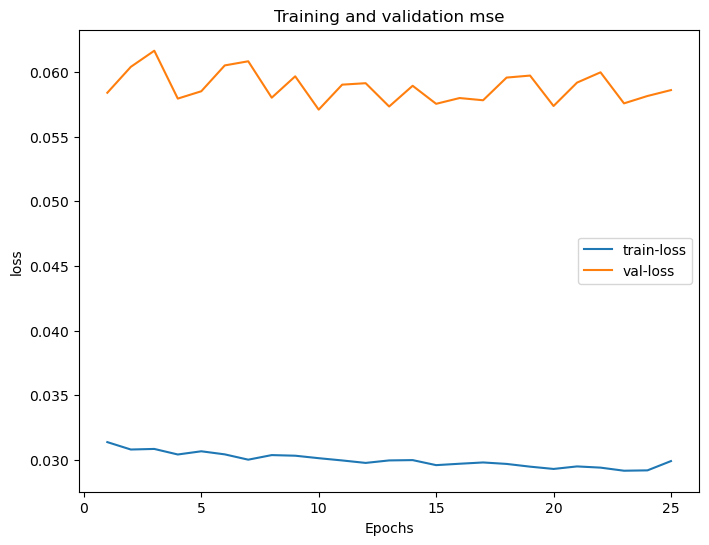

2023-01-26 01:00:55.293803: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:00:55.335587: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:00:55.343200: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


133/133 [==============================] - 2s 15ms/step
Epoch 1/1000


2023-01-26 01:00:58.592636: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:00:58.775802: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:00:58.796382: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:00:59.583526: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:00:59.597957: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


545/545 [==============================] - ETA: 0s - loss: 1.0180 - mean_squared_error: 141.5404 - mean_absolute_error: 9.2543 - accuracy: 0.0000e+00 - root_mean_squared_error: 11.8971 - logcosh: 8.5924 - kullback_leibler_divergence: 0.0021 - categorical_crossentropy: 4.4966e-06 - r_square: 0.6177 - csi: 0.9903 - freqbiassc: 1531.8846 - f1: 0.9995 - ham: 2.7758 - match1: 2.2479 - match2: 4.3629 - match3: 6.4394 - match5: 10.4125

2023-01-26 01:01:23.577183: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:01:23.671721: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:01:23.691202: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: saving model to /Users/sn/Downloads//Models/training_1/cp.ckpt


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 37s 65ms/step - loss: 1.0180 - mean_squared_error: 141.5404 - mean_absolute_error: 9.2543 - accuracy: 0.0000e+00 - root_mean_squared_error: 11.8971 - logcosh: 8.5924 - kullback_leibler_divergence: 0.0021 - categorical_crossentropy: 4.4966e-06 - r_square: 0.6177 - csi: 0.9903 - freqbiassc: 1531.8846 - f1: 0.9995 - ham: 2.7758 - match1: 2.2479 - match2: 4.3629 - match3: 6.4394 - match5: 10.4125 - val_loss: 1.0204 - val_mean_squared_error: 170.2899 - val_mean_absolute_error: 10.7232 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 13.0495 - val_logcosh: 10.0512 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.5373 - val_csi: 0.9947 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 3.0455 - val_match1: 1.5771 - val_match2: 3.1045 - val_match3: 4.6376 - val_match5: 7.6800
Epoch 2/1000
545/545 [==============================] - ETA: 0s - loss: 1.0211 - mean_squared_error: 232.

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 58ms/step - loss: 1.0211 - mean_squared_error: 232.3310 - mean_absolute_error: 12.1527 - accuracy: 0.0000e+00 - root_mean_squared_error: 15.2424 - logcosh: 11.4819 - kullback_leibler_divergence: 0.0138 - categorical_crossentropy: 4.4966e-06 - r_square: 0.3725 - csi: 0.9751 - freqbiassc: 1530.8749 - f1: 0.9993 - ham: 3.2033 - match1: 1.3930 - match2: 2.6753 - match3: 3.9587 - match5: 6.5270 - val_loss: 1.0222 - val_mean_squared_error: 267.5741 - val_mean_absolute_error: 13.3095 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 16.3577 - val_logcosh: 12.6361 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.2728 - val_csi: 0.9742 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 3.3704 - val_match1: 0.9717 - val_match2: 1.9300 - val_match3: 2.8720 - val_match5: 4.7493
Epoch 3/1000
545/545 [==============================] - ETA: 0s - loss: 1.0191 - mean_squared_error: 160

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: 1.0191 - mean_squared_error: 160.2162 - mean_absolute_error: 10.0574 - accuracy: 0.0000e+00 - root_mean_squared_error: 12.6577 - logcosh: 9.3912 - kullback_leibler_divergence: 0.0012 - categorical_crossentropy: 4.4966e-06 - r_square: 0.5673 - csi: 0.9788 - freqbiassc: 1531.7618 - f1: 0.9992 - ham: 2.9120 - match1: 1.7316 - match2: 3.3469 - match3: 4.9457 - match5: 8.1227 - val_loss: 1.0185 - val_mean_squared_error: 136.7669 - val_mean_absolute_error: 9.3184 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 11.6947 - val_logcosh: 8.6531 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.6284 - val_csi: 0.9915 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.8100 - val_match1: 2.0688 - val_match2: 4.0841 - val_match3: 6.1014 - val_match5: 9.9975
Epoch 4/1000
545/545 [==============================] - ETA: 0s - loss: 1.0208 - mean_squared_error: 204.70

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 1.0208 - mean_squared_error: 204.7023 - mean_absolute_error: 11.5672 - accuracy: 0.0000e+00 - root_mean_squared_error: 14.3074 - logcosh: 10.8958 - kullback_leibler_divergence: 1.9957e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.4471 - csi: 0.9849 - freqbiassc: 1531.7787 - f1: 0.9992 - ham: 3.1428 - match1: 1.6163 - match2: 3.1106 - match3: 4.6193 - match5: 7.5997 - val_loss: 1.0215 - val_mean_squared_error: 199.3120 - val_mean_absolute_error: 11.7907 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 14.1178 - val_logcosh: 11.1167 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.4584 - val_csi: 0.9851 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 3.2049 - val_match1: 1.3048 - val_match2: 2.5764 - val_match3: 3.8657 - val_match5: 6.4855
Epoch 5/1000
545/545 [==============================] - ETA: 0s - loss: 1.0204 - mean_squared_error:

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 58ms/step - loss: 1.0204 - mean_squared_error: 188.2048 - mean_absolute_error: 11.1175 - accuracy: 0.0000e+00 - root_mean_squared_error: 13.7188 - logcosh: 10.4469 - kullback_leibler_divergence: 0.0036 - categorical_crossentropy: 4.4966e-06 - r_square: 0.4917 - csi: 0.9833 - freqbiassc: 1531.4260 - f1: 0.9990 - ham: 3.0832 - match1: 1.6416 - match2: 3.1454 - match3: 4.6552 - match5: 7.6812 - val_loss: 1.0207 - val_mean_squared_error: 188.2787 - val_mean_absolute_error: 11.2782 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 13.7215 - val_logcosh: 10.6068 - val_kullback_leibler_divergence: 0.0011 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.4884 - val_csi: 0.9863 - val_freqbiassc: 1534.2151 - val_f1: 0.9997 - val_ham: 3.1159 - val_match1: 1.5340 - val_match2: 3.0360 - val_match3: 4.5246 - val_match5: 7.5073
Epoch 6/1000
545/545 [==============================] - ETA: 0s - loss: 1.0209 - mean_squared_error: 208.8676

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 1.0209 - mean_squared_error: 208.8676 - mean_absolute_error: 11.6976 - accuracy: 0.0000e+00 - root_mean_squared_error: 14.4523 - logcosh: 11.0260 - kullback_leibler_divergence: 0.0097 - categorical_crossentropy: 4.4966e-06 - r_square: 0.4358 - csi: 0.9762 - freqbiassc: 1530.8496 - f1: 0.9989 - ham: 3.1605 - match1: 1.3199 - match2: 2.5304 - match3: 3.7570 - match5: 6.1969 - val_loss: 1.0202 - val_mean_squared_error: 174.8339 - val_mean_absolute_error: 10.7485 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 13.2225 - val_logcosh: 10.0777 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.5247 - val_csi: 0.9804 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 3.0366 - val_match1: 1.3303 - val_match2: 2.6458 - val_match3: 3.9630 - val_match5: 6.6050
Epoch 7/1000
545/545 [==============================] - ETA: 0s - loss: 1.0196 - mean_squared_error: 159

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 1.0196 - mean_squared_error: 159.3835 - mean_absolute_error: 10.2348 - accuracy: 0.0000e+00 - root_mean_squared_error: 12.6247 - logcosh: 9.5658 - kullback_leibler_divergence: 8.7003e-04 - categorical_crossentropy: 4.4966e-06 - r_square: 0.5695 - csi: 0.9794 - freqbiassc: 1531.7085 - f1: 0.9991 - ham: 2.9591 - match1: 1.5818 - match2: 3.0485 - match3: 4.5073 - match5: 7.4911 - val_loss: 1.0199 - val_mean_squared_error: 165.3700 - val_mean_absolute_error: 10.5001 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 12.8596 - val_logcosh: 9.8306 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.5506 - val_csi: 0.9857 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 3.0022 - val_match1: 1.5951 - val_match2: 3.1822 - val_match3: 4.7385 - val_match5: 7.8134
Epoch 8/1000
545/545 [==============================] - ETA: 0s - loss: 1.0205 - mean_squared_error: 1

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 1.0205 - mean_squared_error: 189.6562 - mean_absolute_error: 11.1928 - accuracy: 0.0000e+00 - root_mean_squared_error: 13.7716 - logcosh: 10.5220 - kullback_leibler_divergence: 0.0020 - categorical_crossentropy: 4.4966e-06 - r_square: 0.4877 - csi: 0.9782 - freqbiassc: 1531.5398 - f1: 0.9990 - ham: 3.0952 - match1: 1.4204 - match2: 2.7307 - match3: 4.0360 - match5: 6.6473 - val_loss: 1.0220 - val_mean_squared_error: 229.7293 - val_mean_absolute_error: 12.5632 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 15.1568 - val_logcosh: 11.8885 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.3756 - val_csi: 0.9799 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 3.3003 - val_match1: 1.0034 - val_match2: 1.9969 - val_match3: 2.9902 - val_match5: 4.9716
Epoch 9/1000
545/545 [==============================] - ETA: 0s - loss: 1.0227 - mean_squared_error: 276

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 1.0227 - mean_squared_error: 276.0848 - mean_absolute_error: 13.7282 - accuracy: 0.0000e+00 - root_mean_squared_error: 16.6158 - logcosh: 13.0535 - kullback_leibler_divergence: 0.0042 - categorical_crossentropy: 4.4966e-06 - r_square: 0.2543 - csi: 0.9743 - freqbiassc: 1531.3195 - f1: 0.9990 - ham: 3.4397 - match1: 0.9944 - match2: 1.8805 - match3: 2.7550 - match5: 4.5229 - val_loss: 1.0236 - val_mean_squared_error: 340.9282 - val_mean_absolute_error: 15.2563 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 18.4642 - val_logcosh: 14.5812 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.0735 - val_csi: 0.9750 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 3.6153 - val_match1: 0.8166 - val_match2: 1.6152 - val_match3: 2.4165 - val_match5: 3.9917
Epoch 10/1000
545/545 [==============================] - ETA: 0s - loss: 1.0224 - mean_squared_error: 26

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 1.0224 - mean_squared_error: 263.3456 - mean_absolute_error: 13.3690 - accuracy: 0.0000e+00 - root_mean_squared_error: 16.2279 - logcosh: 12.6951 - kullback_leibler_divergence: 0.0081 - categorical_crossentropy: 4.4966e-06 - r_square: 0.2887 - csi: 0.9738 - freqbiassc: 1530.9871 - f1: 0.9989 - ham: 3.3903 - match1: 1.0253 - match2: 1.9392 - match3: 2.8635 - match5: 4.7066 - val_loss: 1.0220 - val_mean_squared_error: 234.5896 - val_mean_absolute_error: 12.6215 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 15.3163 - val_logcosh: 11.9469 - val_kullback_leibler_divergence: 1.8638e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.3624 - val_csi: 0.9798 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 3.3016 - val_match1: 0.9942 - val_match2: 1.9421 - val_match3: 2.8960 - val_match5: 4.8027
Epoch 11/1000
545/545 [==============================] - ETA: 0s - loss: 1.0217 - mean_squared_error: 229

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 1.0217 - mean_squared_error: 229.5722 - mean_absolute_error: 12.4509 - accuracy: 0.0000e+00 - root_mean_squared_error: 15.1516 - logcosh: 11.7777 - kullback_leibler_divergence: 0.0106 - categorical_crossentropy: 4.4966e-06 - r_square: 0.3799 - csi: 0.9750 - freqbiassc: 1530.7262 - f1: 0.9988 - ham: 3.2733 - match1: 1.1149 - match2: 2.1227 - match3: 3.1313 - match5: 5.1218 - val_loss: 1.0217 - val_mean_squared_error: 212.7209 - val_mean_absolute_error: 12.0853 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 14.5850 - val_logcosh: 11.4107 - val_kullback_leibler_divergence: 4.3590e-04 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.4219 - val_csi: 0.9806 - val_freqbiassc: 1534.2780 - val_f1: 0.9998 - val_ham: 3.2395 - val_match1: 1.0236 - val_match2: 2.0182 - val_match3: 3.0162 - val_match5: 5.0295
Epoch 12/1000
545/545 [==============================] - ETA: 0s - loss: 1.0222 - mean_squared_error: 244

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 1.0222 - mean_squared_error: 244.5657 - mean_absolute_error: 12.9263 - accuracy: 0.0000e+00 - root_mean_squared_error: 15.6386 - logcosh: 12.2517 - kullback_leibler_divergence: 0.0135 - categorical_crossentropy: 4.4966e-06 - r_square: 0.3394 - csi: 0.9732 - freqbiassc: 1530.4423 - f1: 0.9987 - ham: 3.3430 - match1: 1.0239 - match2: 1.9158 - match3: 2.8303 - match5: 4.6682 - val_loss: 1.0225 - val_mean_squared_error: 262.9312 - val_mean_absolute_error: 13.3765 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 16.2152 - val_logcosh: 12.7014 - val_kullback_leibler_divergence: 0.0026 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.2853 - val_csi: 0.9745 - val_freqbiassc: 1534.0785 - val_f1: 0.9997 - val_ham: 3.3966 - val_match1: 0.8427 - val_match2: 1.6617 - val_match3: 2.5010 - val_match5: 4.2048
Epoch 13/1000
545/545 [==============================] - ETA: 0s - loss: 1.0230 - mean_squared_error: 274.630

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 1.0230 - mean_squared_error: 274.6300 - mean_absolute_error: 13.7888 - accuracy: 0.0000e+00 - root_mean_squared_error: 16.5720 - logcosh: 13.1127 - kullback_leibler_divergence: 0.0278 - categorical_crossentropy: 4.4966e-06 - r_square: 0.2582 - csi: 0.9703 - freqbiassc: 1529.1531 - f1: 0.9984 - ham: 3.4601 - match1: 0.8907 - match2: 1.6832 - match3: 2.4761 - match5: 4.0696 - val_loss: 1.0220 - val_mean_squared_error: 245.9729 - val_mean_absolute_error: 12.8479 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 15.6835 - val_logcosh: 12.1738 - val_kullback_leibler_divergence: 0.0022 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.3314 - val_csi: 0.9756 - val_freqbiassc: 1534.1154 - val_f1: 0.9997 - val_ham: 3.3208 - val_match1: 0.9164 - val_match2: 1.8327 - val_match3: 2.7658 - val_match5: 4.6316
Epoch 14/1000
545/545 [==============================] - ETA: 0s - loss: 1.0218 - mean_squared_error: 234.034

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 1.0218 - mean_squared_error: 234.0340 - mean_absolute_error: 12.5459 - accuracy: 0.0000e+00 - root_mean_squared_error: 15.2982 - logcosh: 11.8722 - kullback_leibler_divergence: 0.0606 - categorical_crossentropy: 4.4966e-06 - r_square: 0.3678 - csi: 0.9696 - freqbiassc: 1526.0428 - f1: 0.9975 - ham: 3.2862 - match1: 1.0763 - match2: 2.0505 - match3: 3.0120 - match5: 4.9606 - val_loss: 1.0202 - val_mean_squared_error: 171.0255 - val_mean_absolute_error: 10.7012 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 13.0777 - val_logcosh: 10.0306 - val_kullback_leibler_divergence: 0.0150 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.5352 - val_csi: 0.9798 - val_freqbiassc: 1532.9087 - val_f1: 0.9994 - val_ham: 3.0337 - val_match1: 1.2561 - val_match2: 2.5093 - val_match3: 3.7622 - val_match5: 6.3014
Epoch 15/1000
545/545 [==============================] - ETA: 0s - loss: 1.0195 - mean_squared_error: 158.764

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 1.0195 - mean_squared_error: 158.7648 - mean_absolute_error: 10.1448 - accuracy: 0.0000e+00 - root_mean_squared_error: 12.6002 - logcosh: 9.4766 - kullback_leibler_divergence: 0.0292 - categorical_crossentropy: 4.4966e-06 - r_square: 0.5712 - csi: 0.9792 - freqbiassc: 1528.9781 - f1: 0.9983 - ham: 2.9411 - match1: 1.6641 - match2: 3.2235 - match3: 4.7804 - match5: 7.8984 - val_loss: 1.0197 - val_mean_squared_error: 156.4701 - val_mean_absolute_error: 10.2160 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 12.5088 - val_logcosh: 9.5464 - val_kullback_leibler_divergence: 0.0329 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.5747 - val_csi: 0.9814 - val_freqbiassc: 1531.2369 - val_f1: 0.9989 - val_ham: 2.9641 - val_match1: 1.4823 - val_match2: 2.9118 - val_match3: 4.3838 - val_match5: 7.3166
Epoch 16/1000
545/545 [==============================] - ETA: 0s - loss: 1.0196 - mean_squared_error: 161.7942 

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 1.0196 - mean_squared_error: 161.7942 - mean_absolute_error: 10.2232 - accuracy: 0.0000e+00 - root_mean_squared_error: 12.7198 - logcosh: 9.5545 - kullback_leibler_divergence: 0.0293 - categorical_crossentropy: 4.4966e-06 - r_square: 0.5630 - csi: 0.9771 - freqbiassc: 1528.9420 - f1: 0.9983 - ham: 2.9526 - match1: 1.5942 - match2: 3.0799 - match3: 4.5554 - match5: 7.5910 - val_loss: 1.0196 - val_mean_squared_error: 153.1886 - val_mean_absolute_error: 10.1118 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 12.3769 - val_logcosh: 9.4423 - val_kullback_leibler_divergence: 0.0255 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.5837 - val_csi: 0.9812 - val_freqbiassc: 1531.9529 - val_f1: 0.9991 - val_ham: 2.9494 - val_match1: 1.4405 - val_match2: 2.8878 - val_match3: 4.3197 - val_match5: 7.1919
Epoch 17/1000
545/545 [==============================] - ETA: 0s - loss: 1.0201 - mean_squared_error: 178.4271 

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 1.0201 - mean_squared_error: 178.4271 - mean_absolute_error: 10.7765 - accuracy: 0.0000e+00 - root_mean_squared_error: 13.3577 - logcosh: 10.1062 - kullback_leibler_divergence: 0.0414 - categorical_crossentropy: 4.4966e-06 - r_square: 0.5180 - csi: 0.9754 - freqbiassc: 1527.8822 - f1: 0.9981 - ham: 3.0351 - match1: 1.4494 - match2: 2.7818 - match3: 4.1215 - match5: 6.8792 - val_loss: 1.0209 - val_mean_squared_error: 202.5403 - val_mean_absolute_error: 11.5388 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 14.2317 - val_logcosh: 10.8671 - val_kullback_leibler_divergence: 0.0406 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.4493 - val_csi: 0.9757 - val_freqbiassc: 1530.5691 - val_f1: 0.9987 - val_ham: 3.1419 - val_match1: 1.1453 - val_match2: 2.2943 - val_match3: 3.4466 - val_match5: 5.7747
Epoch 18/1000
545/545 [==============================] - ETA: 0s - loss: 1.0286 - mean_squared_error: 631.761

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 1.0286 - mean_squared_error: 631.7615 - mean_absolute_error: 21.8846 - accuracy: 0.0000e+00 - root_mean_squared_error: 25.1349 - logcosh: 21.1987 - kullback_leibler_divergence: 0.0682 - categorical_crossentropy: 4.4966e-06 - r_square: -0.7065 - csi: 0.9651 - freqbiassc: 1525.5201 - f1: 0.9977 - ham: 4.4389 - match1: 0.3711 - match2: 0.6276 - match3: 0.8944 - match5: 1.4302 - val_loss: 1.0262 - val_mean_squared_error: 468.8849 - val_mean_absolute_error: 18.3635 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 21.6537 - val_logcosh: 17.6824 - val_kullback_leibler_divergence: 0.0421 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -0.2748 - val_csi: 0.9691 - val_freqbiassc: 1530.5172 - val_f1: 0.9988 - val_ham: 4.0159 - val_match1: 0.5024 - val_match2: 0.9728 - val_match3: 1.4440 - val_match5: 2.4201
TEST PERFORMANCE: shold3_loss at
133/133 [==============================] - 4s 28ms/step - loss: 1.0187 - m

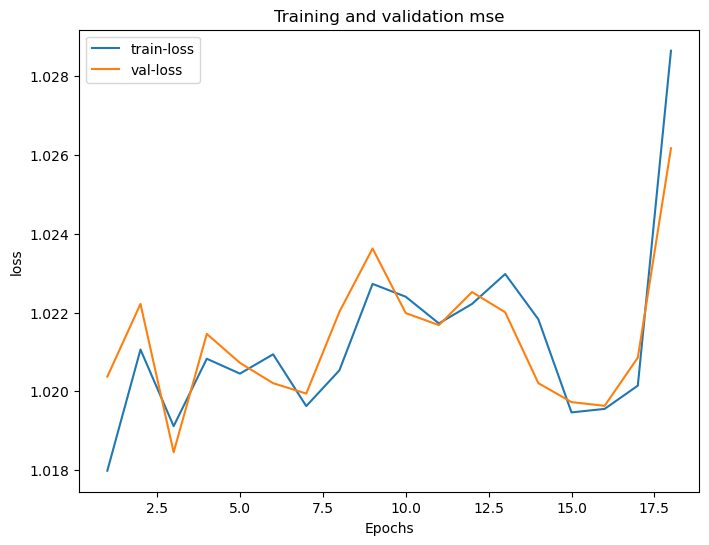

2023-01-26 01:10:25.872733: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:10:25.924988: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:10:25.933081: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


133/133 [==============================] - 3s 16ms/step
Epoch 1/1000


2023-01-26 01:10:29.250492: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:10:29.430372: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:10:29.454146: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:10:30.265890: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:10:30.281044: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


545/545 [==============================] - ETA: 0s - loss: 795417247744.0000 - mean_squared_error: 181.0561 - mean_absolute_error: 10.4640 - accuracy: 0.0000e+00 - root_mean_squared_error: 13.4557 - logcosh: 9.7979 - kullback_leibler_divergence: 0.0917 - categorical_crossentropy: 4.4966e-06 - r_square: 0.5109 - csi: 0.9711 - freqbiassc: 1523.9558 - f1: 0.9978 - ham: 2.9545 - match1: 1.7278 - match2: 3.3593 - match3: 4.9856 - match5: 8.1885

2023-01-26 01:10:54.520664: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:10:54.618167: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:10:54.640480: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: saving model to /Users/sn/Downloads//Models/training_1/cp.ckpt


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 38s 66ms/step - loss: 795417247744.0000 - mean_squared_error: 181.0561 - mean_absolute_error: 10.4640 - accuracy: 0.0000e+00 - root_mean_squared_error: 13.4557 - logcosh: 9.7979 - kullback_leibler_divergence: 0.0917 - categorical_crossentropy: 4.4966e-06 - r_square: 0.5109 - csi: 0.9711 - freqbiassc: 1523.9558 - f1: 0.9978 - ham: 2.9545 - match1: 1.7278 - match2: 3.3593 - match3: 4.9856 - match5: 8.1885 - val_loss: 0.1747 - val_mean_squared_error: 186.0710 - val_mean_absolute_error: 10.6945 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 13.6408 - val_logcosh: 10.0265 - val_kullback_leibler_divergence: 0.0453 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.4940 - val_csi: 0.9739 - val_freqbiassc: 1530.0411 - val_f1: 0.9985 - val_ham: 2.9972 - val_match1: 1.5426 - val_match2: 3.0520 - val_match3: 4.5594 - val_match5: 7.5851
Epoch 2/1000
545/545 [==============================] - ETA: 0s - loss: 108467339264.0000 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 58ms/step - loss: 108467339264.0000 - mean_squared_error: 221.6996 - mean_absolute_error: 11.7719 - accuracy: 0.0000e+00 - root_mean_squared_error: 14.8896 - logcosh: 11.1015 - kullback_leibler_divergence: 0.1609 - categorical_crossentropy: 4.4966e-06 - r_square: 0.4012 - csi: 0.9647 - freqbiassc: 1517.8651 - f1: 0.9963 - ham: 3.1500 - match1: 1.4470 - match2: 2.7864 - match3: 4.1238 - match5: 6.8267 - val_loss: 0.1192 - val_mean_squared_error: 187.1676 - val_mean_absolute_error: 10.8876 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 13.6809 - val_logcosh: 10.2180 - val_kullback_leibler_divergence: 0.0412 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.4911 - val_csi: 0.9733 - val_freqbiassc: 1530.5543 - val_f1: 0.9988 - val_ham: 3.0382 - val_match1: 1.4322 - val_match2: 2.8391 - val_match3: 4.2474 - val_match5: 7.0721
Epoch 3/1000
545/545 [==============================] - ETA: 0s - loss: 35895336960.0000 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: 35895336960.0000 - mean_squared_error: 249.2174 - mean_absolute_error: 12.7208 - accuracy: 0.0000e+00 - root_mean_squared_error: 15.7866 - logcosh: 12.0466 - kullback_leibler_divergence: 0.2178 - categorical_crossentropy: 4.4966e-06 - r_square: 0.3268 - csi: 0.9604 - freqbiassc: 1512.6802 - f1: 0.9949 - ham: 3.2976 - match1: 1.1854 - match2: 2.2745 - match3: 3.3578 - match5: 5.6185 - val_loss: 0.1196 - val_mean_squared_error: 219.5830 - val_mean_absolute_error: 11.9420 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 14.8183 - val_logcosh: 11.2696 - val_kullback_leibler_divergence: 0.0862 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.4029 - val_csi: 0.9698 - val_freqbiassc: 1526.5326 - val_f1: 0.9975 - val_ham: 3.1935 - val_match1: 1.2167 - val_match2: 2.4427 - val_match3: 3.6489 - val_match5: 6.0636
Epoch 4/1000
545/545 [==============================] - ETA: 0s - loss: 27366105088.0000 - mean_squ

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 58ms/step - loss: 27366105088.0000 - mean_squared_error: 296.0211 - mean_absolute_error: 14.3374 - accuracy: 0.0000e+00 - root_mean_squared_error: 17.2053 - logcosh: 13.6586 - kullback_leibler_divergence: 0.1821 - categorical_crossentropy: 4.4966e-06 - r_square: 0.2004 - csi: 0.9606 - freqbiassc: 1515.7852 - f1: 0.9958 - ham: 3.5409 - match1: 0.8563 - match2: 1.5964 - match3: 2.3635 - match5: 3.9285 - val_loss: 0.1239 - val_mean_squared_error: 251.3133 - val_mean_absolute_error: 13.0347 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 15.8529 - val_logcosh: 12.3595 - val_kullback_leibler_divergence: 0.0523 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.3167 - val_csi: 0.9704 - val_freqbiassc: 1529.4288 - val_f1: 0.9985 - val_ham: 3.3567 - val_match1: 0.9951 - val_match2: 1.9680 - val_match3: 2.9409 - val_match5: 4.9217
Epoch 5/1000
545/545 [==============================] - ETA: 0s - loss: 10649580544.0000 - mean_squ

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: 10649580544.0000 - mean_squared_error: 291.5418 - mean_absolute_error: 14.1621 - accuracy: 0.0000e+00 - root_mean_squared_error: 17.0746 - logcosh: 13.4840 - kullback_leibler_divergence: 0.1714 - categorical_crossentropy: 4.4966e-06 - r_square: 0.2125 - csi: 0.9615 - freqbiassc: 1516.6825 - f1: 0.9961 - ham: 3.5129 - match1: 0.8918 - match2: 1.6946 - match3: 2.5098 - match5: 4.1538 - val_loss: 0.1152 - val_mean_squared_error: 232.9151 - val_mean_absolute_error: 12.4911 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 15.2616 - val_logcosh: 11.8169 - val_kullback_leibler_divergence: 0.0357 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.3667 - val_csi: 0.9717 - val_freqbiassc: 1531.0341 - val_f1: 0.9990 - val_ham: 3.2811 - val_match1: 1.0687 - val_match2: 2.1368 - val_match3: 3.1719 - val_match5: 5.2858
Epoch 6/1000
545/545 [==============================] - ETA: 0s - loss: 7573731840.0000 - mean_squa

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 7573731840.0000 - mean_squared_error: 294.0172 - mean_absolute_error: 14.2416 - accuracy: 0.0000e+00 - root_mean_squared_error: 17.1469 - logcosh: 13.5634 - kullback_leibler_divergence: 0.1641 - categorical_crossentropy: 4.4966e-06 - r_square: 0.2058 - csi: 0.9619 - freqbiassc: 1517.3876 - f1: 0.9964 - ham: 3.5252 - match1: 0.8903 - match2: 1.6724 - match3: 2.4654 - match5: 4.0893 - val_loss: 0.1247 - val_mean_squared_error: 259.2657 - val_mean_absolute_error: 13.3491 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 16.1017 - val_logcosh: 12.6724 - val_kullback_leibler_divergence: 0.0366 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.2951 - val_csi: 0.9708 - val_freqbiassc: 1530.9344 - val_f1: 0.9990 - val_ham: 3.4074 - val_match1: 0.8964 - val_match2: 1.7833 - val_match3: 2.6785 - val_match5: 4.4979
Epoch 7/1000
545/545 [==============================] - ETA: 0s - loss: 6177237504.0000 - mean_squar

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 58ms/step - loss: 6177237504.0000 - mean_squared_error: 307.5547 - mean_absolute_error: 14.6548 - accuracy: 0.0000e+00 - root_mean_squared_error: 17.5372 - logcosh: 13.9755 - kullback_leibler_divergence: 0.1641 - categorical_crossentropy: 4.4966e-06 - r_square: 0.1693 - csi: 0.9617 - freqbiassc: 1517.3044 - f1: 0.9964 - ham: 3.5833 - match1: 0.8276 - match2: 1.5387 - match3: 2.2609 - match5: 3.7490 - val_loss: 0.1324 - val_mean_squared_error: 259.1570 - val_mean_absolute_error: 13.3084 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 16.0984 - val_logcosh: 12.6324 - val_kullback_leibler_divergence: 0.0601 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.2954 - val_csi: 0.9696 - val_freqbiassc: 1528.7983 - val_f1: 0.9983 - val_ham: 3.3977 - val_match1: 0.9458 - val_match2: 1.8763 - val_match3: 2.8183 - val_match5: 4.7315
Epoch 8/1000
545/545 [==============================] - ETA: 0s - loss: 30639360000.0000 - mean_squa

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 30639360000.0000 - mean_squared_error: 398.3183 - mean_absolute_error: 16.7818 - accuracy: 0.0000e+00 - root_mean_squared_error: 19.9579 - logcosh: 16.1003 - kullback_leibler_divergence: 0.2523 - categorical_crossentropy: 4.4966e-06 - r_square: -0.0759 - csi: 0.9561 - freqbiassc: 1509.0955 - f1: 0.9940 - ham: 3.8435 - match1: 0.7170 - match2: 1.3175 - match3: 1.9262 - match5: 3.1575 - val_loss: 0.2791 - val_mean_squared_error: 729.5458 - val_mean_absolute_error: 24.5806 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 27.0101 - val_logcosh: 23.8895 - val_kullback_leibler_divergence: 0.2564 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -0.9833 - val_csi: 0.9546 - val_freqbiassc: 1510.4484 - val_f1: 0.9917 - val_ham: 4.8027 - val_match1: 0.0879 - val_match2: 0.1647 - val_match3: 0.2390 - val_match5: 0.4124
Epoch 9/1000
545/545 [==============================] - ETA: 0s - loss: 23077238784.0000 - mean_s

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 23077238784.0000 - mean_squared_error: 861.2818 - mean_absolute_error: 27.1285 - accuracy: 0.0000e+00 - root_mean_squared_error: 29.3476 - logcosh: 26.4367 - kullback_leibler_divergence: 0.6270 - categorical_crossentropy: 4.4966e-06 - r_square: -1.3263 - csi: 0.9324 - freqbiassc: 1474.2014 - f1: 0.9849 - ham: 5.0754 - match1: 0.1334 - match2: 0.1549 - match3: 0.1801 - match5: 0.2319 - val_loss: 0.2883 - val_mean_squared_error: 755.5519 - val_mean_absolute_error: 25.0989 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 27.4873 - val_logcosh: 24.4080 - val_kullback_leibler_divergence: 0.2700 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -1.0539 - val_csi: 0.9541 - val_freqbiassc: 1509.3113 - val_f1: 0.9922 - val_ham: 4.8557 - val_match1: 0.0954 - val_match2: 0.1698 - val_match3: 0.2540 - val_match5: 0.4355
Epoch 10/1000
545/545 [==============================] - ETA: 0s - loss: 8410091520.0000 - mean_s

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 58ms/step - loss: 8410091520.0000 - mean_squared_error: 871.6413 - mean_absolute_error: 27.3134 - accuracy: 0.0000e+00 - root_mean_squared_error: 29.5236 - logcosh: 26.6216 - kullback_leibler_divergence: 0.5964 - categorical_crossentropy: 4.4966e-06 - r_square: -1.3543 - csi: 0.9343 - freqbiassc: 1477.0118 - f1: 0.9858 - ham: 5.0931 - match1: 0.1351 - match2: 0.1611 - match3: 0.1849 - match5: 0.2413 - val_loss: 0.3089 - val_mean_squared_error: 770.0894 - val_mean_absolute_error: 25.3903 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 27.7505 - val_logcosh: 24.6992 - val_kullback_leibler_divergence: 0.1702 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -1.0933 - val_csi: 0.9599 - val_freqbiassc: 1518.6672 - val_f1: 0.9959 - val_ham: 4.8877 - val_match1: 0.0868 - val_match2: 0.1550 - val_match3: 0.2286 - val_match5: 0.3910
Epoch 11/1000
545/545 [==============================] - ETA: 0s - loss: 7299535360.0000 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 7299535360.0000 - mean_squared_error: 907.7591 - mean_absolute_error: 27.9460 - accuracy: 0.0000e+00 - root_mean_squared_error: 30.1290 - logcosh: 27.2540 - kullback_leibler_divergence: 0.5746 - categorical_crossentropy: 4.4966e-06 - r_square: -1.4519 - csi: 0.9354 - freqbiassc: 1478.8848 - f1: 0.9859 - ham: 5.1566 - match1: 0.1293 - match2: 0.1488 - match3: 0.1705 - match5: 0.2160 - val_loss: 0.3066 - val_mean_squared_error: 838.8513 - val_mean_absolute_error: 26.5994 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 28.9629 - val_logcosh: 25.9080 - val_kullback_leibler_divergence: 0.2769 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -1.2803 - val_csi: 0.9536 - val_freqbiassc: 1508.6799 - val_f1: 0.9914 - val_ham: 5.0101 - val_match1: 0.0788 - val_match2: 0.1363 - val_match3: 0.1951 - val_match5: 0.3319
Epoch 12/1000
545/545 [==============================] - ETA: 0s - loss: 5247003136.0000 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 5247003136.0000 - mean_squared_error: 923.6348 - mean_absolute_error: 28.2179 - accuracy: 0.0000e+00 - root_mean_squared_error: 30.3914 - logcosh: 27.5260 - kullback_leibler_divergence: 0.5521 - categorical_crossentropy: 4.4966e-06 - r_square: -1.4947 - csi: 0.9368 - freqbiassc: 1480.9546 - f1: 0.9868 - ham: 5.1842 - match1: 0.1267 - match2: 0.1439 - match3: 0.1623 - match5: 0.2026 - val_loss: 0.3044 - val_mean_squared_error: 809.8762 - val_mean_absolute_error: 26.1391 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 28.4583 - val_logcosh: 25.4476 - val_kullback_leibler_divergence: 0.2225 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -1.2014 - val_csi: 0.9568 - val_freqbiassc: 1513.8142 - val_f1: 0.9940 - val_ham: 4.9675 - val_match1: 0.0721 - val_match2: 0.1272 - val_match3: 0.1825 - val_match5: 0.3131
Epoch 13/1000
545/545 [==============================] - ETA: 0s - loss: 4859727872.0000 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 4859727872.0000 - mean_squared_error: 940.1233 - mean_absolute_error: 28.5387 - accuracy: 0.0000e+00 - root_mean_squared_error: 30.6614 - logcosh: 27.8467 - kullback_leibler_divergence: 0.5361 - categorical_crossentropy: 4.4966e-06 - r_square: -1.5393 - csi: 0.9376 - freqbiassc: 1482.1958 - f1: 0.9864 - ham: 5.2181 - match1: 0.1258 - match2: 0.1396 - match3: 0.1551 - match5: 0.1899 - val_loss: 0.3028 - val_mean_squared_error: 862.3947 - val_mean_absolute_error: 27.0851 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 29.3666 - val_logcosh: 26.3932 - val_kullback_leibler_divergence: 0.0889 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -1.3441 - val_csi: 0.9645 - val_freqbiassc: 1526.2268 - val_f1: 0.9980 - val_ham: 5.0670 - val_match1: 0.0539 - val_match2: 0.0865 - val_match3: 0.1195 - val_match5: 0.1890
Epoch 14/1000
545/545 [==============================] - ETA: 0s - loss: 7207732224.0000 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 7207732224.0000 - mean_squared_error: 981.9418 - mean_absolute_error: 29.2365 - accuracy: 0.0000e+00 - root_mean_squared_error: 31.3360 - logcosh: 28.5444 - kullback_leibler_divergence: 0.6333 - categorical_crossentropy: 4.4966e-06 - r_square: -1.6522 - csi: 0.9318 - freqbiassc: 1473.1387 - f1: 0.9838 - ham: 5.2864 - match1: 0.1222 - match2: 0.1342 - match3: 0.1450 - match5: 0.1728 - val_loss: 0.3266 - val_mean_squared_error: 888.2900 - val_mean_absolute_error: 27.4987 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 29.8042 - val_logcosh: 26.8067 - val_kullback_leibler_divergence: 0.2968 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -1.4146 - val_csi: 0.9524 - val_freqbiassc: 1506.8269 - val_f1: 0.9914 - val_ham: 5.1056 - val_match1: 0.0572 - val_match2: 0.0957 - val_match3: 0.1288 - val_match5: 0.2071
Epoch 15/1000
545/545 [==============================] - ETA: 0s - loss: 4797388800.0000 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 4797388800.0000 - mean_squared_error: 1021.1158 - mean_absolute_error: 29.8717 - accuracy: 0.0000e+00 - root_mean_squared_error: 31.9549 - logcosh: 29.1796 - kullback_leibler_divergence: 0.5980 - categorical_crossentropy: 4.4966e-06 - r_square: -1.7580 - csi: 0.9339 - freqbiassc: 1476.2645 - f1: 0.9847 - ham: 5.3471 - match1: 0.1208 - match2: 0.1328 - match3: 0.1440 - match5: 0.1685 - val_loss: 0.3220 - val_mean_squared_error: 921.5487 - val_mean_absolute_error: 28.0596 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 30.3570 - val_logcosh: 27.3674 - val_kullback_leibler_divergence: 0.1345 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -1.5049 - val_csi: 0.9619 - val_freqbiassc: 1521.9285 - val_f1: 0.9968 - val_ham: 5.1617 - val_match1: 0.0467 - val_match2: 0.0752 - val_match3: 0.1021 - val_match5: 0.1641
Epoch 16/1000
545/545 [==============================] - ETA: 0s - loss: 3711023104.0000 - mean_s

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3711023104.0000 - mean_squared_error: 1049.1261 - mean_absolute_error: 30.3275 - accuracy: 0.0000e+00 - root_mean_squared_error: 32.3902 - logcosh: 29.6354 - kullback_leibler_divergence: 0.5845 - categorical_crossentropy: 4.4966e-06 - r_square: -1.8337 - csi: 0.9346 - freqbiassc: 1477.5269 - f1: 0.9852 - ham: 5.3907 - match1: 0.1198 - match2: 0.1291 - match3: 0.1397 - match5: 0.1620 - val_loss: 0.3461 - val_mean_squared_error: 984.4908 - val_mean_absolute_error: 29.1654 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 31.3766 - val_logcosh: 28.4729 - val_kullback_leibler_divergence: 0.1512 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -1.6759 - val_csi: 0.9609 - val_freqbiassc: 1520.4200 - val_f1: 0.9965 - val_ham: 5.2743 - val_match1: 0.0378 - val_match2: 0.0534 - val_match3: 0.0702 - val_match5: 0.1036
Epoch 17/1000
545/545 [==============================] - ETA: 0s - loss: 5004682240.0000 - mean_s

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 5004682240.0000 - mean_squared_error: 1083.2281 - mean_absolute_error: 30.8540 - accuracy: 0.0000e+00 - root_mean_squared_error: 32.9124 - logcosh: 30.1617 - kullback_leibler_divergence: 0.6533 - categorical_crossentropy: 4.4966e-06 - r_square: -1.9258 - csi: 0.9307 - freqbiassc: 1471.2271 - f1: 0.9834 - ham: 5.4397 - match1: 0.1186 - match2: 0.1261 - match3: 0.1350 - match5: 0.1534 - val_loss: 0.3421 - val_mean_squared_error: 972.7503 - val_mean_absolute_error: 28.9403 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 31.1889 - val_logcosh: 28.2478 - val_kullback_leibler_divergence: 0.1909 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -1.6441 - val_csi: 0.9587 - val_freqbiassc: 1516.8779 - val_f1: 0.9955 - val_ham: 5.2519 - val_match1: 0.0393 - val_match2: 0.0555 - val_match3: 0.0693 - val_match5: 0.1039
Epoch 18/1000
545/545 [==============================] - ETA: 0s - loss: 5042724352.0000 - mean_s

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 5042724352.0000 - mean_squared_error: 1126.8335 - mean_absolute_error: 31.5003 - accuracy: 0.0000e+00 - root_mean_squared_error: 33.5683 - logcosh: 30.8081 - kullback_leibler_divergence: 0.6394 - categorical_crossentropy: 4.4966e-06 - r_square: -2.0436 - csi: 0.9316 - freqbiassc: 1472.4855 - f1: 0.9839 - ham: 5.4986 - match1: 0.1179 - match2: 0.1256 - match3: 0.1331 - match5: 0.1499 - val_loss: 0.3635 - val_mean_squared_error: 1064.5509 - val_mean_absolute_error: 30.4041 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 32.6275 - val_logcosh: 29.7115 - val_kullback_leibler_divergence: 0.1757 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -1.8935 - val_csi: 0.9596 - val_freqbiassc: 1518.2933 - val_f1: 0.9964 - val_ham: 5.3914 - val_match1: 0.0345 - val_match2: 0.0468 - val_match3: 0.0587 - val_match5: 0.0816
Epoch 19/1000
545/545 [==============================] - ETA: 0s - loss: 5117348352.0000 - mean_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 5117348352.0000 - mean_squared_error: 1189.7849 - mean_absolute_error: 32.4319 - accuracy: 0.0000e+00 - root_mean_squared_error: 34.4933 - logcosh: 31.7396 - kullback_leibler_divergence: 0.5597 - categorical_crossentropy: 4.4966e-06 - r_square: -2.2136 - csi: 0.9362 - freqbiassc: 1480.0088 - f1: 0.9860 - ham: 5.5828 - match1: 0.1182 - match2: 0.1254 - match3: 0.1328 - match5: 0.1457 - val_loss: 0.3785 - val_mean_squared_error: 1113.9828 - val_mean_absolute_error: 31.0548 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 33.3764 - val_logcosh: 30.3623 - val_kullback_leibler_divergence: 0.1650 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -2.0280 - val_csi: 0.9602 - val_freqbiassc: 1519.1471 - val_f1: 0.9961 - val_ham: 5.4458 - val_match1: 0.0339 - val_match2: 0.0482 - val_match3: 0.0619 - val_match5: 0.0875
Epoch 20/1000
545/545 [==============================] - ETA: 0s - loss: 3792289792.0000 - mean_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 3792289792.0000 - mean_squared_error: 1236.6288 - mean_absolute_error: 33.0402 - accuracy: 0.0000e+00 - root_mean_squared_error: 35.1657 - logcosh: 32.3479 - kullback_leibler_divergence: 0.5274 - categorical_crossentropy: 4.4966e-06 - r_square: -2.3401 - csi: 0.9383 - freqbiassc: 1483.0876 - f1: 0.9874 - ham: 5.6342 - match1: 0.1146 - match2: 0.1194 - match3: 0.1244 - match5: 0.1352 - val_loss: 0.3904 - val_mean_squared_error: 1168.0476 - val_mean_absolute_error: 31.8883 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 34.1767 - val_logcosh: 31.1956 - val_kullback_leibler_divergence: 0.1275 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -2.1749 - val_csi: 0.9624 - val_freqbiassc: 1522.7328 - val_f1: 0.9975 - val_ham: 5.5246 - val_match1: 0.0271 - val_match2: 0.0354 - val_match3: 0.0432 - val_match5: 0.0595
TEST PERFORMANCE: shold4_loss at
133/133 [==============================] - 4s 28ms/step - loss:

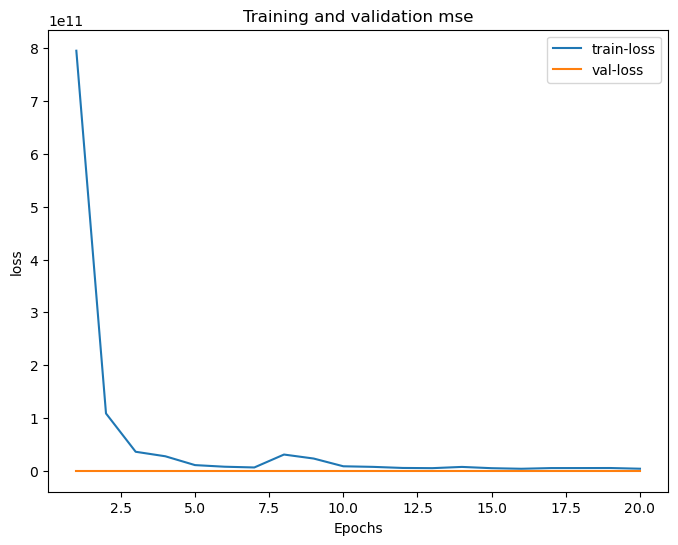

2023-01-26 01:21:01.911317: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:21:01.953890: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:21:01.961954: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


133/133 [==============================] - 2s 16ms/step
Epoch 1/1000


2023-01-26 01:21:05.205440: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:21:05.387981: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:21:05.413875: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:21:06.246796: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:21:06.261038: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


545/545 [==============================] - ETA: 0s - loss: 5.9562e-04 - mean_squared_error: 61.7705 - mean_absolute_error: 5.9562 - accuracy: 0.0000e+00 - root_mean_squared_error: 7.8594 - logcosh: 5.3129 - kullback_leibler_divergence: 0.0053 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8332 - csi: 0.9825 - freqbiassc: 1531.5836 - f1: 0.9994 - ham: 2.2132 - match1: 3.3368 - match2: 6.5371 - match3: 9.6562 - match5: 15.4617

2023-01-26 01:21:30.385093: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:21:30.492005: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:21:30.517603: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: saving model to /Users/sn/Downloads//Models/training_1/cp.ckpt


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 38s 66ms/step - loss: 5.9562e-04 - mean_squared_error: 61.7705 - mean_absolute_error: 5.9562 - accuracy: 0.0000e+00 - root_mean_squared_error: 7.8594 - logcosh: 5.3129 - kullback_leibler_divergence: 0.0053 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8332 - csi: 0.9825 - freqbiassc: 1531.5836 - f1: 0.9994 - ham: 2.2132 - match1: 3.3368 - match2: 6.5371 - match3: 9.6562 - match5: 15.4617 - val_loss: 5.8110e-04 - val_mean_squared_error: 59.9556 - val_mean_absolute_error: 5.8110 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.7431 - val_logcosh: 5.1686 - val_kullback_leibler_divergence: 3.2795e-04 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8370 - val_csi: 0.9889 - val_freqbiassc: 1534.2964 - val_f1: 0.9998 - val_ham: 2.1809 - val_match1: 3.5920 - val_match2: 7.1134 - val_match3: 10.4757 - val_match5: 16.6028
Epoch 2/1000
545/545 [==============================] - ETA: 0s - loss: 4.6600e-04 - mean_squared_erro

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 4.6600e-04 - mean_squared_error: 39.8670 - mean_absolute_error: 4.6600 - accuracy: 0.0000e+00 - root_mean_squared_error: 6.3140 - logcosh: 4.0330 - kullback_leibler_divergence: 0.0057 - categorical_crossentropy: 4.4966e-06 - r_square: 0.8923 - csi: 0.9833 - freqbiassc: 1531.6477 - f1: 0.9995 - ham: 1.9449 - match1: 4.5239 - match2: 8.7941 - match3: 12.8013 - match5: 19.8160 - val_loss: 6.0709e-04 - val_mean_squared_error: 64.6362 - val_mean_absolute_error: 6.0709 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0397 - val_logcosh: 5.4239 - val_kullback_leibler_divergence: 3.5871e-04 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8243 - val_csi: 0.9914 - val_freqbiassc: 1534.3075 - val_f1: 0.9998 - val_ham: 2.2376 - val_match1: 3.3269 - val_match2: 6.6172 - val_match3: 9.7899 - val_match5: 15.6746
Epoch 3/1000
545/545 [==============================] - ETA: 0s - loss: 4.3575e-04 - mean_squared_erro

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 58ms/step - loss: 4.3575e-04 - mean_squared_error: 35.4148 - mean_absolute_error: 4.3575 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.9510 - logcosh: 3.7358 - kullback_leibler_divergence: 0.0048 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9043 - csi: 0.9838 - freqbiassc: 1532.0204 - f1: 0.9999 - ham: 1.8772 - match1: 4.8720 - match2: 9.4539 - match3: 13.7052 - match5: 21.0782 - val_loss: 5.4938e-04 - val_mean_squared_error: 56.2654 - val_mean_absolute_error: 5.4938 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.5010 - val_logcosh: 4.8562 - val_kullback_leibler_divergence: 1.7192e-04 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8470 - val_csi: 0.9893 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1085 - val_match1: 3.9835 - val_match2: 7.8472 - val_match3: 11.5667 - val_match5: 18.1286
Epoch 4/1000
545/545 [==============================] - ETA: 0s - loss: 4.1749e-04 - mean_squared_err

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 4.1749e-04 - mean_squared_error: 33.1383 - mean_absolute_error: 4.1749 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.7566 - logcosh: 3.5571 - kullback_leibler_divergence: 0.0052 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9105 - csi: 0.9839 - freqbiassc: 1531.9213 - f1: 0.9998 - ham: 1.8339 - match1: 5.1408 - match2: 9.9613 - match3: 14.4062 - match5: 21.9357 - val_loss: 5.4993e-04 - val_mean_squared_error: 56.5305 - val_mean_absolute_error: 5.4993 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.5187 - val_logcosh: 4.8619 - val_kullback_leibler_divergence: 3.6398e-04 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8463 - val_csi: 0.9889 - val_freqbiassc: 1534.3037 - val_f1: 0.9998 - val_ham: 2.1087 - val_match1: 3.9956 - val_match2: 7.8770 - val_match3: 11.6111 - val_match5: 18.2045
Epoch 5/1000
545/545 [==============================] - ETA: 0s - loss: 4.0071e-04 - mean_squared_err

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 4.0071e-04 - mean_squared_error: 30.3410 - mean_absolute_error: 4.0071 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.5083 - logcosh: 3.3922 - kullback_leibler_divergence: 0.0043 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9180 - csi: 0.9842 - freqbiassc: 1532.1525 - f1: 1.0000 - ham: 1.7976 - match1: 5.3305 - match2: 10.2836 - match3: 14.8324 - match5: 22.5116 - val_loss: 5.4981e-04 - val_mean_squared_error: 57.3042 - val_mean_absolute_error: 5.4982 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.5700 - val_logcosh: 4.8604 - val_kullback_leibler_divergence: 1.7596e-04 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8442 - val_csi: 0.9897 - val_freqbiassc: 1534.3112 - val_f1: 0.9998 - val_ham: 2.1067 - val_match1: 3.9777 - val_match2: 7.8726 - val_match3: 11.5256 - val_match5: 18.1782
Epoch 6/1000
545/545 [==============================] - ETA: 0s - loss: 3.9424e-04 - mean_squared_er

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.9424e-04 - mean_squared_error: 29.3957 - mean_absolute_error: 3.9424 - accuracy: 1.1956e-06 - root_mean_squared_error: 5.4218 - logcosh: 3.3288 - kullback_leibler_divergence: 0.0043 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9206 - csi: 0.9843 - freqbiassc: 1532.2405 - f1: 1.0001 - ham: 1.7830 - match1: 5.4214 - match2: 10.4612 - match3: 15.0208 - match5: 22.7924 - val_loss: 5.9753e-04 - val_mean_squared_error: 65.1388 - val_mean_absolute_error: 5.9753 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0709 - val_logcosh: 5.3323 - val_kullback_leibler_divergence: -2.6012e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8229 - val_csi: 0.9917 - val_freqbiassc: 1534.3406 - val_f1: 0.9998 - val_ham: 2.2052 - val_match1: 3.6595 - val_match2: 7.2364 - val_match3: 10.6751 - val_match5: 16.8453
Epoch 7/1000
545/545 [==============================] - ETA: 0s - loss: 3.8476e-04 - mean_squared_e

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.8476e-04 - mean_squared_error: 28.0203 - mean_absolute_error: 3.8476 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.2934 - logcosh: 3.2358 - kullback_leibler_divergence: 0.0036 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9243 - csi: 0.9844 - freqbiassc: 1532.3582 - f1: 1.0002 - ham: 1.7611 - match1: 5.5318 - match2: 10.6809 - match3: 15.3378 - match5: 23.1264 - val_loss: 5.5899e-04 - val_mean_squared_error: 58.7795 - val_mean_absolute_error: 5.5899 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.6668 - val_logcosh: 4.9517 - val_kullback_leibler_divergence: 2.1938e-04 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8402 - val_csi: 0.9903 - val_freqbiassc: 1534.3185 - val_f1: 0.9998 - val_ham: 2.1239 - val_match1: 3.9648 - val_match2: 7.7602 - val_match3: 11.4556 - val_match5: 18.1243
Epoch 8/1000
545/545 [==============================] - ETA: 0s - loss: 3.8013e-04 - mean_squared_er

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 58ms/step - loss: 3.8013e-04 - mean_squared_error: 27.4324 - mean_absolute_error: 3.8013 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.2376 - logcosh: 3.1904 - kullback_leibler_divergence: 0.0035 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9259 - csi: 0.9845 - freqbiassc: 1532.4058 - f1: 1.0002 - ham: 1.7504 - match1: 5.5821 - match2: 10.7906 - match3: 15.4921 - match5: 23.3075 - val_loss: 5.5932e-04 - val_mean_squared_error: 59.0239 - val_mean_absolute_error: 5.5932 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.6827 - val_logcosh: 4.9552 - val_kullback_leibler_divergence: 1.6643e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8395 - val_csi: 0.9911 - val_freqbiassc: 1534.3331 - val_f1: 0.9998 - val_ham: 2.1246 - val_match1: 4.0045 - val_match2: 7.8775 - val_match3: 11.5568 - val_match5: 18.0521
Epoch 9/1000
545/545 [==============================] - ETA: 0s - loss: 3.7430e-04 - mean_squared_er

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.7430e-04 - mean_squared_error: 26.6325 - mean_absolute_error: 3.7430 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.1607 - logcosh: 3.1332 - kullback_leibler_divergence: 0.0033 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9281 - csi: 0.9845 - freqbiassc: 1532.4296 - f1: 1.0002 - ham: 1.7367 - match1: 5.6460 - match2: 10.9103 - match3: 15.6891 - match5: 23.5730 - val_loss: 5.5554e-04 - val_mean_squared_error: 58.0349 - val_mean_absolute_error: 5.5554 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.6181 - val_logcosh: 4.9166 - val_kullback_leibler_divergence: -2.8537e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8422 - val_csi: 0.9902 - val_freqbiassc: 1534.3331 - val_f1: 0.9998 - val_ham: 2.1202 - val_match1: 3.8977 - val_match2: 7.7032 - val_match3: 11.3779 - val_match5: 17.9512
Epoch 10/1000
545/545 [==============================] - ETA: 0s - loss: 3.6604e-04 - mean_squared_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.6604e-04 - mean_squared_error: 25.5017 - mean_absolute_error: 3.6604 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.0499 - logcosh: 3.0524 - kullback_leibler_divergence: 0.0043 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9311 - csi: 0.9846 - freqbiassc: 1532.5210 - f1: 1.0004 - ham: 1.7175 - match1: 5.7770 - match2: 11.1159 - match3: 15.9436 - match5: 23.9045 - val_loss: 5.3365e-04 - val_mean_squared_error: 54.5097 - val_mean_absolute_error: 5.3365 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.3831 - val_logcosh: 4.7024 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8518 - val_csi: 0.9894 - val_freqbiassc: 1534.3295 - val_f1: 0.9998 - val_ham: 2.0696 - val_match1: 4.2440 - val_match2: 8.3422 - val_match3: 12.2953 - val_match5: 19.0226
Epoch 11/1000
545/545 [==============================] - ETA: 0s - loss: 3.6543e-04 - mean_squared_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 3.6543e-04 - mean_squared_error: 25.5050 - mean_absolute_error: 3.6543 - accuracy: 0.0000e+00 - root_mean_squared_error: 5.0502 - logcosh: 3.0466 - kullback_leibler_divergence: 0.0045 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9311 - csi: 0.9847 - freqbiassc: 1532.5062 - f1: 1.0005 - ham: 1.7155 - match1: 5.7841 - match2: 11.1410 - match3: 15.9606 - match5: 23.9795 - val_loss: 5.8499e-04 - val_mean_squared_error: 62.7280 - val_mean_absolute_error: 5.8499 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 7.9201 - val_logcosh: 5.2080 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8294 - val_csi: 0.9919 - val_freqbiassc: 1534.3295 - val_f1: 0.9998 - val_ham: 2.1808 - val_match1: 3.7464 - val_match2: 7.3938 - val_match3: 10.8678 - val_match5: 17.1895
Epoch 12/1000
545/545 [==============================] - ETA: 0s - loss: 3.6072e-04 - mean_squared_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.6072e-04 - mean_squared_error: 24.7013 - mean_absolute_error: 3.6072 - accuracy: 2.3912e-06 - root_mean_squared_error: 4.9700 - logcosh: 3.0003 - kullback_leibler_divergence: 0.0041 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9333 - csi: 0.9848 - freqbiassc: 1532.6039 - f1: 1.0005 - ham: 1.7052 - match1: 5.8551 - match2: 11.2431 - match3: 16.1067 - match5: 24.1257 - val_loss: 5.6927e-04 - val_mean_squared_error: 60.0713 - val_mean_absolute_error: 5.6927 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.7506 - val_logcosh: 5.0518 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8367 - val_csi: 0.9905 - val_freqbiassc: 1534.3331 - val_f1: 0.9998 - val_ham: 2.1499 - val_match1: 3.7452 - val_match2: 7.4683 - val_match3: 11.0141 - val_match5: 17.5171
Epoch 13/1000
545/545 [==============================] - ETA: 0s - loss: 3.5807e-04 - mean_squared_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 3.5807e-04 - mean_squared_error: 24.3252 - mean_absolute_error: 3.5807 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.9321 - logcosh: 2.9742 - kullback_leibler_divergence: 0.0046 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9343 - csi: 0.9847 - freqbiassc: 1532.5048 - f1: 1.0005 - ham: 1.6992 - match1: 5.8788 - match2: 11.3034 - match3: 16.1771 - match5: 24.1925 - val_loss: 5.7626e-04 - val_mean_squared_error: 62.3001 - val_mean_absolute_error: 5.7626 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.8930 - val_logcosh: 5.1222 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8306 - val_csi: 0.9910 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1583 - val_match1: 3.8712 - val_match2: 7.6452 - val_match3: 11.2498 - val_match5: 17.6957
Epoch 14/1000
545/545 [==============================] - ETA: 0s - loss: 3.5402e-04 - mean_squared_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.5402e-04 - mean_squared_error: 23.8074 - mean_absolute_error: 3.5402 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.8793 - logcosh: 2.9347 - kullback_leibler_divergence: 0.0043 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9357 - csi: 0.9849 - freqbiassc: 1532.6588 - f1: 1.0006 - ham: 1.6898 - match1: 5.9338 - match2: 11.3943 - match3: 16.3393 - match5: 24.4136 - val_loss: 5.5175e-04 - val_mean_squared_error: 57.6730 - val_mean_absolute_error: 5.5175 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.5943 - val_logcosh: 4.8796 - val_kullback_leibler_divergence: 9.9382e-06 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8432 - val_csi: 0.9903 - val_freqbiassc: 1534.3295 - val_f1: 0.9998 - val_ham: 2.1098 - val_match1: 4.0138 - val_match2: 7.9657 - val_match3: 11.7572 - val_match5: 18.3882
Epoch 15/1000
545/545 [==============================] - ETA: 0s - loss: 3.5149e-04 - mean_squared_e

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 30s 56ms/step - loss: 3.5149e-04 - mean_squared_error: 23.5351 - mean_absolute_error: 3.5149 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.8513 - logcosh: 2.9101 - kullback_leibler_divergence: 0.0045 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9364 - csi: 0.9848 - freqbiassc: 1532.6277 - f1: 1.0006 - ham: 1.6831 - match1: 5.9624 - match2: 11.4565 - match3: 16.4173 - match5: 24.5385 - val_loss: 5.6642e-04 - val_mean_squared_error: 60.3864 - val_mean_absolute_error: 5.6642 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.7709 - val_logcosh: 5.0242 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8358 - val_csi: 0.9901 - val_freqbiassc: 1534.3331 - val_f1: 0.9998 - val_ham: 2.1408 - val_match1: 3.8290 - val_match2: 7.5570 - val_match3: 11.1669 - val_match5: 17.7221
Epoch 16/1000
545/545 [==============================] - ETA: 0s - loss: 3.4858e-04 - mean_squared_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.4858e-04 - mean_squared_error: 23.1629 - mean_absolute_error: 3.4858 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.8128 - logcosh: 2.8820 - kullback_leibler_divergence: 0.0044 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9374 - csi: 0.9849 - freqbiassc: 1532.6570 - f1: 1.0006 - ham: 1.6755 - match1: 6.0211 - match2: 11.5666 - match3: 16.5701 - match5: 24.7072 - val_loss: 5.7715e-04 - val_mean_squared_error: 62.1374 - val_mean_absolute_error: 5.7715 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.8827 - val_logcosh: 5.1306 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8311 - val_csi: 0.9914 - val_freqbiassc: 1534.3331 - val_f1: 0.9998 - val_ham: 2.1626 - val_match1: 3.8449 - val_match2: 7.4827 - val_match3: 11.0584 - val_match5: 17.4185
Epoch 17/1000
545/545 [==============================] - ETA: 0s - loss: 3.4655e-04 - mean_squared_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 3.4655e-04 - mean_squared_error: 22.8716 - mean_absolute_error: 3.4655 - accuracy: 1.1956e-06 - root_mean_squared_error: 4.7824 - logcosh: 2.8618 - kullback_leibler_divergence: 0.0038 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9382 - csi: 0.9849 - freqbiassc: 1532.6957 - f1: 1.0006 - ham: 1.6714 - match1: 6.0166 - match2: 11.5907 - match3: 16.5993 - match5: 24.7204 - val_loss: 6.1385e-04 - val_mean_squared_error: 68.4183 - val_mean_absolute_error: 6.1385 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2715 - val_logcosh: 5.4929 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8140 - val_csi: 0.9927 - val_freqbiassc: 1534.3331 - val_f1: 0.9998 - val_ham: 2.2387 - val_match1: 3.4900 - val_match2: 6.8561 - val_match3: 10.0928 - val_match5: 16.1366
Epoch 18/1000
545/545 [==============================] - ETA: 0s - loss: 3.4507e-04 - mean_squared_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.4507e-04 - mean_squared_error: 22.7515 - mean_absolute_error: 3.4507 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.7698 - logcosh: 2.8476 - kullback_leibler_divergence: 0.0041 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9385 - csi: 0.9849 - freqbiassc: 1532.5377 - f1: 1.0005 - ham: 1.6671 - match1: 6.0633 - match2: 11.6450 - match3: 16.6813 - match5: 24.8548 - val_loss: 5.6537e-04 - val_mean_squared_error: 60.4279 - val_mean_absolute_error: 5.6537 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.7735 - val_logcosh: 5.0149 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8357 - val_csi: 0.9909 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1356 - val_match1: 3.9505 - val_match2: 7.7770 - val_match3: 11.4374 - val_match5: 17.9589
Epoch 19/1000
545/545 [==============================] - ETA: 0s - loss: 3.4429e-04 - mean_squared_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 58ms/step - loss: 3.4429e-04 - mean_squared_error: 22.5688 - mean_absolute_error: 3.4429 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.7507 - logcosh: 2.8396 - kullback_leibler_divergence: 0.0039 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9390 - csi: 0.9849 - freqbiassc: 1532.6421 - f1: 1.0005 - ham: 1.6661 - match1: 6.0488 - match2: 11.6207 - match3: 16.6367 - match5: 24.8624 - val_loss: 5.8358e-04 - val_mean_squared_error: 63.0634 - val_mean_absolute_error: 5.8358 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9412 - val_logcosh: 5.1925 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8285 - val_csi: 0.9914 - val_freqbiassc: 1534.3296 - val_f1: 0.9998 - val_ham: 2.1798 - val_match1: 3.6226 - val_match2: 7.1858 - val_match3: 10.5933 - val_match5: 16.9346
Epoch 20/1000
545/545 [==============================] - ETA: 0s - loss: 3.4975e-04 - mean_squared_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 56ms/step - loss: 3.4975e-04 - mean_squared_error: 23.6697 - mean_absolute_error: 3.4975 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.8652 - logcosh: 2.8938 - kullback_leibler_divergence: 0.0064 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9361 - csi: 0.9847 - freqbiassc: 1532.4440 - f1: 1.0005 - ham: 1.6763 - match1: 6.0375 - match2: 11.6311 - match3: 16.6301 - match5: 24.7755 - val_loss: 6.2875e-04 - val_mean_squared_error: 78.0035 - val_mean_absolute_error: 6.2875 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 8.8320 - val_logcosh: 5.6441 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.7879 - val_csi: 0.9922 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2426 - val_match1: 3.6724 - val_match2: 7.2225 - val_match3: 10.6017 - val_match5: 16.8310
Epoch 21/1000
545/545 [==============================] - ETA: 0s - loss: 3.4795e-04 - mean_squared_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.4795e-04 - mean_squared_error: 23.1390 - mean_absolute_error: 3.4795 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.8103 - logcosh: 2.8759 - kullback_leibler_divergence: 0.0038 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9375 - csi: 0.9847 - freqbiassc: 1532.4460 - f1: 1.0003 - ham: 1.6741 - match1: 6.0820 - match2: 11.6551 - match3: 16.6524 - match5: 24.7877 - val_loss: 5.7762e-04 - val_mean_squared_error: 63.9999 - val_mean_absolute_error: 5.7762 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.0000 - val_logcosh: 5.1365 - val_kullback_leibler_divergence: 7.5818e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8260 - val_csi: 0.9910 - val_freqbiassc: 1534.3148 - val_f1: 0.9998 - val_ham: 2.1552 - val_match1: 3.9042 - val_match2: 7.6937 - val_match3: 11.3417 - val_match5: 17.8224
Epoch 22/1000
545/545 [==============================] - ETA: 0s - loss: 3.3850e-04 - mean_squared_e

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.3850e-04 - mean_squared_error: 21.9258 - mean_absolute_error: 3.3851 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.6825 - logcosh: 2.7840 - kullback_leibler_divergence: 0.0034 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9408 - csi: 0.9848 - freqbiassc: 1532.5745 - f1: 1.0004 - ham: 1.6506 - match1: 6.1852 - match2: 11.8775 - match3: 16.9524 - match5: 25.1745 - val_loss: 6.0725e-04 - val_mean_squared_error: 67.6514 - val_mean_absolute_error: 6.0725 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 8.2250 - val_logcosh: 5.4274 - val_kullback_leibler_divergence: 4.2744e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8161 - val_csi: 0.9925 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.2253 - val_match1: 3.5400 - val_match2: 6.9333 - val_match3: 10.1847 - val_match5: 16.2973
Epoch 23/1000
545/545 [==============================] - ETA: 0s - loss: 3.3696e-04 - mean_squared_e

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.3696e-04 - mean_squared_error: 21.7686 - mean_absolute_error: 3.3696 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.6657 - logcosh: 2.7688 - kullback_leibler_divergence: 0.0037 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9412 - csi: 0.9850 - freqbiassc: 1532.6737 - f1: 1.0006 - ham: 1.6466 - match1: 6.1979 - match2: 11.9250 - match3: 17.0365 - match5: 25.3205 - val_loss: 5.6634e-04 - val_mean_squared_error: 60.8198 - val_mean_absolute_error: 5.6634 - val_accuracy: 2.4043e-06 - val_root_mean_squared_error: 7.7987 - val_logcosh: 5.0238 - val_kullback_leibler_divergence: 9.9382e-06 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8346 - val_csi: 0.9907 - val_freqbiassc: 1534.3223 - val_f1: 0.9998 - val_ham: 2.1385 - val_match1: 3.8827 - val_match2: 7.6947 - val_match3: 11.3434 - val_match5: 17.8170
Epoch 24/1000
545/545 [==============================] - ETA: 0s - loss: 3.3332e-04 - mean_squared_e

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.3332e-04 - mean_squared_error: 21.3200 - mean_absolute_error: 3.3332 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.6174 - logcosh: 2.7334 - kullback_leibler_divergence: 0.0033 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9424 - csi: 0.9850 - freqbiassc: 1532.6974 - f1: 1.0005 - ham: 1.6375 - match1: 6.2495 - match2: 12.0442 - match3: 17.2004 - match5: 25.5003 - val_loss: 5.7334e-04 - val_mean_squared_error: 63.4329 - val_mean_absolute_error: 5.7334 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9645 - val_logcosh: 5.0944 - val_kullback_leibler_divergence: 9.9382e-06 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8275 - val_csi: 0.9903 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1457 - val_match1: 3.9024 - val_match2: 7.7108 - val_match3: 11.3579 - val_match5: 17.8493
Epoch 25/1000
545/545 [==============================] - ETA: 0s - loss: 3.3485e-04 - mean_squared_e

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 57ms/step - loss: 3.3485e-04 - mean_squared_error: 21.4702 - mean_absolute_error: 3.3485 - accuracy: 0.0000e+00 - root_mean_squared_error: 4.6336 - logcosh: 2.7485 - kullback_leibler_divergence: 0.0036 - categorical_crossentropy: 4.4966e-06 - r_square: 0.9420 - csi: 0.9850 - freqbiassc: 1532.6661 - f1: 1.0005 - ham: 1.6416 - match1: 6.2609 - match2: 11.9806 - match3: 17.0922 - match5: 25.3955 - val_loss: 5.8234e-04 - val_mean_squared_error: 63.6619 - val_mean_absolute_error: 5.8234 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 7.9788 - val_logcosh: 5.1813 - val_kullback_leibler_divergence: -2.8815e-05 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: 0.8269 - val_csi: 0.9916 - val_freqbiassc: 1534.3259 - val_f1: 0.9998 - val_ham: 2.1723 - val_match1: 3.7049 - val_match2: 7.3494 - val_match3: 10.8438 - val_match5: 17.1842
TEST PERFORMANCE: shold5_loss at
133/133 [==============================] - 4s 28ms/step - loss: 6.

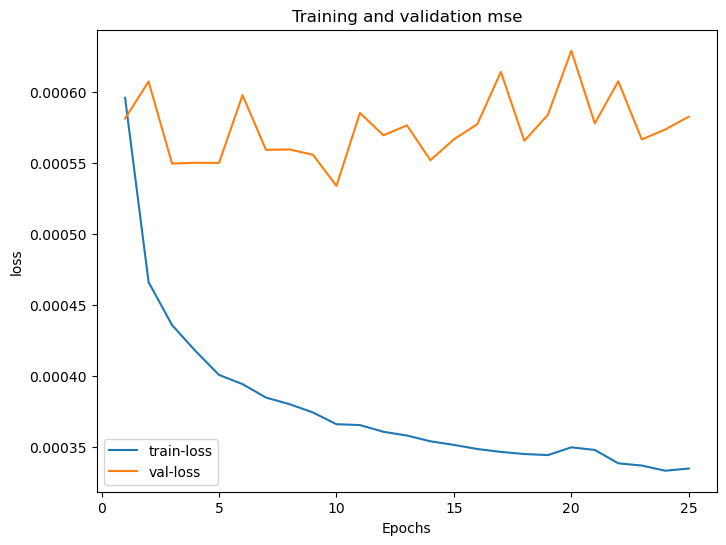

2023-01-26 01:34:10.519051: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:34:10.562121: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:34:10.569838: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


133/133 [==============================] - 3s 16ms/step
Epoch 1/1000


2023-01-26 01:34:13.975803: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:34:14.175322: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:34:14.199934: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:34:15.572875: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:34:15.587397: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


545/545 [==============================] - ETA: 0s - loss: -71.8417 - mean_squared_error: 1697.7925 - mean_absolute_error: 37.2517 - accuracy: 0.0000e+00 - root_mean_squared_error: 41.2043 - logcosh: 36.5615 - kullback_leibler_divergence: 0.9793 - categorical_crossentropy: 4.4966e-06 - r_square: -3.5856 - csi: 0.9355 - freqbiassc: 1440.7594 - f1: 0.9696 - ham: 5.8818 - match1: 0.2627 - match2: 0.4222 - match3: 0.5767 - match5: 0.8945

2023-01-26 01:34:41.794212: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:34:41.897353: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 01:34:41.925010: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: saving model to /Users/sn/Downloads//Models/training_1/cp.ckpt


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 42s 71ms/step - loss: -71.8417 - mean_squared_error: 1697.7925 - mean_absolute_error: 37.2517 - accuracy: 0.0000e+00 - root_mean_squared_error: 41.2043 - logcosh: 36.5615 - kullback_leibler_divergence: 0.9793 - categorical_crossentropy: 4.4966e-06 - r_square: -3.5856 - csi: 0.9355 - freqbiassc: 1440.7594 - f1: 0.9696 - ham: 5.8818 - match1: 0.2627 - match2: 0.4222 - match3: 0.5767 - match5: 0.8945 - val_loss: -70.7552 - val_mean_squared_error: 2924.6018 - val_mean_absolute_error: 50.8473 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 54.0796 - val_logcosh: 50.1561 - val_kullback_leibler_divergence: 0.9649 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -6.9466 - val_csi: 0.9386 - val_freqbiassc: 1444.0264 - val_f1: 0.9476 - val_ham: 6.9586 - val_match1: 0.0989 - val_match2: 0.1778 - val_match3: 0.2494 - val_match5: 0.4001
Epoch 2/1000
545/545 [==============================] - ETA: 0s - loss: -81.2369 - mean_squared_error

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 33s 61ms/step - loss: -81.2369 - mean_squared_error: 5294.3765 - mean_absolute_error: 67.9081 - accuracy: 0.0000e+00 - root_mean_squared_error: 72.7625 - logcosh: 67.2162 - kullback_leibler_divergence: 3.0294 - categorical_crossentropy: 4.4966e-06 - r_square: -13.2997 - csi: 0.8062 - freqbiassc: 1246.4340 - f1: 0.8964 - ham: 8.0383 - match1: 0.1597 - match2: 0.2087 - match3: 0.2586 - match5: 0.3592 - val_loss: -84.4383 - val_mean_squared_error: 7279.4438 - val_mean_absolute_error: 81.6046 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 85.3197 - val_logcosh: 80.9121 - val_kullback_leibler_divergence: 1.7296 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -18.7802 - val_csi: 0.8912 - val_freqbiassc: 1371.9507 - val_f1: 0.9079 - val_ham: 8.8809 - val_match1: 0.0465 - val_match2: 0.0718 - val_match3: 0.0929 - val_match5: 0.1379
Epoch 3/1000
545/545 [==============================] - ETA: 0s - loss: -91.5698 - mean_squared_err

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -91.5698 - mean_squared_error: 13880.9326 - mean_absolute_error: 111.1462 - accuracy: 0.0000e+00 - root_mean_squared_error: 117.8174 - logcosh: 110.4537 - kullback_leibler_divergence: 5.6664 - categorical_crossentropy: 4.4966e-06 - r_square: -36.4911 - csi: 0.6410 - freqbiassc: 995.5748 - f1: 0.7850 - ham: 10.3262 - match1: 0.1399 - match2: 0.1693 - match3: 0.2030 - match5: 0.2648 - val_loss: 2316.4541 - val_mean_squared_error: 18186.6816 - val_mean_absolute_error: 128.6845 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 134.8580 - val_logcosh: 127.9919 - val_kullback_leibler_divergence: 5.7842 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -48.4174 - val_csi: 0.6401 - val_freqbiassc: 994.7439 - val_f1: 0.6511 - val_ham: 11.1514 - val_match1: 0.0495 - val_match2: 0.0752 - val_match3: 0.1032 - val_match5: 0.1561
Epoch 4/1000
545/545 [==============================] - ETA: 0s - loss: -89.3341 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 33s 60ms/step - loss: -89.3341 - mean_squared_error: 12676.1729 - mean_absolute_error: 102.4975 - accuracy: 0.0000e+00 - root_mean_squared_error: 112.5885 - logcosh: 101.8052 - kullback_leibler_divergence: 4.9622 - categorical_crossentropy: 4.4966e-06 - r_square: -33.2371 - csi: 0.6852 - freqbiassc: 1062.5966 - f1: 0.8139 - ham: 9.8029 - match1: 0.1500 - match2: 0.1887 - match3: 0.2295 - match5: 0.3101 - val_loss: -70.5398 - val_mean_squared_error: 10257.8848 - val_mean_absolute_error: 94.2768 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 101.2812 - val_logcosh: 93.5841 - val_kullback_leibler_divergence: 3.7242 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -26.8718 - val_csi: 0.7674 - val_freqbiassc: 1185.1566 - val_f1: 0.7887 - val_ham: 9.4785 - val_match1: 0.0440 - val_match2: 0.0662 - val_match3: 0.0913 - val_match5: 0.1387
Epoch 5/1000
545/545 [==============================] - ETA: 0s - loss: -91.3945 - mean_squar

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -91.3945 - mean_squared_error: 12456.7344 - mean_absolute_error: 103.5233 - accuracy: 0.0000e+00 - root_mean_squared_error: 111.6097 - logcosh: 102.8305 - kullback_leibler_divergence: 4.9300 - categorical_crossentropy: 4.4966e-06 - r_square: -32.6445 - csi: 0.6873 - freqbiassc: 1065.5702 - f1: 0.8191 - ham: 9.9328 - match1: 0.1298 - match2: 0.1502 - match3: 0.1713 - match5: 0.2139 - val_loss: -76.5640 - val_mean_squared_error: 13219.7217 - val_mean_absolute_error: 108.0189 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 114.9771 - val_logcosh: 107.3261 - val_kullback_leibler_divergence: 4.7950 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -34.9169 - val_csi: 0.7012 - val_freqbiassc: 1085.4192 - val_f1: 0.7228 - val_ham: 10.1819 - val_match1: 0.0401 - val_match2: 0.0583 - val_match3: 0.0776 - val_match5: 0.1146
Epoch 6/1000
545/545 [==============================] - ETA: 0s - loss: -94.4953 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 60ms/step - loss: -94.4953 - mean_squared_error: 15914.5283 - mean_absolute_error: 118.2990 - accuracy: 0.0000e+00 - root_mean_squared_error: 126.1528 - logcosh: 117.6062 - kullback_leibler_divergence: 5.8078 - categorical_crossentropy: 4.4966e-06 - r_square: -41.9838 - csi: 0.6324 - freqbiassc: 982.1165 - f1: 0.7793 - ham: 10.6586 - match1: 0.1223 - match2: 0.1356 - match3: 0.1483 - match5: 0.1735 - val_loss: -62.7924 - val_mean_squared_error: 17142.2812 - val_mean_absolute_error: 123.8393 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 130.9285 - val_logcosh: 123.1464 - val_kullback_leibler_divergence: 5.2837 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -45.5705 - val_csi: 0.6713 - val_freqbiassc: 1040.2843 - val_f1: 0.6881 - val_ham: 10.9380 - val_match1: 0.0297 - val_match2: 0.0361 - val_match3: 0.0430 - val_match5: 0.0588
Epoch 7/1000
545/545 [==============================] - ETA: 0s - loss: -98.2659 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -98.2659 - mean_squared_error: 20336.3477 - mean_absolute_error: 134.1009 - accuracy: 0.0000e+00 - root_mean_squared_error: 142.6056 - logcosh: 133.4079 - kullback_leibler_divergence: 6.4252 - categorical_crossentropy: 4.4966e-06 - r_square: -53.9268 - csi: 0.5939 - freqbiassc: 923.4213 - f1: 0.7490 - ham: 11.3520 - match1: 0.1217 - match2: 0.1340 - match3: 0.1460 - match5: 0.1697 - val_loss: -92.9899 - val_mean_squared_error: 19726.0684 - val_mean_absolute_error: 130.4968 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 140.4495 - val_logcosh: 129.8040 - val_kullback_leibler_divergence: 5.9188 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -52.5861 - val_csi: 0.6321 - val_freqbiassc: 982.3609 - val_f1: 0.6417 - val_ham: 11.1450 - val_match1: 0.0424 - val_match2: 0.0590 - val_match3: 0.0766 - val_match5: 0.1093
Epoch 8/1000
545/545 [==============================] - ETA: 0s - loss: -84.6664 - mean_squ

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -84.6664 - mean_squared_error: 9622.0459 - mean_absolute_error: 91.9959 - accuracy: 0.0000e+00 - root_mean_squared_error: 98.0920 - logcosh: 91.3029 - kullback_leibler_divergence: 1.3270 - categorical_crossentropy: 4.4966e-06 - r_square: -24.9890 - csi: 0.9154 - freqbiassc: 1408.3260 - f1: 0.9568 - ham: 9.4366 - match1: 0.1145 - match2: 0.1192 - match3: 0.1236 - match5: 0.1330 - val_loss: -78.2626 - val_mean_squared_error: 10017.3779 - val_mean_absolute_error: 94.8503 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 100.0869 - val_logcosh: 94.1572 - val_kullback_leibler_divergence: 0.7246 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -26.2100 - val_csi: 0.9549 - val_freqbiassc: 1467.0339 - val_f1: 0.9564 - val_ham: 9.6057 - val_match1: 0.0247 - val_match2: 0.0264 - val_match3: 0.0294 - val_match5: 0.0347
Epoch 9/1000
545/545 [==============================] - ETA: 0s - loss: -84.9726 - mean_squared_e

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -84.9726 - mean_squared_error: 10258.9326 - mean_absolute_error: 95.0882 - accuracy: 0.0000e+00 - root_mean_squared_error: 101.2864 - logcosh: 94.3953 - kullback_leibler_divergence: 1.1355 - categorical_crossentropy: 4.4966e-06 - r_square: -26.7094 - csi: 0.9275 - freqbiassc: 1426.5118 - f1: 0.9652 - ham: 9.5872 - match1: 0.1159 - match2: 0.1224 - match3: 0.1279 - match5: 0.1404 - val_loss: -78.3260 - val_mean_squared_error: 10769.6689 - val_mean_absolute_error: 97.3503 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 103.7770 - val_logcosh: 96.6573 - val_kullback_leibler_divergence: 0.7729 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -28.2521 - val_csi: 0.9518 - val_freqbiassc: 1462.5178 - val_f1: 0.9545 - val_ham: 9.7005 - val_match1: 0.0271 - val_match2: 0.0293 - val_match3: 0.0323 - val_match5: 0.0390
Epoch 10/1000
545/545 [==============================] - ETA: 0s - loss: -86.3388 - mean_square

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 60ms/step - loss: -86.3388 - mean_squared_error: 11385.9902 - mean_absolute_error: 99.1596 - accuracy: 0.0000e+00 - root_mean_squared_error: 106.7052 - logcosh: 98.4666 - kullback_leibler_divergence: 1.3382 - categorical_crossentropy: 4.4966e-06 - r_square: -29.7536 - csi: 0.9145 - freqbiassc: 1407.2760 - f1: 0.9583 - ham: 9.7570 - match1: 0.1169 - match2: 0.1251 - match3: 0.1321 - match5: 0.1477 - val_loss: -80.9479 - val_mean_squared_error: 12580.5957 - val_mean_absolute_error: 104.4598 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 112.1633 - val_logcosh: 103.7667 - val_kullback_leibler_divergence: 0.9536 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -33.1686 - val_csi: 0.9404 - val_freqbiassc: 1445.3971 - val_f1: 0.9467 - val_ham: 10.0235 - val_match1: 0.0265 - val_match2: 0.0306 - val_match3: 0.0338 - val_match5: 0.0429
Epoch 11/1000
545/545 [==============================] - ETA: 0s - loss: -88.1209 - mean_squ

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -88.1209 - mean_squared_error: 13121.8066 - mean_absolute_error: 105.4406 - accuracy: 0.0000e+00 - root_mean_squared_error: 114.5505 - logcosh: 104.7476 - kullback_leibler_divergence: 1.6829 - categorical_crossentropy: 4.4966e-06 - r_square: -34.4418 - csi: 0.8926 - freqbiassc: 1374.4858 - f1: 0.9464 - ham: 10.0300 - match1: 0.1191 - match2: 0.1255 - match3: 0.1332 - match5: 0.1455 - val_loss: -75.7278 - val_mean_squared_error: 14031.6436 - val_mean_absolute_error: 108.8202 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 118.4552 - val_logcosh: 108.1273 - val_kullback_leibler_divergence: 1.1761 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -37.1078 - val_csi: 0.9266 - val_freqbiassc: 1424.3855 - val_f1: 0.9338 - val_ham: 10.1792 - val_match1: 0.0301 - val_match2: 0.0369 - val_match3: 0.0453 - val_match5: 0.0609
Epoch 12/1000
545/545 [==============================] - ETA: 0s - loss: -90.5151 - mean_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -90.5151 - mean_squared_error: 15364.5967 - mean_absolute_error: 112.6057 - accuracy: 0.0000e+00 - root_mean_squared_error: 123.9540 - logcosh: 111.9131 - kullback_leibler_divergence: 2.1721 - categorical_crossentropy: 4.4966e-06 - r_square: -40.4994 - csi: 0.8615 - freqbiassc: 1327.9376 - f1: 0.9289 - ham: 10.3014 - match1: 0.1284 - match2: 0.1458 - match3: 0.1625 - match5: 0.1964 - val_loss: -79.7468 - val_mean_squared_error: 16227.1367 - val_mean_absolute_error: 115.3711 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 127.3858 - val_logcosh: 114.6786 - val_kullback_leibler_divergence: 2.0250 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -43.0698 - val_csi: 0.8735 - val_freqbiassc: 1344.2917 - val_f1: 0.8867 - val_ham: 10.4093 - val_match1: 0.0415 - val_match2: 0.0619 - val_match3: 0.0804 - val_match5: 0.1188
Epoch 13/1000
545/545 [==============================] - ETA: 0s - loss: -93.4610 - mean_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: -93.4610 - mean_squared_error: 18132.8418 - mean_absolute_error: 120.1796 - accuracy: 0.0000e+00 - root_mean_squared_error: 134.6582 - logcosh: 119.4873 - kullback_leibler_divergence: 2.9117 - categorical_crossentropy: 4.4966e-06 - r_square: -47.9764 - csi: 0.8142 - freqbiassc: 1257.5272 - f1: 0.9018 - ham: 10.5351 - match1: 0.1514 - match2: 0.1942 - match3: 0.2385 - match5: 0.3300 - val_loss: -84.2174 - val_mean_squared_error: 19649.3984 - val_mean_absolute_error: 125.2094 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 140.1763 - val_logcosh: 124.5173 - val_kullback_leibler_divergence: 2.7673 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -52.3643 - val_csi: 0.8269 - val_freqbiassc: 1275.4999 - val_f1: 0.8404 - val_ham: 10.7486 - val_match1: 0.0690 - val_match2: 0.1150 - val_match3: 0.1614 - val_match5: 0.2498
Epoch 14/1000
545/545 [==============================] - ETA: 0s - loss: -96.8509 - mean_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -96.8509 - mean_squared_error: 22255.4043 - mean_absolute_error: 132.7933 - accuracy: 0.0000e+00 - root_mean_squared_error: 149.1825 - logcosh: 132.1012 - kullback_leibler_divergence: 3.7917 - categorical_crossentropy: 4.4966e-06 - r_square: -59.1113 - csi: 0.7586 - freqbiassc: 1173.9253 - f1: 0.8667 - ham: 11.0403 - match1: 0.1657 - match2: 0.2199 - match3: 0.2769 - match5: 0.3854 - val_loss: -84.2106 - val_mean_squared_error: 25832.6758 - val_mean_absolute_error: 145.6804 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 160.7255 - val_logcosh: 144.9877 - val_kullback_leibler_divergence: 4.0817 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -69.1585 - val_csi: 0.7457 - val_freqbiassc: 1152.3837 - val_f1: 0.7602 - val_ham: 11.6771 - val_match1: 0.0431 - val_match2: 0.0664 - val_match3: 0.0890 - val_match5: 0.1330
Epoch 15/1000
545/545 [==============================] - ETA: 0s - loss: -103.9572 - mean

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: -103.9572 - mean_squared_error: 29249.2461 - mean_absolute_error: 154.1399 - accuracy: 0.0000e+00 - root_mean_squared_error: 171.0241 - logcosh: 153.4473 - kullback_leibler_divergence: 5.7052 - categorical_crossentropy: 4.4966e-06 - r_square: -78.0011 - csi: 0.6389 - freqbiassc: 991.7529 - f1: 0.7830 - ham: 11.9775 - match1: 0.1363 - match2: 0.1644 - match3: 0.1924 - match5: 0.2473 - val_loss: -78.8192 - val_mean_squared_error: 11865.2266 - val_mean_absolute_error: 95.8117 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 108.9276 - val_logcosh: 95.1188 - val_kullback_leibler_divergence: 5.0694 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -31.2202 - val_csi: 0.6840 - val_freqbiassc: 1059.2050 - val_f1: 0.7068 - val_ham: 9.4497 - val_match1: 0.0335 - val_match2: 0.0464 - val_match3: 0.0582 - val_match5: 0.0776
Epoch 16/1000
545/545 [==============================] - ETA: 0s - loss: -88.7427 - mean_squ

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -88.7427 - mean_squared_error: 11569.7842 - mean_absolute_error: 94.1678 - accuracy: 0.0000e+00 - root_mean_squared_error: 107.5629 - logcosh: 93.4749 - kullback_leibler_divergence: 5.6427 - categorical_crossentropy: 4.4966e-06 - r_square: -30.2493 - csi: 0.6421 - freqbiassc: 998.0411 - f1: 0.7883 - ham: 9.3551 - match1: 0.1200 - match2: 0.1288 - match3: 0.1365 - match5: 0.1538 - val_loss: -69.4616 - val_mean_squared_error: 12706.3340 - val_mean_absolute_error: 99.6459 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 112.7224 - val_logcosh: 98.9529 - val_kullback_leibler_divergence: 5.0471 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -33.5051 - val_csi: 0.6854 - val_freqbiassc: 1061.4191 - val_f1: 0.7072 - val_ham: 9.6451 - val_match1: 0.0316 - val_match2: 0.0430 - val_match3: 0.0537 - val_match5: 0.0736
Epoch 17/1000
545/545 [==============================] - ETA: 0s - loss: -89.8003 - mean_squared

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: -89.8003 - mean_squared_error: 12508.4873 - mean_absolute_error: 98.4851 - accuracy: 0.0000e+00 - root_mean_squared_error: 111.8413 - logcosh: 97.7921 - kullback_leibler_divergence: 5.6036 - categorical_crossentropy: 4.4966e-06 - r_square: -32.7847 - csi: 0.6445 - freqbiassc: 1001.7702 - f1: 0.7902 - ham: 9.5766 - match1: 0.1177 - match2: 0.1258 - match3: 0.1340 - match5: 0.1500 - val_loss: -72.3410 - val_mean_squared_error: 13694.1338 - val_mean_absolute_error: 104.2396 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 117.0219 - val_logcosh: 103.5465 - val_kullback_leibler_divergence: 5.0750 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -36.1887 - val_csi: 0.6838 - val_freqbiassc: 1059.2755 - val_f1: 0.7030 - val_ham: 9.8855 - val_match1: 0.0287 - val_match2: 0.0344 - val_match3: 0.0408 - val_match5: 0.0533
Epoch 18/1000
545/545 [==============================] - ETA: 0s - loss: -90.9692 - mean_squa

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -90.9692 - mean_squared_error: 13539.7148 - mean_absolute_error: 103.0657 - accuracy: 0.0000e+00 - root_mean_squared_error: 116.3603 - logcosh: 102.3727 - kullback_leibler_divergence: 5.6817 - categorical_crossentropy: 4.4966e-06 - r_square: -35.5699 - csi: 0.6397 - freqbiassc: 994.1246 - f1: 0.7863 - ham: 9.8076 - match1: 0.1166 - match2: 0.1237 - match3: 0.1310 - match5: 0.1459 - val_loss: -44.6672 - val_mean_squared_error: 14946.4160 - val_mean_absolute_error: 109.2728 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 122.2555 - val_logcosh: 108.5798 - val_kullback_leibler_divergence: 5.1005 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -39.5909 - val_csi: 0.6823 - val_freqbiassc: 1057.0173 - val_f1: 0.7007 - val_ham: 10.1270 - val_match1: 0.0274 - val_match2: 0.0338 - val_match3: 0.0393 - val_match5: 0.0513
Epoch 19/1000
545/545 [==============================] - ETA: 0s - loss: -92.2278 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -92.2278 - mean_squared_error: 14728.0293 - mean_absolute_error: 107.9290 - accuracy: 0.0000e+00 - root_mean_squared_error: 121.3591 - logcosh: 107.2360 - kullback_leibler_divergence: 5.7319 - categorical_crossentropy: 4.4966e-06 - r_square: -38.7793 - csi: 0.6366 - freqbiassc: 989.5580 - f1: 0.7839 - ham: 10.0404 - match1: 0.1182 - match2: 0.1253 - match3: 0.1338 - match5: 0.1514 - val_loss: -113.7034 - val_mean_squared_error: 16358.4756 - val_mean_absolute_error: 114.7776 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 127.9003 - val_logcosh: 114.0846 - val_kullback_leibler_divergence: 5.1296 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -43.4270 - val_csi: 0.6805 - val_freqbiassc: 1054.3827 - val_f1: 0.6986 - val_ham: 10.3838 - val_match1: 0.0295 - val_match2: 0.0350 - val_match3: 0.0400 - val_match5: 0.0521
Epoch 20/1000
545/545 [==============================] - ETA: 0s - loss: -93.5415 - mean_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -93.5415 - mean_squared_error: 16105.5352 - mean_absolute_error: 113.2503 - accuracy: 0.0000e+00 - root_mean_squared_error: 126.9076 - logcosh: 112.5573 - kullback_leibler_divergence: 5.9286 - categorical_crossentropy: 4.4966e-06 - r_square: -42.4997 - csi: 0.6243 - freqbiassc: 970.7518 - f1: 0.7745 - ham: 10.2896 - match1: 0.1174 - match2: 0.1252 - match3: 0.1323 - match5: 0.1501 - val_loss: -80.3231 - val_mean_squared_error: 18244.6055 - val_mean_absolute_error: 121.9912 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 135.0726 - val_logcosh: 121.2982 - val_kullback_leibler_divergence: 5.2721 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -48.5515 - val_csi: 0.6717 - val_freqbiassc: 1041.1281 - val_f1: 0.6886 - val_ham: 10.7169 - val_match1: 0.0269 - val_match2: 0.0325 - val_match3: 0.0383 - val_match5: 0.0490
Epoch 21/1000
545/545 [==============================] - ETA: 0s - loss: -95.3900 - mean_s

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: -95.3900 - mean_squared_error: 18386.8398 - mean_absolute_error: 122.1545 - accuracy: 0.0000e+00 - root_mean_squared_error: 135.5981 - logcosh: 121.4614 - kullback_leibler_divergence: 6.1006 - categorical_crossentropy: 4.4966e-06 - r_square: -48.6612 - csi: 0.6137 - freqbiassc: 954.2955 - f1: 0.7663 - ham: 10.7127 - match1: 0.1154 - match2: 0.1212 - match3: 0.1266 - match5: 0.1399 - val_loss: -51.2534 - val_mean_squared_error: 20341.0469 - val_mean_absolute_error: 129.8934 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 142.6220 - val_logcosh: 129.2004 - val_kullback_leibler_divergence: 5.3680 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -54.2474 - val_csi: 0.6660 - val_freqbiassc: 1032.1820 - val_f1: 0.6813 - val_ham: 11.0880 - val_match1: 0.0262 - val_match2: 0.0296 - val_match3: 0.0338 - val_match5: 0.0411
Epoch 22/1000
545/545 [==============================] - ETA: 0s - loss: -97.2754 - mean_s

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 33s 60ms/step - loss: -97.2754 - mean_squared_error: 20650.2910 - mean_absolute_error: 130.4712 - accuracy: 0.0000e+00 - root_mean_squared_error: 143.7021 - logcosh: 129.7781 - kullback_leibler_divergence: 6.2619 - categorical_crossentropy: 4.4966e-06 - r_square: -54.7742 - csi: 0.6039 - freqbiassc: 938.9720 - f1: 0.7580 - ham: 11.0961 - match1: 0.1143 - match2: 0.1181 - match3: 0.1230 - match5: 0.1316 - val_loss: -63.2527 - val_mean_squared_error: 22643.8281 - val_mean_absolute_error: 137.8214 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 150.4787 - val_logcosh: 137.1283 - val_kullback_leibler_divergence: 5.5187 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -60.5044 - val_csi: 0.6568 - val_freqbiassc: 1018.3611 - val_f1: 0.6706 - val_ham: 11.4360 - val_match1: 0.0269 - val_match2: 0.0296 - val_match3: 0.0344 - val_match5: 0.0432
Epoch 23/1000
545/545 [==============================] - ETA: 0s - loss: -99.6220 - mean_s

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -99.6220 - mean_squared_error: 23803.7520 - mean_absolute_error: 141.4652 - accuracy: 0.0000e+00 - root_mean_squared_error: 154.2847 - logcosh: 140.7721 - kullback_leibler_divergence: 6.5143 - categorical_crossentropy: 4.4966e-06 - r_square: -63.2912 - csi: 0.5883 - freqbiassc: 914.9186 - f1: 0.7457 - ham: 11.5904 - match1: 0.1135 - match2: 0.1175 - match3: 0.1202 - match5: 0.1261 - val_loss: -111.3738 - val_mean_squared_error: 26540.5352 - val_mean_absolute_error: 151.1529 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 162.9127 - val_logcosh: 150.4597 - val_kullback_leibler_divergence: 5.7054 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -71.0911 - val_csi: 0.6454 - val_freqbiassc: 1001.6823 - val_f1: 0.6557 - val_ham: 12.0255 - val_match1: 0.0253 - val_match2: 0.0274 - val_match3: 0.0293 - val_match5: 0.0335
Epoch 24/1000
545/545 [==============================] - ETA: 0s - loss: -102.5349 - mean

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -102.5349 - mean_squared_error: 27707.4746 - mean_absolute_error: 154.2971 - accuracy: 0.0000e+00 - root_mean_squared_error: 166.4556 - logcosh: 153.6039 - kullback_leibler_divergence: 6.6919 - categorical_crossentropy: 4.4966e-06 - r_square: -73.8346 - csi: 0.5774 - freqbiassc: 897.9601 - f1: 0.7366 - ham: 12.1462 - match1: 0.1120 - match2: 0.1145 - match3: 0.1168 - match5: 0.1212 - val_loss: -92.3911 - val_mean_squared_error: 30139.7891 - val_mean_absolute_error: 161.6442 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 173.6082 - val_logcosh: 160.9511 - val_kullback_leibler_divergence: 5.7890 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -80.8705 - val_csi: 0.6403 - val_freqbiassc: 993.8875 - val_f1: 0.6506 - val_ham: 12.4427 - val_match1: 0.0252 - val_match2: 0.0275 - val_match3: 0.0305 - val_match5: 0.0360
Epoch 25/1000
545/545 [==============================] - ETA: 0s - loss: -105.8332 - mean_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 33s 60ms/step - loss: -105.8332 - mean_squared_error: 26590.7363 - mean_absolute_error: 143.4352 - accuracy: 0.0000e+00 - root_mean_squared_error: 163.0667 - logcosh: 142.7429 - kullback_leibler_divergence: 5.6526 - categorical_crossentropy: 4.4966e-06 - r_square: -70.8183 - csi: 0.6414 - freqbiassc: 997.0023 - f1: 0.7799 - ham: 11.4027 - match1: 0.1583 - match2: 0.2036 - match3: 0.2498 - match5: 0.3477 - val_loss: -63.9993 - val_mean_squared_error: 17465.4707 - val_mean_absolute_error: 108.9282 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 132.1570 - val_logcosh: 108.2370 - val_kullback_leibler_divergence: 2.8138 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -46.4412 - val_csi: 0.8216 - val_freqbiassc: 1269.6704 - val_f1: 0.8466 - val_ham: 9.6812 - val_match1: 0.1189 - val_match2: 0.2092 - val_match3: 0.3061 - val_match5: 0.4903
Epoch 26/1000
545/545 [==============================] - ETA: 0s - loss: -94.7335 - mean_s

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -94.7335 - mean_squared_error: 16976.2441 - mean_absolute_error: 105.5746 - accuracy: 0.0000e+00 - root_mean_squared_error: 130.2929 - logcosh: 104.8839 - kullback_leibler_divergence: 3.1795 - categorical_crossentropy: 4.4966e-06 - r_square: -44.8508 - csi: 0.7944 - freqbiassc: 1232.3928 - f1: 0.8924 - ham: 9.4605 - match1: 0.2220 - match2: 0.3338 - match3: 0.4467 - match5: 0.6695 - val_loss: -2.8894 - val_mean_squared_error: 19882.2207 - val_mean_absolute_error: 118.1682 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 141.0043 - val_logcosh: 117.4767 - val_kullback_leibler_divergence: 3.2250 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -53.0068 - val_csi: 0.7967 - val_freqbiassc: 1231.7369 - val_f1: 0.8190 - val_ham: 10.1569 - val_match1: 0.1026 - val_match2: 0.1886 - val_match3: 0.2728 - val_match5: 0.4329
Epoch 27/1000
545/545 [==============================] - ETA: 0s - loss: -96.9492 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: -96.9492 - mean_squared_error: 19858.3047 - mean_absolute_error: 116.7774 - accuracy: 0.0000e+00 - root_mean_squared_error: 140.9195 - logcosh: 116.0859 - kullback_leibler_divergence: 3.8806 - categorical_crossentropy: 4.4966e-06 - r_square: -52.6350 - csi: 0.7510 - freqbiassc: 1165.7173 - f1: 0.8644 - ham: 10.0596 - match1: 0.1904 - match2: 0.2709 - match3: 0.3511 - match5: 0.5074 - val_loss: -84.4266 - val_mean_squared_error: 22476.7578 - val_mean_absolute_error: 127.0630 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 149.9225 - val_logcosh: 126.3710 - val_kullback_leibler_divergence: 3.6187 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -60.0555 - val_csi: 0.7726 - val_freqbiassc: 1195.1595 - val_f1: 0.7949 - val_ham: 10.5886 - val_match1: 0.0835 - val_match2: 0.1527 - val_match3: 0.2130 - val_match5: 0.3341
Epoch 28/1000
545/545 [==============================] - ETA: 0s - loss: -98.2109 - mean_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -98.2109 - mean_squared_error: 22140.5723 - mean_absolute_error: 125.3044 - accuracy: 0.0000e+00 - root_mean_squared_error: 148.7971 - logcosh: 124.6123 - kullback_leibler_divergence: 4.3522 - categorical_crossentropy: 4.4966e-06 - r_square: -58.7993 - csi: 0.7219 - freqbiassc: 1120.8092 - f1: 0.8443 - ham: 10.5047 - match1: 0.1662 - match2: 0.2233 - match3: 0.2808 - match5: 0.3935 - val_loss: -75.9133 - val_mean_squared_error: 24548.0527 - val_mean_absolute_error: 134.8279 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 156.6782 - val_logcosh: 134.1357 - val_kullback_leibler_divergence: 3.8991 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -65.6825 - val_csi: 0.7557 - val_freqbiassc: 1168.8893 - val_f1: 0.7771 - val_ham: 10.9823 - val_match1: 0.0703 - val_match2: 0.1165 - val_match3: 0.1606 - val_match5: 0.2521
Epoch 29/1000
545/545 [==============================] - ETA: 0s - loss: -98.5965 - mean_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -98.5965 - mean_squared_error: 22589.4199 - mean_absolute_error: 127.8355 - accuracy: 0.0000e+00 - root_mean_squared_error: 150.2978 - logcosh: 127.1433 - kullback_leibler_divergence: 4.5965 - categorical_crossentropy: 4.4966e-06 - r_square: -60.0117 - csi: 0.7068 - freqbiassc: 1097.5402 - f1: 0.8346 - ham: 10.6664 - match1: 0.1528 - match2: 0.1953 - match3: 0.2393 - match5: 0.3241 - val_loss: -77.8606 - val_mean_squared_error: 24719.0117 - val_mean_absolute_error: 136.0856 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 157.2228 - val_logcosh: 135.3932 - val_kullback_leibler_divergence: 4.0549 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -66.1468 - val_csi: 0.7461 - val_freqbiassc: 1154.2227 - val_f1: 0.7668 - val_ham: 11.0700 - val_match1: 0.0608 - val_match2: 0.1019 - val_match3: 0.1407 - val_match5: 0.2182
Epoch 30/1000
545/545 [==============================] - ETA: 0s - loss: -99.2471 - mean_

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -99.2471 - mean_squared_error: 23920.4238 - mean_absolute_error: 132.1346 - accuracy: 0.0000e+00 - root_mean_squared_error: 154.6623 - logcosh: 131.4424 - kullback_leibler_divergence: 4.7263 - categorical_crossentropy: 4.4966e-06 - r_square: -63.6068 - csi: 0.6987 - freqbiassc: 1085.2308 - f1: 0.8286 - ham: 10.8546 - match1: 0.1565 - match2: 0.2031 - match3: 0.2470 - match5: 0.3359 - val_loss: -74.1919 - val_mean_squared_error: 25917.3789 - val_mean_absolute_error: 139.6395 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 160.9888 - val_logcosh: 138.9471 - val_kullback_leibler_divergence: 4.1635 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -69.4021 - val_csi: 0.7393 - val_freqbiassc: 1144.1890 - val_f1: 0.7591 - val_ham: 11.2193 - val_match1: 0.0621 - val_match2: 0.0996 - val_match3: 0.1412 - val_match5: 0.2186
Epoch 31/1000
545/545 [==============================] - ETA: 0s - loss: -100.3794 - mean

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: -100.3794 - mean_squared_error: 25695.3711 - mean_absolute_error: 137.7763 - accuracy: 0.0000e+00 - root_mean_squared_error: 160.2978 - logcosh: 137.0839 - kullback_leibler_divergence: 4.8703 - categorical_crossentropy: 4.4966e-06 - r_square: -68.4007 - csi: 0.6898 - freqbiassc: 1071.4418 - f1: 0.8228 - ham: 11.1086 - match1: 0.1495 - match2: 0.1898 - match3: 0.2292 - match5: 0.3159 - val_loss: -96.4693 - val_mean_squared_error: 28081.1367 - val_mean_absolute_error: 146.0675 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 167.5743 - val_logcosh: 145.3750 - val_kullback_leibler_divergence: 4.2717 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -75.2797 - val_csi: 0.7327 - val_freqbiassc: 1134.0669 - val_f1: 0.7518 - val_ham: 11.4914 - val_match1: 0.0609 - val_match2: 0.0995 - val_match3: 0.1338 - val_match5: 0.2151
Epoch 32/1000
545/545 [==============================] - ETA: 0s - loss: -101.9403 - mea

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 33s 60ms/step - loss: -101.9403 - mean_squared_error: 28544.3125 - mean_absolute_error: 146.4887 - accuracy: 0.0000e+00 - root_mean_squared_error: 168.9506 - logcosh: 145.7962 - kullback_leibler_divergence: 5.0431 - categorical_crossentropy: 4.4966e-06 - r_square: -76.0958 - csi: 0.6792 - freqbiassc: 1054.8781 - f1: 0.8151 - ham: 11.4944 - match1: 0.1427 - match2: 0.1737 - match3: 0.2071 - match5: 0.2728 - val_loss: -67.8680 - val_mean_squared_error: 30957.5117 - val_mean_absolute_error: 154.5723 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 175.9475 - val_logcosh: 153.8799 - val_kullback_leibler_divergence: 4.3970 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -83.0933 - val_csi: 0.7251 - val_freqbiassc: 1122.6199 - val_f1: 0.7431 - val_ham: 11.8569 - val_match1: 0.0572 - val_match2: 0.0908 - val_match3: 0.1235 - val_match5: 0.1881
Epoch 33/1000
545/545 [==============================] - ETA: 0s - loss: -104.1794 - mea

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -104.1794 - mean_squared_error: 31572.7812 - mean_absolute_error: 155.7111 - accuracy: 0.0000e+00 - root_mean_squared_error: 177.6873 - logcosh: 155.0185 - kullback_leibler_divergence: 5.3461 - categorical_crossentropy: 4.4966e-06 - r_square: -84.2754 - csi: 0.6604 - freqbiassc: 1025.9633 - f1: 0.8010 - ham: 11.9021 - match1: 0.1366 - match2: 0.1623 - match3: 0.1892 - match5: 0.2450 - val_loss: -226.9357 - val_mean_squared_error: 33954.5859 - val_mean_absolute_error: 163.7740 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 184.2677 - val_logcosh: 163.0813 - val_kullback_leibler_divergence: 4.6484 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -91.2349 - val_csi: 0.7098 - val_freqbiassc: 1099.2345 - val_f1: 0.7273 - val_ham: 12.2627 - val_match1: 0.0478 - val_match2: 0.0735 - val_match3: 0.0990 - val_match5: 0.1496
Epoch 34/1000
545/545 [==============================] - ETA: 0s - loss: -107.3170 - me

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -107.3170 - mean_squared_error: 35103.3711 - mean_absolute_error: 165.7401 - accuracy: 0.0000e+00 - root_mean_squared_error: 187.3589 - logcosh: 165.0474 - kullback_leibler_divergence: 5.7112 - categorical_crossentropy: 4.4966e-06 - r_square: -93.8113 - csi: 0.6377 - freqbiassc: 991.3041 - f1: 0.7843 - ham: 12.3233 - match1: 0.1343 - match2: 0.1575 - match3: 0.1828 - match5: 0.2281 - val_loss: -88.0704 - val_mean_squared_error: 36434.0781 - val_mean_absolute_error: 169.4559 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 190.8771 - val_logcosh: 168.7632 - val_kullback_leibler_divergence: 5.2064 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -97.9702 - val_csi: 0.6751 - val_freqbiassc: 1047.5543 - val_f1: 0.6930 - val_ham: 12.4572 - val_match1: 0.0482 - val_match2: 0.0753 - val_match3: 0.1046 - val_match5: 0.1598
Epoch 35/1000
545/545 [==============================] - ETA: 0s - loss: -139.1247 - mean

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 31s 58ms/step - loss: -139.1247 - mean_squared_error: 26254.7070 - mean_absolute_error: 131.1760 - accuracy: 0.0000e+00 - root_mean_squared_error: 162.0331 - logcosh: 130.4844 - kullback_leibler_divergence: 5.2526 - categorical_crossentropy: 4.4966e-06 - r_square: -69.9118 - csi: 0.6657 - freqbiassc: 1034.9888 - f1: 0.8020 - ham: 10.6019 - match1: 0.2029 - match2: 0.2946 - match3: 0.3857 - match5: 0.5789 - val_loss: -79.9492 - val_mean_squared_error: 10464.8311 - val_mean_absolute_error: 82.7224 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 102.2978 - val_logcosh: 82.0317 - val_kullback_leibler_divergence: 2.9942 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -27.4274 - val_csi: 0.8112 - val_freqbiassc: 1252.5883 - val_f1: 0.8363 - val_ham: 8.4875 - val_match1: 0.1561 - val_match2: 0.2933 - val_match3: 0.4304 - val_match5: 0.7044
Epoch 36/1000
545/545 [==============================] - ETA: 0s - loss: -88.8604 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -88.8604 - mean_squared_error: 11658.2822 - mean_absolute_error: 86.0702 - accuracy: 0.0000e+00 - root_mean_squared_error: 107.9735 - logcosh: 85.3792 - kullback_leibler_divergence: 3.8242 - categorical_crossentropy: 4.4966e-06 - r_square: -30.4882 - csi: 0.7552 - freqbiassc: 1170.8796 - f1: 0.8663 - ham: 8.6374 - match1: 0.2324 - match2: 0.3576 - match3: 0.4794 - match5: 0.7335 - val_loss: -71.3941 - val_mean_squared_error: 10649.4492 - val_mean_absolute_error: 83.6666 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 103.1962 - val_logcosh: 82.9759 - val_kullback_leibler_divergence: 2.9923 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -27.9291 - val_csi: 0.8114 - val_freqbiassc: 1252.7933 - val_f1: 0.8364 - val_ham: 8.5423 - val_match1: 0.1513 - val_match2: 0.2879 - val_match3: 0.4170 - val_match5: 0.6884
Epoch 37/1000
545/545 [==============================] - ETA: 0s - loss: -89.5566 - mean_square

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -89.5566 - mean_squared_error: 11865.4014 - mean_absolute_error: 87.0558 - accuracy: 0.0000e+00 - root_mean_squared_error: 108.9284 - logcosh: 86.3650 - kullback_leibler_divergence: 3.8232 - categorical_crossentropy: 4.4966e-06 - r_square: -31.0476 - csi: 0.7553 - freqbiassc: 1170.8208 - f1: 0.8665 - ham: 8.6941 - match1: 0.2350 - match2: 0.3613 - match3: 0.4817 - match5: 0.7307 - val_loss: -62.3339 - val_mean_squared_error: 10906.7920 - val_mean_absolute_error: 84.9379 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 104.4356 - val_logcosh: 84.2472 - val_kullback_leibler_divergence: 3.0097 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -28.6284 - val_csi: 0.8103 - val_freqbiassc: 1251.1947 - val_f1: 0.8353 - val_ham: 8.6151 - val_match1: 0.1481 - val_match2: 0.2757 - val_match3: 0.4080 - val_match5: 0.6667
Epoch 38/1000
545/545 [==============================] - ETA: 0s - loss: -89.6865 - mean_square

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: -89.6865 - mean_squared_error: 12135.9863 - mean_absolute_error: 88.3172 - accuracy: 0.0000e+00 - root_mean_squared_error: 110.1635 - logcosh: 87.6263 - kullback_leibler_divergence: 3.8284 - categorical_crossentropy: 4.4966e-06 - r_square: -31.7786 - csi: 0.7550 - freqbiassc: 1170.5339 - f1: 0.8660 - ham: 8.7641 - match1: 0.2329 - match2: 0.3574 - match3: 0.4801 - match5: 0.7263 - val_loss: -70.3460 - val_mean_squared_error: 11228.1523 - val_mean_absolute_error: 86.5103 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 105.9630 - val_logcosh: 85.8195 - val_kullback_leibler_divergence: 3.0226 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -29.5018 - val_csi: 0.8096 - val_freqbiassc: 1249.9883 - val_f1: 0.8345 - val_ham: 8.7033 - val_match1: 0.1479 - val_match2: 0.2736 - val_match3: 0.3998 - val_match5: 0.6491
Epoch 39/1000
545/545 [==============================] - ETA: 0s - loss: -90.1449 - mean_square

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -90.1449 - mean_squared_error: 12487.5400 - mean_absolute_error: 89.9136 - accuracy: 0.0000e+00 - root_mean_squared_error: 111.7477 - logcosh: 89.2226 - kullback_leibler_divergence: 3.8308 - categorical_crossentropy: 4.4966e-06 - r_square: -32.7283 - csi: 0.7549 - freqbiassc: 1170.2228 - f1: 0.8660 - ham: 8.8499 - match1: 0.2319 - match2: 0.3535 - match3: 0.4745 - match5: 0.7136 - val_loss: -59.0289 - val_mean_squared_error: 11714.5908 - val_mean_absolute_error: 88.7153 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 108.2340 - val_logcosh: 88.0244 - val_kullback_leibler_divergence: 3.0625 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -30.8236 - val_csi: 0.8072 - val_freqbiassc: 1246.2531 - val_f1: 0.8318 - val_ham: 8.8236 - val_match1: 0.1461 - val_match2: 0.2650 - val_match3: 0.3849 - val_match5: 0.6328
Epoch 40/1000
545/545 [==============================] - ETA: 0s - loss: -90.9526 - mean_square

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -90.9526 - mean_squared_error: 13103.9492 - mean_absolute_error: 92.4022 - accuracy: 0.0000e+00 - root_mean_squared_error: 114.4725 - logcosh: 91.7112 - kullback_leibler_divergence: 3.8599 - categorical_crossentropy: 4.4966e-06 - r_square: -34.3933 - csi: 0.7531 - freqbiassc: 1167.5364 - f1: 0.8648 - ham: 8.9796 - match1: 0.2282 - match2: 0.3452 - match3: 0.4644 - match5: 0.6988 - val_loss: -76.2037 - val_mean_squared_error: 12422.7627 - val_mean_absolute_error: 91.9117 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 111.4575 - val_logcosh: 91.2206 - val_kullback_leibler_divergence: 3.1882 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -32.7478 - val_csi: 0.7996 - val_freqbiassc: 1234.5491 - val_f1: 0.8235 - val_ham: 9.0006 - val_match1: 0.1361 - val_match2: 0.2515 - val_match3: 0.3616 - val_match5: 0.5893
Epoch 41/1000
545/545 [==============================] - ETA: 0s - loss: -92.0805 - mean_square

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: -92.0805 - mean_squared_error: 14314.0205 - mean_absolute_error: 97.4051 - accuracy: 0.0000e+00 - root_mean_squared_error: 119.6412 - logcosh: 96.7137 - kullback_leibler_divergence: 4.1649 - categorical_crossentropy: 4.4966e-06 - r_square: -37.6618 - csi: 0.7341 - freqbiassc: 1138.4238 - f1: 0.8524 - ham: 9.2482 - match1: 0.2114 - match2: 0.3111 - match3: 0.4174 - match5: 0.6288 - val_loss: -13.4738 - val_mean_squared_error: 13671.9307 - val_mean_absolute_error: 97.8089 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 116.9270 - val_logcosh: 97.1175 - val_kullback_leibler_divergence: 3.6536 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -36.1416 - val_csi: 0.7712 - val_freqbiassc: 1191.0482 - val_f1: 0.7938 - val_ham: 9.3319 - val_match1: 0.1227 - val_match2: 0.2169 - val_match3: 0.3148 - val_match5: 0.5149
Epoch 42/1000
545/545 [==============================] - ETA: 0s - loss: -94.0635 - mean_square

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 33s 60ms/step - loss: -94.0635 - mean_squared_error: 15798.3633 - mean_absolute_error: 103.1104 - accuracy: 0.0000e+00 - root_mean_squared_error: 125.6915 - logcosh: 102.4188 - kullback_leibler_divergence: 4.4743 - categorical_crossentropy: 4.4966e-06 - r_square: -41.6712 - csi: 0.7149 - freqbiassc: 1108.9800 - f1: 0.8391 - ham: 9.5367 - match1: 0.2001 - match2: 0.2962 - match3: 0.3921 - match5: 0.5836 - val_loss: -208.4103 - val_mean_squared_error: 15080.2480 - val_mean_absolute_error: 103.4818 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 122.8017 - val_logcosh: 102.7902 - val_kullback_leibler_divergence: 3.9480 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -39.9679 - val_csi: 0.7532 - val_freqbiassc: 1164.1246 - val_f1: 0.7700 - val_ham: 9.6175 - val_match1: 0.1172 - val_match2: 0.2095 - val_match3: 0.3043 - val_match5: 0.4898
Epoch 43/1000
545/545 [==============================] - ETA: 0s - loss: -95.0921 - mean_s

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -95.0921 - mean_squared_error: 16734.9883 - mean_absolute_error: 106.4651 - accuracy: 0.0000e+00 - root_mean_squared_error: 129.3638 - logcosh: 105.7736 - kullback_leibler_divergence: 4.6830 - categorical_crossentropy: 4.4966e-06 - r_square: -44.2012 - csi: 0.7019 - freqbiassc: 1089.1725 - f1: 0.8304 - ham: 9.7007 - match1: 0.1994 - match2: 0.2903 - match3: 0.3837 - match5: 0.5609 - val_loss: -78.2598 - val_mean_squared_error: 15274.7373 - val_mean_absolute_error: 103.8638 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 123.5910 - val_logcosh: 103.1723 - val_kullback_leibler_divergence: 4.0087 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -40.4973 - val_csi: 0.7493 - val_freqbiassc: 1158.2583 - val_f1: 0.7685 - val_ham: 9.6220 - val_match1: 0.1175 - val_match2: 0.2117 - val_match3: 0.3094 - val_match5: 0.5082
Epoch 44/1000
545/545 [==============================] - ETA: 0s - loss: -96.4311 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: -96.4311 - mean_squared_error: 17829.9004 - mean_absolute_error: 110.9989 - accuracy: 0.0000e+00 - root_mean_squared_error: 133.5287 - logcosh: 110.3072 - kullback_leibler_divergence: 4.7833 - categorical_crossentropy: 4.4966e-06 - r_square: -47.1589 - csi: 0.6957 - freqbiassc: 1079.5975 - f1: 0.8261 - ham: 9.9329 - match1: 0.1942 - match2: 0.2726 - match3: 0.3567 - match5: 0.5189 - val_loss: -24.8938 - val_mean_squared_error: 16863.4395 - val_mean_absolute_error: 110.5206 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 129.8593 - val_logcosh: 109.8289 - val_kullback_leibler_divergence: 4.0576 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -44.8148 - val_csi: 0.7465 - val_freqbiassc: 1153.9011 - val_f1: 0.7633 - val_ham: 9.9634 - val_match1: 0.1082 - val_match2: 0.1975 - val_match3: 0.2787 - val_match5: 0.4429
Epoch 45/1000
545/545 [==============================] - ETA: 0s - loss: -92.5169 - mean_sq

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: -92.5169 - mean_squared_error: 18501.3887 - mean_absolute_error: 110.1874 - accuracy: 0.0000e+00 - root_mean_squared_error: 136.0198 - logcosh: 109.4955 - kullback_leibler_divergence: 5.7327 - categorical_crossentropy: 4.4966e-06 - r_square: -48.9723 - csi: 0.6366 - freqbiassc: 989.3580 - f1: 0.7824 - ham: 9.8355 - match1: 0.1892 - match2: 0.2665 - match3: 0.3482 - match5: 0.5124 - val_loss: -83.2166 - val_mean_squared_error: 14559.4922 - val_mean_absolute_error: 96.0972 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 120.6627 - val_logcosh: 95.4058 - val_kullback_leibler_divergence: 5.4153 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -38.5530 - val_csi: 0.6620 - val_freqbiassc: 1028.0044 - val_f1: 0.6778 - val_ham: 9.1227 - val_match1: 0.1272 - val_match2: 0.2321 - val_match3: 0.3398 - val_match5: 0.5638
Epoch 46/1000
545/545 [==============================] - ETA: 0s - loss: -29.1917 - mean_squar

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 33s 60ms/step - loss: -29.1917 - mean_squared_error: 5850.2466 - mean_absolute_error: 48.2206 - accuracy: 0.0000e+00 - root_mean_squared_error: 76.4869 - logcosh: 47.5366 - kullback_leibler_divergence: 3.9950 - categorical_crossentropy: 4.4966e-06 - r_square: -14.8018 - csi: 0.7410 - freqbiassc: 1154.6219 - f1: 0.8568 - ham: 5.9902 - match1: 0.7888 - match2: 1.4639 - match3: 2.1263 - match5: 3.4327 - val_loss: -106.1815 - val_mean_squared_error: 3599.5439 - val_mean_absolute_error: 41.8757 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 59.9962 - val_logcosh: 41.1905 - val_kullback_leibler_divergence: 2.9019 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -8.7817 - val_csi: 0.8131 - val_freqbiassc: 1260.0732 - val_f1: 0.8577 - val_ham: 5.7978 - val_match1: 0.5707 - val_match2: 1.1265 - val_match3: 1.6745 - val_match5: 2.7429
Epoch 47/1000
545/545 [==============================] - ETA: 0s - loss: -66.8631 - mean_squared_er

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 59ms/step - loss: -66.8631 - mean_squared_error: 4342.8506 - mean_absolute_error: 42.4836 - accuracy: 0.0000e+00 - root_mean_squared_error: 65.9003 - logcosh: 41.8000 - kullback_leibler_divergence: 3.3615 - categorical_crossentropy: 4.4966e-06 - r_square: -10.7309 - csi: 0.7807 - freqbiassc: 1214.7915 - f1: 0.8854 - ham: 5.6967 - match1: 0.8134 - match2: 1.5074 - match3: 2.1917 - match5: 3.5628 - val_loss: -24.2067 - val_mean_squared_error: 3888.0676 - val_mean_absolute_error: 43.7708 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 62.3544 - val_logcosh: 43.0852 - val_kullback_leibler_divergence: 2.8668 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -9.5668 - val_csi: 0.8155 - val_freqbiassc: 1263.3207 - val_f1: 0.8601 - val_ham: 5.9227 - val_match1: 0.5430 - val_match2: 1.0672 - val_match3: 1.5856 - val_match5: 2.6129
Epoch 48/1000
545/545 [==============================] - ETA: 0s - loss: -67.6288 - mean_squared_err

INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


INFO:tensorflow:Assets written to: /Users/sn/Downloads//Models/training_1/cp.ckpt/assets


545/545 [==============================] - 32s 58ms/step - loss: -67.6288 - mean_squared_error: 4615.4834 - mean_absolute_error: 44.2370 - accuracy: 0.0000e+00 - root_mean_squared_error: 67.9373 - logcosh: 43.5530 - kullback_leibler_divergence: 3.3108 - categorical_crossentropy: 4.4966e-06 - r_square: -11.4676 - csi: 0.7841 - freqbiassc: 1219.6943 - f1: 0.8872 - ham: 5.8097 - match1: 0.7878 - match2: 1.4692 - match3: 2.1386 - match5: 3.4599 - val_loss: -47.9881 - val_mean_squared_error: 4227.8149 - val_mean_absolute_error: 45.7869 - val_accuracy: 0.0000e+00 - val_root_mean_squared_error: 65.0217 - val_logcosh: 45.1009 - val_kullback_leibler_divergence: 2.8324 - val_categorical_crossentropy: 4.5317e-06 - val_r_square: -10.4913 - val_csi: 0.8178 - val_freqbiassc: 1266.5320 - val_f1: 0.8625 - val_ham: 6.0513 - val_match1: 0.5118 - val_match2: 1.0041 - val_match3: 1.4931 - val_match5: 2.4663
TEST PERFORMANCE: oss at 0x108c8
133/133 [==============================] - 4s 28ms/step - loss: -1

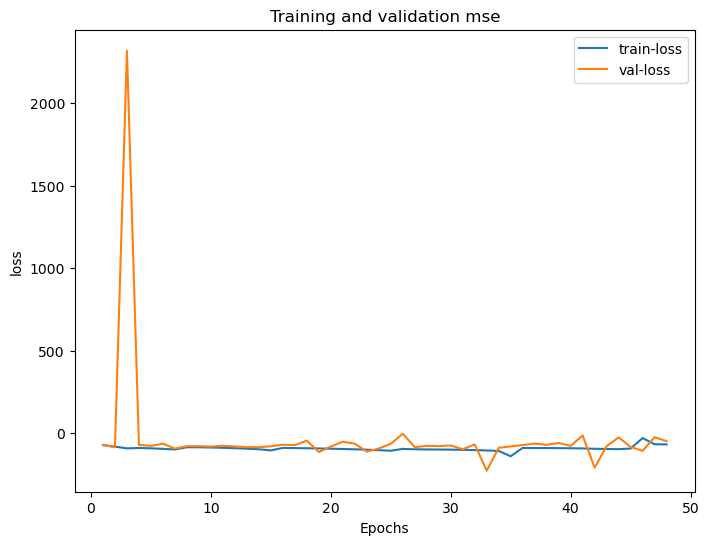

2023-01-26 02:00:07.719274: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 02:00:07.762020: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 02:00:07.769981: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


133/133 [==============================] - 3s 16ms/step
CPU times: user 3h 21min 30s, sys: 1h 13min 26s, total: 4h 34min 57s
Wall time: 3h 18min 54s


In [26]:
%%time
#long training for Indpoint w diff losses
comparedf= pd.read_parquet("/Users/sn/Downloads/nonscaled_preprocesssed_Ind/ERA5-RRR-modelpredictions_Indpoint_half2022.parquet", engine ="pyarrow")

MAX_EPOCHS = 1000
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                    patience=15,
                                                    mode='min', restore_best_weights=True)
# reduceLRplat= tf.keras.callbacks.ReduceLROnPlateau(
#     monitor='val_loss',
#     factor=0.1,
#     patience=15,
#     min_lr=0)
listoflosses=[tf.keras.losses.MeanSquaredError(),tf.keras.losses.MeanAbsoluteError(), 
              tf.keras.losses.MeanSquaredLogarithmicError(), tf.keras.losses.LogCosh(), tf.keras.losses.Huber(delta=1),
              tf.keras.losses.KLDivergence(), CustomAccuracy(), dual_weighted_mse(gamma_weight=5.), threshold2_loss, threshold3_loss,
             threshold4_loss, threshold5_loss, f1_loss]
for l in listoflosses:
    shallow1L_1rsF_temp_unscaled_thresholdloss_BiLSTM.compile(loss = l,                        #tf.keras.losses.Huber(delta=1),   #TRY CustomAccuracy() and Huber loss (delta =1); tf.losses.LogCosh() slightly worse performance in map;csiloss did not work; tf.keras.losses.KLDivergence()
                optimizer =tf.keras.optimizers.Adam(),
                #optimizer=hvd.DistributedOptimizer(tf.optimizers.Adam(lr=0.003, beta_1=0.9, beta_2=0.999,
               #epsilon=None, decay=0.0, amsgrad=False)),                           #loss = RobustAdaptativeLoss().loss, metric: RobustAdaptativeLoss().alpha
                metrics=[tf.keras.metrics.MeanSquaredError(),
                         tf.metrics.MeanAbsoluteError(),
                         tf.keras.metrics.Accuracy(),
                         tf.keras.metrics.RootMeanSquaredError(),
                         #tf.keras.metrics.Precision(), #THESE ARE THE ONES CAUSING SHAPE ERRORS!
                         #tf.keras.metrics.Recall(),
                         tf.keras.metrics.LogCoshError(),
                         tf.keras.metrics.KLDivergence(),
                         tf.keras.metrics.CategoricalCrossentropy(),
                         tfa.metrics.RSquare(),
                         #tfa.metrics.MatthewsCorrelationCoefficient(),
                         #tfa.metrics.HammingLoss(),
                         #RobustAdaptativeLoss().alpha,
                         csi,freqbiassc,f1,ham,match1, match2, match3, match5 #,matthews_correlation, ham #ham if not being used as loss
                         ])
    history = shallow1L_1rsF_temp_unscaled_thresholdloss_BiLSTM.fit(Xtrain,ytrain, epochs=MAX_EPOCHS,
                        validation_data=(Xval,yval),  batch_size=32, callbacks=[early_stopping, cp_callback])#cp_callback, reduceLRplat

#history = compile_and_fit(shallow1L_1rsF_temp_unscaled_thresholdloss_BiLSTM, multi_window)

    print("TEST PERFORMANCE:", str(l)[14:28])
    shallow1L_1rsF_temp_unscaled_thresholdloss_BiLSTM.evaluate(Xtest,ytest)
    shallow1L_1rsF_temp_unscaled_thresholdloss_BiLSTM.summary()
    shallow1L_1rsF_temp_unscaled_thresholdloss_BiLSTM.save('/Users/sn/Documents/trained models/NewModels/Indpointlongp15train_scratchdata_round1'+str(l)[14:28]+'_shallow1L_1rsF_temp_unscaled_BiLSTM_48-48_minmax_hrmodel.h5')#new_model = tf.keras.models.load_model('my_model.h5')
    def plot_metric(history):
        train_metrics = history.history["loss"]
        val_metrics = history.history['val_loss']
        epochs = range(1, len(val_metrics) + 1)
        plt.plot(epochs, train_metrics, label="train-loss")
        plt.plot(epochs, val_metrics, label="val-loss")
        plt.title('Training and validation '+ "mse")
        plt.xlabel("Epochs")
        plt.ylabel("loss")
        #plt.legend(["train_loss", 'val_loss"])
        plt.legend()
        plt.show()
    plot_metric(history)
    
    predictions=shallow1L_1rsF_temp_unscaled_thresholdloss_BiLSTM.predict(testdata)
    predictions = predictions.reshape(4249,48)
    predictionsdf =pd.DataFrame(predictions, index=Indpointtestdf.index[48:-47])
    predictionsdf=predictionsdf.stack()
    predictionsdf = predictionsdf.to_frame(name="Scratch_long_p_p_"+str(l)[14:28])
    predictionsdf=predictionsdf.reset_index()
    predictionsdf=predictionsdf.drop(["lat","long"], axis =1)
    predictionsdf.rename( columns={'level_3' :'forecastHr'}, inplace=True )
    predictionsdf=predictionsdf.set_index(["time","forecastHr"])
    comparedf["Scratch_long_p_p_"+str(l)[14:28]]=predictionsdf["Scratch_long_p_p_"+str(l)[14:28]]

    
    
comparedf.to_parquet("/Users/sn/Downloads/nonscaled_preprocesssed_Ind/ERA5-RRR-modelpredictions_Indpoint_half2022.parquet", compression="gzip")

In [28]:
comparedf.columns


Index(['era5forecasttemp', 'HRRRtmp',
       'PredtrainIndarea_testIndarea_cuttoIndpoint',
       'predtrainIndarea_testindpoint', 'predtrainIndPOINT_testindpoint',
       'predSCRATCHtrainIndPOINT_testindpoint',
       'predSCRATCHtrainIndPOINTlongtrain_testindpoint',
       'predLONGshuffleFalsetrainIndarea_testIndpoint',
       'predthrshld1shuffleTruetrainIndarea_shuffleFalsetestIndpoint',
       'predthrshld1shuffleFalseLONGp15_trainIndpt_shuffleFalsetestIndpoint',
       'predthrshld1LONG_trainIndareap15_testIndpoint',
       'Scratch_long_p_p_MeanSquaredErr', 'Scratch_long_p_p_MeanAbsoluteEr',
       'Scratch_long_p_p_MeanSquaredLog', 'Scratch_long_p_p_LogCosh object',
       'Scratch_long_p_p_Huber object a', 'Scratch_long_p_p_KLDivergence o',
       'Scratch_long_p_p_omAccuracy obj', 'Scratch_long_p_p__weighted_mse.',
       'Scratch_long_p_p_shold2_loss at', 'Scratch_long_p_p_shold3_loss at',
       'Scratch_long_p_p_shold4_loss at', 'Scratch_long_p_p_shold5_loss at',
       

In [31]:
comparedf=comparedf.rename(columns={"Scratch_long_p_p_oss at 0x108c8": "Scratch_long_p_p_F1loss"})
comparedf.columns

Index(['era5forecasttemp', 'HRRRtmp',
       'PredtrainIndarea_testIndarea_cuttoIndpoint',
       'predtrainIndarea_testindpoint', 'predtrainIndPOINT_testindpoint',
       'predSCRATCHtrainIndPOINT_testindpoint',
       'predSCRATCHtrainIndPOINTlongtrain_testindpoint',
       'predLONGshuffleFalsetrainIndarea_testIndpoint',
       'predthrshld1shuffleTruetrainIndarea_shuffleFalsetestIndpoint',
       'predthrshld1shuffleFalseLONGp15_trainIndpt_shuffleFalsetestIndpoint',
       'predthrshld1LONG_trainIndareap15_testIndpoint',
       'Scratch_long_p_p_MeanSquaredErr', 'Scratch_long_p_p_MeanAbsoluteEr',
       'Scratch_long_p_p_MeanSquaredLog', 'Scratch_long_p_p_LogCosh object',
       'Scratch_long_p_p_Huber object a', 'Scratch_long_p_p_KLDivergence o',
       'Scratch_long_p_p_omAccuracy obj', 'Scratch_long_p_p__weighted_mse.',
       'Scratch_long_p_p_shold2_loss at', 'Scratch_long_p_p_shold3_loss at',
       'Scratch_long_p_p_shold4_loss at', 'Scratch_long_p_p_shold5_loss at',
       

In [33]:
#ADD new losses here

comparedf_wo_nan= comparedf.dropna()
era5nonan = np.array(comparedf_wo_nan["era5forecasttemp"])
# predictionsnonan_a_a = np.array(comparedf_wo_nan["PredtrainIndarea_testIndarea_cuttoIndpoint"])


# #predictionsnonan_la_la_p = np.array(comparedf_wo_nan["predLONGtrainIndarea_testindareacutoffIndpoint"])


# predictionsnonan_a_p = np.array(comparedf_wo_nan["predtrainIndarea_testindpoint"])
# predictionsnonan_p_p = np.array(comparedf_wo_nan["predtrainIndPOINT_testindpoint"])
# predictionsnonan_sp_sp = np.array(comparedf_wo_nan["predSCRATCHtrainIndPOINT_testindpoint"])
# predictionsnonan_lsp_lsp = np.array(comparedf_wo_nan["predSCRATCHtrainIndPOINTlongtrain_testindpoint"])
# predictionsnonan_lshFp_lshFp = np.array(comparedf_wo_nan["predLONGshuffleFalsetrainIndarea_testIndpoint"])
# predictionsnonan_shTa_shFp = np.array(comparedf_wo_nan["predthrshld1shuffleTruetrainIndarea_shuffleFalsetestIndpoint"])
# predictionsnonan_lshFp_lshFp = np.array(comparedf_wo_nan["predthrshld1shuffleFalseLONGp15_trainIndpt_shuffleFalsetestIndpoint"])

HRRRnonan = np.array(comparedf_wo_nan["HRRRtmp"])

lsp_lsp_MSE = np.array(comparedf_wo_nan["Scratch_long_p_p_MeanSquaredErr"])
lsp_lsp_MAE = np.array(comparedf_wo_nan["Scratch_long_p_p_MeanAbsoluteEr"])
lsp_lsp_MSL = np.array(comparedf_wo_nan["Scratch_long_p_p_MeanSquaredLog"])
lsp_lsp_logcosh = np.array(comparedf_wo_nan["Scratch_long_p_p_LogCosh object"])
lsp_lsp_huber = np.array(comparedf_wo_nan["Scratch_long_p_p_Huber object a"])
lsp_lsp_KLD = np.array(comparedf_wo_nan["Scratch_long_p_p_KLDivergence o"])
lsp_lsp_CusAcc = np.array(comparedf_wo_nan["Scratch_long_p_p_omAccuracy obj"])
lsp_lsp_WtdMSE = np.array(comparedf_wo_nan["Scratch_long_p_p__weighted_mse."])
lsp_lsp_thrshld2 = np.array(comparedf_wo_nan["Scratch_long_p_p_shold2_loss at"])
lsp_lsp_thrshld3 = np.array(comparedf_wo_nan["Scratch_long_p_p_shold3_loss at"])
lsp_lsp_thrshld4 = np.array(comparedf_wo_nan["Scratch_long_p_p_shold4_loss at"])
lsp_lsp_thrshld5 = np.array(comparedf_wo_nan["Scratch_long_p_p_shold5_loss at"])
lsp_lsp_f1loss = np.array(comparedf_wo_nan["Scratch_long_p_p_F1loss"])


difflosslsp_lspvalueslist =[lsp_lsp_MSE,lsp_lsp_MAE, lsp_lsp_MSL,lsp_lsp_logcosh,lsp_lsp_huber,lsp_lsp_KLD,lsp_lsp_CusAcc,
                           lsp_lsp_WtdMSE, lsp_lsp_thrshld2, lsp_lsp_thrshld3, lsp_lsp_thrshld4, lsp_lsp_thrshld5, lsp_lsp_f1loss]


In [128]:
#np.corrcoef(era5nonan, era5nonan)
#np.corrcoef(era5nonan, HRRRnonan)

#era5nonan.corrcoef(lsp_lsp_MAE)
def pearson_r(x, y):

   # Compute correlation matrix
   corr_mat = np.corrcoef(x, y).

   # Return entry [0,1]
   return corr_mat[0,1]
pearson_r(era5nonan, lsp_lsp_MAE)

0.9440626691963504

In [129]:
pearson_r(era5nonan, lsp_lsp_MSE)

0.9440601311669945

In [124]:
from scipy.stats.stats import pearsonr

pearsonr(era5nonan, lsp_lsp_MAE)

/var/folders/lf/l3zcrxw10c18k9jmtscxsf2w0000gn/T/ipykernel_12204/759764516.py:1: DeprecationWarning: Please use `pearsonr` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  from scipy.stats.stats import pearsonr


AttributeError: 'PearsonRResult' object has no attribute 'numpy'

In [122]:
from sklearn.metrics import matthews_corrcoef #meant for binary classification only
matthews_corrcoef(era5nonan, lsp_lsp_MAE)

ValueError: continuous is not supported

In [120]:
rounded_corr_matrix = comparedf_wo_nan.corr().round(5)
rounded_corr_matrix

,era5forecasttemp,HRRRtmp,PredtrainIndarea_testIndarea_cuttoIndpoint,predtrainIndarea_testindpoint,predtrainIndPOINT_testindpoint,predSCRATCHtrainIndPOINT_testindpoint,predSCRATCHtrainIndPOINTlongtrain_testindpoint,predLONGshuffleFalsetrainIndarea_testIndpoint,predthrshld1shuffleTruetrainIndarea_shuffleFalsetestIndpoint,predthrshld1shuffleFalseLONGp15_trainIndpt_shuffleFalsetestIndpoint,...,Scratch_long_p_p_LogCosh object,Scratch_long_p_p_Huber object a,Scratch_long_p_p_KLDivergence o,Scratch_long_p_p_omAccuracy obj,Scratch_long_p_p__weighted_mse.,Scratch_long_p_p_shold2_loss at,Scratch_long_p_p_shold3_loss at,Scratch_long_p_p_shold4_loss at,Scratch_long_p_p_shold5_loss at,Scratch_long_p_p_F1loss
era5forecasttemp,1.00000,0.88679,-0.03309,-0.01911,0.02680,0.90978,0.94201,0.85497,0.87835,0.92104,...,0.94082,0.93499,0.92803,0.93667,0.93423,0.93343,0.87700,0.86293,0.94085,0.80634
HRRRtmp,0.88679,1.00000,-0.02303,-0.02518,0.02352,0.80672,0.83529,0.72230,0.75367,0.79656,...,0.83613,0.83554,0.81929,0.83854,0.83859,0.83473,0.75819,0.74949,0.83693,0.69249
PredtrainIndarea_testIndarea_cuttoIndpoint,-0.03309,-0.02303,1.00000,0.02338,-0.01345,-0.03088,-0.03205,-0.02754,-0.03278,-0.02816,...,-0.03259,-0.03346,-0.03481,-0.03668,-0.03594,-0.03346,-0.03133,-0.03346,-0.03632,-0.02513
predtrainIndarea_testindpoint,-0.01911,-0.02518,0.02338,1.00000,-0.01679,-0.02514,-0.01892,-0.02523,-0.01987,-0.02129,...,-0.02245,-0.01591,-0.01794,-0.01676,-0.01888,-0.01835,-0.02184,-0.02361,-0.02118,-0.02584
predtrainIndPOINT_testindpoint,0.02680,0.02352,-0.01345,-0.01679,1.00000,0.03515,0.03507,0.02643,0.02702,0.03281,...,0.03704,0.03309,0.04123,0.03311,0.03624,0.03420,0.03112,0.02715,0.03361,0.02784
predSCRATCHtrainIndPOINT_testindpoint,0.90978,0.80672,-0.03088,-0.02514,0.03515,1.00000,0.93105,0.94229,0.93670,0.92801,...,0.93742,0.92510,0.92584,0.93128,0.93063,0.92948,0.94348,0.93642,0.93509,0.88716
predSCRATCHtrainIndPOINTlongtrain_testindpoint,0.94201,0.83529,-0.03205,-0.01892,0.03507,0.93105,1.00000,0.88280,0.90089,0.95322,...,0.97079,0.96549,0.95362,0.96540,0.96324,0.96515,0.89259,0.88616,0.97295,0.83371
predLONGshuffleFalsetrainIndarea_testIndpoint,0.85497,0.72230,-0.02754,-0.02523,0.02643,0.94229,0.88280,1.00000,0.94235,0.90371,...,0.89417,0.87508,0.88045,0.88010,0.87605,0.88263,0.93231,0.91634,0.88686,0.85237
predthrshld1shuffleTruetrainIndarea_shuffleFalsetestIndpoint,0.87835,0.75367,-0.03278,-0.01987,0.02702,0.93670,0.90089,0.94235,1.00000,0.89768,...,0.91244,0.89600,0.89949,0.90524,0.89847,0.90425,0.93385,0.93603,0.90621,0.89470
predthrshld1shuffleFalseLONGp15_trainIndpt_shuffleFalsetestIndpoint,0.92104,0.79656,-0.02816,-0.02129,0.03281,0.92801,0.95322,0.90371,0.89768,1.00000,...,0.95688,0.94471,0.94438,0.94477,0.94521,0.94597,0.90051,0.87584,0.95452,0.81814


In [ ]:
comparedf

In [39]:
STRdifflosslsp_lsp =["lsp_lsp_MSE","lsp_lsp_MAE", "lsp_lsp_MSL","lsp_lsp_logcosh","lsp_lsp_huber","lsp_lsp_KLD","lsp_lsp_CusAcc",
                           "lsp_lsp_WtdMSE", "lsp_lsp_thrshld2", "lsp_lsp_thrshld3", "lsp_lsp_thrshld4", "lsp_lsp_thrshld5", "lsp_lsp_f1loss"]


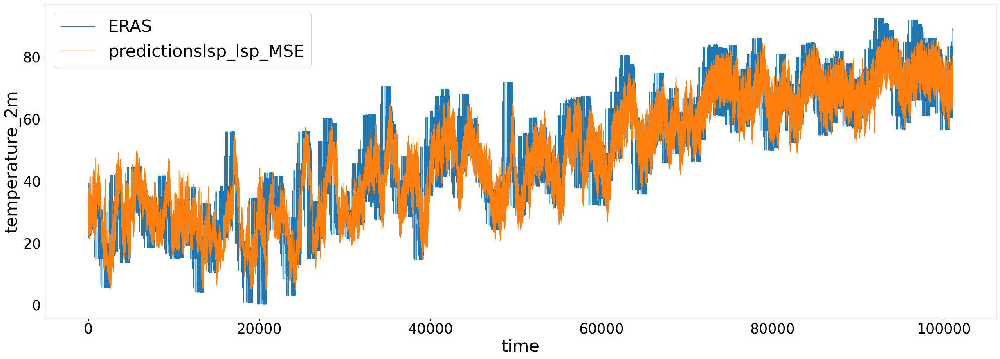

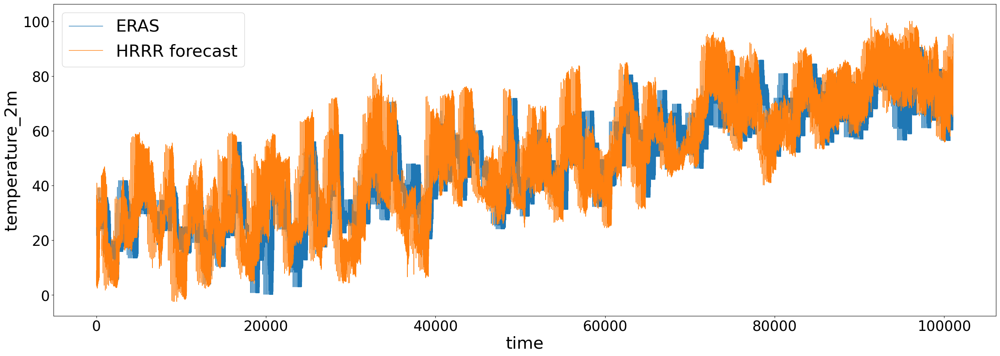

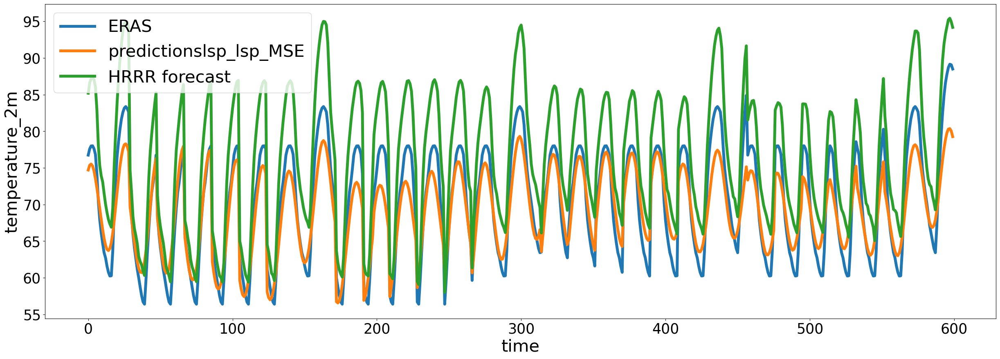

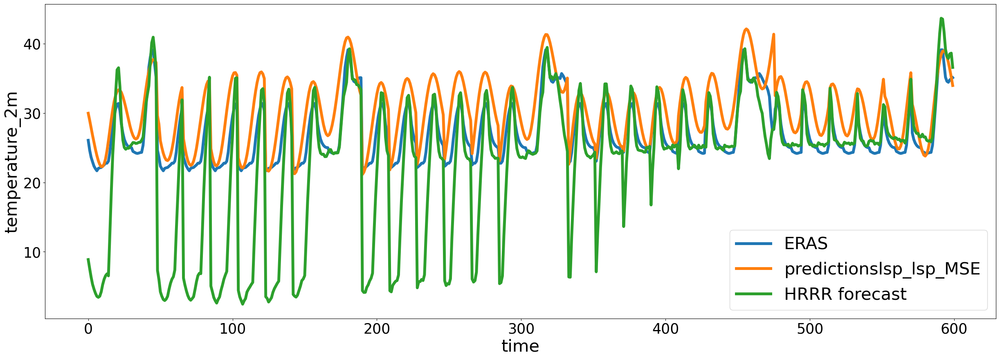

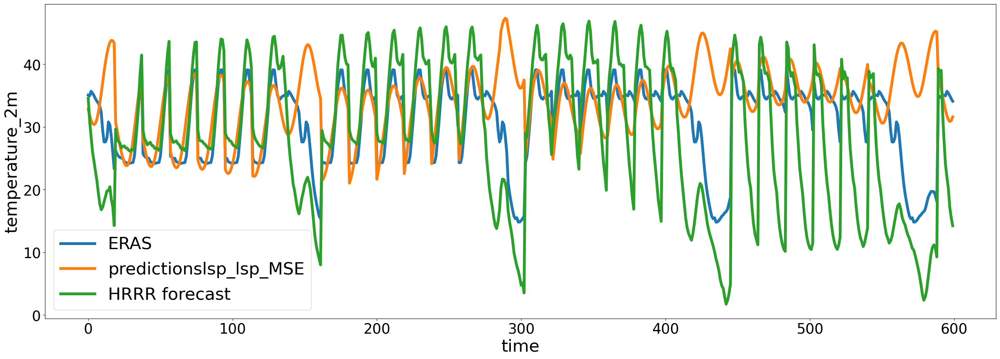

...

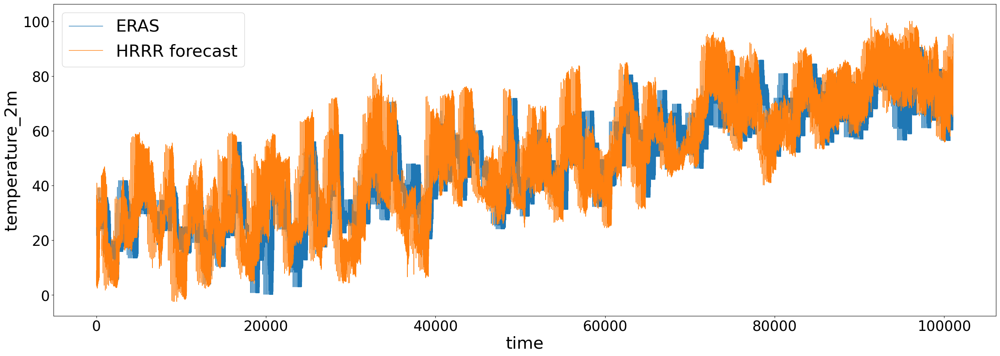

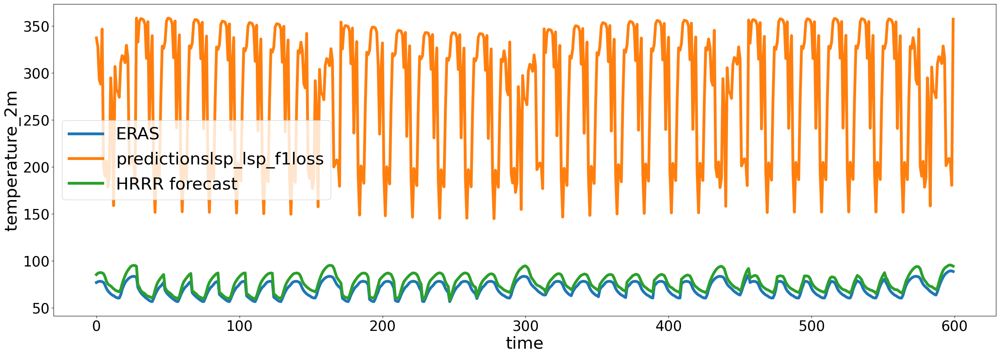

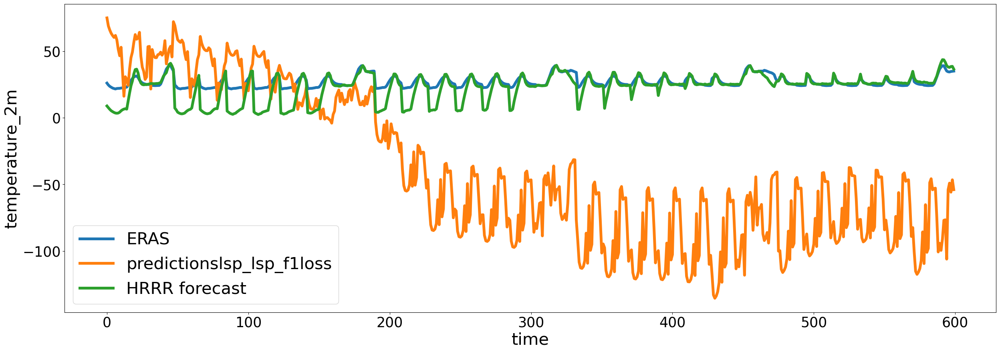

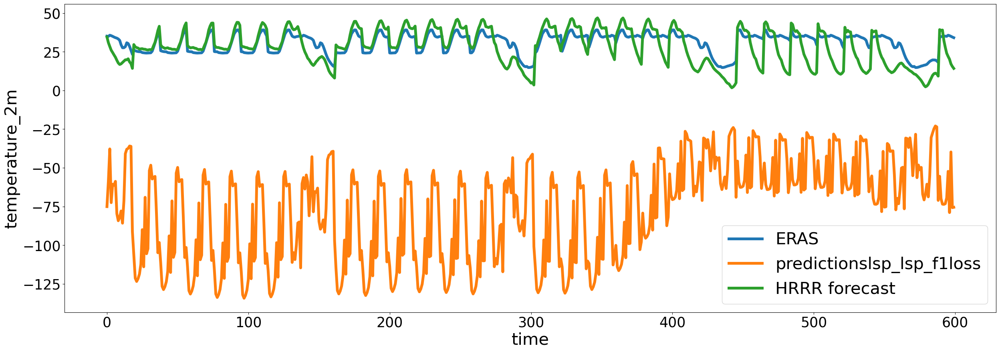

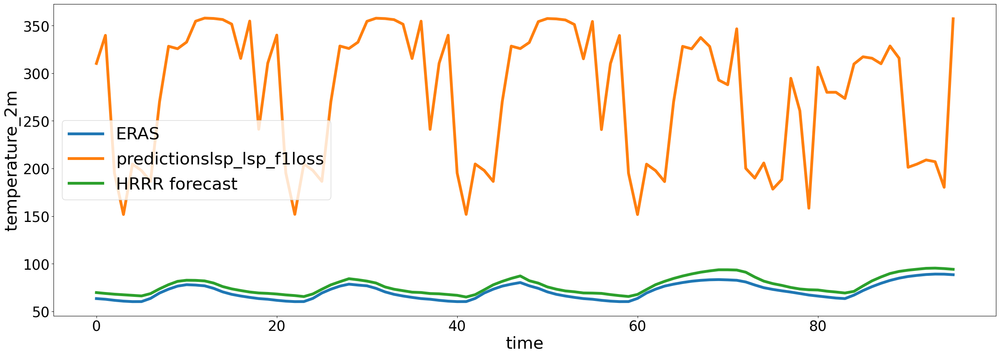

In [110]:
#MAE and KLDivergence were best, even better than threshold loss

a=0
for lo in difflosslsp_lspvalueslist:
    fig, ax = plt.subplots(figsize=(30, 10))
    ax.set_xlabel('time', fontsize=30)
    ax.set_ylabel('temperature_2m', fontsize=30)
    ax.plot(era5nonan, label='ERAS', linewidth=1)
    ax.plot(lo, label='predictions'+STRdifflosslsp_lsp[a], linewidth=1)
    #ax.plot(HRRRnonan, label='HRRR forecast', linewidth=1)
    ax.legend(prop={'size':30})
    ax.tick_params(axis='both', labelsize=25)
    plt.show()
    
    fig, ax = plt.subplots(figsize=(30, 10))
    ax.set_xlabel('time', fontsize=30)
    ax.set_ylabel('temperature_2m', fontsize=30)
    ax.plot(era5nonan, label='ERAS', linewidth=1)
    #ax.plot(lo, label='predictions'+STRdifflosslsp_lsp[a], linewidth=1)
    ax.plot(HRRRnonan, label='HRRR forecast', linewidth=1)
    ax.legend(prop={'size':30})
    ax.tick_params(axis='both', labelsize=25)
    plt.show()
    
    fig, ax = plt.subplots(figsize=(30, 10))
    ax.set_xlabel('time', fontsize=30)
    ax.set_ylabel('temperature_2m', fontsize=30)
    ax.plot(era5nonan[-600:], label='ERAS', linewidth=5)
    ax.plot(lo[-600:], label='predictions'+STRdifflosslsp_lsp[a], linewidth=5)
    ax.plot(HRRRnonan[-600:], label='HRRR forecast', linewidth=5)
    ax.legend(prop={'size':30})
    ax.tick_params(axis='both', labelsize=25)
    plt.show()
    
    fig, ax = plt.subplots(figsize=(30, 10))
    ax.set_xlabel('time', fontsize=30)
    ax.set_ylabel('temperature_2m', fontsize=30)
    ax.plot(era5nonan[:600], label='ERAS', linewidth=5)
    ax.plot(lo[:600], label='predictions'+STRdifflosslsp_lsp[a], linewidth=5)
    ax.plot(HRRRnonan[:600], label='HRRR forecast', linewidth=5)
    ax.legend(prop={'size':30})
    ax.tick_params(axis='both', labelsize=25)
    plt.show()
    
    fig, ax = plt.subplots(figsize=(30, 10))
    ax.set_xlabel('time', fontsize=30)
    ax.set_ylabel('temperature_2m', fontsize=30)
    ax.plot(era5nonan[600:1200], label='ERAS', linewidth=5)
    ax.plot(lo[600:1200], label='predictions'+STRdifflosslsp_lsp[a], linewidth=5)
    ax.plot(HRRRnonan[600:1200], label='HRRR forecast', linewidth=5)
    ax.legend(prop={'size':30})
    ax.tick_params(axis='both', labelsize=25)
    plt.show()
    
    fig, ax = plt.subplots(figsize=(30, 10))
    ax.set_xlabel('time', fontsize=30)
    ax.set_ylabel('temperature_2m', fontsize=30)
    ax.plot(era5nonan[-96:], label='ERAS', linewidth=5)
    ax.plot(lo[-96:], label='predictions'+STRdifflosslsp_lsp[a], linewidth=5)
    ax.plot(HRRRnonan[-96:], label='HRRR forecast', linewidth=5)
    ax.legend(prop={'size':30})
    ax.tick_params(axis='both', labelsize=25)
    plt.show()
    
    a=a+1

In [46]:
compareperfdf =pd.read_parquet("/Users/sn/Downloads/nonscaled_preprocesssed_Ind/performanceMetricsCompare2.parquet", engine ="pyarrow")
compareperfdf=compareperfdf.transpose()

#getnew lossmetrics in dict:
metrics={#"HRRR":[keras.losses.MSE(era5nonan, HRRRnonan).numpy(),keras.losses.MAE(era5nonan, HRRRnonan).numpy(), RMSE(era5nonan, HRRRnonan).numpy(), threshold_loss(era5nonan, HRRRnonan).numpy(), r2(era5nonan, HRRRnonan).numpy(), accuracy(era5nonan, HRRRnonan).numpy(), match1(era5nonan, HRRRnonan).numpy(), match2(era5nonan, HRRRnonan).numpy(), match3(era5nonan, HRRRnonan).numpy(), match5(era5nonan, HRRRnonan).numpy()],
    #"a_a":[keras.losses.MSE(era5nonan, predictionsnonan_a_a).numpy(),keras.losses.MAE(era5nonan, predictionsnonan_a_a).numpy(), RMSE(era5nonan, predictionsnonan_a_a).numpy(), threshold_loss(era5nonan, predictionsnonan_a_a).numpy(), r2(era5nonan, predictionsnonan_a_a).numpy(), accuracy(era5nonan, predictionsnonan_a_a).numpy(), match1(era5nonan, predictionsnonan_a_a).numpy(), match2(era5nonan, predictionsnonan_a_a).numpy(), match3(era5nonan, predictionsnonan_a_a).numpy(), match5(era5nonan, predictionsnonan_a_a).numpy()],
     #"a_p":[keras.losses.MSE(era5nonan, predictionsnonan_a_p).numpy(),keras.losses.MAE(era5nonan, predictionsnonan_a_p).numpy(), RMSE(era5nonan, predictionsnonan_a_p).numpy(), threshold_loss(era5nonan, predictionsnonan_a_p).numpy(), r2(era5nonan, predictionsnonan_a_p).numpy(), accuracy(era5nonan, predictionsnonan_a_p).numpy(), match1(era5nonan, predictionsnonan_a_p).numpy(), match2(era5nonan, predictionsnonan_a_p).numpy(), match3(era5nonan, predictionsnonan_a_p).numpy(), match5(era5nonan, predictionsnonan_a_p).numpy()],
     #"p_p":[keras.losses.MSE(era5nonan, predictionsnonan_p_p).numpy(),keras.losses.MAE(era5nonan, predictionsnonan_p_p).numpy(), RMSE(era5nonan, predictionsnonan_p_p).numpy(), threshold_loss(era5nonan, predictionsnonan_p_p).numpy(), r2(era5nonan, predictionsnonan_p_p).numpy(), accuracy(era5nonan, predictionsnonan_p_p).numpy(), match1(era5nonan, predictionsnonan_p_p).numpy(), match2(era5nonan, predictionsnonan_p_p).numpy(), match3(era5nonan, predictionsnonan_p_p).numpy(), match5(era5nonan, predictionsnonan_p_p).numpy()],
     #"lap_la_p":[keras.losses.MSE(era5nonan, predictionsnonan_la_la_p).numpy(),keras.losses.MAE(era5nonan, predictionsnonan_la_la_p).numpy(), RMSE(era5nonan, predictionsnonan_la_la_p).numpy(), threshold_loss(era5nonan, predictionsnonan_la_la_p).numpy(), r2(era5nonan, predictionsnonan_la_la_p).numpy(), accuracy(era5nonan, predictionsnonan_la_la_p).numpy(), match1(era5nonan, predictionsnonan_la_la_p).numpy(), match2(era5nonan, predictionsnonan_la_la_p).numpy(), match3(era5nonan, predictionsnonan_la_la_p).numpy(), match5(era5nonan, predictionsnonan_la_la_p).numpy()],
     #"sp_sp":[keras.losses.MSE(era5nonan, predictionsnonan_sp_sp).numpy(),keras.losses.MAE(era5nonan, predictionsnonan_sp_sp).numpy(), RMSE(era5nonan, predictionsnonan_sp_sp).numpy(), threshold_loss(era5nonan, predictionsnonan_sp_sp).numpy(), r2(era5nonan, predictionsnonan_sp_sp).numpy(), accuracy(era5nonan, predictionsnonan_sp_sp).numpy(), match1(era5nonan, predictionsnonan_sp_sp).numpy(), match2(era5nonan, predictionsnonan_sp_sp).numpy(), match3(era5nonan, predictionsnonan_sp_sp).numpy(), match5(era5nonan, predictionsnonan_sp_sp).numpy()],
     #"lsp_lsp":[keras.losses.MSE(era5nonan, predictionsnonan_lsp_lsp).numpy(),keras.losses.MAE(era5nonan, predictionsnonan_lsp_lsp).numpy(), RMSE(era5nonan, predictionsnonan_lsp_lsp).numpy(), threshold_loss(era5nonan, predictionsnonan_lsp_lsp).numpy(), r2(era5nonan, predictionsnonan_lsp_lsp).numpy(), accuracy(era5nonan, predictionsnonan_lsp_lsp).numpy(), match1(era5nonan, predictionsnonan_lsp_lsp).numpy(), match2(era5nonan, predictionsnonan_lsp_lsp).numpy(), match3(era5nonan, predictionsnonan_lsp_lsp).numpy(), match5(era5nonan, predictionsnonan_lsp_lsp).numpy()],
     #"lshFa_lshFp":[keras.losses.MSE(era5nonan, predictionsnonan_lshFp_lshFp).numpy(),keras.losses.MAE(era5nonan, predictionsnonan_lshFp_lshFp).numpy(), RMSE(era5nonan, predictionsnonan_lshFp_lshFp).numpy(), threshold_loss(era5nonan, predictionsnonan_lshFp_lshFp).numpy(), r2(era5nonan, predictionsnonan_lshFp_lshFp).numpy(), accuracy(era5nonan, predictionsnonan_lshFp_lshFp).numpy(), match1(era5nonan, predictionsnonan_lshFp_lshFp).numpy(), match2(era5nonan, predictionsnonan_lshFp_lshFp).numpy(), match3(era5nonan, predictionsnonan_lshFp_lshFp).numpy(), match5(era5nonan, predictionsnonan_lshFp_lshFp).numpy()],
     #"shTa_shFp":[keras.losses.MSE(era5nonan, predictionsnonan_shTa_shFp).numpy(),keras.losses.MAE(era5nonan, predictionsnonan_shTa_shFp).numpy(), RMSE(era5nonan, predictionsnonan_shTa_shFp).numpy(), threshold_loss(era5nonan, predictionsnonan_shTa_shFp).numpy(), r2(era5nonan, predictionsnonan_shTa_shFp).numpy(), accuracy(era5nonan, predictionsnonan_shTa_shFp).numpy(), match1(era5nonan, predictionsnonan_shTa_shFp).numpy(), match2(era5nonan, predictionsnonan_shTa_shFp).numpy(), match3(era5nonan, predictionsnonan_shTa_shFp).numpy(), match5(era5nonan, predictionsnonan_shTa_shFp).numpy()],
     #"lshFp_lshFp":[keras.losses.MSE(era5nonan, predictionsnonan_lshFp_lshFp).numpy(),keras.losses.MAE(era5nonan, predictionsnonan_lshFp_lshFp).numpy(), RMSE(era5nonan, predictionsnonan_lshFp_lshFp).numpy(), threshold_loss(era5nonan, predictionsnonan_lshFp_lshFp).numpy(), r2(era5nonan, predictionsnonan_lshFp_lshFp).numpy(), accuracy(era5nonan, predictionsnonan_lshFp_lshFp).numpy(), match1(era5nonan, predictionsnonan_lshFp_lshFp).numpy(), match2(era5nonan, predictionsnonan_lshFp_lshFp).numpy(), match3(era5nonan, predictionsnonan_lshFp_lshFp).numpy(), match5(era5nonan, predictionsnonan_lshFp_lshFp).numpy()]
      "lsp_lsp_MSE":[keras.losses.MSE(era5nonan, lsp_lsp_MSE).numpy(),keras.losses.MAE(era5nonan, lsp_lsp_MSE).numpy(), RMSE(era5nonan, lsp_lsp_MSE).numpy(), threshold_loss(era5nonan, lsp_lsp_MSE).numpy(), r2(era5nonan, lsp_lsp_MSE).numpy(), accuracy(era5nonan, lsp_lsp_MSE).numpy(), match1(era5nonan, lsp_lsp_MSE).numpy(), match2(era5nonan, lsp_lsp_MSE).numpy(), match3(era5nonan, lsp_lsp_MSE).numpy(), match5(era5nonan, lsp_lsp_MSE).numpy()],
      "lsp_lsp_MAE":[keras.losses.MSE(era5nonan, lsp_lsp_MAE).numpy(),keras.losses.MAE(era5nonan, lsp_lsp_MAE).numpy(), RMSE(era5nonan, lsp_lsp_MAE).numpy(), threshold_loss(era5nonan, lsp_lsp_MAE).numpy(), r2(era5nonan, lsp_lsp_MAE).numpy(), accuracy(era5nonan, lsp_lsp_MAE).numpy(), match1(era5nonan, lsp_lsp_MAE).numpy(), match2(era5nonan, lsp_lsp_MAE).numpy(), match3(era5nonan, lsp_lsp_MAE).numpy(), match5(era5nonan, lsp_lsp_MAE).numpy()],
      "lsp_lsp_MSL":[keras.losses.MSE(era5nonan, lsp_lsp_MSL).numpy(),keras.losses.MAE(era5nonan, lsp_lsp_MSL).numpy(), RMSE(era5nonan, lsp_lsp_MSL).numpy(), threshold_loss(era5nonan, lsp_lsp_MSL).numpy(), r2(era5nonan, lsp_lsp_MSL).numpy(), accuracy(era5nonan, lsp_lsp_MSL).numpy(), match1(era5nonan, lsp_lsp_MSL).numpy(), match2(era5nonan, lsp_lsp_MSL).numpy(), match3(era5nonan, lsp_lsp_MSL).numpy(), match5(era5nonan, lsp_lsp_MSL).numpy()],
      "lsp_lsp_logcosh":[keras.losses.MSE(era5nonan, lsp_lsp_logcosh).numpy(),keras.losses.MAE(era5nonan, lsp_lsp_logcosh).numpy(), RMSE(era5nonan, lsp_lsp_logcosh).numpy(), threshold_loss(era5nonan, lsp_lsp_logcosh).numpy(), r2(era5nonan, lsp_lsp_logcosh).numpy(), accuracy(era5nonan, lsp_lsp_logcosh).numpy(), match1(era5nonan, lsp_lsp_logcosh).numpy(), match2(era5nonan, lsp_lsp_logcosh).numpy(), match3(era5nonan, lsp_lsp_logcosh).numpy(), match5(era5nonan, lsp_lsp_logcosh).numpy()],
      "lsp_lsp_huber":[keras.losses.MSE(era5nonan, lsp_lsp_huber).numpy(),keras.losses.MAE(era5nonan, lsp_lsp_huber).numpy(), RMSE(era5nonan, lsp_lsp_huber).numpy(), threshold_loss(era5nonan, lsp_lsp_huber).numpy(), r2(era5nonan, lsp_lsp_huber).numpy(), accuracy(era5nonan, lsp_lsp_huber).numpy(), match1(era5nonan, lsp_lsp_huber).numpy(), match2(era5nonan, lsp_lsp_huber).numpy(), match3(era5nonan, lsp_lsp_huber).numpy(), match5(era5nonan, lsp_lsp_huber).numpy()],
      "lsp_lsp_KLD":[keras.losses.MSE(era5nonan, lsp_lsp_KLD).numpy(),keras.losses.MAE(era5nonan, lsp_lsp_KLD).numpy(), RMSE(era5nonan, lsp_lsp_KLD).numpy(), threshold_loss(era5nonan, lsp_lsp_KLD).numpy(), r2(era5nonan, lsp_lsp_KLD).numpy(), accuracy(era5nonan, lsp_lsp_KLD).numpy(), match1(era5nonan, lsp_lsp_KLD).numpy(), match2(era5nonan, lsp_lsp_KLD).numpy(), match3(era5nonan, lsp_lsp_KLD).numpy(), match5(era5nonan, lsp_lsp_KLD).numpy()],
      "lsp_lsp_CusAcc":[keras.losses.MSE(era5nonan, lsp_lsp_CusAcc).numpy(),keras.losses.MAE(era5nonan, lsp_lsp_CusAcc).numpy(), RMSE(era5nonan, lsp_lsp_CusAcc).numpy(), threshold_loss(era5nonan, lsp_lsp_CusAcc).numpy(), r2(era5nonan, lsp_lsp_CusAcc).numpy(), accuracy(era5nonan, lsp_lsp_CusAcc).numpy(), match1(era5nonan, lsp_lsp_CusAcc).numpy(), match2(era5nonan, lsp_lsp_CusAcc).numpy(), match3(era5nonan, lsp_lsp_CusAcc).numpy(), match5(era5nonan, lsp_lsp_CusAcc).numpy()],
      "lsp_lsp_WtdMSE":[keras.losses.MSE(era5nonan, lsp_lsp_WtdMSE).numpy(),keras.losses.MAE(era5nonan, lsp_lsp_WtdMSE).numpy(), RMSE(era5nonan, lsp_lsp_WtdMSE).numpy(), threshold_loss(era5nonan, lsp_lsp_WtdMSE).numpy(), r2(era5nonan, lsp_lsp_WtdMSE).numpy(), accuracy(era5nonan, lsp_lsp_WtdMSE).numpy(), match1(era5nonan, lsp_lsp_WtdMSE).numpy(), match2(era5nonan, lsp_lsp_WtdMSE).numpy(), match3(era5nonan, lsp_lsp_WtdMSE).numpy(), match5(era5nonan, lsp_lsp_WtdMSE).numpy()],
      "lsp_lsp_thrshld2":[keras.losses.MSE(era5nonan, lsp_lsp_thrshld2).numpy(),keras.losses.MAE(era5nonan, lsp_lsp_thrshld2).numpy(), RMSE(era5nonan, lsp_lsp_thrshld2).numpy(), threshold_loss(era5nonan, lsp_lsp_thrshld2).numpy(), r2(era5nonan, lsp_lsp_thrshld2).numpy(), accuracy(era5nonan, lsp_lsp_thrshld2).numpy(), match1(era5nonan, lsp_lsp_thrshld2).numpy(), match2(era5nonan, lsp_lsp_thrshld2).numpy(), match3(era5nonan, lsp_lsp_thrshld2).numpy(), match5(era5nonan, lsp_lsp_thrshld2).numpy()],
      "lsp_lsp_thrshld3":[keras.losses.MSE(era5nonan, lsp_lsp_thrshld3).numpy(),keras.losses.MAE(era5nonan, lsp_lsp_thrshld3).numpy(), RMSE(era5nonan, lsp_lsp_thrshld3).numpy(), threshold_loss(era5nonan, lsp_lsp_thrshld3).numpy(), r2(era5nonan, lsp_lsp_thrshld3).numpy(), accuracy(era5nonan, lsp_lsp_MSE).numpy(), match1(era5nonan, lsp_lsp_thrshld3).numpy(), match2(era5nonan, lsp_lsp_thrshld3).numpy(), match3(era5nonan, lsp_lsp_thrshld3).numpy(), match5(era5nonan, lsp_lsp_thrshld3).numpy()],
      "lsp_lsp_thrshld4":[keras.losses.MSE(era5nonan, lsp_lsp_thrshld4).numpy(),keras.losses.MAE(era5nonan, lsp_lsp_thrshld4).numpy(), RMSE(era5nonan, lsp_lsp_thrshld4).numpy(), threshold_loss(era5nonan, lsp_lsp_thrshld4).numpy(), r2(era5nonan, lsp_lsp_thrshld4).numpy(), accuracy(era5nonan, lsp_lsp_thrshld4).numpy(), match1(era5nonan, lsp_lsp_thrshld4).numpy(), match2(era5nonan, lsp_lsp_thrshld4).numpy(), match3(era5nonan, lsp_lsp_thrshld4).numpy(), match5(era5nonan, lsp_lsp_thrshld4).numpy()],
      "lsp_lsp_thrshld5":[keras.losses.MSE(era5nonan, lsp_lsp_thrshld5).numpy(),keras.losses.MAE(era5nonan, lsp_lsp_thrshld5).numpy(), RMSE(era5nonan, lsp_lsp_thrshld5).numpy(), threshold_loss(era5nonan, lsp_lsp_thrshld5).numpy(), r2(era5nonan, lsp_lsp_thrshld5).numpy(), accuracy(era5nonan, lsp_lsp_thrshld5).numpy(), match1(era5nonan, lsp_lsp_thrshld5).numpy(), match2(era5nonan, lsp_lsp_thrshld5).numpy(), match3(era5nonan, lsp_lsp_thrshld5).numpy(), match5(era5nonan, lsp_lsp_thrshld5).numpy()],
      "lsp_lsp_f1loss":[keras.losses.MSE(era5nonan, lsp_lsp_f1loss).numpy(),keras.losses.MAE(era5nonan, lsp_lsp_f1loss).numpy(), RMSE(era5nonan, lsp_lsp_f1loss).numpy(), threshold_loss(era5nonan, lsp_lsp_f1loss).numpy(), r2(era5nonan, lsp_lsp_f1loss).numpy(), accuracy(era5nonan, lsp_lsp_f1loss).numpy(), match1(era5nonan, lsp_lsp_f1loss).numpy(), match2(era5nonan, lsp_lsp_f1loss).numpy(), match3(era5nonan, lsp_lsp_f1loss).numpy(), match5(era5nonan, lsp_lsp_f1loss).numpy()]
}


compareperfdf2 = pd.DataFrame(metrics, index = ['MSE', 'MAE', 'RMSE', 'threshold_loss', 'R2','accuracy','match1', 'match2', 'match3', 'match5'])


,HRRR,a_a,a_p,p_p,lap_la_p,sp_sp,lsp_lsp,lshFa_lshFp,shTa_shFp,lshFp_lshFp
MSE,102.537029,829.440430,785.615417,661.252686,94.205406,69.358002,48.624386,72.341537,94.394821,72.341537
MAE,8.099148,23.492769,22.919300,21.071306,7.527181,6.554359,5.178500,6.682800,7.531392,6.682800
RMSE,10.126057,28.800008,28.028831,25.714834,9.705947,8.328145,6.973119,8.505383,9.715700,8.505383
threshold_loss,0.080991,0.234928,0.229193,0.210713,0.075272,0.065544,0.051785,0.066828,0.075314,0.066828
R2,0.742886,-1.079837,-0.969945,-0.658103,0.763778,0.826084,0.878073,0.818602,0.763303,0.818602
accuracy,5437.827148,4561.638672,4513.430176,4561.308594,5189.262695,5182.257812,5079.976074,5185.179688,5200.025879,5185.179688
match1,0.034366,0.012953,0.013784,0.013477,0.045311,0.045607,0.064498,0.044707,0.045251,0.044707
match2,0.069425,0.025381,0.026688,0.027390,0.090621,0.091631,0.129213,0.090977,0.090473,0.090977
match3,0.105682,0.037939,0.039413,0.041659,0.135882,0.137268,0.195581,0.136130,0.135704,0.136130
match5,0.178699,0.062598,0.065339,0.068812,0.219992,0.226969,0.325358,0.228968,0.220230,0.228968


In [59]:
STRdifflosslsp_lsp =["lsp_lsp_MSE","lsp_lsp_MAE", "lsp_lsp_MSL","lsp_lsp_logcosh","lsp_lsp_huber","lsp_lsp_KLD","lsp_lsp_CusAcc",
                           "lsp_lsp_WtdMSE", "lsp_lsp_thrshld2", "lsp_lsp_thrshld3", "lsp_lsp_thrshld4", "lsp_lsp_thrshld5", "lsp_lsp_f1loss"]
for strl in STRdifflosslsp_lsp:
    compareperfdf[strl]=compareperfdf2[strl]
    
compareperfdf
compareperfdf.shape

(10, 23)

In [101]:
compareperfdf= compareperfdf[['a_a', 'a_p', 'p_p', 'lap_la_p', 'sp_sp', 
       'lshFa_lshFp', 'shTa_shFp', 'lshFp_lshFp', 'lsp_lsp_MSE', 'lsp_lsp_MAE',
       'lsp_lsp_MSL', 'lsp_lsp_logcosh', 'lsp_lsp_huber', 'lsp_lsp_KLD',
       'lsp_lsp_CusAcc', 'lsp_lsp_WtdMSE', 'lsp_lsp_thrshld1','lsp_lsp_thrshld2',
       'lsp_lsp_thrshld3', 'lsp_lsp_thrshld4', 'lsp_lsp_thrshld5',
       'lsp_lsp_f1loss', 'HRRR']]
#compareperfdf= compareperfdf.rename(columns={"lsp_lsp": "lsp_lsp_thrshld1"})
compareperfdf.columns                                           

Index(['a_a', 'a_p', 'p_p', 'lap_la_p', 'sp_sp', 'lshFa_lshFp', 'shTa_shFp',
       'lshFp_lshFp', 'lsp_lsp_MSE', 'lsp_lsp_MAE', 'lsp_lsp_MSL',
       'lsp_lsp_logcosh', 'lsp_lsp_huber', 'lsp_lsp_KLD', 'lsp_lsp_CusAcc',
       'lsp_lsp_WtdMSE', 'lsp_lsp_thrshld1', 'lsp_lsp_thrshld2',
       'lsp_lsp_thrshld3', 'lsp_lsp_thrshld4', 'lsp_lsp_thrshld5',
       'lsp_lsp_f1loss', 'HRRR'],
      dtype='object')

In [98]:
compareperfdf.columns 

Index(['MSE', 'MAE', 'RMSE', 'threshold_loss', 'R2', 'accuracy', 'match1',
       'match2', 'match3', 'match5'],
      dtype='object')

<AxesSubplot: >

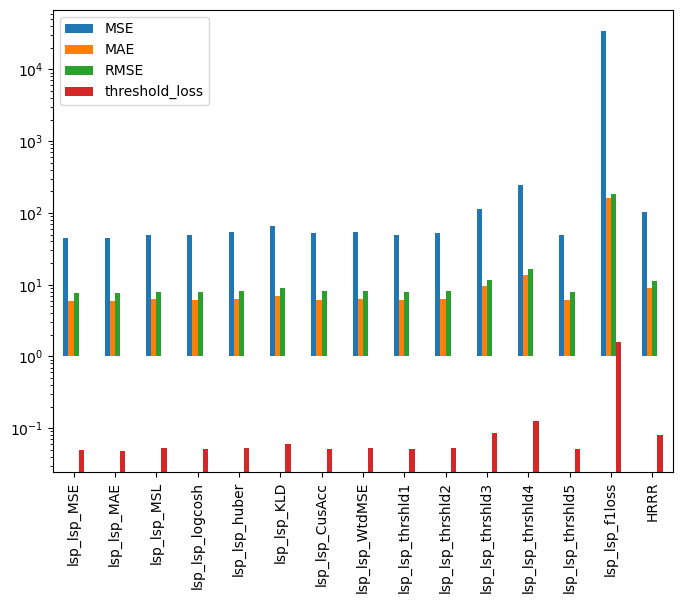

In [102]:
compareperfdf.transpose().iloc[8:24,0:4].plot(kind="bar", log=True)

<AxesSubplot: >

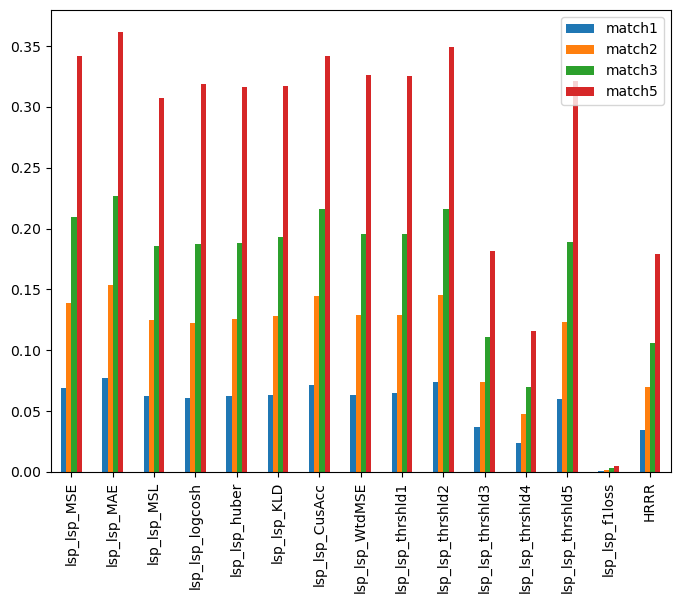

In [103]:
compareperfdf.transpose().iloc[8:24,6:11].plot(kind="bar")#, log=True

<AxesSubplot: >

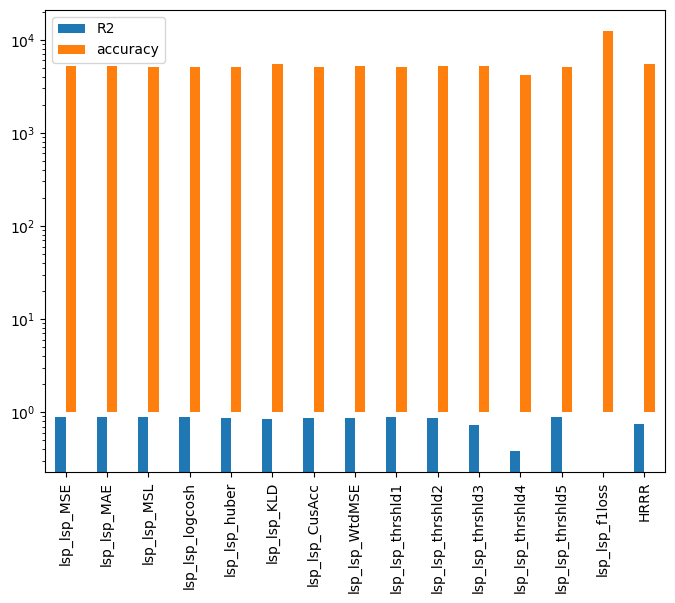

In [105]:
compareperfdf.transpose().iloc[8:24,4:6].plot(kind="bar", log= True)

In [106]:
compareperfdf=compareperfdf.transpose()

In [111]:
compareperfdf.idxmin()#compareperfdf.min() for actual values

MSE                    lsp_lsp_MSE
MAE                    lsp_lsp_MAE
RMSE                   lsp_lsp_MSE
threshold_loss         lsp_lsp_MAE
R2                  lsp_lsp_f1loss
accuracy          lsp_lsp_thrshld4
match1              lsp_lsp_f1loss
match2              lsp_lsp_f1loss
match3              lsp_lsp_f1loss
match5              lsp_lsp_f1loss
dtype: object

In [112]:
#metricsmax_minValues=pd.DataFrame("")
compareperfdf.min()

MSE                 43.447418
MAE                  4.829383
RMSE                 6.591465
threshold_loss       0.048294
R2                 -85.107411
accuracy          4147.067871
match1               0.000831
match2               0.001930
match3               0.002840
match5               0.004849
dtype: float64

In [145]:
compareperfdf.idxmax()

MSE               lsp_lsp_f1loss
MAE               lsp_lsp_f1loss
RMSE              lsp_lsp_f1loss
threshold_loss    lsp_lsp_f1loss
R2                   lsp_lsp_MSE
accuracy          lsp_lsp_f1loss
match1               lsp_lsp_MAE
match2               lsp_lsp_MAE
match3               lsp_lsp_MAE
match5               lsp_lsp_MAE
corrToERA5           lsp_lsp_MAE
dtype: object

In [148]:
metricsdict={"maxMetric":compareperfdf.idxmax(),"maxValue":compareperfdf.max(),
                        "minMetric":compareperfdf.idxmin(),"minValue":compareperfdf.min()}
metrics_df=pd.DataFrame(metricsdict,
                        index=compareperfdf.transpose().index)
metrics_df

,maxMetric,maxValue,minMetric,minValue
MSE,lsp_lsp_f1loss,34339.691406,lsp_lsp_MSE,43.447418
MAE,lsp_lsp_f1loss,159.991592,lsp_lsp_MAE,4.829383
RMSE,lsp_lsp_f1loss,185.309713,lsp_lsp_MSE,6.591465
threshold_loss,lsp_lsp_f1loss,1.599916,lsp_lsp_MAE,0.048294
R2,lsp_lsp_MSE,0.891055,lsp_lsp_f1loss,-85.107411
accuracy,lsp_lsp_f1loss,12406.260742,lsp_lsp_thrshld4,4147.067871
match1,lsp_lsp_MAE,0.077094,lsp_lsp_f1loss,0.000831
match2,lsp_lsp_MAE,0.153298,lsp_lsp_f1loss,0.001930
match3,lsp_lsp_MAE,0.226454,lsp_lsp_f1loss,0.002840
match5,lsp_lsp_MAE,0.361644,lsp_lsp_f1loss,0.004849


In [195]:
comparedf.iloc[:,0:2]

era5forecasttemp    HRRRtmp
time       ForecastHr                             
2022-01-03 0                  26.058912   8.873285
           1                  24.632063   7.576569
           2                  23.621870   6.350824
           3                  22.955687   5.313606
           4                  22.334327   4.615700
...                                 ...        ...
2022-06-29 43                 87.778291  94.265230
           44                 88.694001  95.203900
           45                 89.142381  95.411440
           46                 89.061165  94.929960
           47                 88.488694  94.172180

[203952 rows x 2 columns]

In [141]:
metricsdf["maxvalue"]=compareperfdf.max()
metricsdf

MSE                                                  lsp_lsp_f1loss
MAE                                                  lsp_lsp_f1loss
RMSE                                                 lsp_lsp_f1loss
threshold_loss                                       lsp_lsp_f1loss
R2                                                      lsp_lsp_MSE
accuracy                                             lsp_lsp_f1loss
match1                                                  lsp_lsp_MAE
match2                                                  lsp_lsp_MAE
match3                                                  lsp_lsp_MAE
match5                                                  lsp_lsp_MAE
corrToERA5                                              lsp_lsp_MAE
maxvalue          MSE               34339.691406
MAE            ...
dtype: object

In [113]:
compareperfdf.max()

MSE               34339.691406
MAE                 159.991592
RMSE                185.309713
threshold_loss        1.599916
R2                    0.891055
accuracy          12406.260742
match1                0.077094
match2                0.153298
match3                0.226454
match5                0.361644
dtype: float64

In [138]:
predictionsnonan_a_a = np.array(comparedf_wo_nan["PredtrainIndarea_testIndarea_cuttoIndpoint"])


predictionsnonan_la_la_p = np.array(comparedf_wo_nan['predthrshld1LONG_trainIndareap15_testIndpoint'])


predictionsnonan_a_p = np.array(comparedf_wo_nan["predtrainIndarea_testindpoint"])
predictionsnonan_p_p = np.array(comparedf_wo_nan["predtrainIndPOINT_testindpoint"])
predictionsnonan_sp_sp = np.array(comparedf_wo_nan["predSCRATCHtrainIndPOINT_testindpoint"])
predictionsnonan_lsp_lsp = np.array(comparedf_wo_nan["predSCRATCHtrainIndPOINTlongtrain_testindpoint"])
predictionsnonan_lshFp_lshFp = np.array(comparedf_wo_nan["predLONGshuffleFalsetrainIndarea_testIndpoint"])
predictionsnonan_shTa_shFp = np.array(comparedf_wo_nan["predthrshld1shuffleTruetrainIndarea_shuffleFalsetestIndpoint"])
predictionsnonan_lshFp_lshFp = np.array(comparedf_wo_nan["predthrshld1shuffleFalseLONGp15_trainIndpt_shuffleFalsetestIndpoint"])


listOfCorrelations= [pearson_r(era5nonan, predictionsnonan_a_a), pearson_r(era5nonan, predictionsnonan_a_p),
                    pearson_r(era5nonan, predictionsnonan_p_p),pearson_r(era5nonan, predictionsnonan_la_la_p),
                    pearson_r(era5nonan, predictionsnonan_sp_sp),pearson_r(era5nonan, predictionsnonan_lshFp_lshFp),
                    pearson_r(era5nonan, predictionsnonan_shTa_shFp),pearson_r(era5nonan, predictionsnonan_lshFp_lshFp),
                    pearson_r(era5nonan, lsp_lsp_MSE),pearson_r(era5nonan, lsp_lsp_MAE),
                    pearson_r(era5nonan, lsp_lsp_MSL),pearson_r(era5nonan, lsp_lsp_logcosh),
                    pearson_r(era5nonan, lsp_lsp_huber),pearson_r(era5nonan, lsp_lsp_KLD),
                    pearson_r(era5nonan, lsp_lsp_CusAcc),pearson_r(era5nonan, lsp_lsp_WtdMSE),
                    pearson_r(era5nonan, predictionsnonan_lsp_lsp),pearson_r(era5nonan, lsp_lsp_thrshld2),
                    pearson_r(era5nonan, lsp_lsp_thrshld3),pearson_r(era5nonan, lsp_lsp_thrshld4),
                    pearson_r(era5nonan, lsp_lsp_thrshld5),pearson_r(era5nonan, lsp_lsp_f1loss),
                    pearson_r(era5nonan, HRRRnonan)]
compareperfdf["corrToERA5"]=listOfCorrelations

compareperfdf

,MSE,MAE,RMSE,threshold_loss,R2,accuracy,match1,match2,match3,match5,corrToERA5
a_a,829.440430,23.492769,28.800008,0.234928,-1.079837,4561.638672,0.012953,0.025381,0.037939,0.062598,-0.033093
a_p,785.615417,22.919300,28.028831,0.229193,-0.969945,4513.430176,0.013784,0.026688,0.039413,0.065339,-0.019114
p_p,661.252686,21.071306,25.714834,0.210713,-0.658103,4561.308594,0.013477,0.027390,0.041659,0.068812,0.026802
lap_la_p,94.205406,7.527181,9.705947,0.075272,0.763778,5189.262695,0.045311,0.090621,0.135882,0.219992,0.878660
sp_sp,69.358002,6.554359,8.328145,0.065544,0.826084,5182.257812,0.045607,0.091631,0.137268,0.226969,0.909780
lshFa_lshFp,72.341537,6.682800,8.505383,0.066828,0.818602,5185.179688,0.044707,0.090977,0.136130,0.228968,0.921037
shTa_shFp,94.394821,7.531392,9.715700,0.075314,0.763303,5200.025879,0.045251,0.090473,0.135704,0.220230,0.878348
lshFp_lshFp,72.341537,6.682800,8.505383,0.066828,0.818602,5185.179688,0.044707,0.090977,0.136130,0.228968,0.921037
lsp_lsp_MSE,43.447418,4.941593,6.591465,0.049416,0.891055,5255.190918,0.069346,0.139118,0.209207,0.342229,0.944060
lsp_lsp_MAE,43.964458,4.829383,6.630569,0.048294,0.889758,5201.402832,0.077094,0.153298,0.226454,0.361644,0.944063


In [156]:
compareperfdf["match5"].sort_values()

lsp_lsp_f1loss      0.004849
a_a                 0.062598
a_p                 0.065339
p_p                 0.068812
lsp_lsp_thrshld4    0.115736
HRRR                0.178699
lsp_lsp_thrshld3    0.181806
lap_la_p            0.219992
shTa_shFp           0.220230
sp_sp               0.226969
lshFp_lshFp         0.228968
lshFa_lshFp         0.228968
lsp_lsp_MSL         0.307566
lsp_lsp_huber       0.315997
lsp_lsp_KLD         0.317164
lsp_lsp_logcosh     0.319223
lsp_lsp_thrshld5    0.321558
lsp_lsp_thrshld1    0.325358
lsp_lsp_WtdMSE      0.326466
lsp_lsp_CusAcc      0.341893
lsp_lsp_MSE         0.342229
lsp_lsp_thrshld2    0.349196
lsp_lsp_MAE         0.361644
Name: match5, dtype: float64

In [157]:

compareperfdf["corrToERA5"].sort_values()

a_a                -0.033093
a_p                -0.019114
p_p                 0.026802
lsp_lsp_f1loss      0.806339
lsp_lsp_thrshld4    0.862933
lsp_lsp_thrshld3    0.877001
shTa_shFp           0.878348
lap_la_p            0.878660
HRRR                0.886785
sp_sp               0.909780
lshFp_lshFp         0.921037
lshFa_lshFp         0.921037
lsp_lsp_KLD         0.928025
lsp_lsp_thrshld2    0.933430
lsp_lsp_WtdMSE      0.934231
lsp_lsp_huber       0.934985
lsp_lsp_CusAcc      0.936668
lsp_lsp_MSL         0.940062
lsp_lsp_logcosh     0.940816
lsp_lsp_thrshld5    0.940849
lsp_lsp_thrshld1    0.942012
lsp_lsp_MSE         0.944060
lsp_lsp_MAE         0.944063
Name: corrToERA5, dtype: float64

In [149]:
metrics_df.to_parquet("/Users/sn/Downloads/nonscaled_preprocesssed_Ind/MEtricsMax_min_HRRRIndpoint_half2022.parquet", compression="gzip")
compareperfdf.to_parquet("/Users/sn/Downloads/nonscaled_preprocesssed_Ind/PerformanceMetrics_HRRRIndpoint_half2022.parquet", compression="gzip")
comparedf.to_parquet("/Users/sn/Downloads/nonscaled_preprocesssed_Ind/ERA5-RRR-modelpredictions_Indpoint_half2022.parquet", compression="gzip")

In [ ]:
# HRRR correlation is 88.6% vs 94% for MAP model
#correlation is highest for MAP > MSE models though match percentages are  highest for MAE>threshold2 levels(threshold 1 is same as threshold 2 but for data not rounded to 1 decimal place
#the difference is not that much though)MAYBE REDO PREDICTIONS with threshold 1 that has trained on nonrounded, but test on rounded data
#OFNOTE: all lsp_lsp except lsp_lspthreshodl1, were were trained and tested on rounded(1)data while others were not 
#OF NOTE, NORMALIZATION AND PREPROCESSING WAS CARRIEDOUT IN IND AREA AND THEN CUT OFF TO INDPOINT.MAYBE CAN TEST PREPROCESSING RAW INDPOINT DATA

In [ ]:
#TO DO:(reference above)
#ALL THE GOOD MATCHES AND CORRELATIONS ARE FROM ROUNDED, SO WOULD HAVE TO REDO THE OTHERS
#MAYBE REDO PREDICTIONS with threshold 1 that has trained on nonrounded, but test on rounded data(tested on only nonrounded data so far)

#MAYBE REDO PREDICTIONS with other models that have not been trained or tested on round 1 data.
#CAN TEST PREPROCESSING RAW INDPOINT DATA

In [ ]:
#BELOW ARE LIME SEGMENT and other EXPLAINER EXPERIMENTS FOR lsp_lsp_MAP #ALL FAILED!

In [158]:
path="/Users/sn/Documents/trained models/NewModels/Indpointlongp15train_scratchdata_round1MeanAbsoluteEr_shallow1L_1rsF_temp_unscaled_BiLSTM_48-48_minmax_hrmodel.h5"

lsp_lsp_MAP_model=tf.keras.models.load_model(path,
                                             custom_objects={"threshold_loss" : threshold_loss, "csi": csi,
                                                             "freqbiassc":freqbiassc, "f1":f1, "ham":ham, 
                                                             "match1":match1,"match2":match2,"match3":match3,
                                                             "match5":match5})




In [180]:
!git clone https://github.com/TortySivill/LIMESegment.git

xcrun: error: invalid active developer path (/Library/Developer/CommandLineTools), missing xcrun at: /Library/Developer/CommandLineTools/usr/bin/xcrun


In [181]:
!pip install lime_timeseries

ERROR: Could not find a version that satisfies the requirement lime_timeseries (from versions: none)
ERROR: No matching distribution found for lime_timeseries


In [183]:
!pip install fastdtw

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.4/133.4 kB 1.5 MB/s eta 0:00:00a 0:00:01
  Preparing metadata (setup.py) ... done
  Created wheel for fastdtw: filename=fastdtw-0.3.4-py3-none-any.whl size=3564 sha256=0530a203b42febc072bb993a4f1f0220febe73455ea46e72a5c15e594472fa15
  Stored in directory: /Users/sn/Library/Caches/pip/wheels/b2/b2/20/c0960e8ee3ceaf158c43f28eea50357113dfe2f3106da9fdb1
Successfully built fastdtw


In [185]:
!pip install stumpy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 136.2/136.2 kB 3.0 MB/s eta 0:00:0000:01


In [186]:
!pip install scipy
!pip install sklearn

  Preparing metadata (setup.py) ... done
  error: subprocess-exited-with-error
  
  × python setup.py bdist_wheel did not run successfully.
  │ exit code: 1
  ╰─> [4 lines of output]
      running bdist_wheel
      error: This is an expected error. Building wheel is disabled for the deprecated sklearn PyPI package to avoid pip caching.
      For more details about the sklearn PyPI package deprecation, see:
      https://github.com/scikit-learn/sklearn-pypi-package
      [end of output]
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for sklearn
  Running setup.py clean for sklearn
Failed to build sklearn
  Running setup.py install for sklearn ... done
  DEPRECATION: sklearn was installed using the legacy 'setup.py install' method, because a wheel could not be built for it. pip 23.1 will enforce this behaviour change. A possible replacement is to fix the wheel build issue reported above. Discussion can be found at 

In [187]:
#https://github.com/TortySivill/LIMESegment
from scipy import signal
import numpy as np
import stumpy
from sklearn.linear_model import Ridge
from fastdtw import fastdtw
import random


def NNSegment(t, window_size, change_points):
    """Return the change points of given time series
    Input: 
        t - numpy array of size T
        window_size - int where window_size < T 
        change_points - user specified number of change points
    Output: 
        np.array of change point indexes 
    """
    """Return the change points of given time series
    Input: 
        t - numpy array of size T
        window_size - int where window_size < T 
        change_points - user specified number of change points
    Output: 
        np.array of change point indexes 
    """
    mp = stumpy.stump(t, m=window_size)
    proposed_cp = [i for i in range(0,mp.shape[0]-1) if mp[i+1,1] != mp[i,1] + 1]
    tolerance = int(window_size/2)
    variances = []
    for idx in proposed_cp:
        mean_change = np.abs(np.mean(t[idx-tolerance:idx]) - np.mean(t[idx:idx+tolerance]))
        std_change = np.abs(np.std(t[idx-tolerance:idx]) - np.std(t[idx:idx+tolerance])) 
        std_mean = np.mean([np.std(t[idx-tolerance:idx]),np.std(t[idx:idx+tolerance])])
        variances.append(mean_change*std_change/std_mean)
    sorted_idx = np.flip(np.array(variances).argsort())
    sorted_cp = [proposed_cp[idx] for idx in sorted_idx]
    selected_cp = []
    covered = list(np.arange(0,tolerance))
    ic, i = 0, 0 
    while ic < change_points:
        if i == len(sorted_cp):
            break
        if sorted_cp[i] not in covered:
            ic += 1
            selected_cp.append(sorted_cp[i])
            covered = covered + list(np.arange(sorted_cp[i],sorted_cp[i]+tolerance))
            covered = covered + list(np.arange(sorted_cp[i]-tolerance,sorted_cp[i]))
        i +=1 
    selected_cp = np.sort(np.asarray(selected_cp))
    return(list(selected_cp))

def backgroundIdentification(original_signal,f=40):
    f, t, Zxx = signal.stft(original_signal.reshape(original_signal.shape[0]),1,nperseg=f)
    frequency_composition_abs = np.abs(Zxx)
    measures = []
    for freq,freq_composition in zip(f,frequency_composition_abs):
        measures.append(np.mean(freq_composition)/np.std(freq_composition))
    max_value = max(measures)
    selected_frequency = measures.index(max_value)
    weights = 1-(measures/sum(measures))
    dummymatrix = np.zeros((len(f),len(t)))
    dummymatrix[selected_frequency,:] = 1  
    #Option to admit information from other frequency bands
    """dummymatrix = np.ones((len(f),len(t)))
    for i in range(0,len(weights)):
        dummymatrix[i,:] = dummymatrix[i,:] * weights[i]"""
    
    background_frequency = Zxx * dummymatrix
    _, xrec = signal.istft(background_frequency, 1)
    xrec = xrec[:original_signal.shape[0]]
    xrec = xrec.reshape(original_signal.shape)
    return xrec

def RBP(generated_samples_interpretable, original_signal, segment_indexes, f):
    generated_samples_raw = []
    xrec = backgroundIdentification(original_signal)
    for sample_interpretable in generated_samples_interpretable:
        raw_signal = original_signal.copy()
        for index in range(0,len(sample_interpretable)-1):
            if sample_interpretable[index] == 0:
                index0 = segment_indexes[index]
                index1 = segment_indexes[index+1]
                raw_signal[index0:index1] = xrec[index0:index1]
        generated_samples_raw.append(np.asarray(raw_signal))
    return np.asarray(generated_samples_raw)

def RBPIndividual(original_signal, index0, index1):
    xrec = backgroundIdentification(original_signal)
    raw_signal = original_signal.copy()
    raw_signal[index0:index1] = xrec[index0:index1]
    return raw_signal

def LIMESegment(example, model, model_type='class', distance='dtw', n=100, window_size=None, cp=None, f=None):
    if window_size is None:
        window_size =int(example.shape[0]/5)
    if cp is None:
        cp = 3
    if f is None: 
        f = int(example.shape[0]/10)
    cp_indexes = NNSegment(example.reshape(example.shape[0]), window_size, cp)
    segment_indexes = [0] + cp_indexes + [-1]
    generated_samples_interpretable = [np.random.binomial(1, 0.5, len(cp_indexes)+1) for _ in range(0,n)]
    generated_samples_raw = RBP(generated_samples_interpretable, example, segment_indexes, f)
    sample_predictions = model.predict(generated_samples_raw)
    if model_type == 'proba':
        y_labels = np.argmax(sample_predictions, axis=1)
    else:
        y_labels = sample_predictions
    
    if distance == 'dtw':
        distances = np.asarray([fastdtw(example, sample)[0] for sample in generated_samples_raw])
        weights = np.exp(-(np.abs((distances - np.mean(distances))/np.std(distances)).reshape(n,)))
    elif distance == 'euclidean':
        distances = np.asarray([np.linalg.norm(np.ones(len(cp_indexes)+1)-x) for x in generated_samples_interpretable])
        weights = np.exp(-(np.abs(distances**2/0.75*(len(segment_indexes)**2)).reshape(n,)))
    clf = Ridge()
    clf.fit(generated_samples_interpretable,y_labels, weights)
    return clf.coef_, segment_indexes

def background_perturb(original_signal, index0, index1, X_background):
    perturbed_signal = original_signal.copy()
    selected_background_ts = X_background[random.randint(0, 20)]
    perturbed_signal[index0:index1] = selected_background_ts.reshape(perturbed_signal.shape)[index0:index1]   
    return np.asarray(perturbed_signal)

def mean_perturb(original_signal, index0, index1, mean_value, ws):
    perturbed_signal = original_signal.copy()
    mean_signal = np.ones(original_signal.shape)*mean_value
    perturbed_signal[index0:index1] = mean_signal[index0:index1]
    return perturbed_signal

def calculate_mean(cp_indexes, X_background, ws):
    sample_averages = []
    for ts in X_background: 
        window_averages = np.mean([np.mean(ts[i:i+ws]) for i in cp_indexes])
        sample_averages.append(window_averages)
    return np.mean(sample_averages)


def LEFTIST(example, model,  X_background, model_type="class", n=100):
    ts_length = example.shape[0]
    cp_indexes = [i for i in range(0,example.shape[0],int(example.shape[0]/10))]
    example_interpretable = np.ones(len(cp_indexes))
    generated_samples_interpretable = [ np.random.binomial(1, 0.5, len(cp_indexes)) for _ in range(0,n)]
    generated_samples_original = []
    segment_indexes = cp_indexes + [-1]
    for sample_interpretable in generated_samples_interpretable:
        raw_sample = example.copy()
        for index in range(0,len(sample_interpretable)):
            if sample_interpretable[index] == 0:
                index0 = segment_indexes[index]
                index1 = segment_indexes[index+1]
                raw_sample = background_perturb(raw_sample,index0,index1,X_background)
        generated_samples_original.append((raw_sample))
    
    sample_predictions = model.predict(np.asarray(generated_samples_original))
    if model_type == 'proba':
        y_labels = np.argmax(sample_predictions, axis=1)
    else:
        y_labels = sample_predictions

    distances = np.asarray([np.linalg.norm(np.ones(len(cp_indexes))-x) for x in generated_samples_interpretable])
    weights = np.exp(-(np.abs(distances**2/(len(segment_indexes)**2))))
    clf = Ridge()
    clf.fit(generated_samples_interpretable,y_labels,weights)
    return clf.coef_, cp_indexes

    distances = np.asarray([np.linalg.norm(np.ones(len(cp_indexes))-x) for x in generated_samples_interpretable])
    weights = np.exp(-(np.abs(distances**2/(len(segment_indexes)**2))))
    clf = Ridge()
    clf.fit(generated_samples_interpretable,y_labels,weights)
    return clf.coef_, cp_indexes

def NEVES(example, model, X_background, model_type="class", n=100):
    ts_length = example.shape[0]
    cp_indexes = [i for i in range(0,example.shape[0],int(example.shape[0]/10))]
    example_interpretable = np.ones(len(cp_indexes))
    generated_samples_interpretable = [ np.random.binomial(1, 0.5, len(cp_indexes)) for _ in range(0,n)]
    generated_samples_original = []
    mean_perturb_value = calculate_mean(cp_indexes, X_background, int(cp_indexes[1]-cp_indexes[0]))
    segment_indexes = cp_indexes + [ts_length]
    for sample_interpretable in generated_samples_interpretable:
        raw_sample = example.copy()
        for index in range(0,len(sample_interpretable)):
            if sample_interpretable[index] == 0:
                index0 = segment_indexes[index]
                index1 = segment_indexes[index+1]
                raw_sample = mean_perturb(raw_sample,index0,index1,mean_perturb_value,int(cp_indexes[1]-cp_indexes[0]))
        generated_samples_original.append(raw_sample)

    sample_predictions = model.predict(np.asarray(generated_samples_original))
    if model_type == 'proba':
        y_labels = np.argmax(sample_predictions, axis=1)
    else:
        y_labels = sample_predictions

    distances = np.asarray([np.linalg.norm(np.ones(len(cp_indexes))-x) for x in generated_samples_interpretable])
    weights = np.exp(-(np.abs(distances**2/(len(segment_indexes)**2))).reshape(n,))
    clf = Ridge()
    clf.fit(generated_samples_interpretable,y_labels,weights)
    return clf.coef_, 

In [193]:
explanations = LIMESegment(Xtest, lsp_lsp_MAP_model, "class", 'dtw', 48, 3)
explanations

ValueError: cannot reshape array of size 6934368 into shape (4249,)

In [161]:
conda install -c conda-forge shap

Retrieving notices: ...working... done
Solving environment: done

## Package Plan ##

  environment location: /Users/sn/miniforge3

  added / updated specs:
    - shap


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    cloudpickle-2.2.1          |     pyhd8ed1ab_0          27 KB  conda-forge
    libllvm11-11.1.0           |       hfa12f05_5        20.6 MB  conda-forge
    llvmlite-0.39.1            |  py310h1e34944_1         262 KB  conda-forge
    numba-0.56.4               |  py310h3124f1e_0         3.6 MB  conda-forge
    shap-0.41.0                |  py310ha6a5cd6_0         567 KB  conda-forge
    slicer-0.0.7               |     pyhd8ed1ab_0          16 KB  conda-forge
    ------------------------------------------------------------
                                           Total:        25.0 MB

The following NEW packages will be INSTALLED:

  cloudpickle        conda-forge/noarch:

In [ ]:
# #this is for Ind point:
# Xtest, ytest= create_dataset(Indpointtestdf,48, 48)
# testdata=(Xtest,ytest)
# Xtrain, ytrain= create_dataset(Indpointtraindf,48, 48)
# traindata=(Xtrain,ytrain)
# Xval, yval= create_dataset(Indpointvaliddf,48, 48)
# valdata=(Xval,yval)

In [177]:
Xtest[0].shape

(48, 34)

In [175]:
EGytrain=ytrain[0].reshape(48)
EGytrain.shape

(48,)

In [172]:
Xtrain[0].shape

(48, 34)

In [160]:
import shap

# we use the first 100 training examples as our background dataset to integrate over
explainer = shap.DeepExplainer(lsp_lsp_MAP_model, Xtest[:48])

# explain the first 10 predictions
# explaining each prediction requires 2 * background dataset size runs
shap_values = explainer.shap_values(ytest[:10])

ModuleNotFoundError: No module named 'shap'

In [167]:
#import shap
shap.initjs()
explainer = shap.KernelExplainer(model = lsp_lsp_MAP_model.predict, data = Xtrain, link = "identity")
# Set the index of the specific example to explain
# X_idx = 0

# shap_value_single = explainer.shap_values(X = Xtrain.iloc[X_idx:X_idx+1,:], nsamples = 100)
# X.iloc[X_idx:X_idx+1,:]


2023-01-26 16:43:22.114769: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 16:43:22.160776: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-26 16:43:22.168266: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


545/545 [==============================] - 8s 13ms/step


AttributeError: 'numpy.ndarray' object has no attribute 'iloc'

In [179]:
#https://www.kaggle.com/code/ltsmssv/shap-for-lstm-hpccv2/notebook
import shap
# Use the training data for deep explainer => can use fewer instances
explainer = shap.GradientExplainer(lsp_lsp_MAP_model, Xtrain)
# explain the the testing instances (can use fewer instanaces)
# explaining each prediction requires 2 * background dataset size runs
shap_values = explainer.shap_values(Xtest)
# init the JS visualization code
shap.initjs()

AssertionError: The model output must be a vector or a single value!

In [ ]:
explainer.expected_value

In [ ]:
#OLD NOTEBOOK FROM UNTITLED 3 lsp_lsp HERE ON DOWN: